

(c) Karen Belita  <br /> 
Team Neighborhood Change <br /> 
Last Updated 9/7/2016 <br /> 

# NOTEBOOK: FINAL MODEL SELECTED
* This is to chose the best feature selecton method and model selection method
* Final Model is KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=16, n_init=12,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)
* features ran through PCA with 25 number of components


## DEPENDENCIES

indicators.csv --  which has a list of all features from the PostgreSQL database

In [2]:
import pandas as pd
import os 
import csv
import xlrd
import numpy as np
import matplotlib
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.tools.plotting import scatter_matrix
from __future__ import print_function

from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.preprocessing import Imputer
from sklearn import preprocessing
matplotlib.style.use('ggplot')
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from time import time
import numpy as np
import matplotlib.pyplot as plt
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler, MinMaxScaler
%matplotlib inline 
from sklearn.metrics.pairwise import euclidean_distances
import warnings
from scipy.spatial.distance import euclidean as eucl

from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np



# OUTPUT
* features_cluster.csv  has the cluster assignments of each instance and the position of the instances and centroid in the 25-D field
* cluster_feat_distances.csv has the cluster assignments of each instance, distances and the position of the instances and centroid in the 25-D field
* cluster_distances.csv has the cluster assignment of an intance with the distance to the centroid
* cluster_summary has the summary statistics of of each cluster 
* MSA_by_cluster.csv is the dictionary of the cluster and closest MSAs to the centroids of the cluster
* indicators_clustered.csv is the unimputed data with clustered assignment of each instance
* indicators_cluster_completed.csv is the imputed features with cluster assignment of each instance that will be used for supervised machine learning

## Part 1: 
* read indicators csv into pandas dataframe
* remove unnecessary columns
* convert Nans into blank space
* imputed missing data using interpolate function from pandas



In [3]:
df = pd.read_csv('indicators.csv')


In [4]:
indicators = df[['cbsa', 'msa_name', 'violent_crime_rate', 
                'murder_manslaughter',
                'rape', 'robbery',
                'aggravated_assault',
                'property_crime_rate',
                'burglary', 'larceny_theft',
                'motor_vehicle_theft',
                'total_crime_rate',
                'median_gross_rent',
                'median_monthly_mortgage',
                'rent_burden', 'mortgage_burden',
                'income_change_2012_to_2014',
                'median_age_of_men', 'median_age_of_women',
                'median_age', 'median_household_income',
                'single_men_population',
                'single_women_population',
                'ratio_of_single_men_to_single_women',
                'population_percent_of_single_men',
                'population_percent_of_single_women',
                'population', 'edu_average_scale_score',
                'pct_laccess_pop10', 'pct_laccess_lowi10',
                'pct_laccess_child10', 'pct_laccess_seniors10',
                'pct_laccess_hhnv10', 'event_mpmt',
                'fatalities_mpmt', 'injuries_mpmt',
                'walk_score', 'transit_score', 'bike_score',
                'unemploymentrate', 'employment', 'laborforce']]


In [5]:
## all Nans to white space
indicators = indicators.replace(np.nan,' ', regex=True)

indicators = indicators.replace(np.nan,'NaN', regex=True)

# convert to all floats except cbsa and msa_name

indicators = indicators.convert_objects(convert_numeric=True)
##imputer


/Users/kbelita/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:8: FutureWarning: convert_objects is deprecated.  Use the data-type specific converters pd.to_datetime, pd.to_timedelta and pd.to_numeric.


In [6]:
indicators.columns = ['cbsa', 'msa_name', 'violent_crime_rate', 
                                'murder_manslaughter',
                                'rape', 'robbery',
                                'aggravated_assault',
                                'property_crime_rate',
                                'burglary', 'larceny_theft',
                                'motor_vehicle_theft',
                                'total_crime_rate',
                                'median_gross_rent',
                                'median_monthly_mortgage',
                                'rent_burden', 'mortgage_burden',
                                'income_change_2012_to_2014',
                                'median_age_of_men', 'median_age_of_women',
                                'median_age', 'median_household_income',
                                'single_men_population',
                                'single_women_population',
                                'ratio_of_single_men_to_single_women',
                                'population_percent_of_single_men',
                                'population_percent_of_single_women',
                                'population', 'edu_average_scale_score',
                                'pct_laccess_pop10', 'pct_laccess_lowi10',
                                'pct_laccess_child10', 'pct_laccess_seniors10',
                                'pct_laccess_hhnv10', 'event_mpmt',
                                'fatalities_mpmt', 'injuries_mpmt',
                                'walk_score', 'transit_score', 'bike_score',
                                'unemploymentrate', 'employment',
                                'laborforce']


In [7]:
featuresx = df[['violent_crime_rate', 
                'murder_manslaughter',
                'rape', 'robbery',
                'aggravated_assault',
                'property_crime_rate',
                'burglary', 'larceny_theft',
                'motor_vehicle_theft',
                'total_crime_rate',
                'median_gross_rent',
                'median_monthly_mortgage',
                'rent_burden', 'mortgage_burden',
                'income_change_2012_to_2014',
                'median_age_of_men', 'median_age_of_women',
                'median_age', 'median_household_income',
                'single_men_population',
                'single_women_population',
                'ratio_of_single_men_to_single_women',
                'population_percent_of_single_men',
                'population_percent_of_single_women',
                'population', 'edu_average_scale_score',
                'pct_laccess_pop10', 'pct_laccess_lowi10',
                'pct_laccess_child10', 'pct_laccess_seniors10',
                'pct_laccess_hhnv10', 'event_mpmt',
                'fatalities_mpmt', 'injuries_mpmt',
                'walk_score', 'transit_score', 'bike_score',
                'unemploymentrate', 'employment', 'laborforce']]

labelsx = df["cbsa"]

In [8]:
featuresx.columns.values

array(['violent_crime_rate', 'murder_manslaughter', 'rape', 'robbery',
       'aggravated_assault', 'property_crime_rate', 'burglary',
       'larceny_theft', 'motor_vehicle_theft', 'total_crime_rate',
       'median_gross_rent', 'median_monthly_mortgage', 'rent_burden',
       'mortgage_burden', 'income_change_2012_to_2014',
       'median_age_of_men', 'median_age_of_women', 'median_age',
       'median_household_income', 'single_men_population',
       'single_women_population', 'ratio_of_single_men_to_single_women',
       'population_percent_of_single_men',
       'population_percent_of_single_women', 'population',
       'edu_average_scale_score', 'pct_laccess_pop10',
       'pct_laccess_lowi10', 'pct_laccess_child10',
       'pct_laccess_seniors10', 'pct_laccess_hhnv10', 'event_mpmt',
       'fatalities_mpmt', 'injuries_mpmt', 'walk_score', 'transit_score',
       'bike_score', 'unemploymentrate', 'employment', 'laborforce'], dtype=object)

In [9]:
featuresx.head()

,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,larceny_theft,motor_vehicle_theft,total_crime_rate,...,pct_laccess_hhnv10,event_mpmt,fatalities_mpmt,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce
0,371.4,3.1,16.6,135.3,216.3,1609.9,220.8,1254.4,100.8,1981.3,...,0.338235,0.418116,0.005243,0.396239,74.500000,44.833333,30.333333,6.4,9324454.0,9965273.0
1,368.9,4.4,21.6,136.6,206.2,2050.4,402.8,1324.6,323.0,2419.3,...,0.224680,0.298524,0.004415,0.345391,60.052632,19.368421,24.000000,NaN,NaN,NaN
2,380.1,6.3,28.2,143.3,202.2,2135.4,361.7,1605.9,167.9,2515.5,...,0.473720,0.579050,0.004533,0.708461,49.700000,20.300000,7.000000,7.1,4540001.0,4888002.0
3,332.9,4.4,31.8,120.8,175.8,3036.4,NaN,2071.8,263.3,3369.3,...,0.650693,0.494725,0.006083,0.583938,38.714286,19.714286,26.285714,5.0,3357271.0,3534675.0
4,567.4,5.8,33.2,232.2,296.1,3208.1,688.6,2132.6,387.0,3775.5,...,3.322921,0.492627,0.001631,0.724259,29.000000,7.400000,9.800000,5.0,3079095.0,3239227.0


In [10]:
## all Nans to white space
featuresx = featuresx.replace(np.nan,' ', regex=True)
featuresx = featuresx.replace(np.nan,'NaN', regex=True)
##convert to all floats
featuresx = featuresx.convert_objects(convert_numeric=True)
##imputer
featuresx = featuresx.interpolate()

/Users/kbelita/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:5: FutureWarning: convert_objects is deprecated.  Use the data-type specific converters pd.to_datetime, pd.to_timedelta and pd.to_numeric.


In [11]:
featuresx.head()

,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,larceny_theft,motor_vehicle_theft,total_crime_rate,...,pct_laccess_hhnv10,event_mpmt,fatalities_mpmt,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce
0,371.4,3.1,16.6,135.3,216.3,1609.9,220.80,1254.4,100.8,1981.3,...,0.338235,0.418116,0.005243,0.396239,74.500000,44.833333,30.333333,6.40,9324454.0,9965273.0
1,368.9,4.4,21.6,136.6,206.2,2050.4,402.80,1324.6,323.0,2419.3,...,0.224680,0.298524,0.004415,0.345391,60.052632,19.368421,24.000000,6.75,6932227.5,7426637.5
2,380.1,6.3,28.2,143.3,202.2,2135.4,361.70,1605.9,167.9,2515.5,...,0.473720,0.579050,0.004533,0.708461,49.700000,20.300000,7.000000,7.10,4540001.0,4888002.0
3,332.9,4.4,31.8,120.8,175.8,3036.4,525.15,2071.8,263.3,3369.3,...,0.650693,0.494725,0.006083,0.583938,38.714286,19.714286,26.285714,5.00,3357271.0,3534675.0
4,567.4,5.8,33.2,232.2,296.1,3208.1,688.60,2132.6,387.0,3775.5,...,3.322921,0.492627,0.001631,0.724259,29.000000,7.400000,9.800000,5.00,3079095.0,3239227.0


In [12]:
featuresx.columns = ['violent_crime_rate', 'murder_manslaughter', 'rape', 'robbery', 'aggravated_assault', 'property_crime_rate', 'burglary', 'larceny_theft', 'motor_vehicle_theft', 'total_crime_rate', 'median_gross_rent', 'median_monthly_mortgage', 'rent_burden', 'mortgage_burden', 'income_change_2012_to_2014', 'median_age_of_men', 'median_age_of_women', 'median_age', 'median_household_income', 'single_men_population', 'single_women_population', 'ratio_of_single_men_to_single_women', 'population_percent_of_single_men', 'population_percent_of_single_women', 'population', 'edu_average_scale_score', 'pct_laccess_pop10', 'pct_laccess_lowi10', 'pct_laccess_child10', 'pct_laccess_seniors10', 'pct_laccess_hhnv10', 'event_mpmt', 'fatalities_mpmt', 'injuries_mpmt', 'walk_score', 'transit_score', 'bike_score', 'unemploymentrate', 'employment', 'laborforce']


In [13]:
featuresx.head()

,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,larceny_theft,motor_vehicle_theft,total_crime_rate,...,pct_laccess_hhnv10,event_mpmt,fatalities_mpmt,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce
0,371.4,3.1,16.6,135.3,216.3,1609.9,220.80,1254.4,100.8,1981.3,...,0.338235,0.418116,0.005243,0.396239,74.500000,44.833333,30.333333,6.40,9324454.0,9965273.0
1,368.9,4.4,21.6,136.6,206.2,2050.4,402.80,1324.6,323.0,2419.3,...,0.224680,0.298524,0.004415,0.345391,60.052632,19.368421,24.000000,6.75,6932227.5,7426637.5
2,380.1,6.3,28.2,143.3,202.2,2135.4,361.70,1605.9,167.9,2515.5,...,0.473720,0.579050,0.004533,0.708461,49.700000,20.300000,7.000000,7.10,4540001.0,4888002.0
3,332.9,4.4,31.8,120.8,175.8,3036.4,525.15,2071.8,263.3,3369.3,...,0.650693,0.494725,0.006083,0.583938,38.714286,19.714286,26.285714,5.00,3357271.0,3534675.0
4,567.4,5.8,33.2,232.2,296.1,3208.1,688.60,2132.6,387.0,3775.5,...,3.322921,0.492627,0.001631,0.724259,29.000000,7.400000,9.800000,5.00,3079095.0,3239227.0


# Part 2: 
* Looping through different compenent numbers for PCA and different cluster numbers
* Getting Metrics and also metrics with visualization
* we note that the silhouette score is the important score here

In [1447]:
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
print (20 * '*')
print (20 * '*')
print ('DATA RAN THROUGH PCA')


range_n_components = [17, 25, 28]

for n_components in range_n_components:
    print (20 * '*')
    print (20* '*')
    print ('Number of Components for PCA: %s' % (n_components))
    print (20* '*')
    pca = PCA(n_components = n_components)
    pca_features = pca.fit(featuresx).transform(featuresx)
    pca_features = pd.DataFrame(pca_features)

    features = pca_features
    features = features.values
    

    ## features is pca_features

    range_n_clusters = [16]
    for n_clusters in range_n_clusters:
        print (90 * '*')
        print (90 * '*')
        print ('number of clusters: %d' % (n_clusters))
        print (90 * '_')
        print ('% 9s' % 'name'
              '    time  inertia    homo   compl  v-meas     ARI AMI  silhouette')


        def bench_clustering(estimator, name, data):
            t0 = time()
            estimator.fit(data)
            try: 
                print('% 9s   %.2fs    %i   %.3f   %.3f   %.3f   %.3f   %.3f    %.3f'
                  % (name, (time() - t0), estimator.inertia_,
                     metrics.homogeneity_score(labelsx, estimator.labels_),
                     metrics.completeness_score(labelsx, estimator.labels_),
                     metrics.v_measure_score(labelsx, estimator.labels_),
                     metrics.adjusted_rand_score(labelsx, estimator.labels_),
                     metrics.adjusted_mutual_info_score(labelsx,  estimator.labels_),
                     metrics.silhouette_score(data, estimator.labels_)))
            except AttributeError:
                print('% 9s   %.2fs   %9s    %.3f   %.3f   %.3f   %.3f   %.3f    %.3f'
                  % (name, (time() - t0), "Na",
                     metrics.homogeneity_score(labelsx, estimator.labels_),
                     metrics.completeness_score(labelsx, estimator.labels_),
                     metrics.v_measure_score(labelsx, estimator.labels_),
                     metrics.adjusted_rand_score(labelsx, estimator.labels_),
                     metrics.adjusted_mutual_info_score(labelsx,  estimator.labels_),
                     metrics.silhouette_score(data, estimator.labels_)))

        bench_clustering(KMeans(init='k-means++', n_clusters=n_clusters, n_init=12),
                  name="k-means", data=features)
   

********************
********************
DATA RAN THROUGH PCA
********************
********************
Number of Components for PCA: 17
********************
******************************************************************************************
******************************************************************************************
number of clusters: 16
__________________________________________________________________________________________
name    time  inertia    homo   compl  v-meas     ARI AMI  silhouette
  k-means   0.11s    2953406764904   0.313   1.000   0.477   0.000   0.000    0.595
********************
********************
Number of Components for PCA: 25
********************
******************************************************************************************
******************************************************************************************
number of clusters: 16
__________________________________________________________________________________________

#### SILHOUETTE ANALYSIS WITH GRAPH AND SCORE
* looped through range between 11 and 31 for number of components for PCA
* looped through range between 4, 22

********************
Number of Components for PCA: 11
********************
********************
Number of Components for PCA: 11
For n_clusters = 4 The average silhouette_score is : 0.794910236076


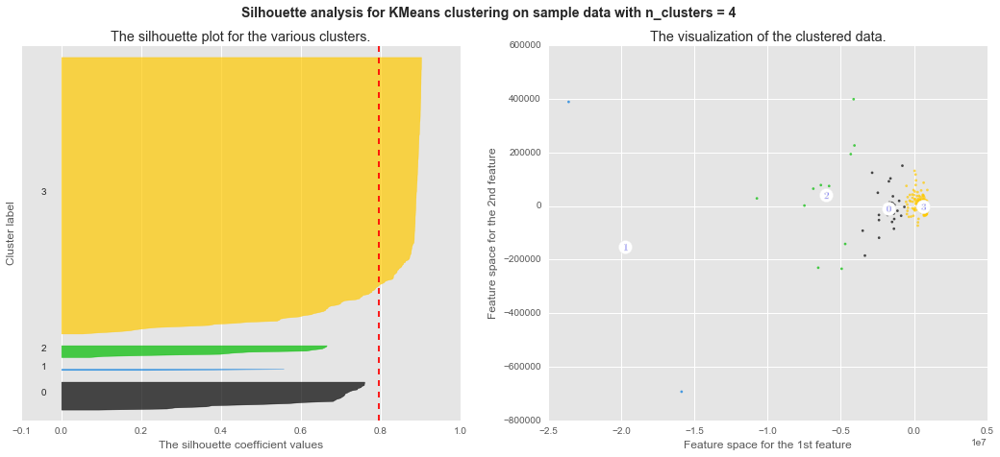

********************
Number of Components for PCA: 11
For n_clusters = 5 The average silhouette_score is : 0.781295322204


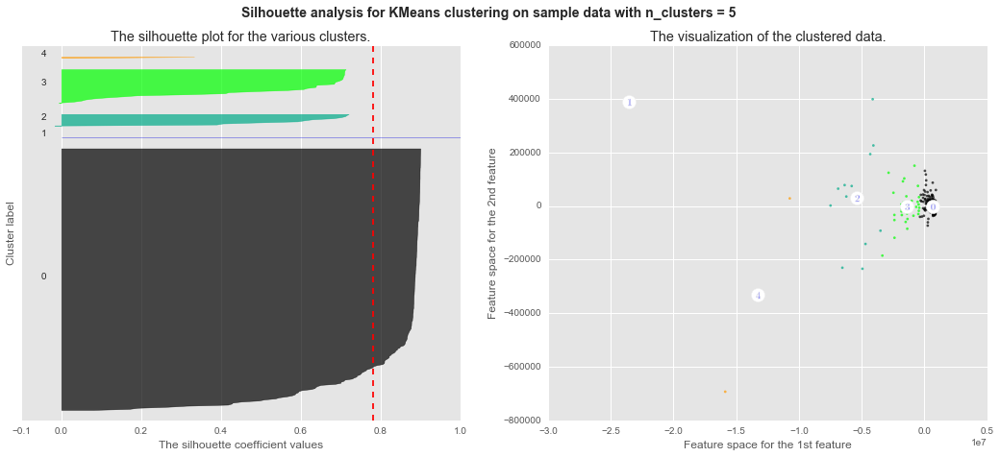

********************
Number of Components for PCA: 11
For n_clusters = 6 The average silhouette_score is : 0.683324661117


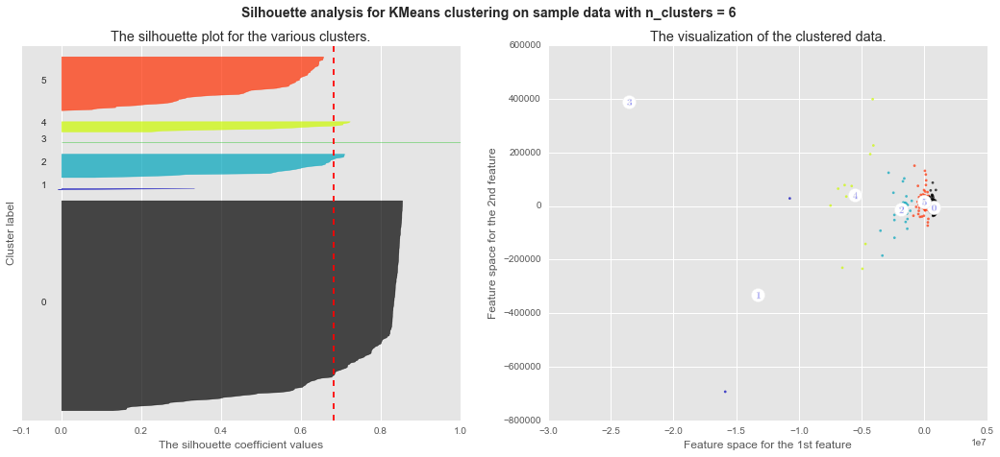

********************
Number of Components for PCA: 11
For n_clusters = 7 The average silhouette_score is : 0.686594492204


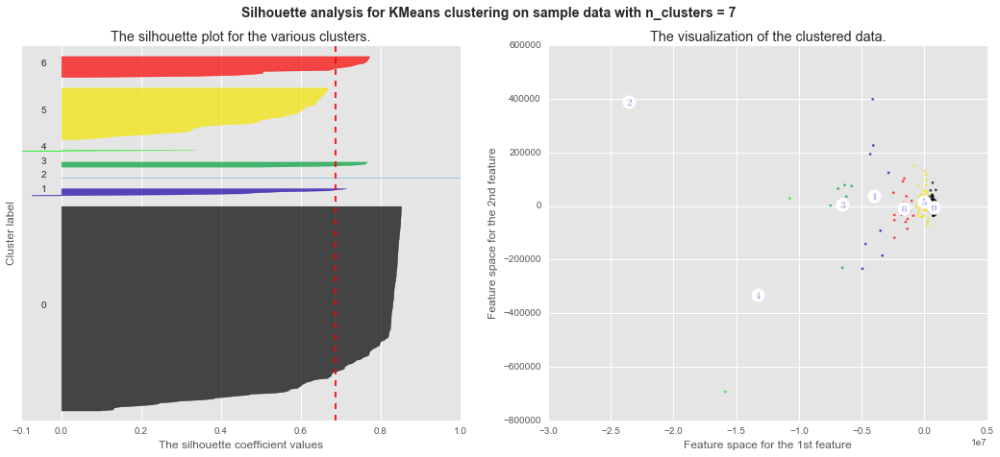

********************
Number of Components for PCA: 11
For n_clusters = 8 The average silhouette_score is : 0.692963599228


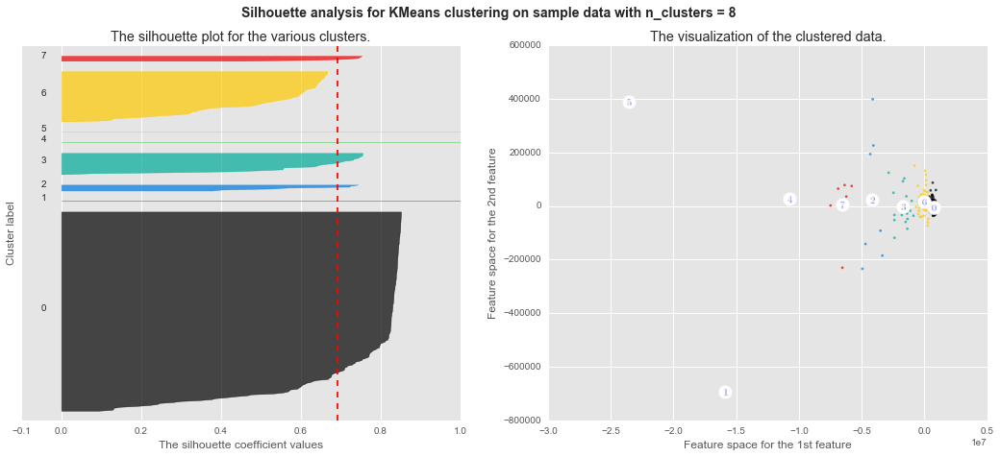

********************
Number of Components for PCA: 11
For n_clusters = 9 The average silhouette_score is : 0.655874108423


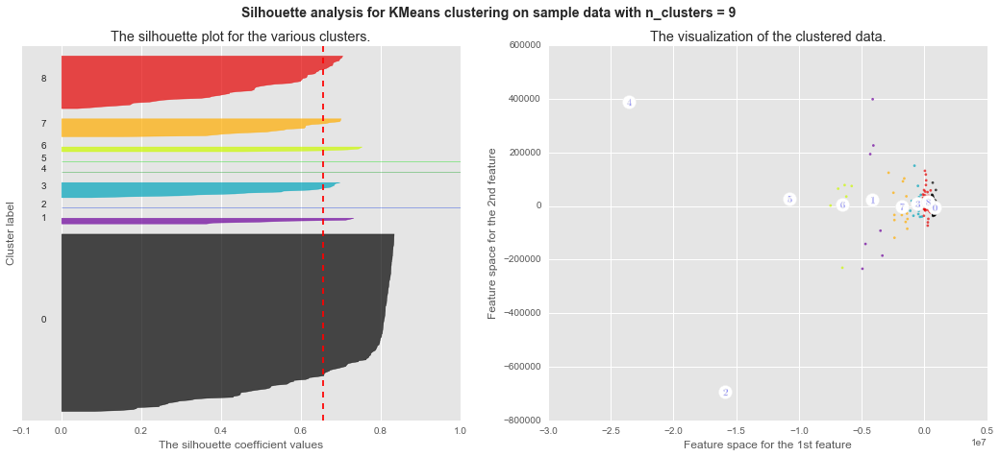

********************
Number of Components for PCA: 11
For n_clusters = 10 The average silhouette_score is : 0.617199090509


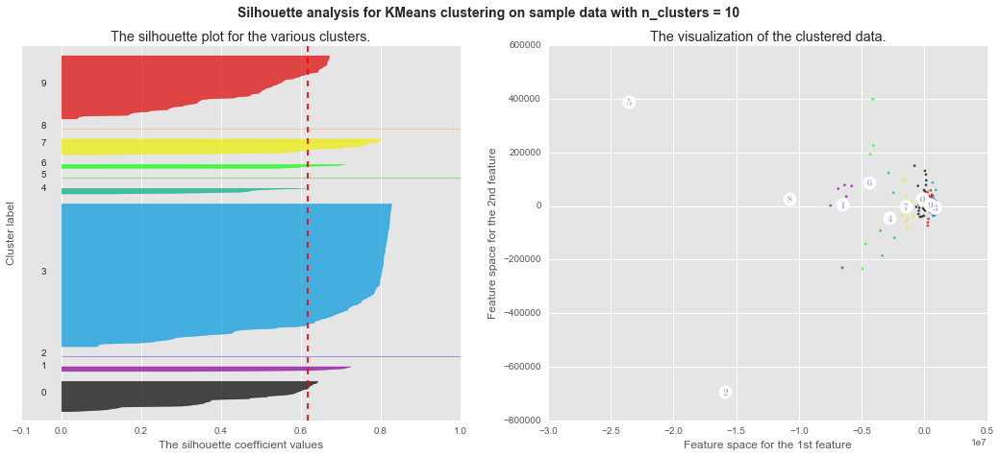

********************
Number of Components for PCA: 11
For n_clusters = 11 The average silhouette_score is : 0.615027555965


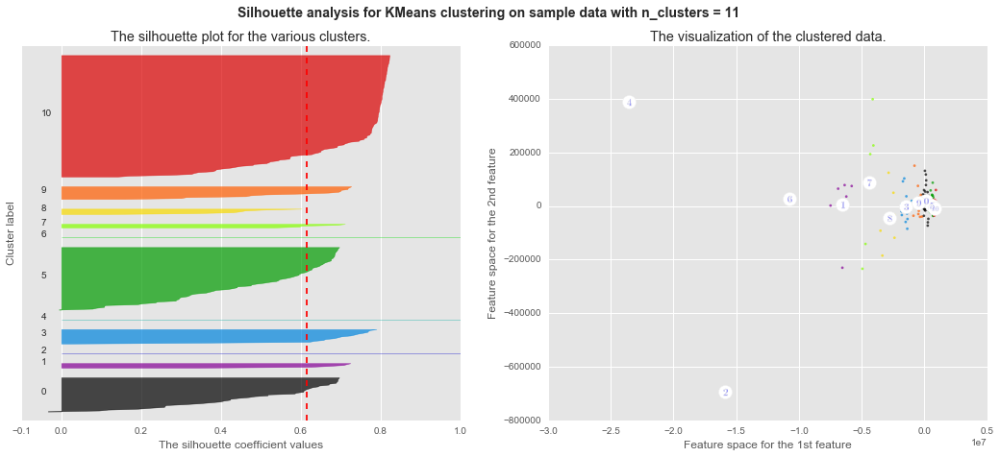

********************
Number of Components for PCA: 11
For n_clusters = 12 The average silhouette_score is : 0.610771051118


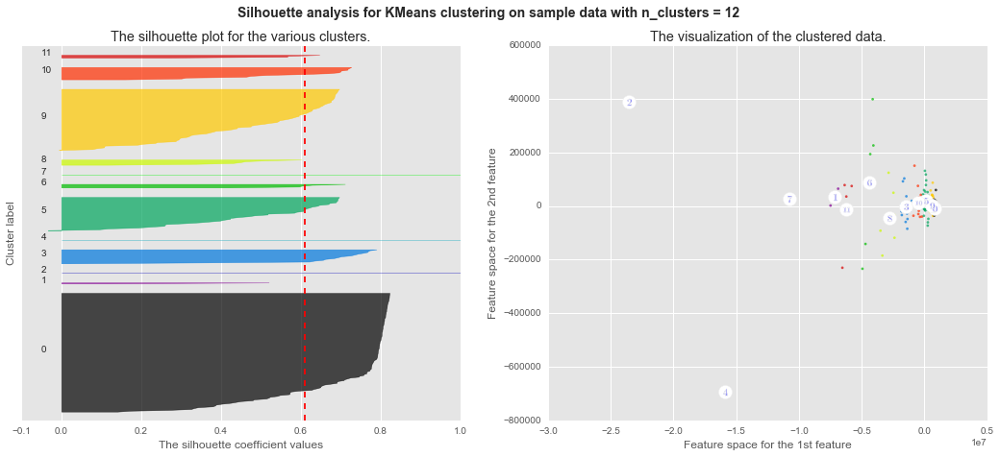

********************
Number of Components for PCA: 11
For n_clusters = 13 The average silhouette_score is : 0.613650433888


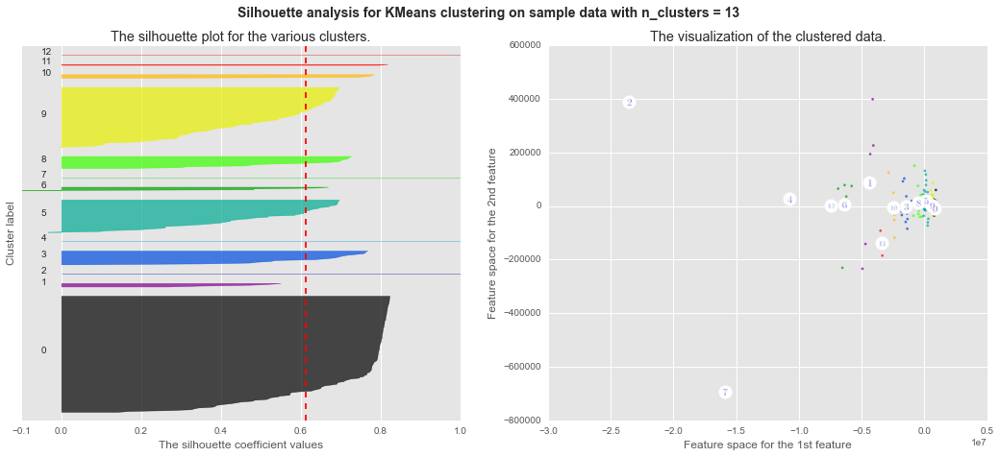

********************
Number of Components for PCA: 11
For n_clusters = 14 The average silhouette_score is : 0.615218242869


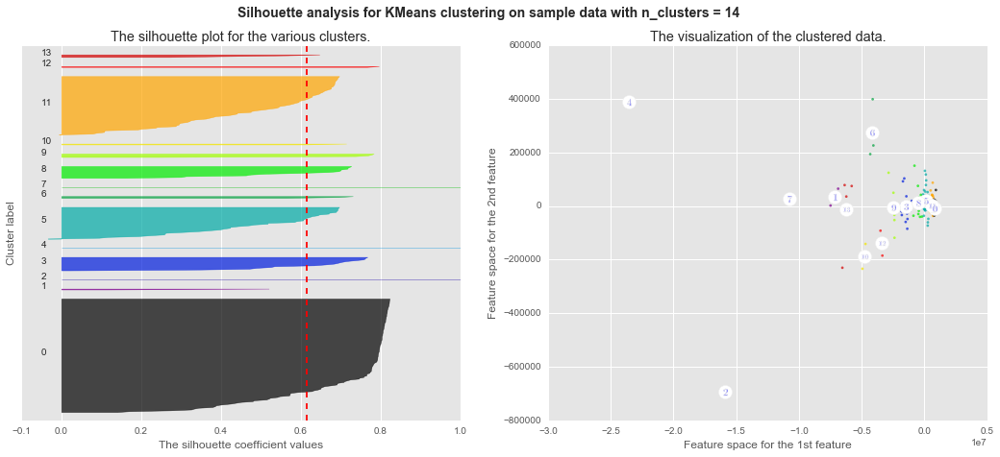

********************
Number of Components for PCA: 11
For n_clusters = 15 The average silhouette_score is : 0.605569062168


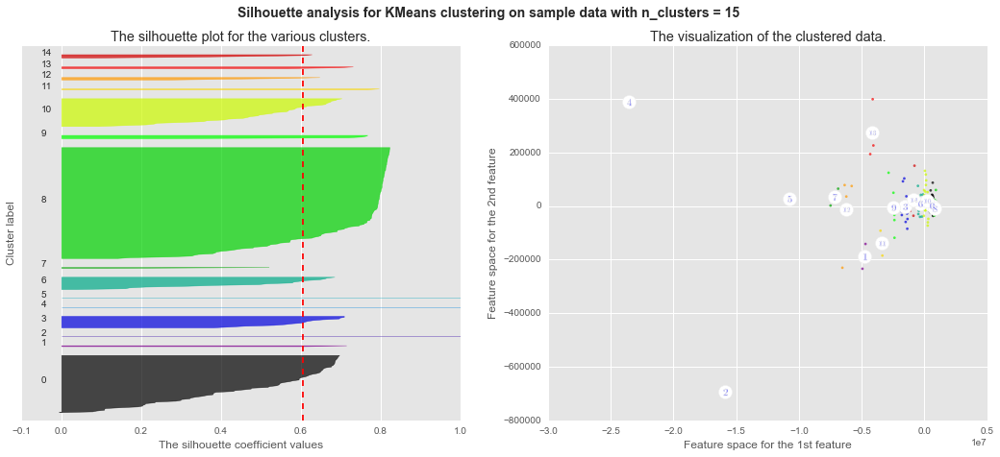

********************
Number of Components for PCA: 11
For n_clusters = 16 The average silhouette_score is : 0.59560983862


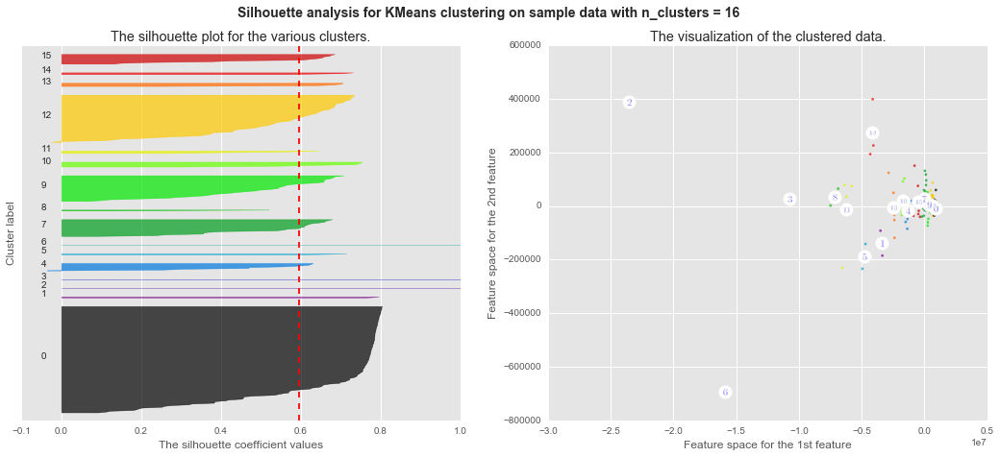

********************
Number of Components for PCA: 11
For n_clusters = 17 The average silhouette_score is : 0.596104085972


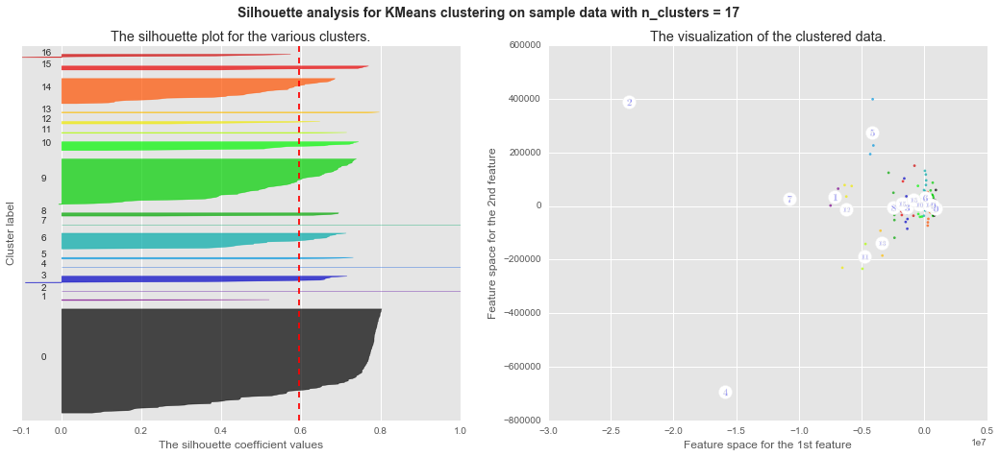

********************
Number of Components for PCA: 11
For n_clusters = 18 The average silhouette_score is : 0.546641220232


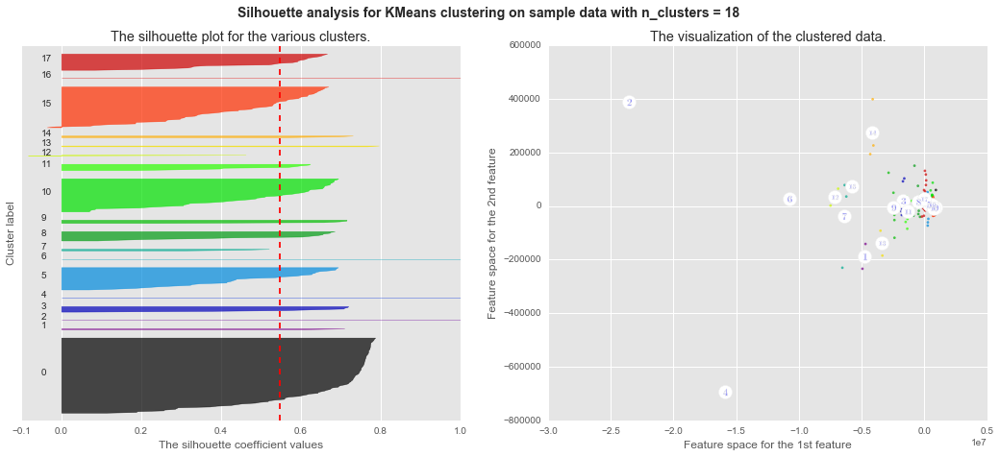

********************
Number of Components for PCA: 11
For n_clusters = 19 The average silhouette_score is : 0.550864922134


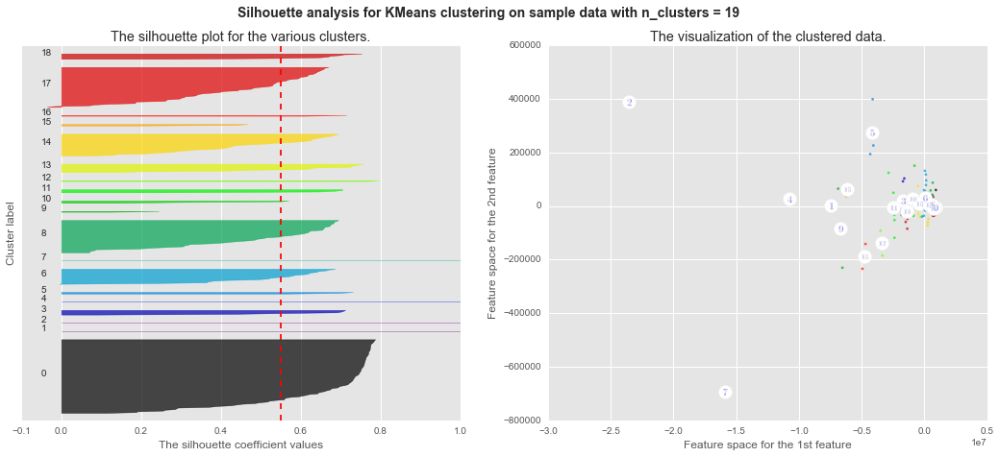

********************
Number of Components for PCA: 11
For n_clusters = 20 The average silhouette_score is : 0.552912980346


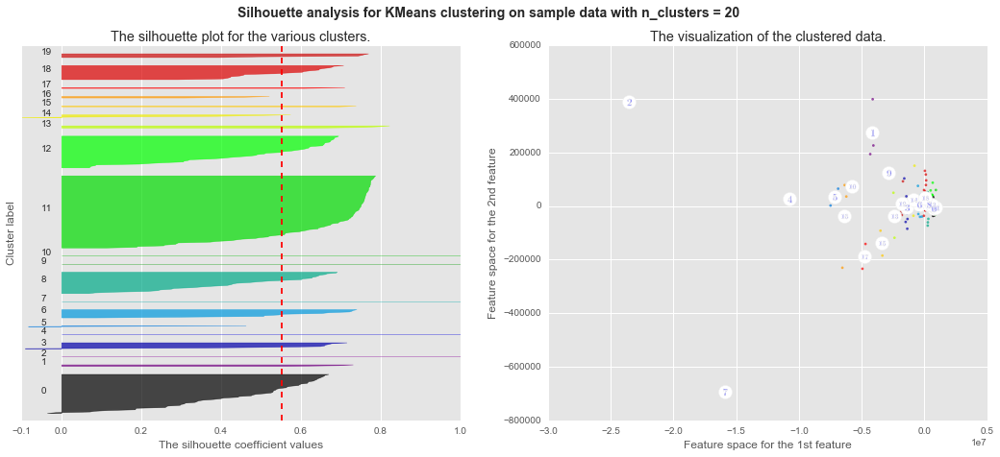

********************
Number of Components for PCA: 11
For n_clusters = 21 The average silhouette_score is : 0.542641788061


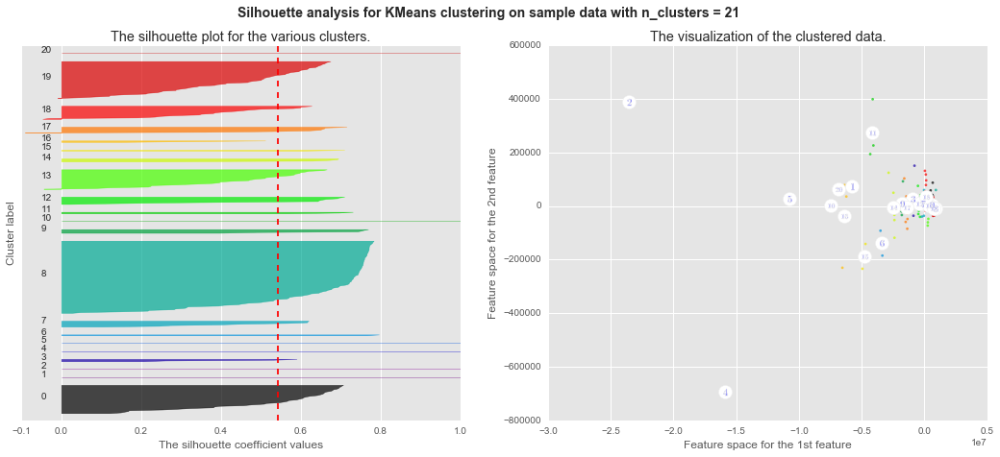

********************
Number of Components for PCA: 12
********************
********************
Number of Components for PCA: 12
For n_clusters = 4 The average silhouette_score is : 0.794910222409


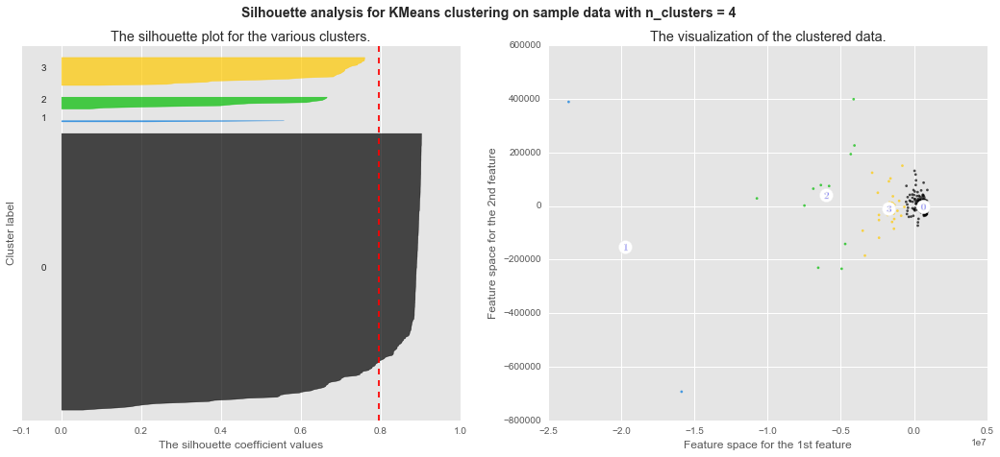

********************
Number of Components for PCA: 12
For n_clusters = 5 The average silhouette_score is : 0.798095915723


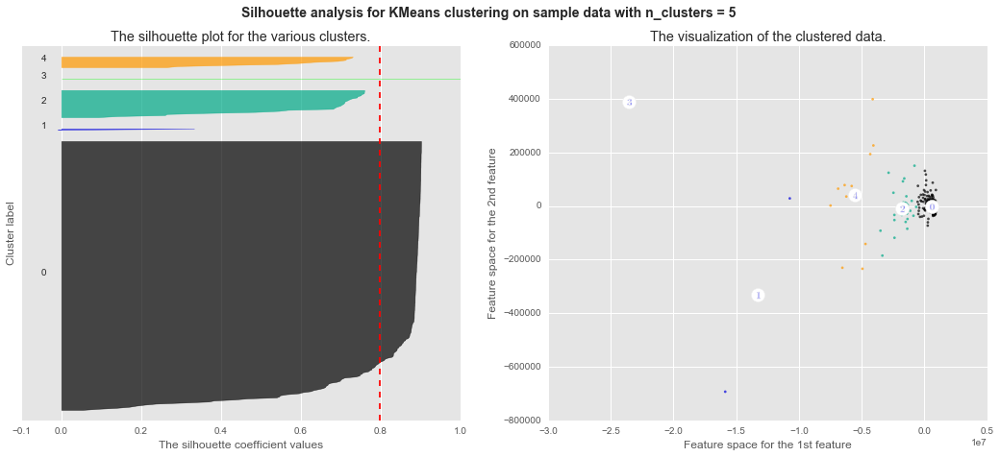

********************
Number of Components for PCA: 12
For n_clusters = 6 The average silhouette_score is : 0.683324610495


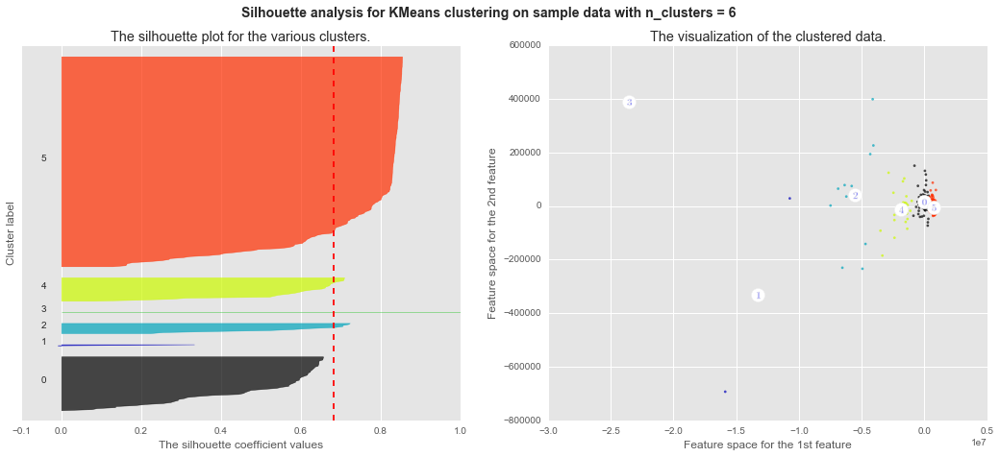

********************
Number of Components for PCA: 12
For n_clusters = 7 The average silhouette_score is : 0.686793226984


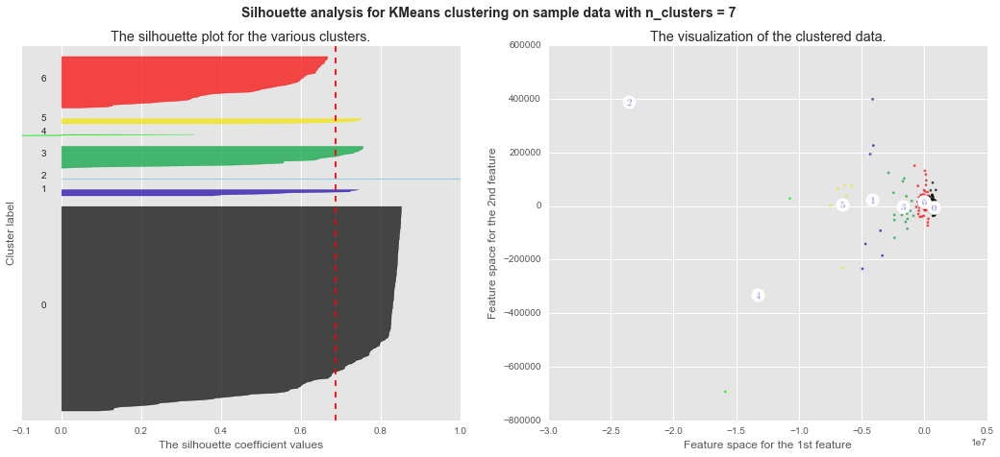

********************
Number of Components for PCA: 12
For n_clusters = 8 The average silhouette_score is : 0.692963547436


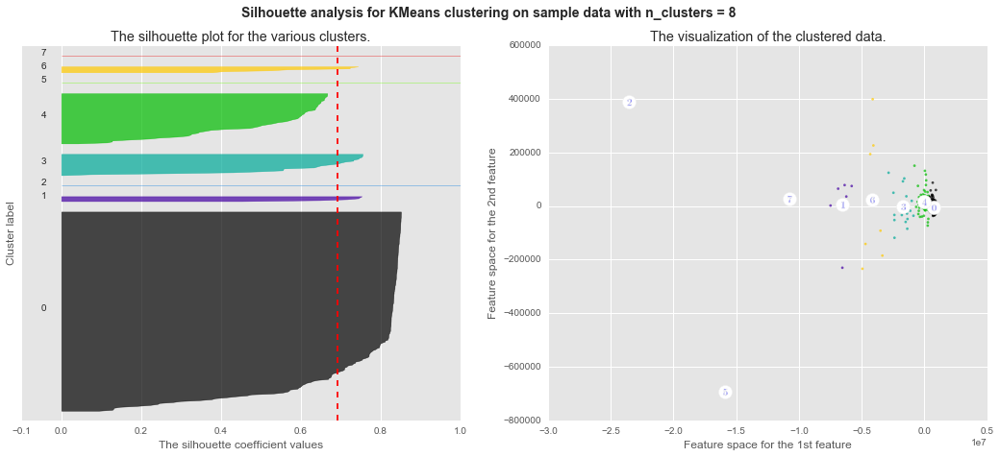

********************
Number of Components for PCA: 12
For n_clusters = 9 The average silhouette_score is : 0.6558740294


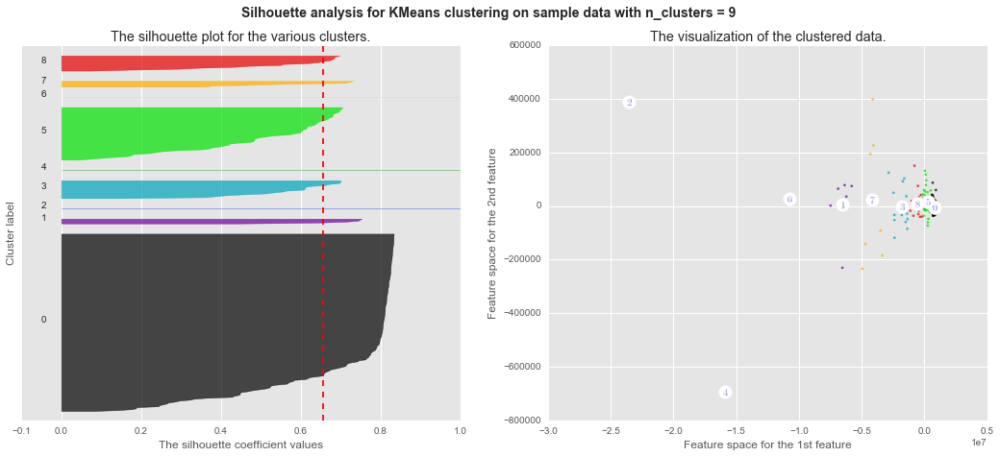

********************
Number of Components for PCA: 12
For n_clusters = 10 The average silhouette_score is : 0.61719895541


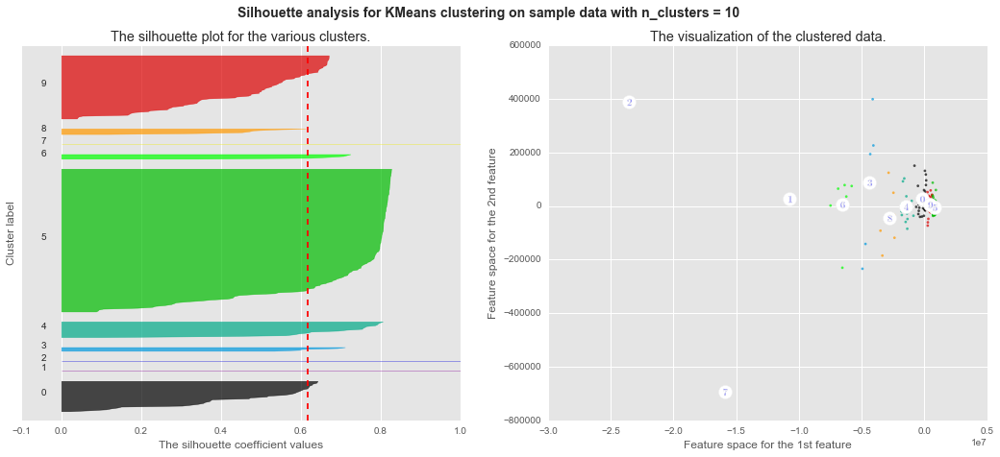

********************
Number of Components for PCA: 12
For n_clusters = 11 The average silhouette_score is : 0.614409823047


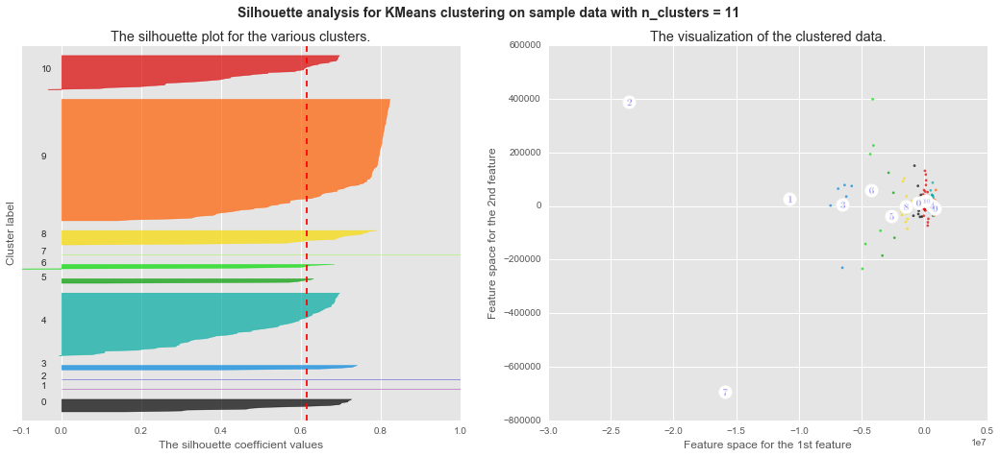

********************
Number of Components for PCA: 12
For n_clusters = 12 The average silhouette_score is : 0.610242379071


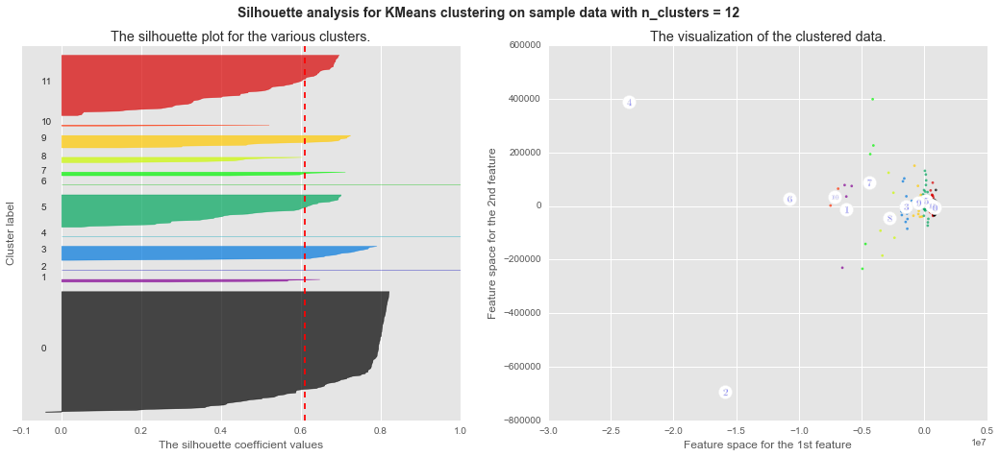

********************
Number of Components for PCA: 12
For n_clusters = 13 The average silhouette_score is : 0.611905340348


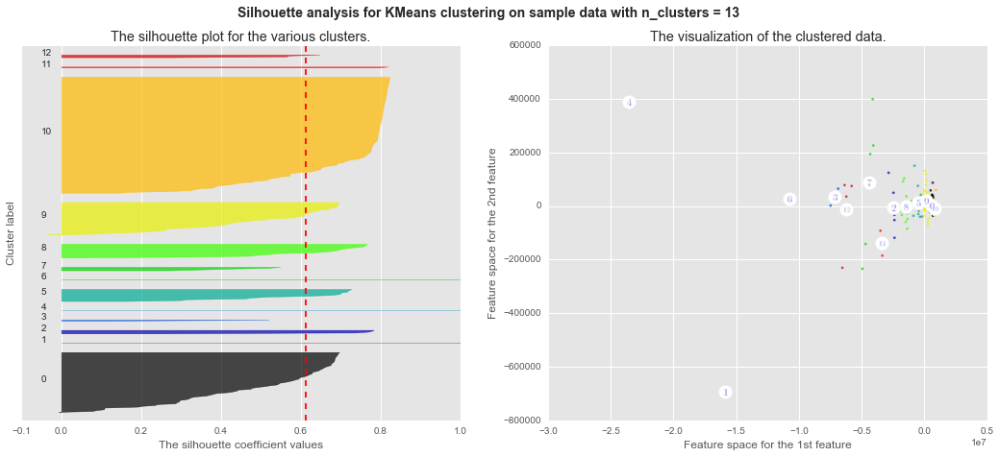

********************
Number of Components for PCA: 12
For n_clusters = 14 The average silhouette_score is : 0.595749979429


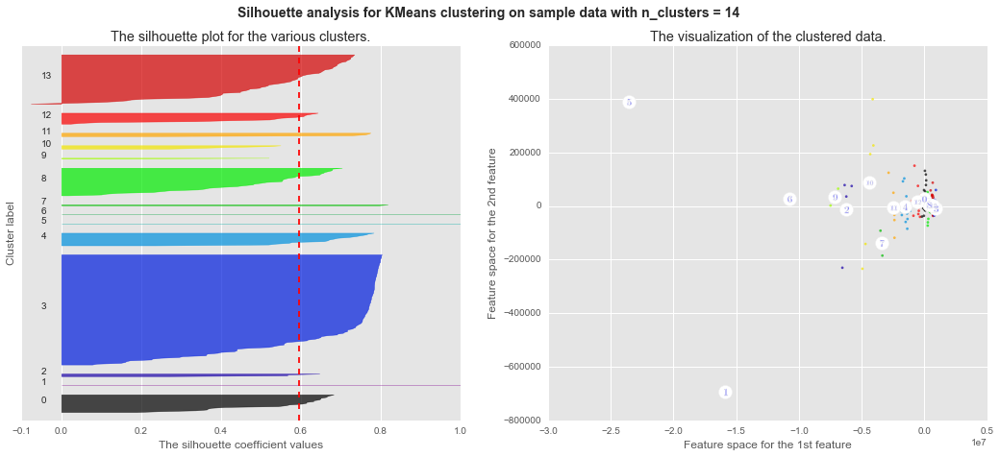

********************
Number of Components for PCA: 12
For n_clusters = 15 The average silhouette_score is : 0.59037247776


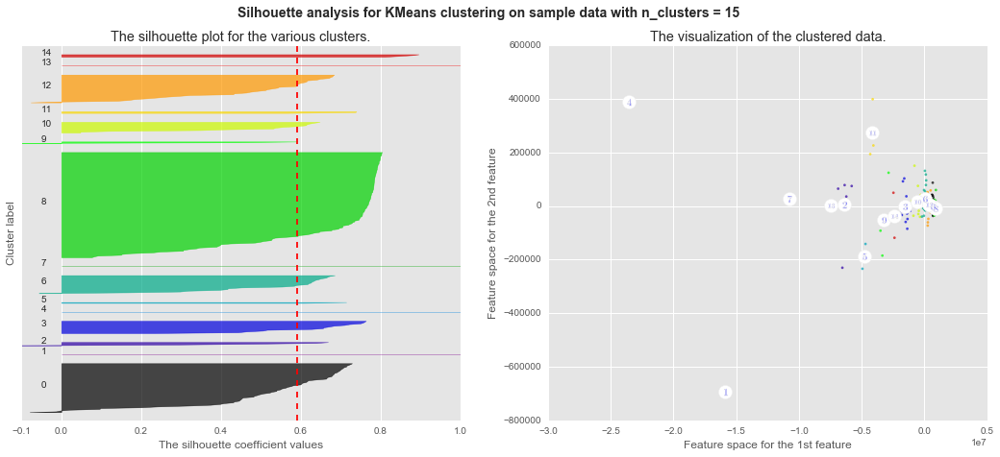

********************
Number of Components for PCA: 12
For n_clusters = 16 The average silhouette_score is : 0.596540473725


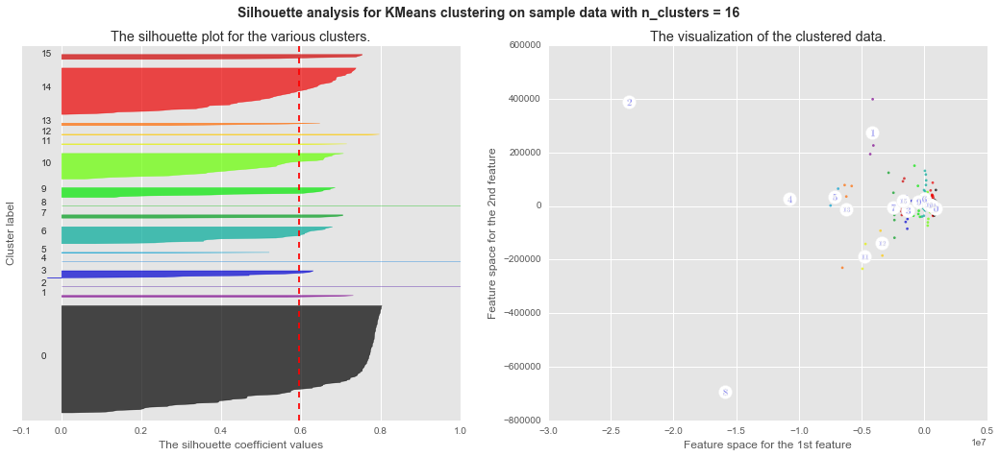

********************
Number of Components for PCA: 12
For n_clusters = 17 The average silhouette_score is : 0.547429859216


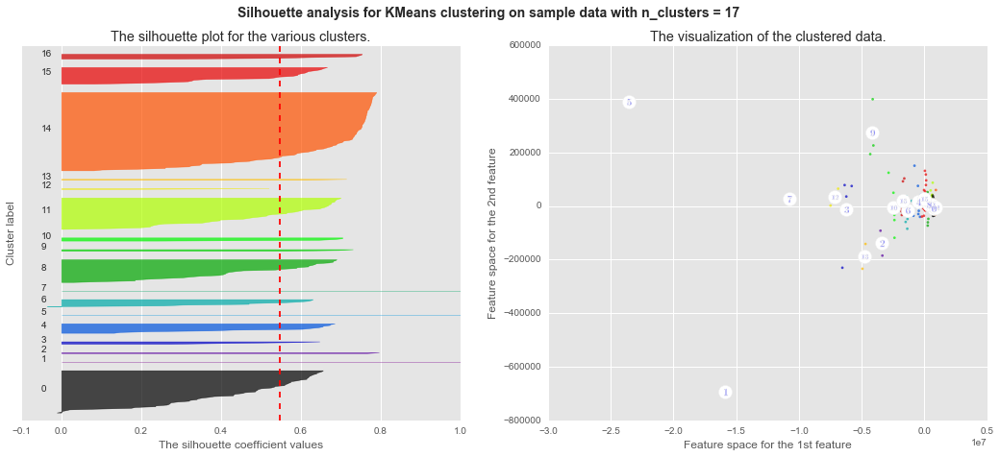

********************
Number of Components for PCA: 12
For n_clusters = 18 The average silhouette_score is : 0.597804841327


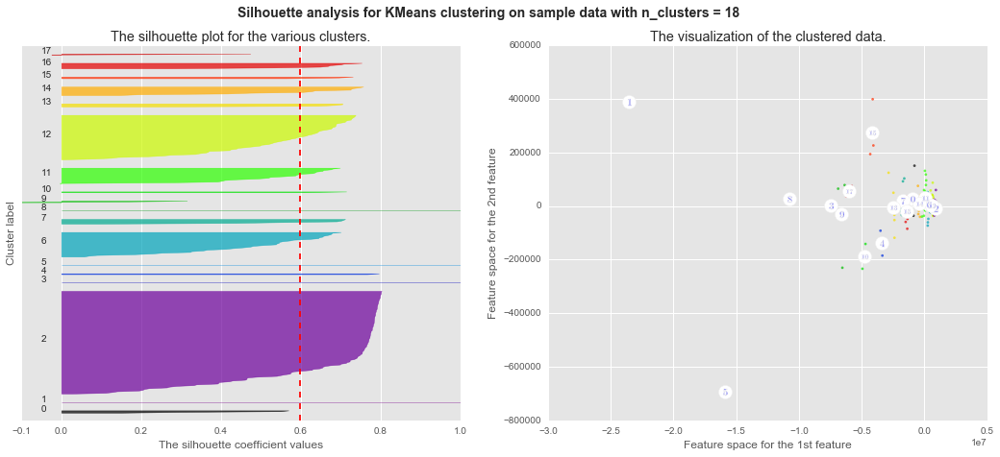

********************
Number of Components for PCA: 12
For n_clusters = 19 The average silhouette_score is : 0.548553214851


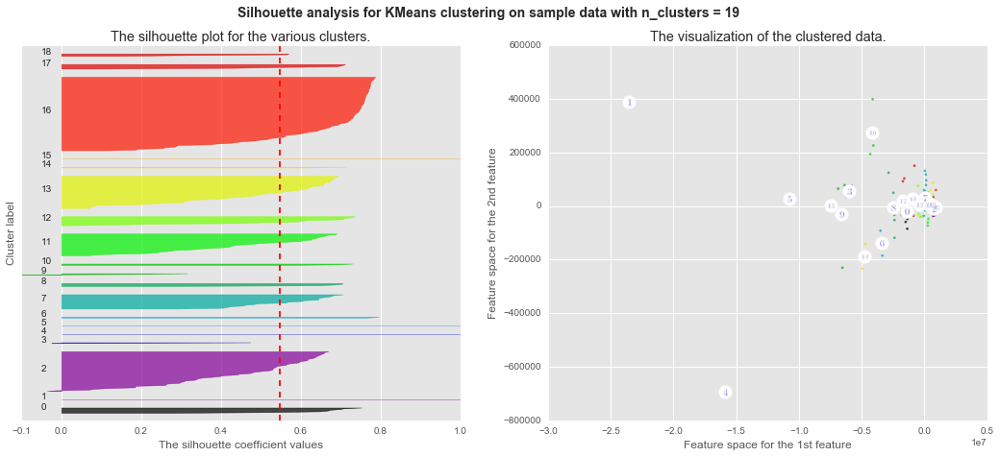

********************
Number of Components for PCA: 12
For n_clusters = 20 The average silhouette_score is : 0.543948300017


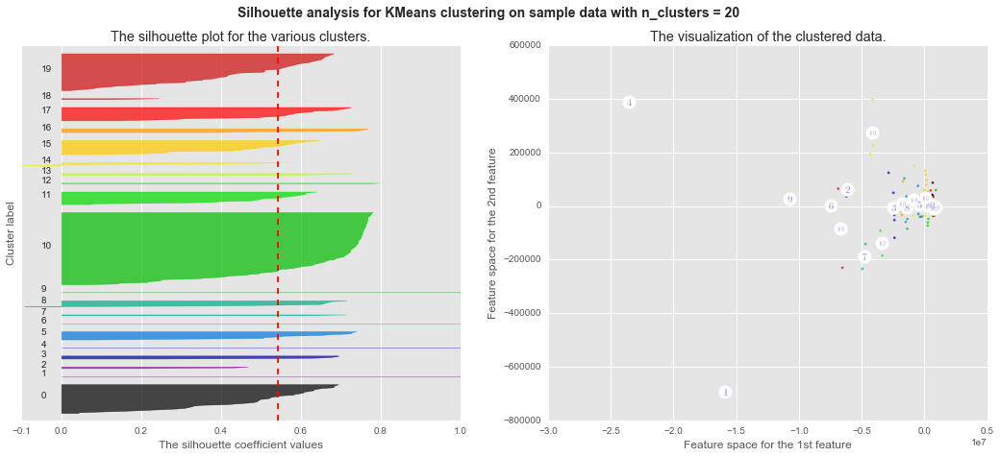

********************
Number of Components for PCA: 12
For n_clusters = 21 The average silhouette_score is : 0.542658210416


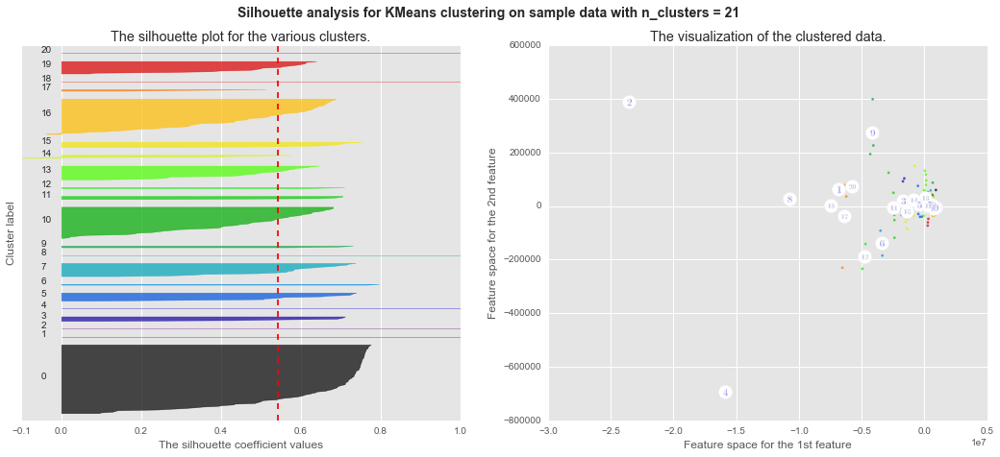

********************
Number of Components for PCA: 13
********************
********************
Number of Components for PCA: 13
For n_clusters = 4 The average silhouette_score is : 0.794910213234


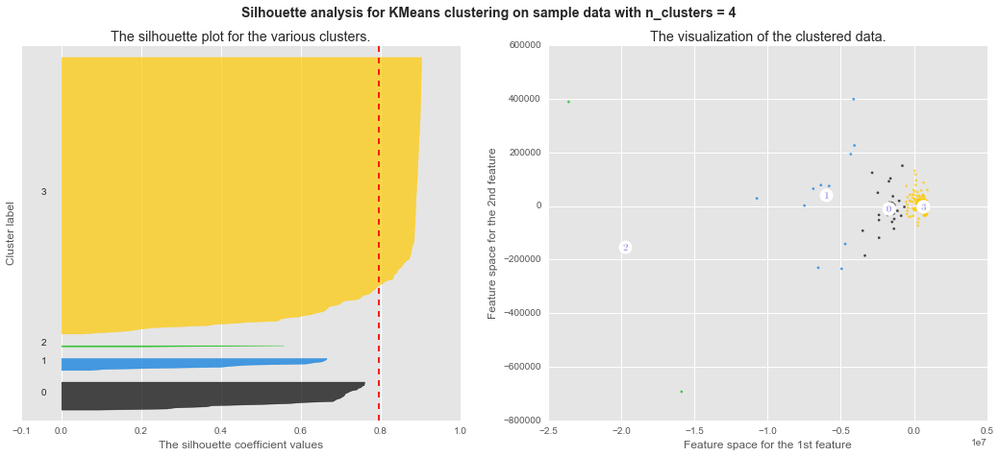

********************
Number of Components for PCA: 13
For n_clusters = 5 The average silhouette_score is : 0.798095906542


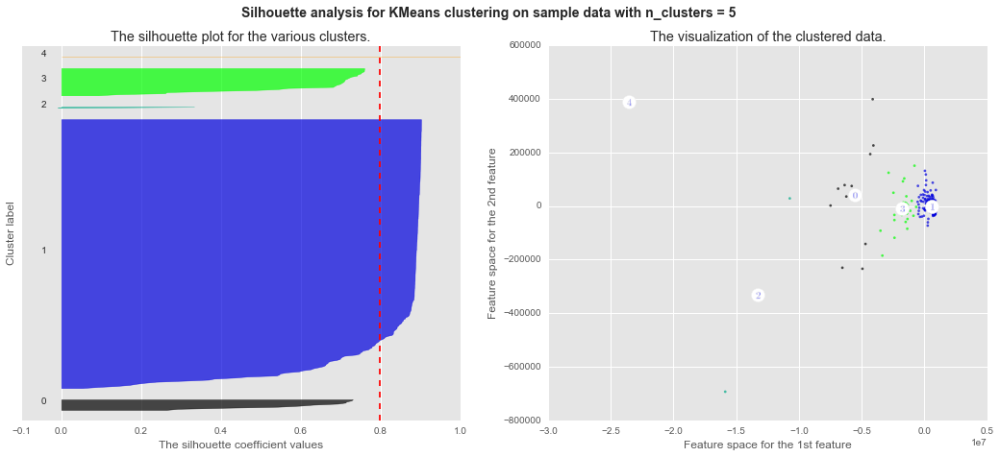

********************
Number of Components for PCA: 13
For n_clusters = 6 The average silhouette_score is : 0.683324577185


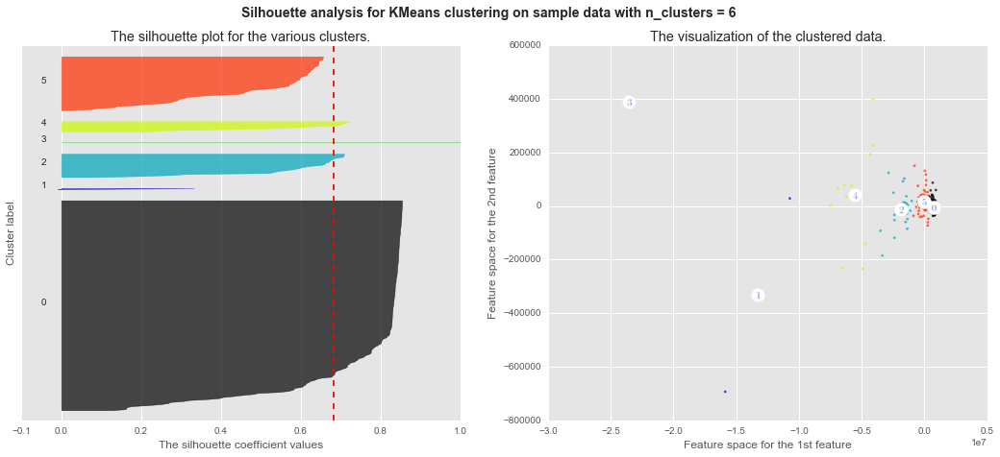

********************
Number of Components for PCA: 13
For n_clusters = 7 The average silhouette_score is : 0.686594406393


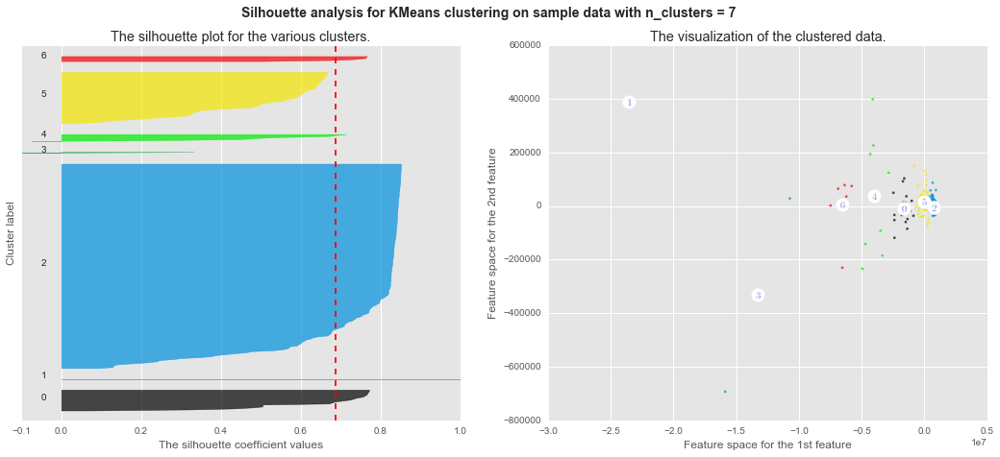

********************
Number of Components for PCA: 13
For n_clusters = 8 The average silhouette_score is : 0.692963513441


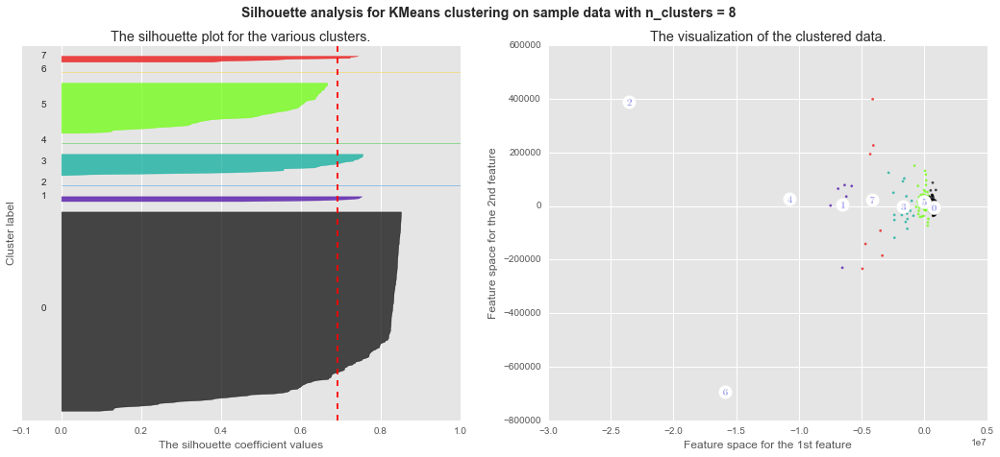

********************
Number of Components for PCA: 13
For n_clusters = 9 The average silhouette_score is : 0.655873970936


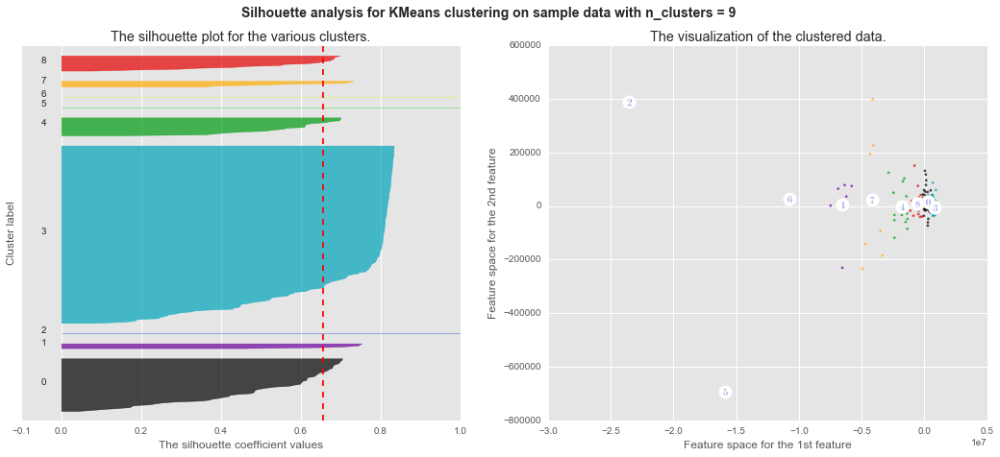

********************
Number of Components for PCA: 13
For n_clusters = 10 The average silhouette_score is : 0.617198858846


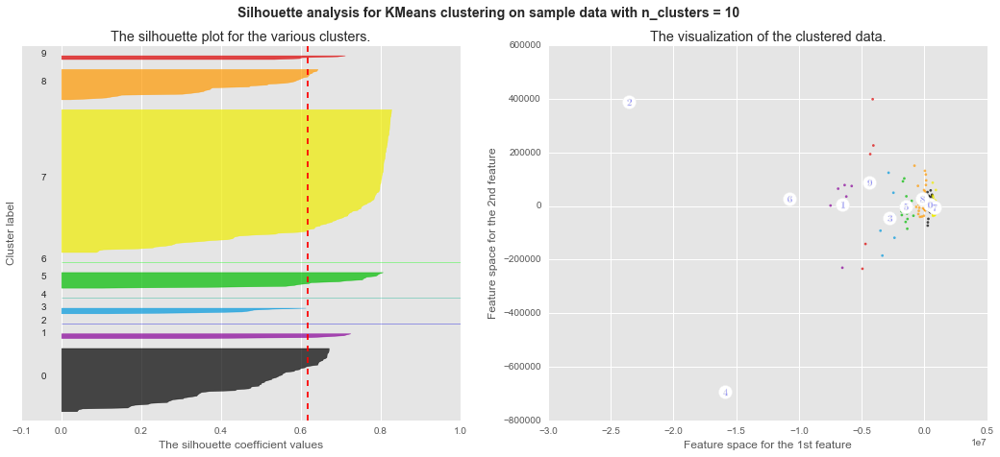

********************
Number of Components for PCA: 13
For n_clusters = 11 The average silhouette_score is : 0.615243202019


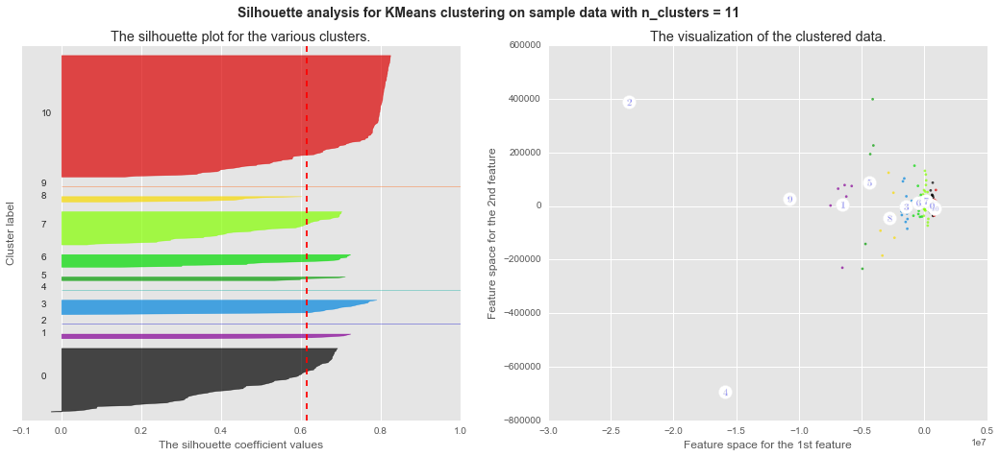

********************
Number of Components for PCA: 13
For n_clusters = 12 The average silhouette_score is : 0.615784733028


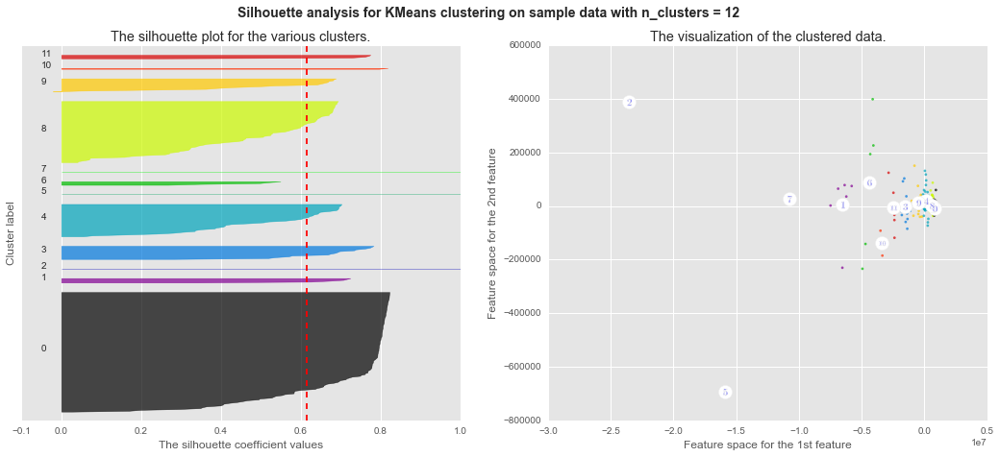

********************
Number of Components for PCA: 13
For n_clusters = 13 The average silhouette_score is : 0.609750428005


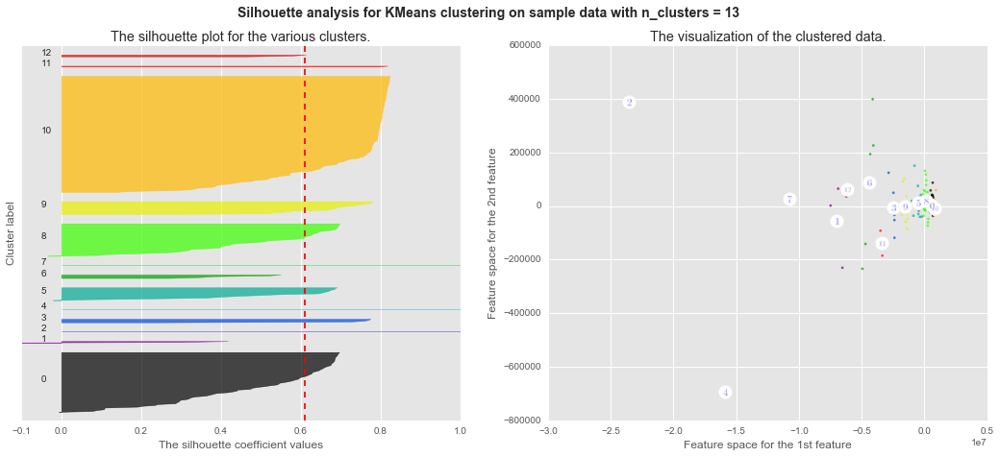

********************
Number of Components for PCA: 13
For n_clusters = 14 The average silhouette_score is : 0.615318487584


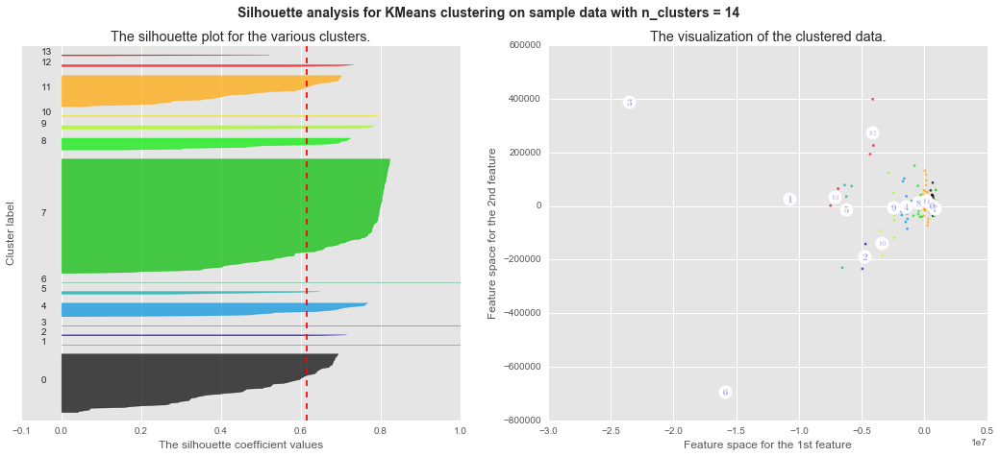

********************
Number of Components for PCA: 13
For n_clusters = 15 The average silhouette_score is : 0.598589019009


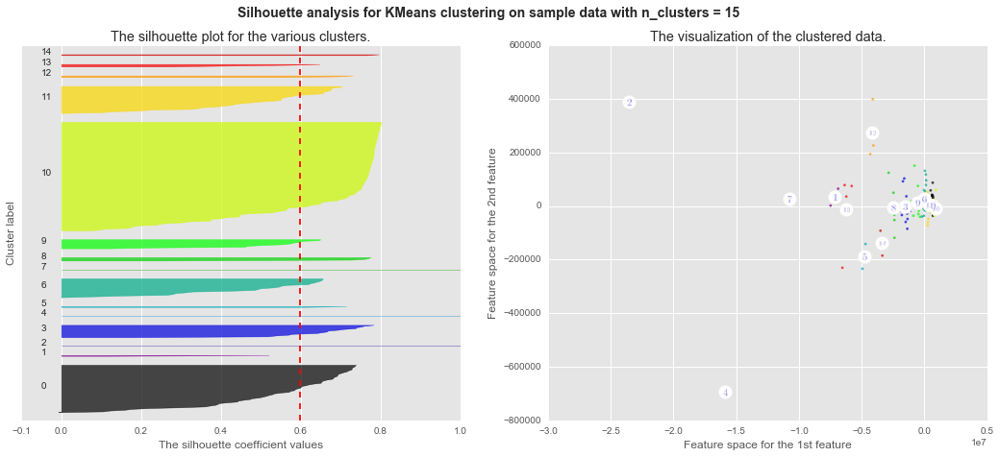

********************
Number of Components for PCA: 13
For n_clusters = 16 The average silhouette_score is : 0.596540287213


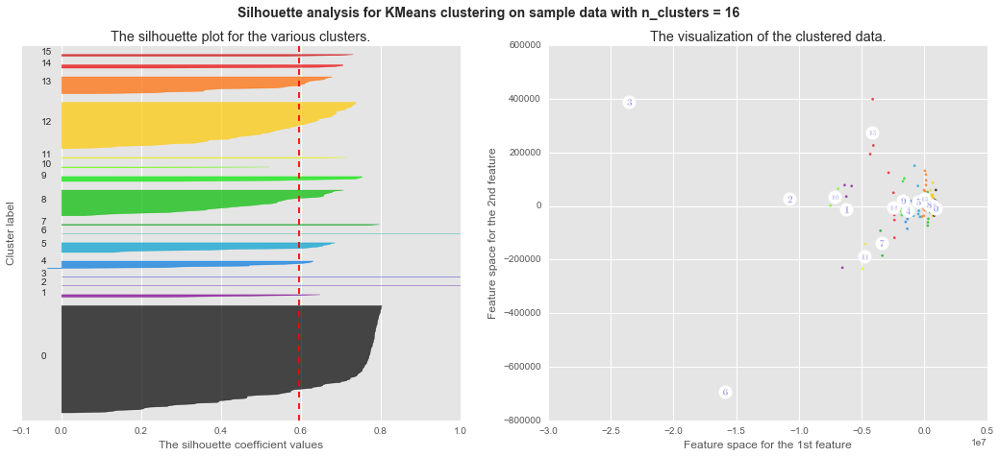

********************
Number of Components for PCA: 13
For n_clusters = 17 The average silhouette_score is : 0.53667129304


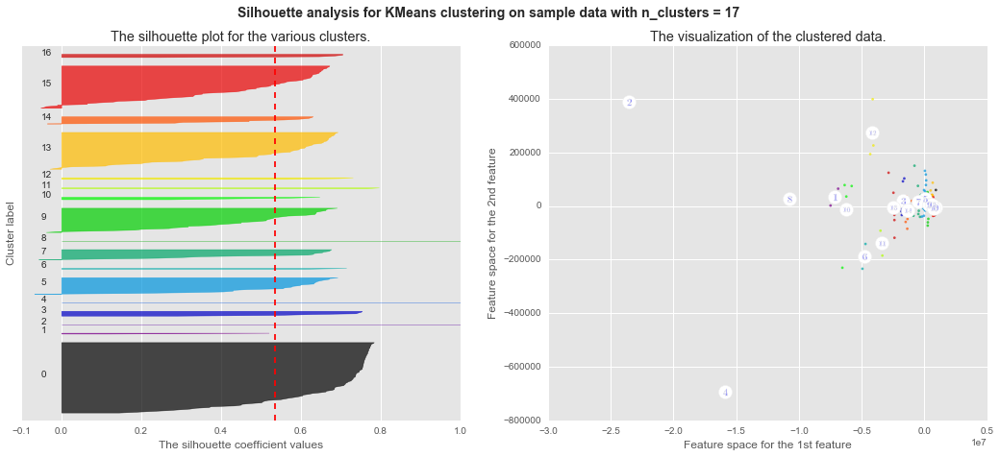

********************
Number of Components for PCA: 13
For n_clusters = 18 The average silhouette_score is : 0.548125473446


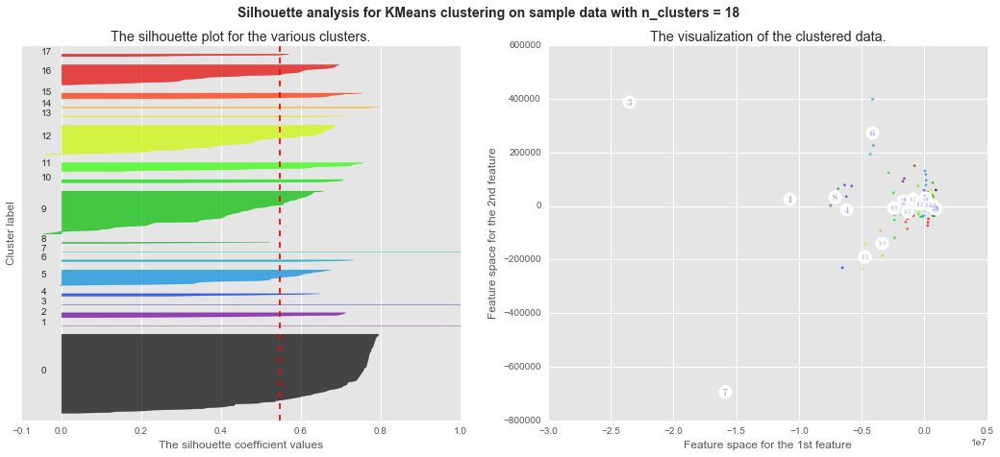

********************
Number of Components for PCA: 13
For n_clusters = 19 The average silhouette_score is : 0.551350671836


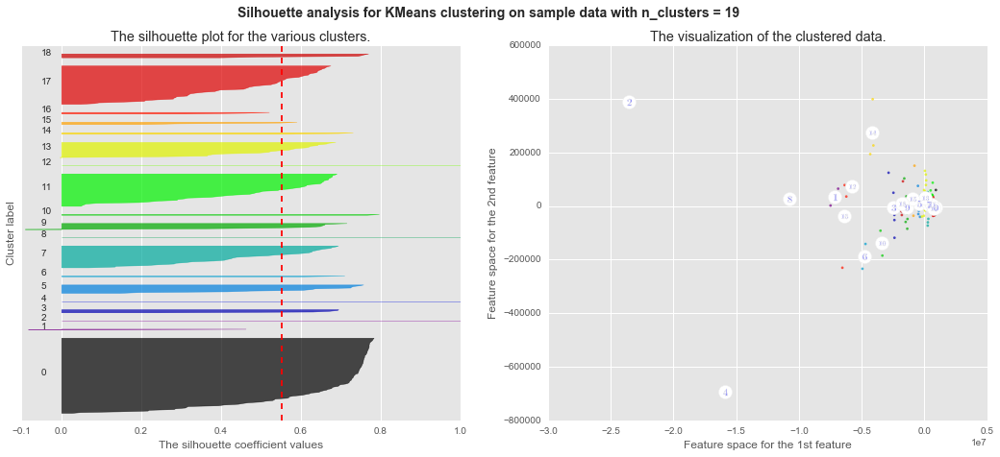

********************
Number of Components for PCA: 13
For n_clusters = 20 The average silhouette_score is : 0.551460703534


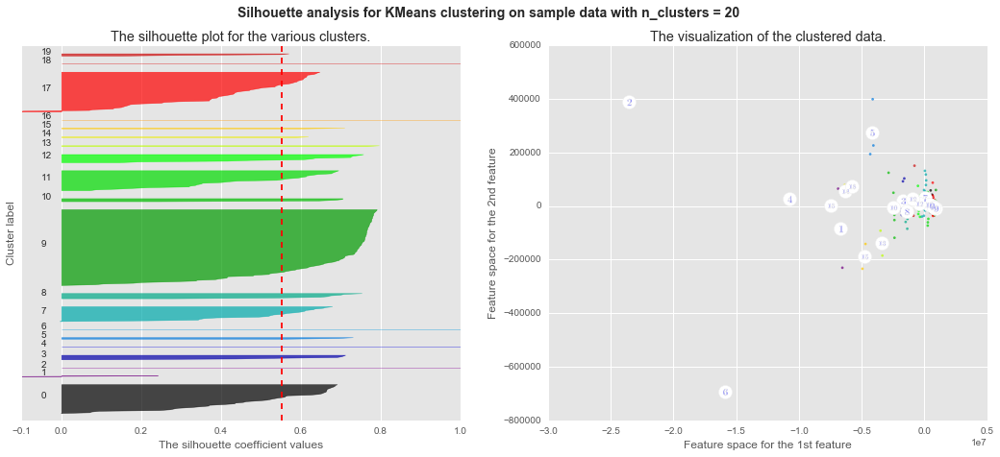

********************
Number of Components for PCA: 13
For n_clusters = 21 The average silhouette_score is : 0.544945944246


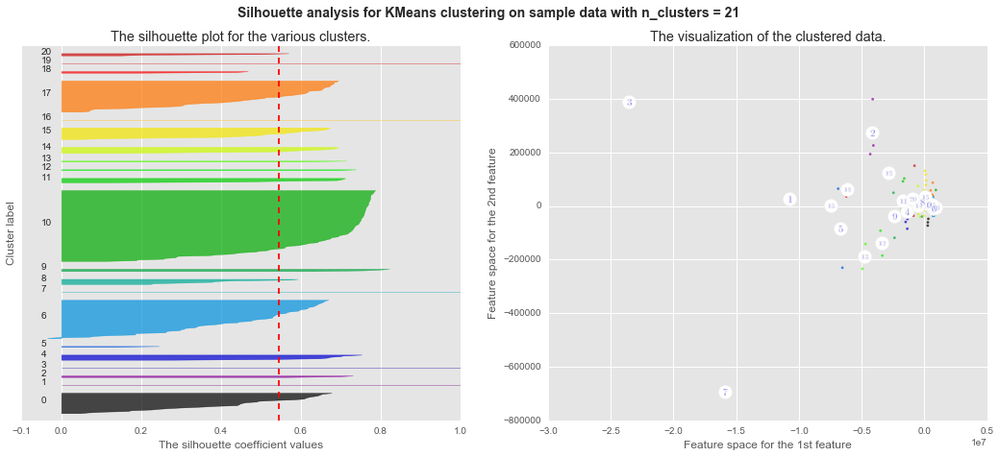

********************
Number of Components for PCA: 14
********************
********************
Number of Components for PCA: 14
For n_clusters = 4 The average silhouette_score is : 0.794910209332


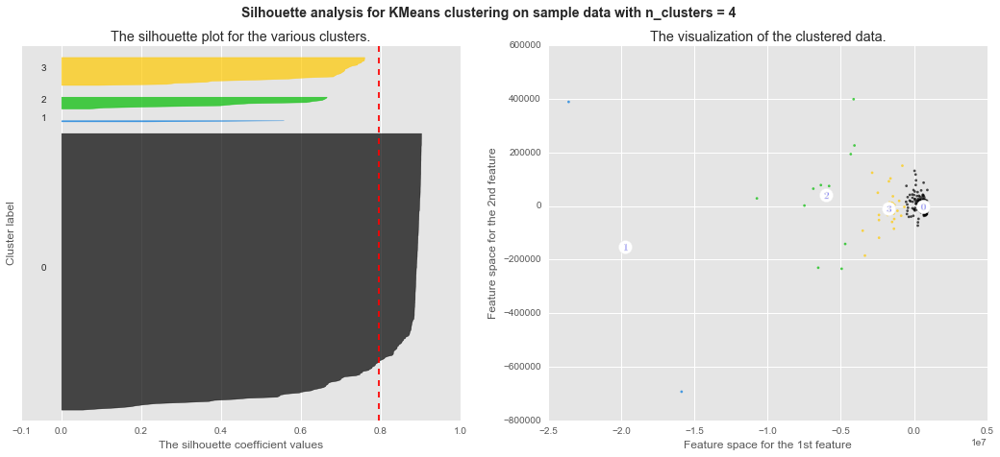

********************
Number of Components for PCA: 14
For n_clusters = 5 The average silhouette_score is : 0.798095902638


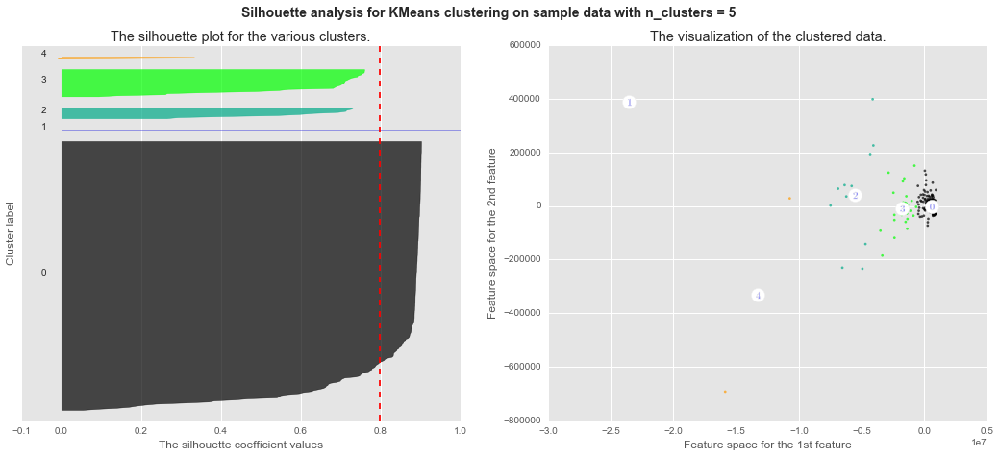

********************
Number of Components for PCA: 14
For n_clusters = 6 The average silhouette_score is : 0.683324563151


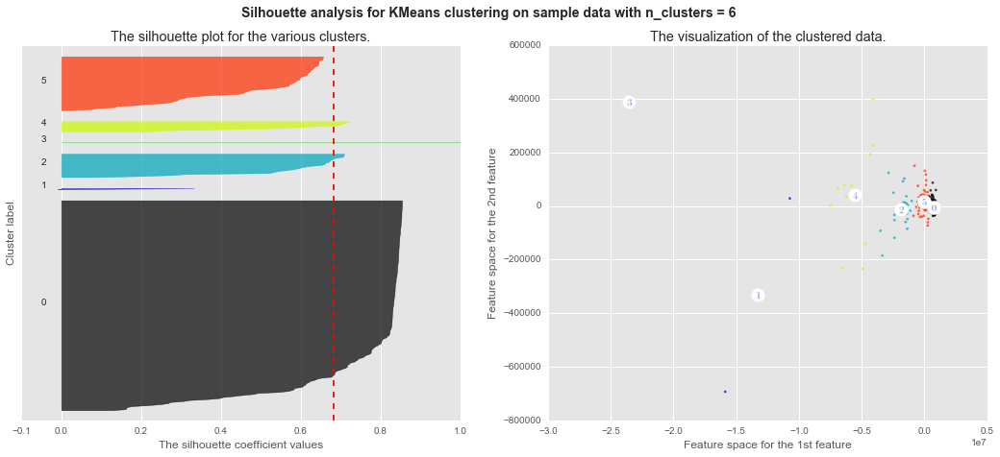

********************
Number of Components for PCA: 14
For n_clusters = 7 The average silhouette_score is : 0.68622246644


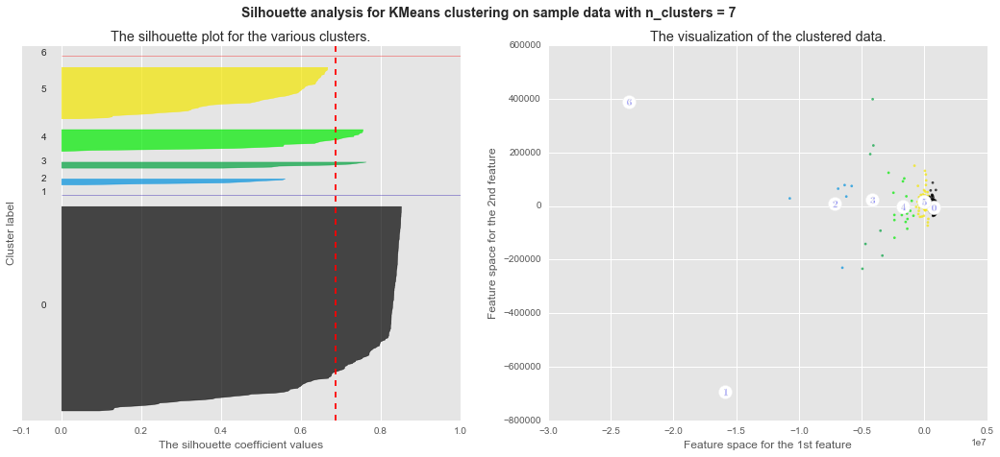

********************
Number of Components for PCA: 14
For n_clusters = 8 The average silhouette_score is : 0.692963499096


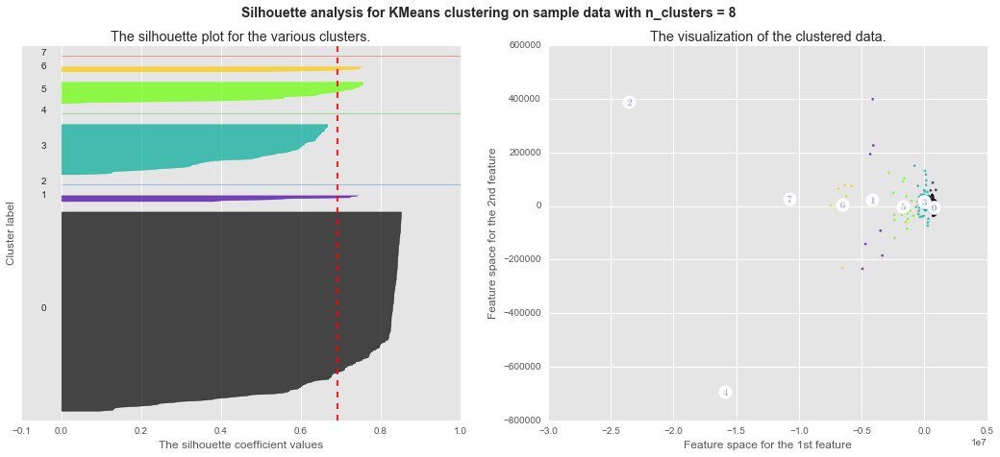

********************
Number of Components for PCA: 14
For n_clusters = 9 The average silhouette_score is : 0.655873948674


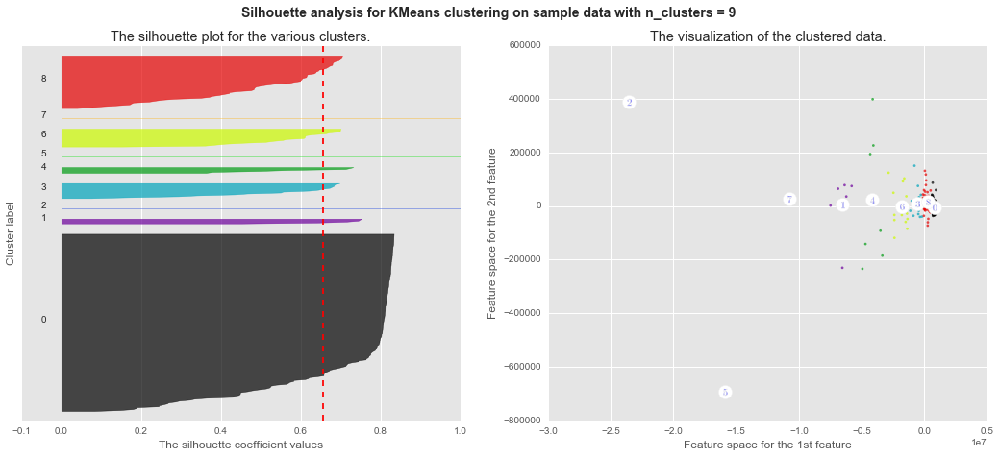

********************
Number of Components for PCA: 14
For n_clusters = 10 The average silhouette_score is : 0.632024393488


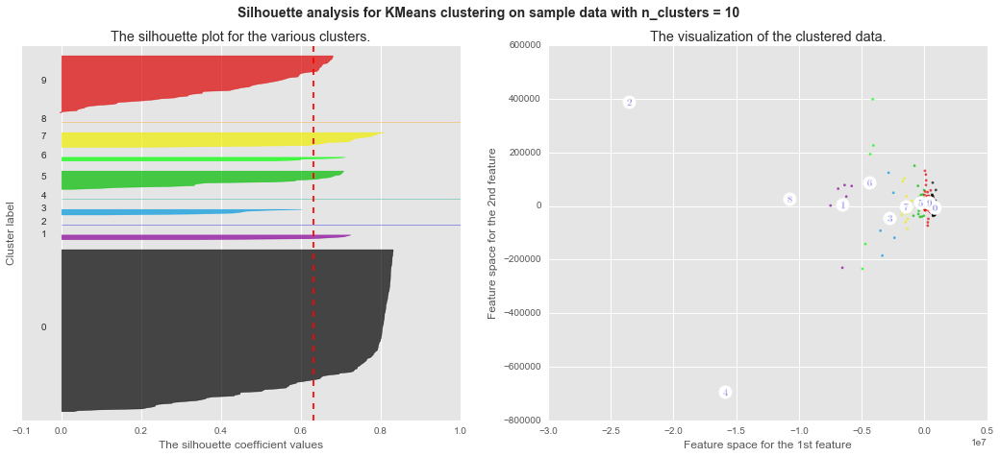

********************
Number of Components for PCA: 14
For n_clusters = 11 The average silhouette_score is : 0.615243151566


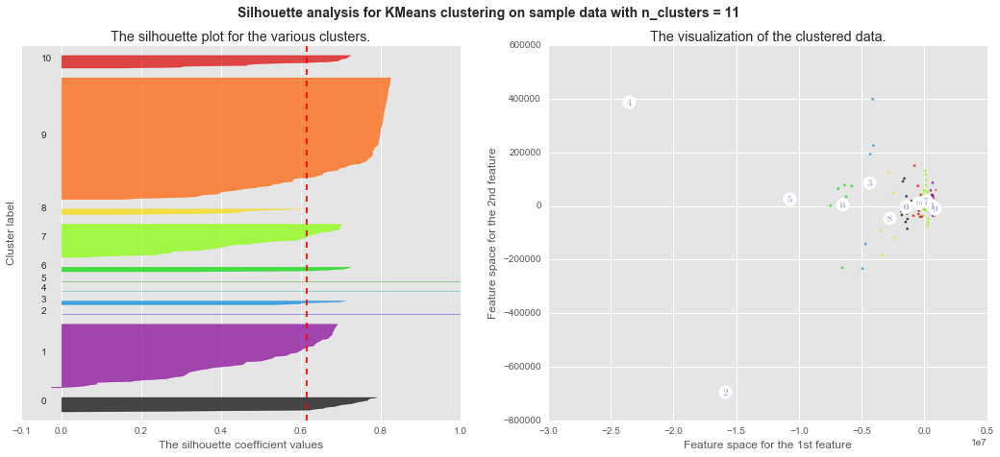

********************
Number of Components for PCA: 14
For n_clusters = 12 The average silhouette_score is : 0.615833465222


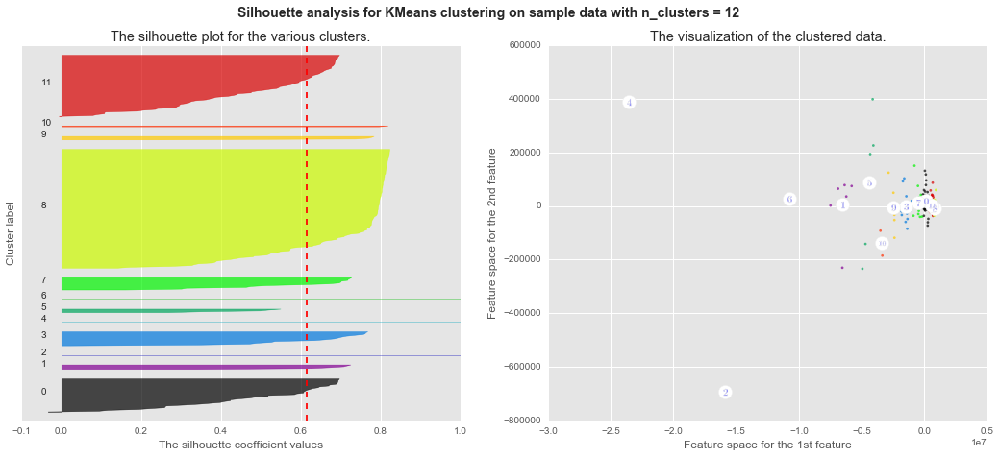

********************
Number of Components for PCA: 14
For n_clusters = 13 The average silhouette_score is : 0.612005736799


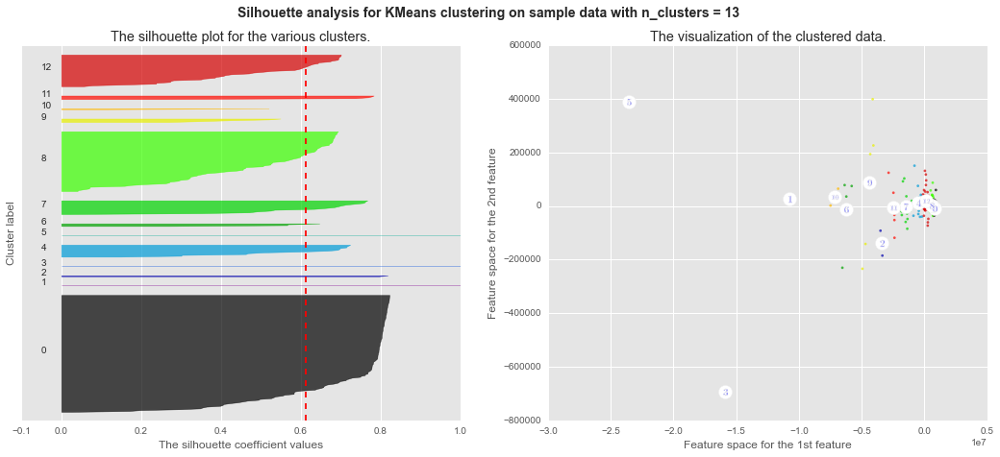

********************
Number of Components for PCA: 14
For n_clusters = 14 The average silhouette_score is : 0.582974143221


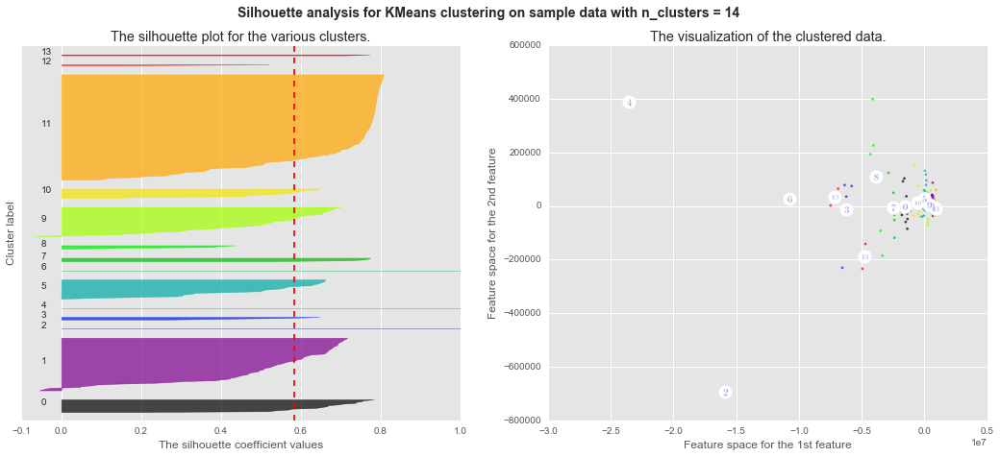

********************
Number of Components for PCA: 14
For n_clusters = 15 The average silhouette_score is : 0.600123239866


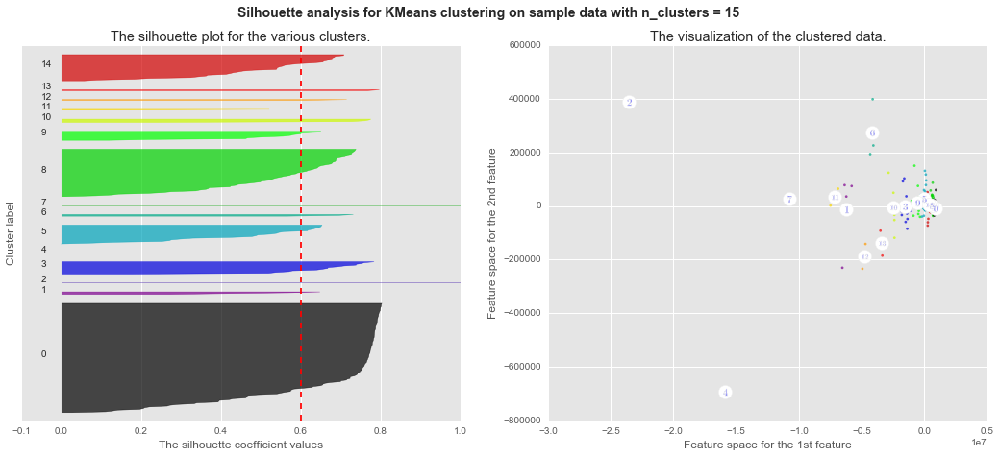

********************
Number of Components for PCA: 14
For n_clusters = 16 The average silhouette_score is : 0.594165860143


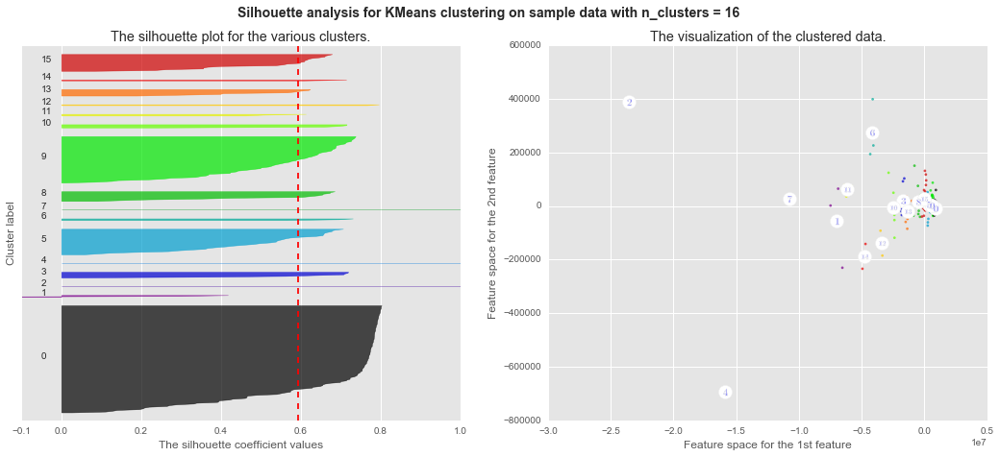

********************
Number of Components for PCA: 14
For n_clusters = 17 The average silhouette_score is : 0.596135838634


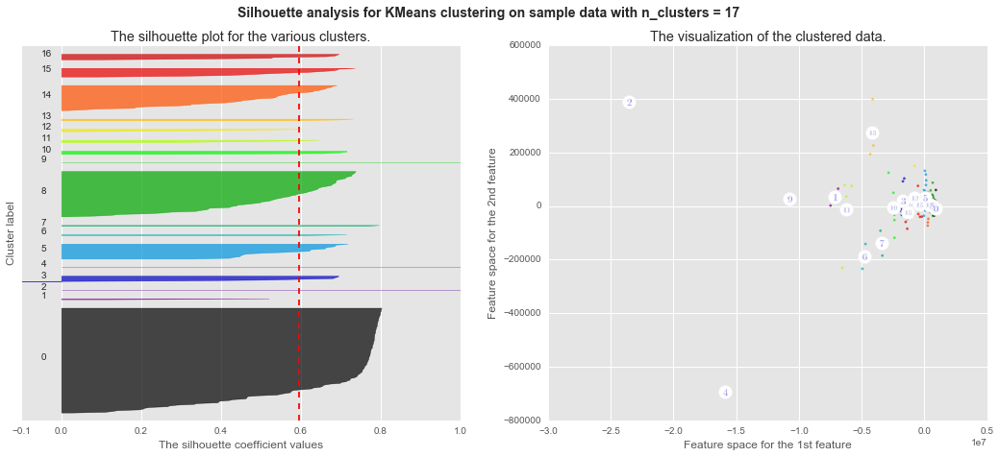

********************
Number of Components for PCA: 14
For n_clusters = 18 The average silhouette_score is : 0.54671834598


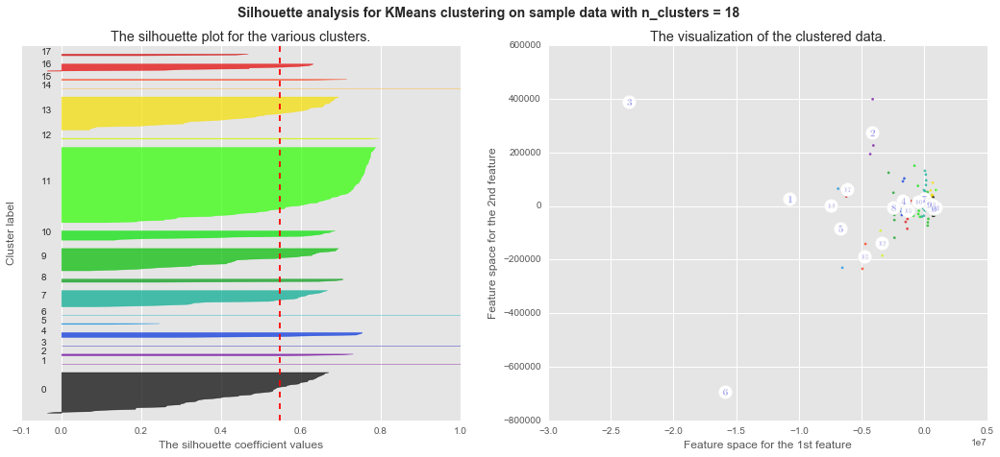

********************
Number of Components for PCA: 14
For n_clusters = 19 The average silhouette_score is : 0.527478057107


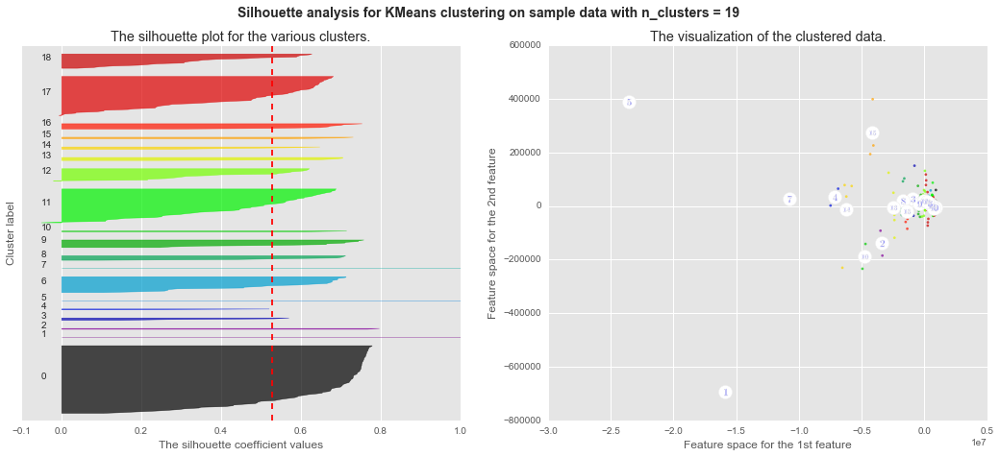

********************
Number of Components for PCA: 14
For n_clusters = 20 The average silhouette_score is : 0.542099165912


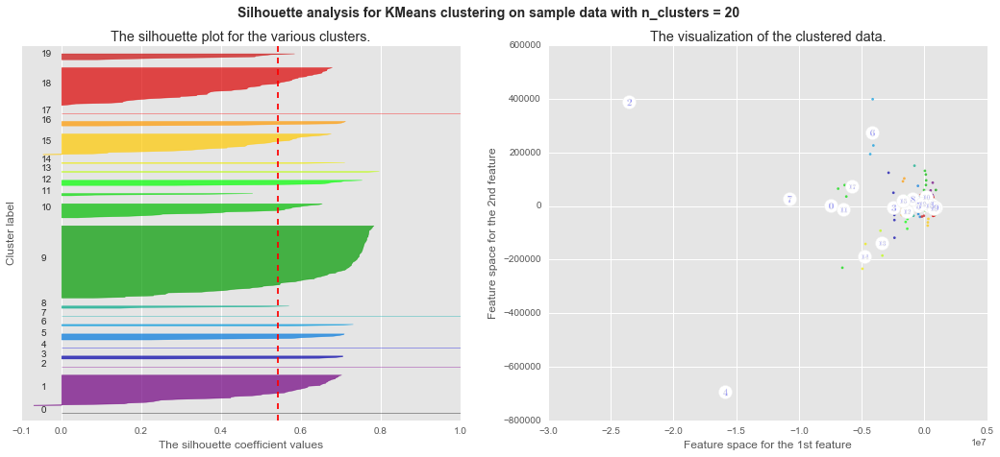

********************
Number of Components for PCA: 14
For n_clusters = 21 The average silhouette_score is : 0.549892289456


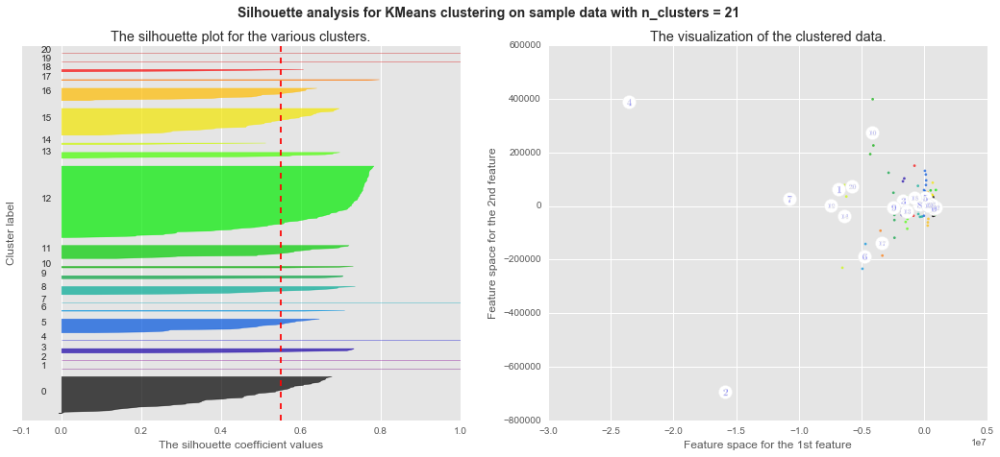

********************
Number of Components for PCA: 15
********************
********************
Number of Components for PCA: 15
For n_clusters = 4 The average silhouette_score is : 0.794910208073


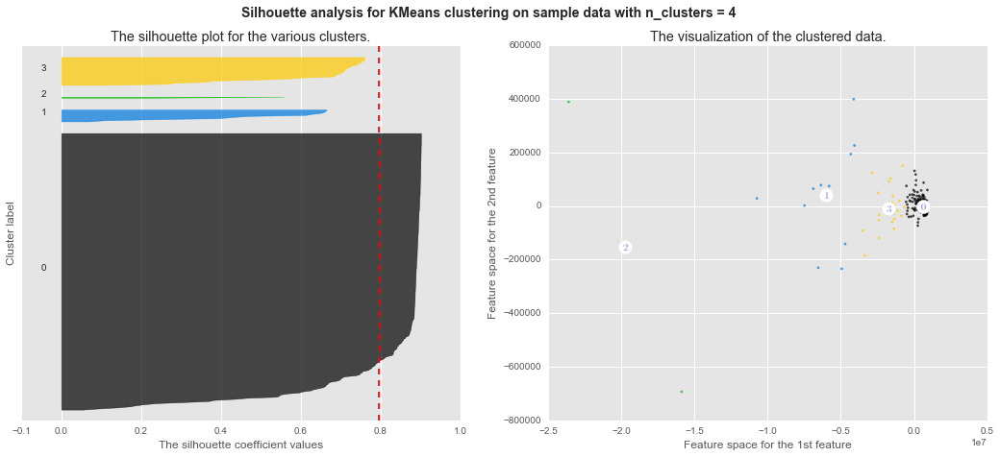

********************
Number of Components for PCA: 15
For n_clusters = 5 The average silhouette_score is : 0.798095901378


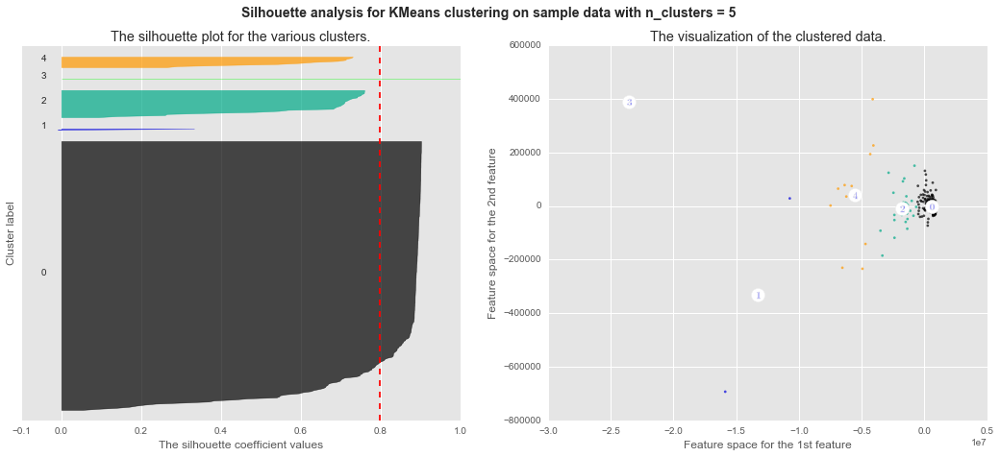

********************
Number of Components for PCA: 15
For n_clusters = 6 The average silhouette_score is : 0.683324558444


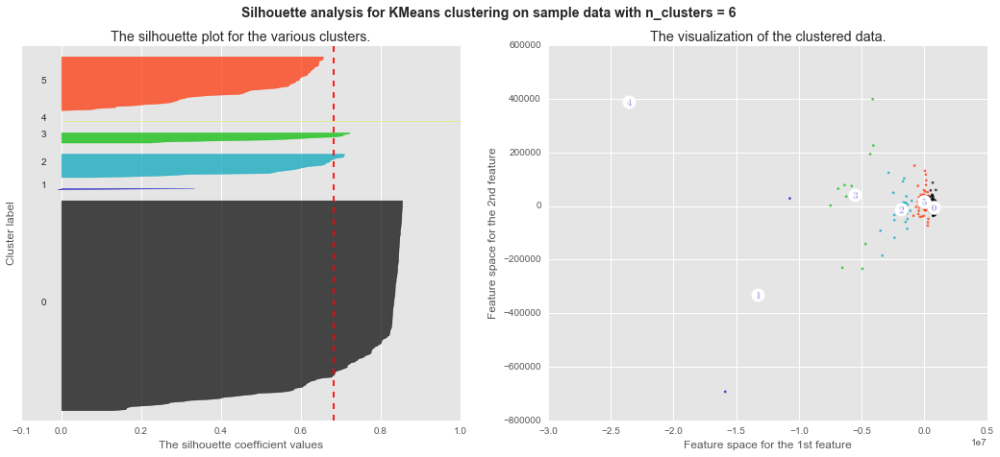

********************
Number of Components for PCA: 15
For n_clusters = 7 The average silhouette_score is : 0.687779744875


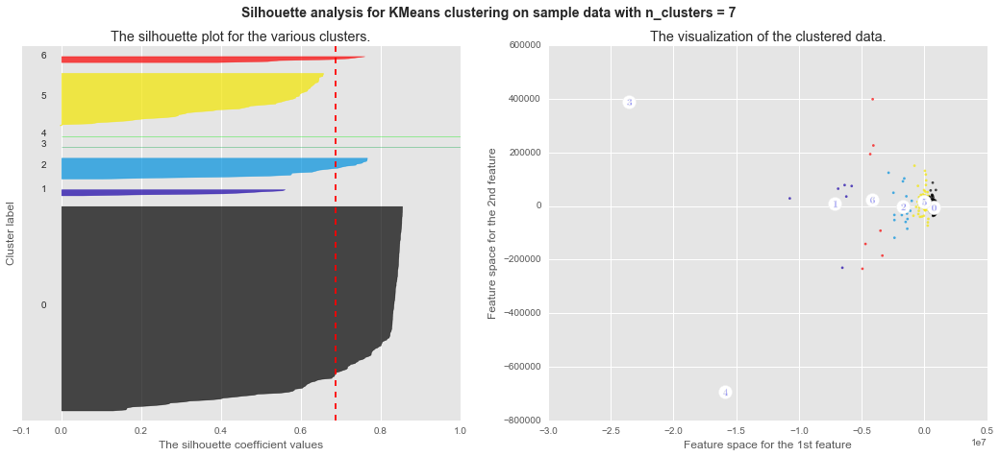

********************
Number of Components for PCA: 15
For n_clusters = 8 The average silhouette_score is : 0.6929634943


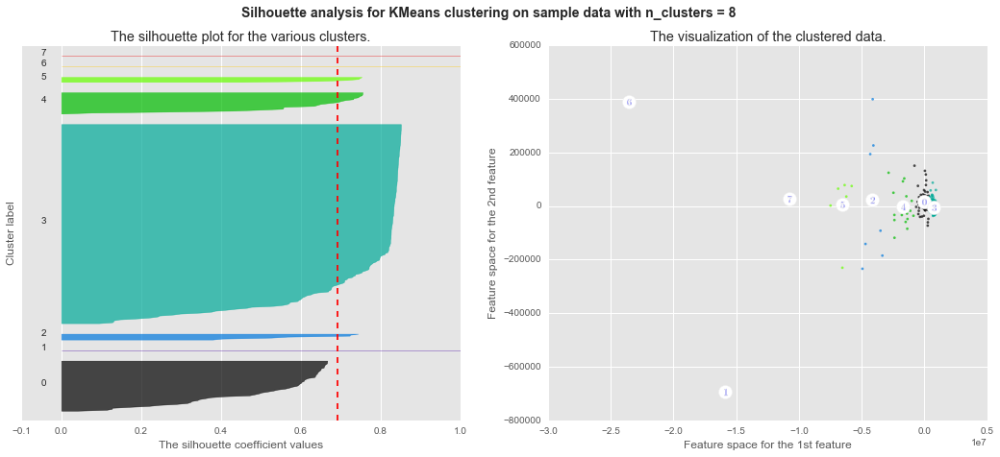

********************
Number of Components for PCA: 15
For n_clusters = 9 The average silhouette_score is : 0.655873941201


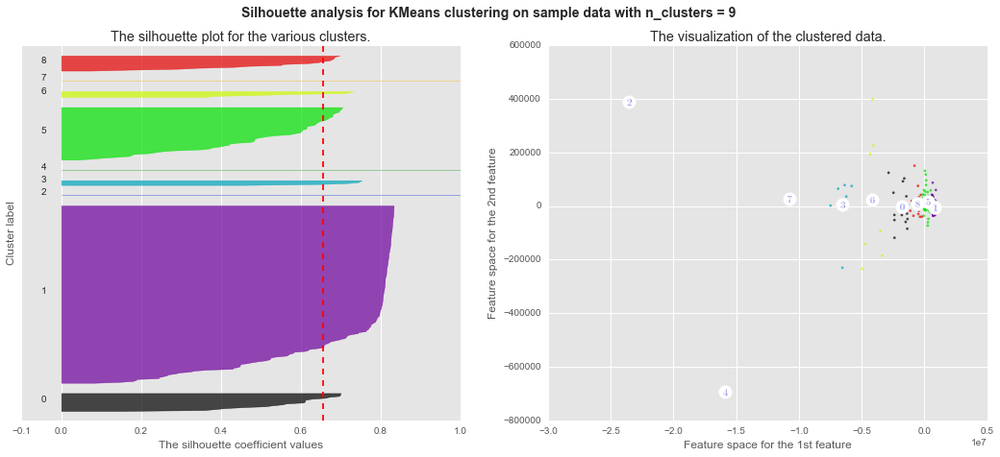

********************
Number of Components for PCA: 15
For n_clusters = 10 The average silhouette_score is : 0.617198811455


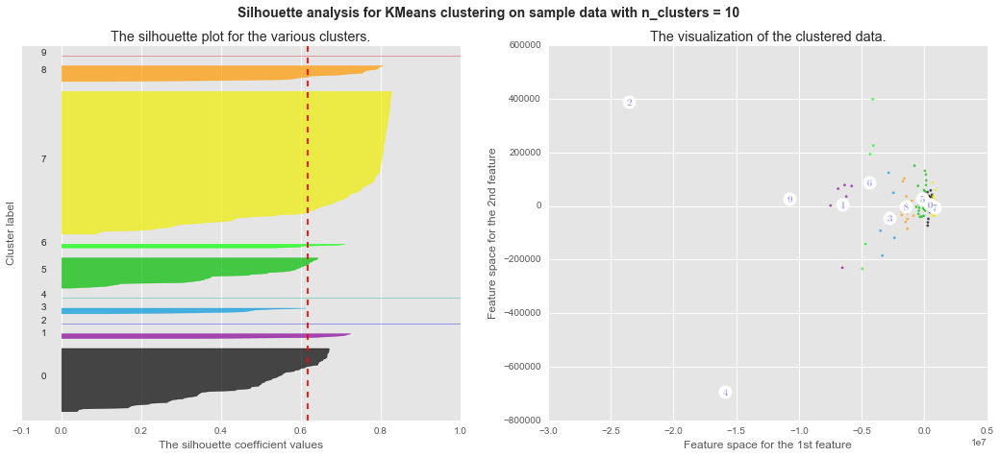

********************
Number of Components for PCA: 15
For n_clusters = 11 The average silhouette_score is : 0.612759340821


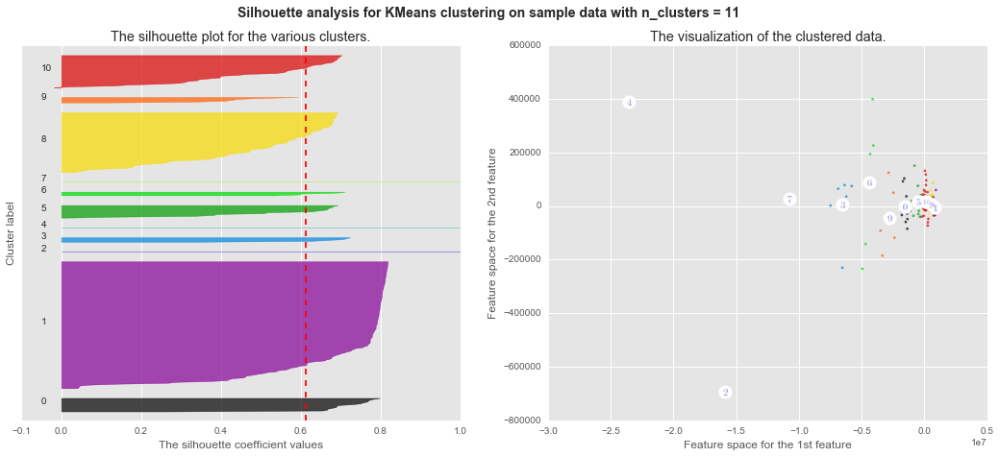

********************
Number of Components for PCA: 15
For n_clusters = 12 The average silhouette_score is : 0.614084707307


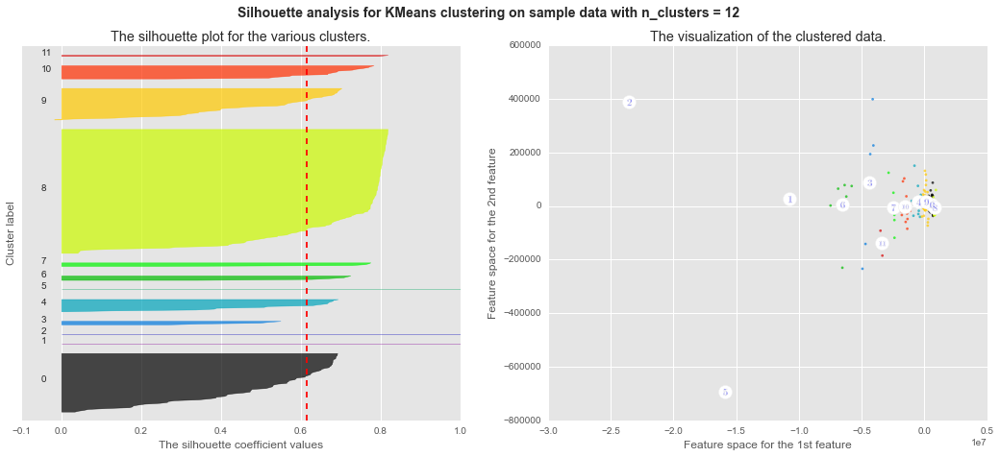

********************
Number of Components for PCA: 15
For n_clusters = 13 The average silhouette_score is : 0.611905133912


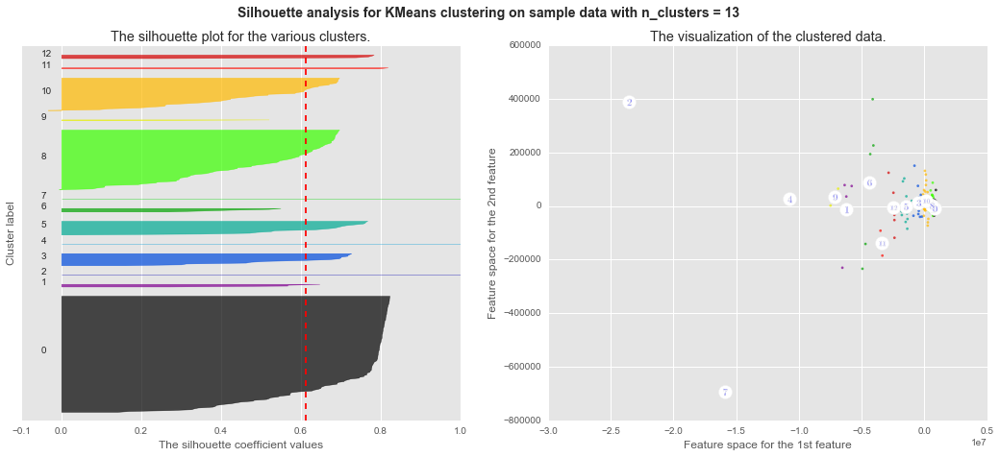

********************
Number of Components for PCA: 15
For n_clusters = 14 The average silhouette_score is : 0.597607334745


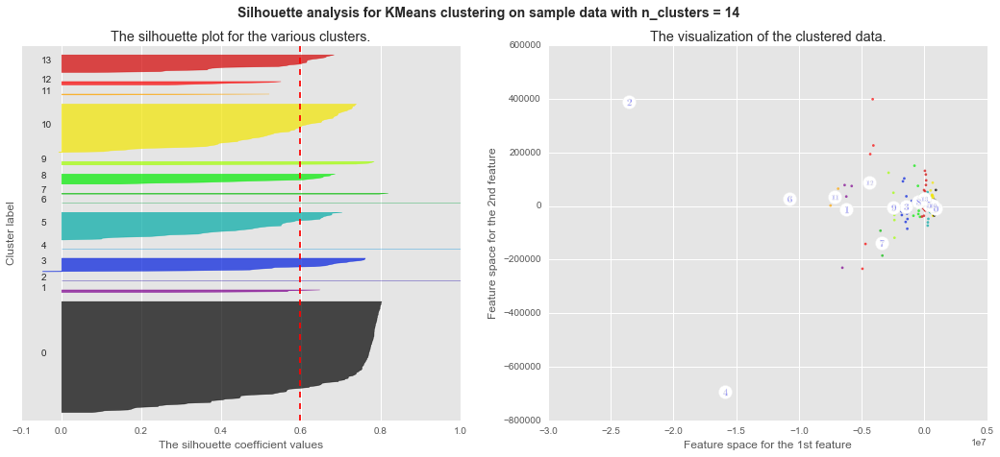

********************
Number of Components for PCA: 15
For n_clusters = 15 The average silhouette_score is : 0.578100262587


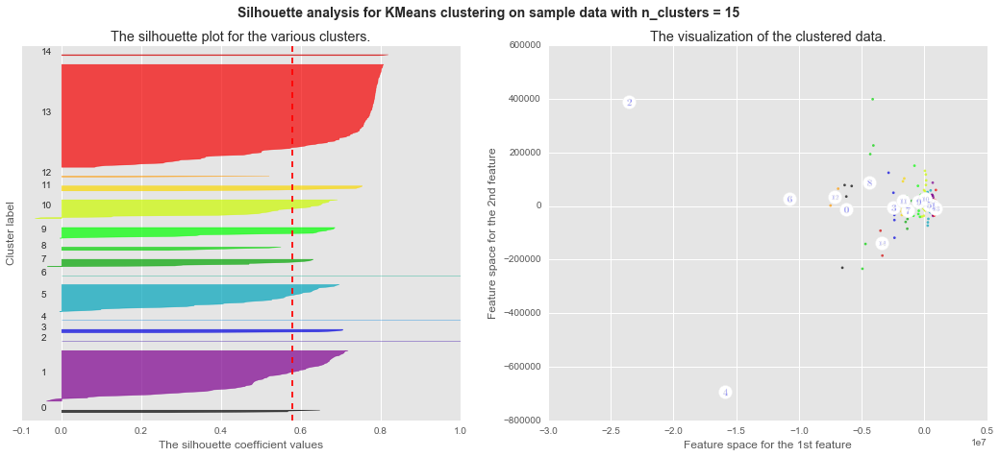

********************
Number of Components for PCA: 15
For n_clusters = 16 The average silhouette_score is : 0.594850018425


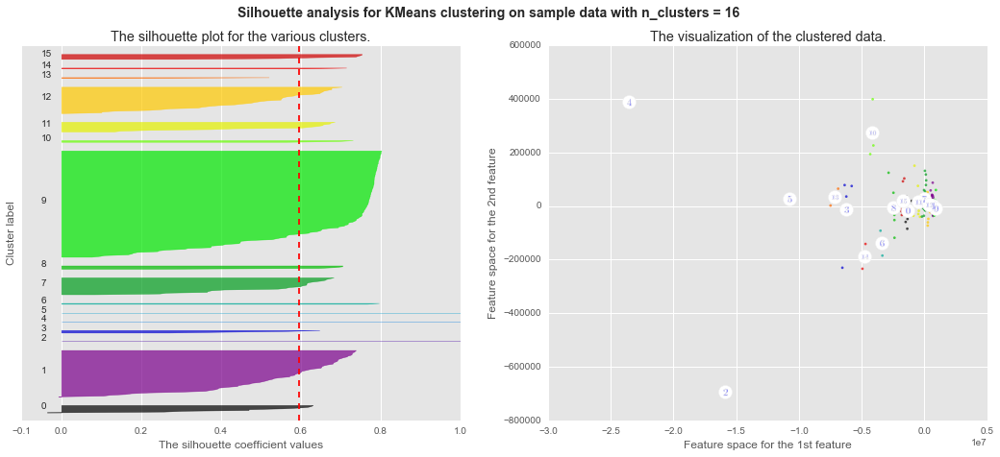

********************
Number of Components for PCA: 15
For n_clusters = 17 The average silhouette_score is : 0.583086078961


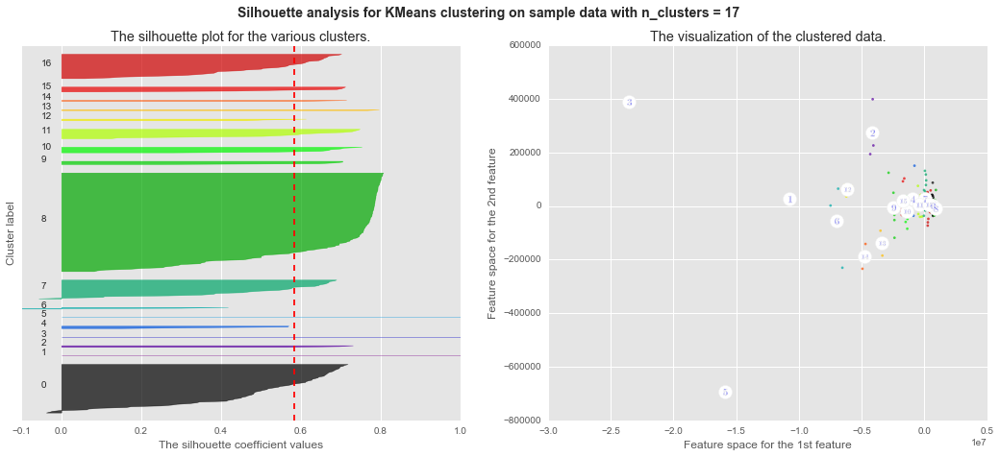

********************
Number of Components for PCA: 15
For n_clusters = 18 The average silhouette_score is : 0.539185162282


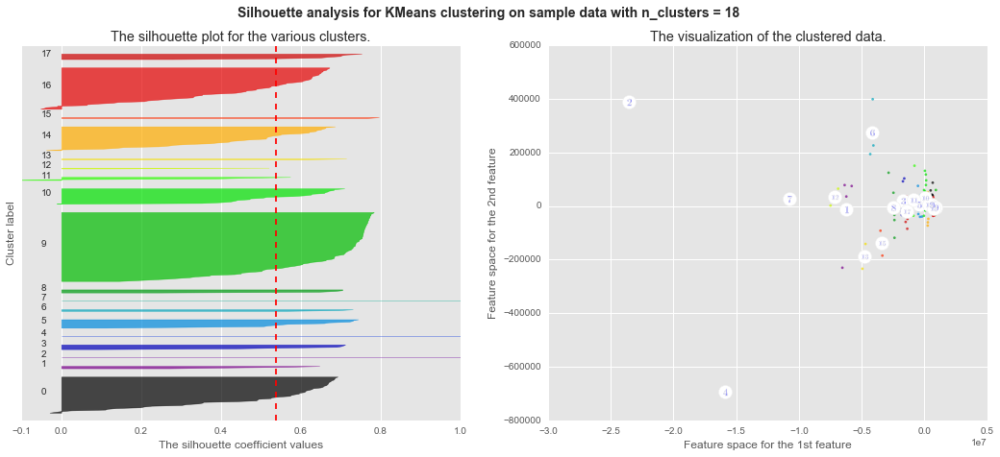

********************
Number of Components for PCA: 15
For n_clusters = 19 The average silhouette_score is : 0.549850308095


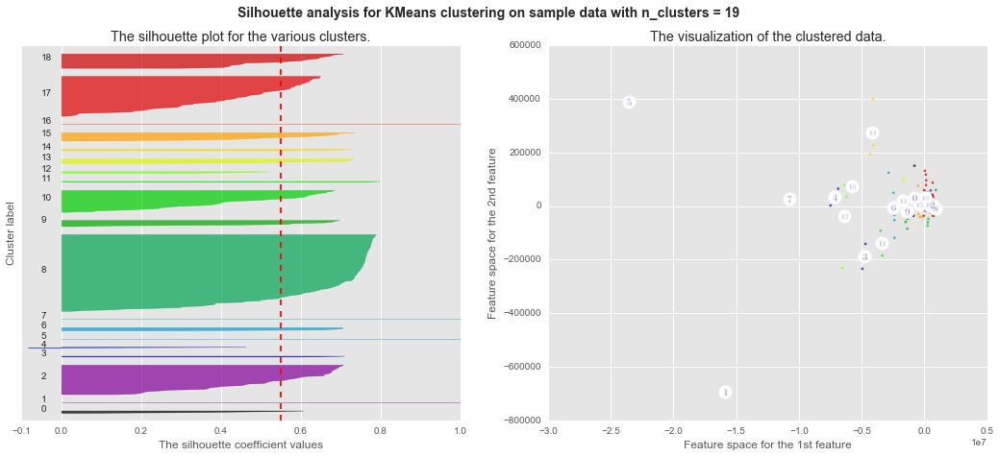

********************
Number of Components for PCA: 15
For n_clusters = 20 The average silhouette_score is : 0.53106278906


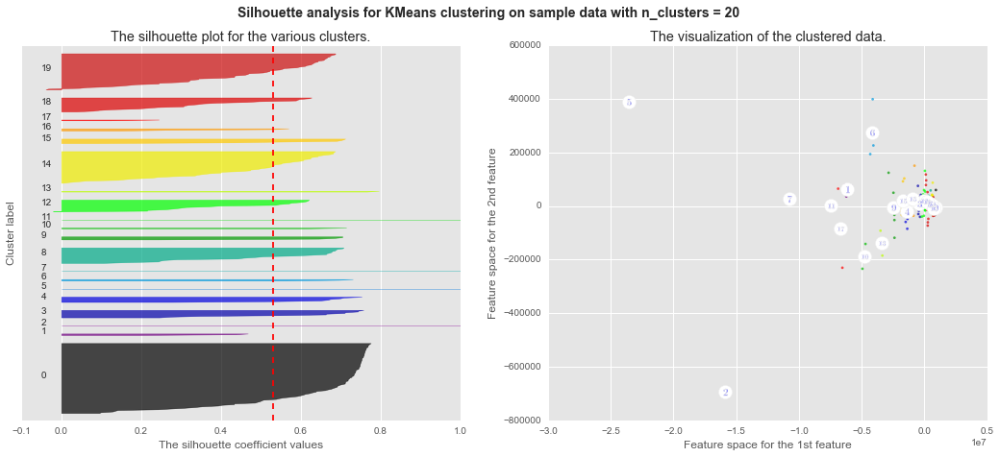

********************
Number of Components for PCA: 15
For n_clusters = 21 The average silhouette_score is : 0.534347423535


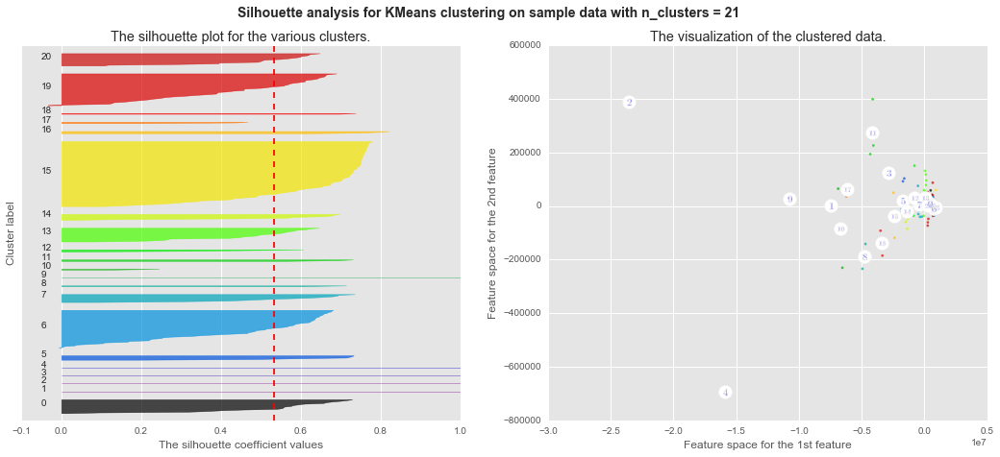

********************
Number of Components for PCA: 16
********************
********************
Number of Components for PCA: 16
For n_clusters = 4 The average silhouette_score is : 0.794910206854


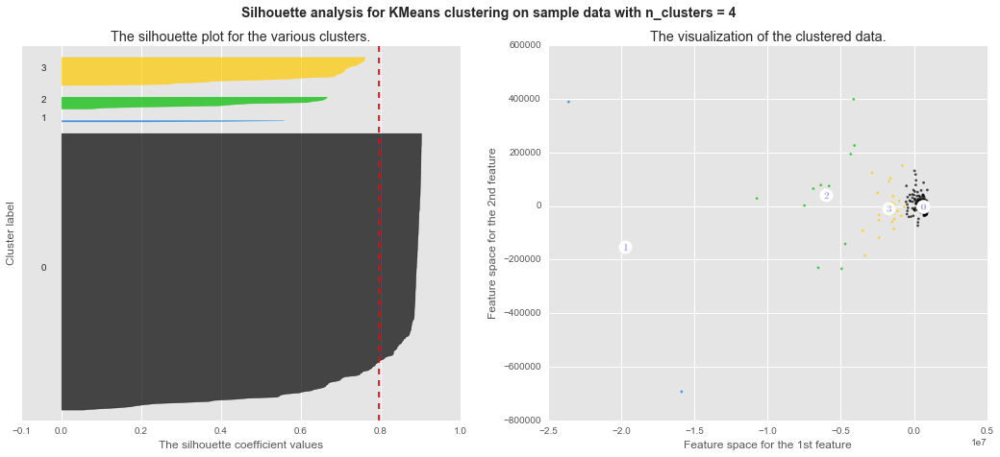

********************
Number of Components for PCA: 16
For n_clusters = 5 The average silhouette_score is : 0.798095900159


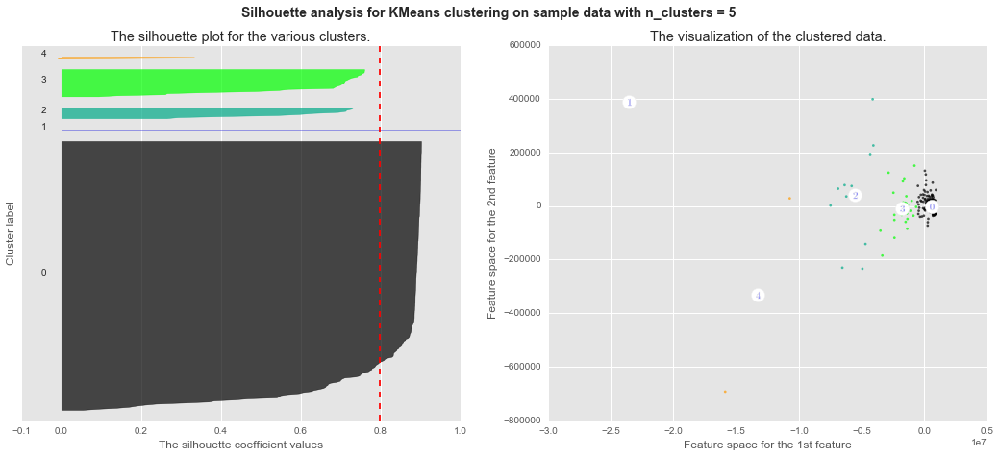

********************
Number of Components for PCA: 16
For n_clusters = 6 The average silhouette_score is : 0.683324553956


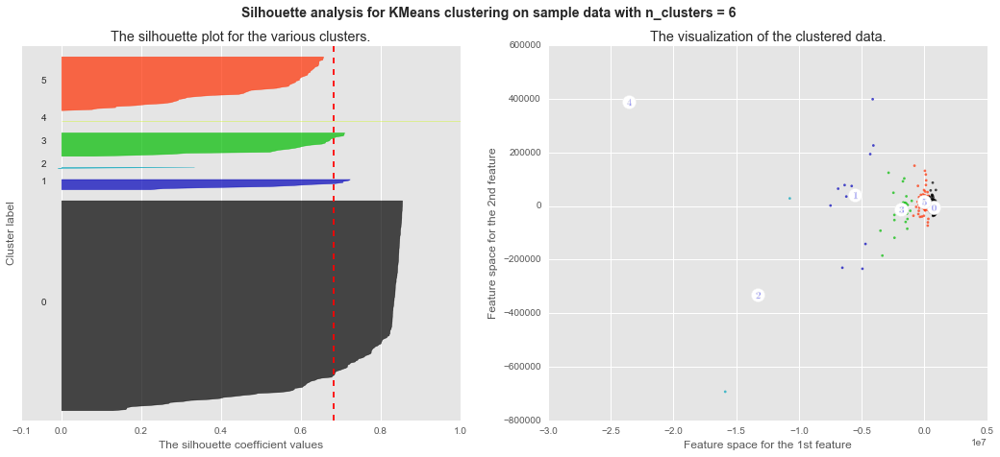

********************
Number of Components for PCA: 16
For n_clusters = 7 The average silhouette_score is : 0.68659438266


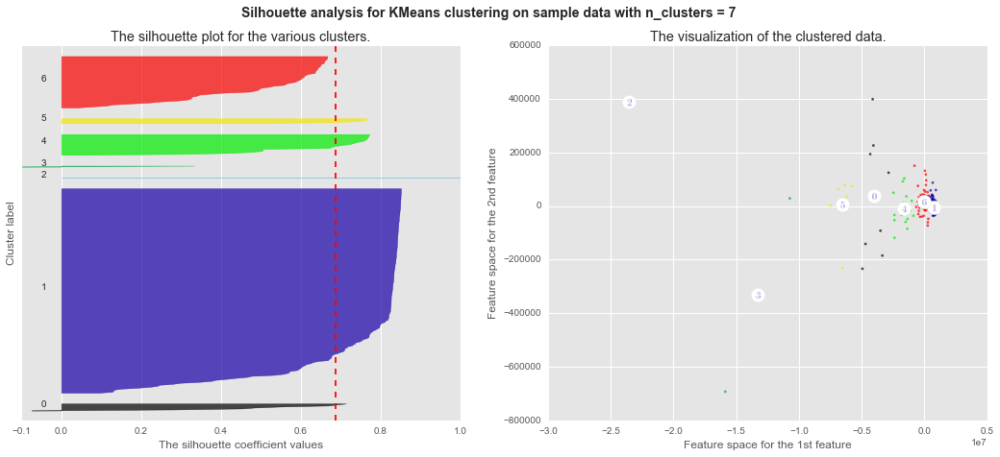

********************
Number of Components for PCA: 16
For n_clusters = 8 The average silhouette_score is : 0.692963489721


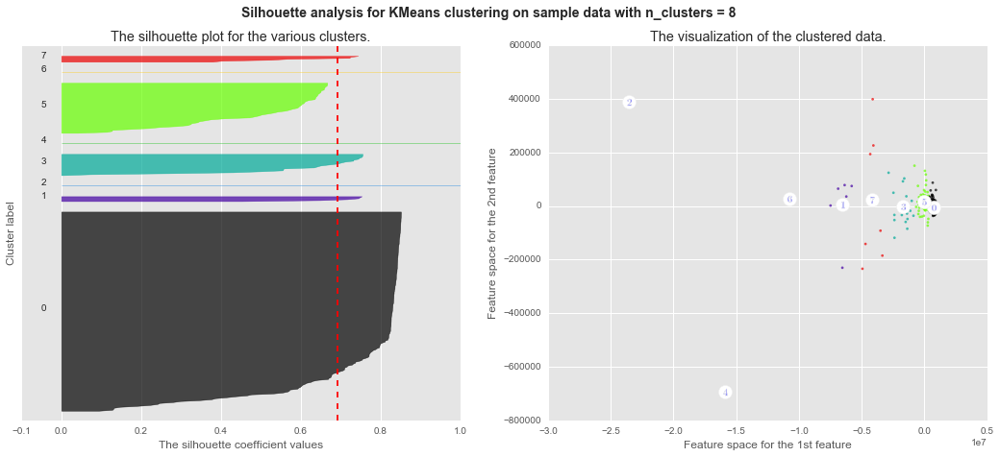

********************
Number of Components for PCA: 16
For n_clusters = 9 The average silhouette_score is : 0.655873934178


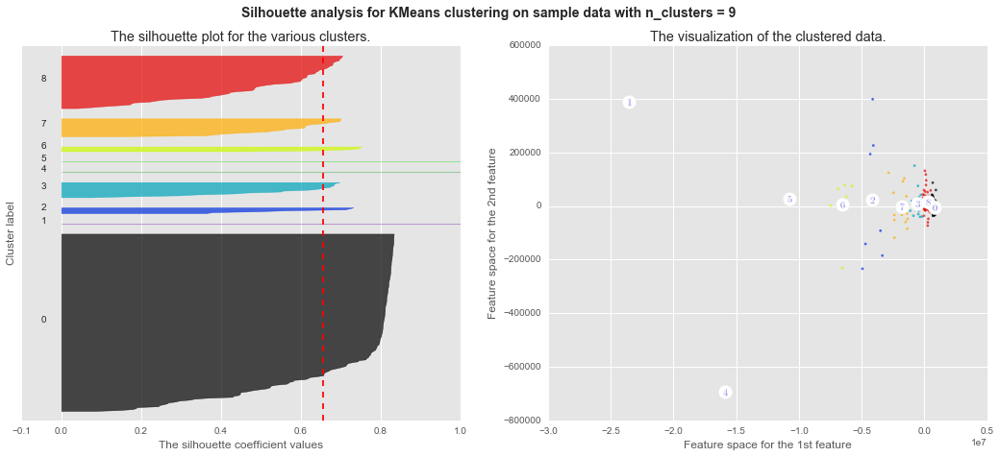

********************
Number of Components for PCA: 16
For n_clusters = 10 The average silhouette_score is : 0.617198799181


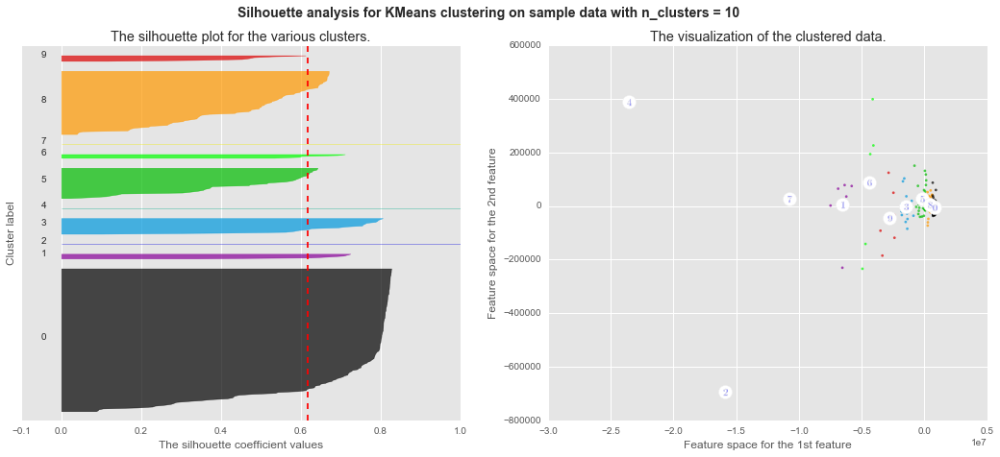

********************
Number of Components for PCA: 16
For n_clusters = 11 The average silhouette_score is : 0.614409598873


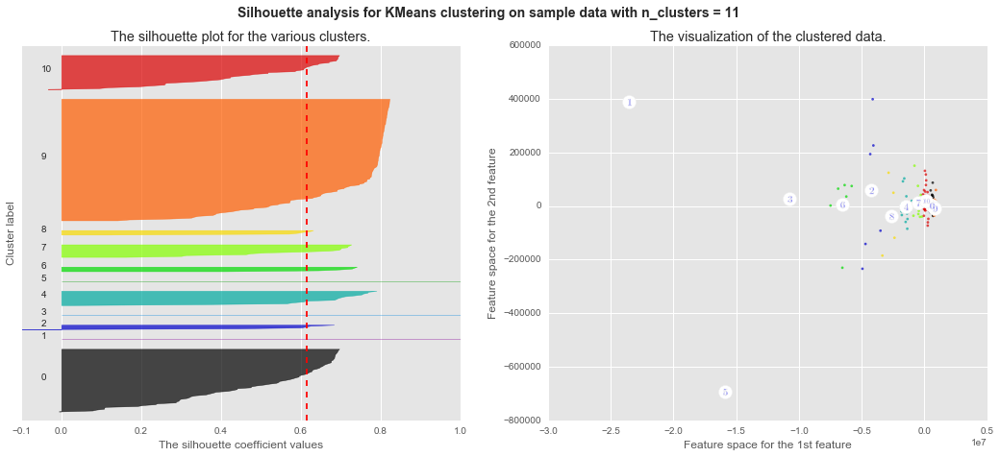

********************
Number of Components for PCA: 16
For n_clusters = 12 The average silhouette_score is : 0.610770626615


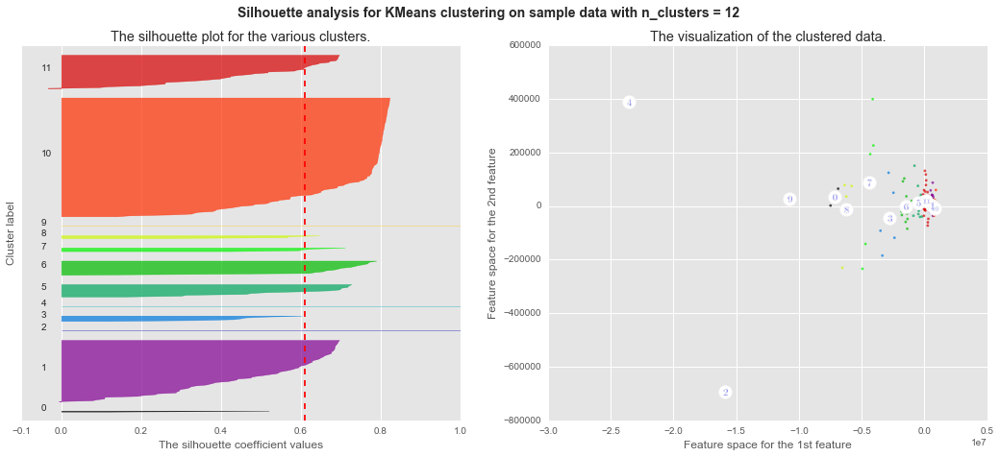

********************
Number of Components for PCA: 16
For n_clusters = 13 The average silhouette_score is : 0.611983333142


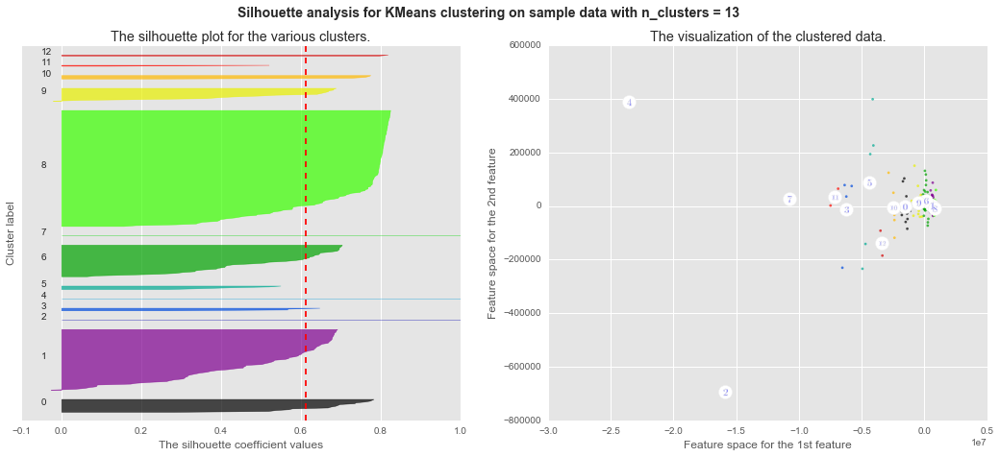

********************
Number of Components for PCA: 16
For n_clusters = 14 The average silhouette_score is : 0.615318403213


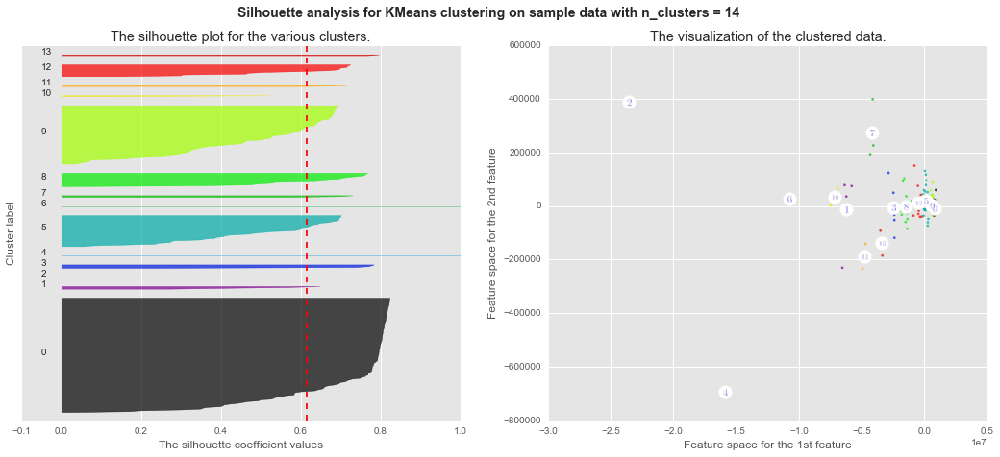

********************
Number of Components for PCA: 16
For n_clusters = 15 The average silhouette_score is : 0.605568629923


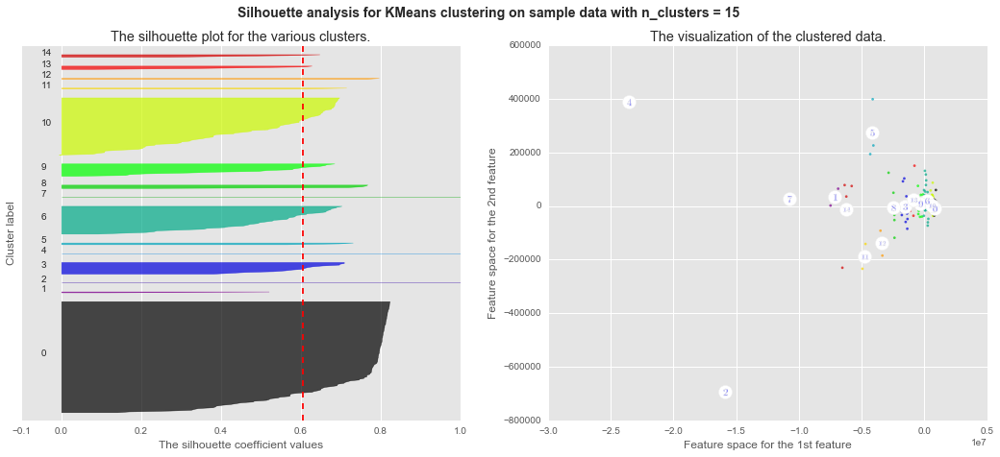

********************
Number of Components for PCA: 16
For n_clusters = 16 The average silhouette_score is : 0.595125379571


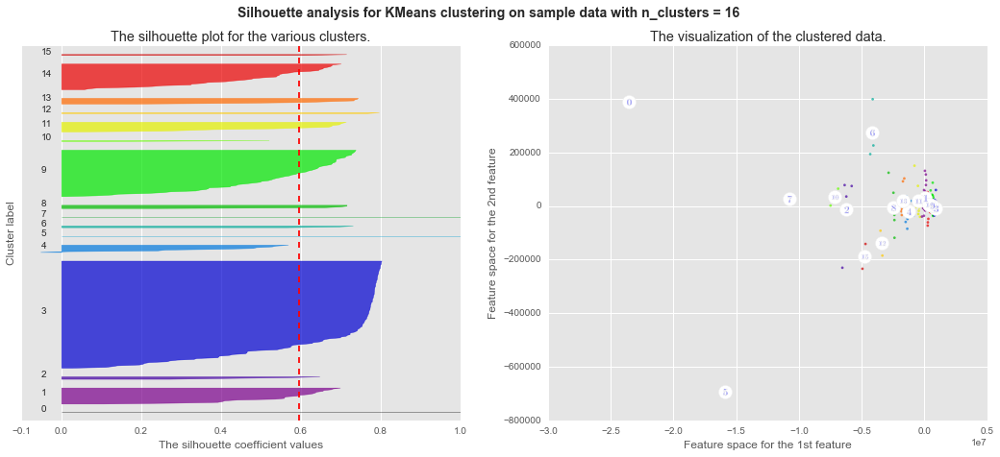

********************
Number of Components for PCA: 16
For n_clusters = 17 The average silhouette_score is : 0.547213715014


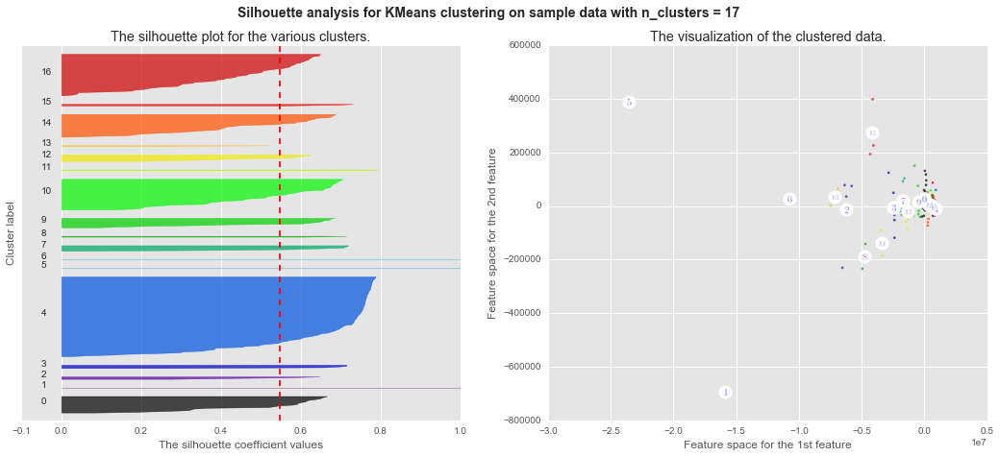

********************
Number of Components for PCA: 16
For n_clusters = 18 The average silhouette_score is : 0.55037687232


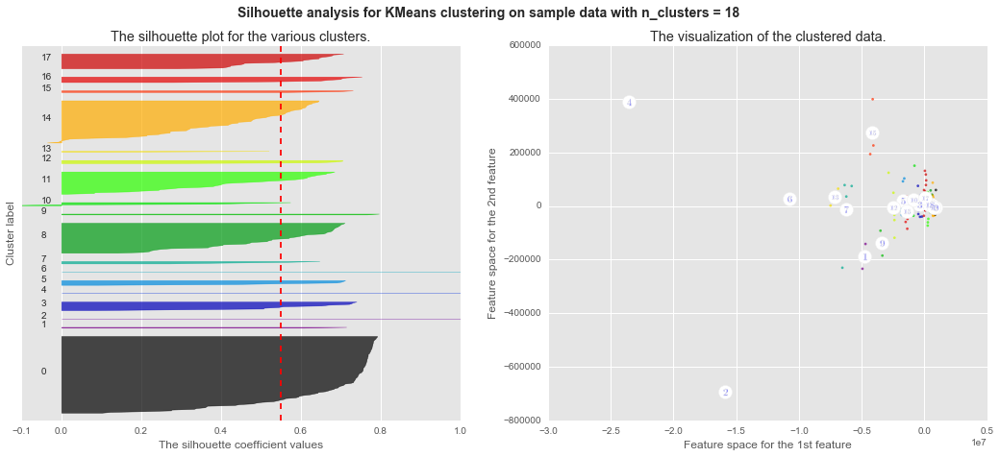

********************
Number of Components for PCA: 16
For n_clusters = 19 The average silhouette_score is : 0.549214642561


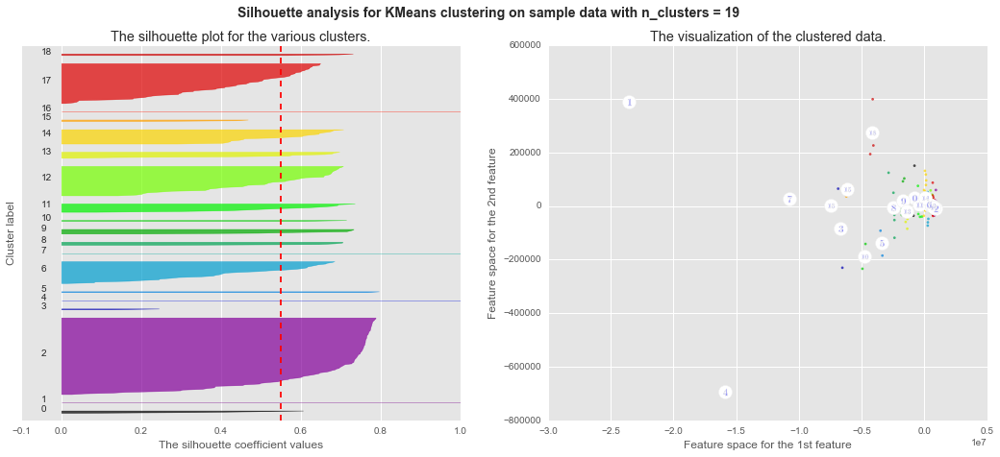

********************
Number of Components for PCA: 16
For n_clusters = 20 The average silhouette_score is : 0.531507759916


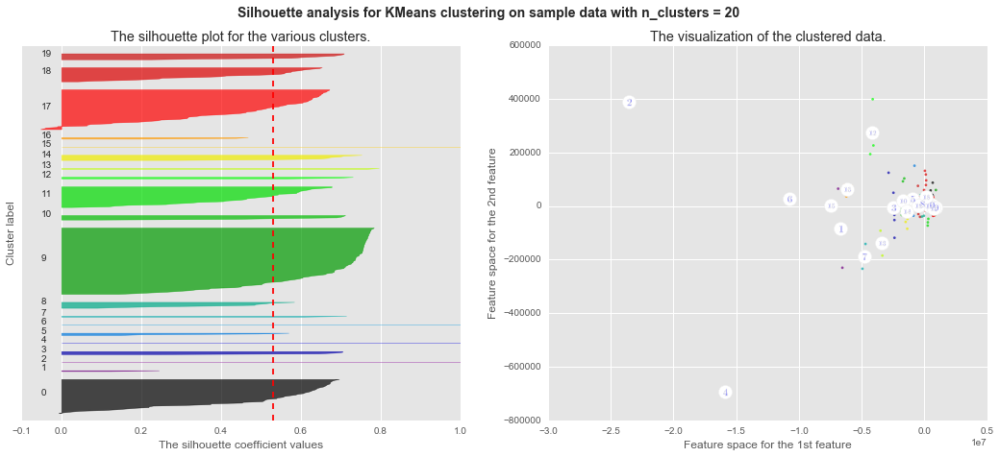

********************
Number of Components for PCA: 16
For n_clusters = 21 The average silhouette_score is : 0.523580715032


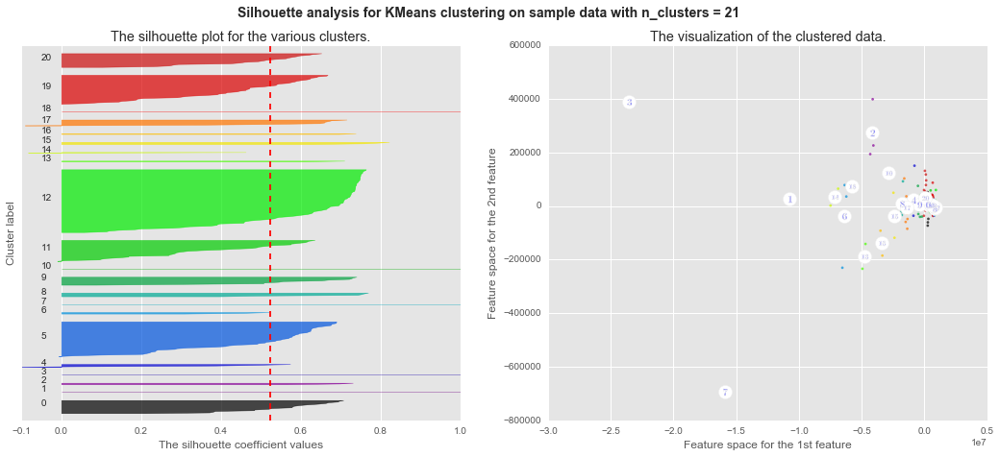

********************
Number of Components for PCA: 17
********************
********************
Number of Components for PCA: 17
For n_clusters = 4 The average silhouette_score is : 0.794910206282


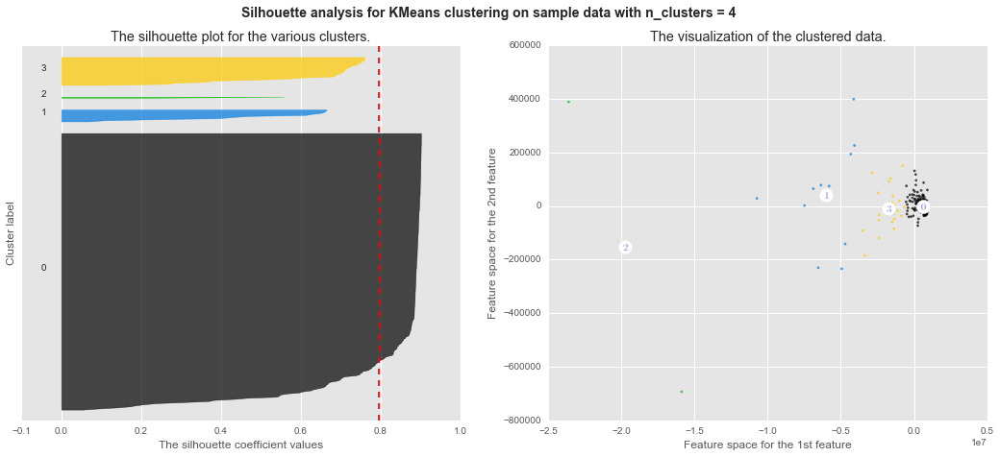

********************
Number of Components for PCA: 17
For n_clusters = 5 The average silhouette_score is : 0.798095899587


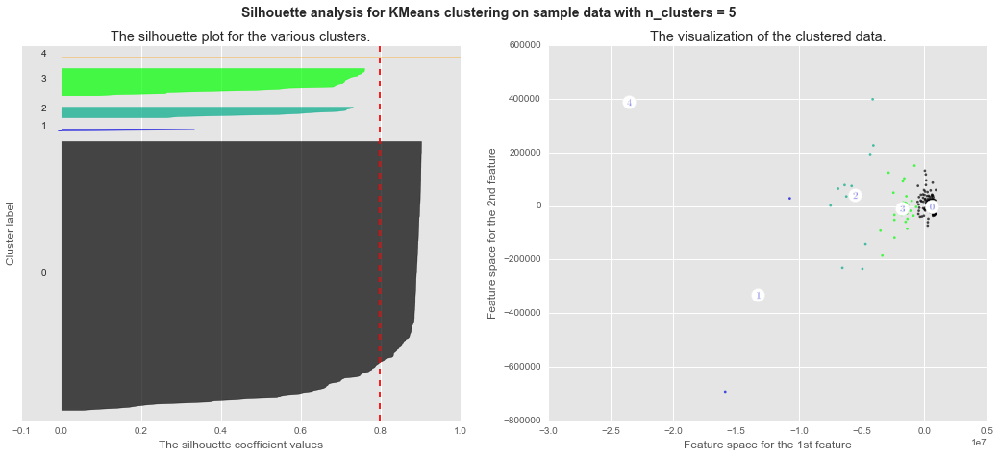

********************
Number of Components for PCA: 17
For n_clusters = 6 The average silhouette_score is : 0.683324551844


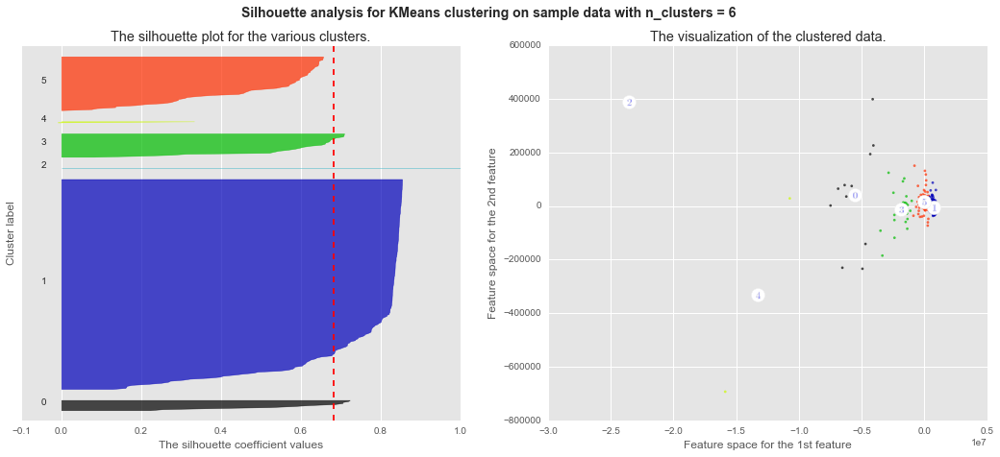

********************
Number of Components for PCA: 17
For n_clusters = 7 The average silhouette_score is : 0.68659077371


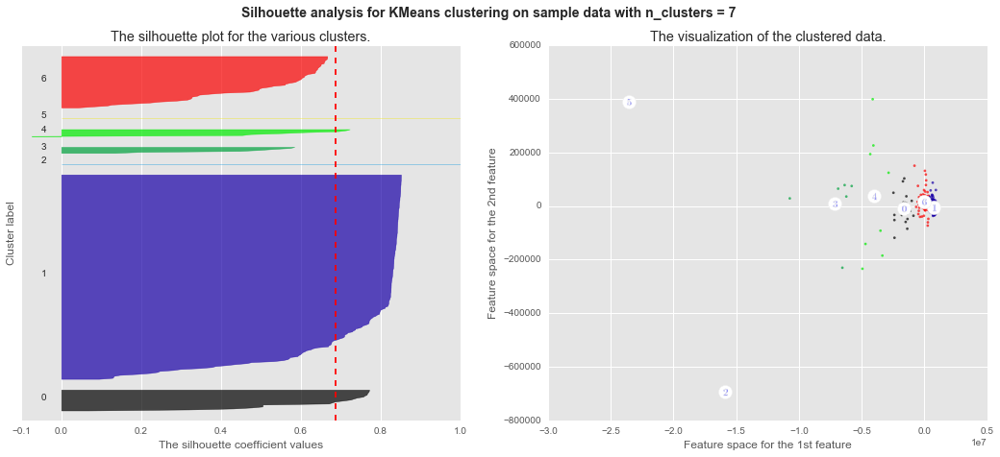

********************
Number of Components for PCA: 17
For n_clusters = 8 The average silhouette_score is : 0.692963487567


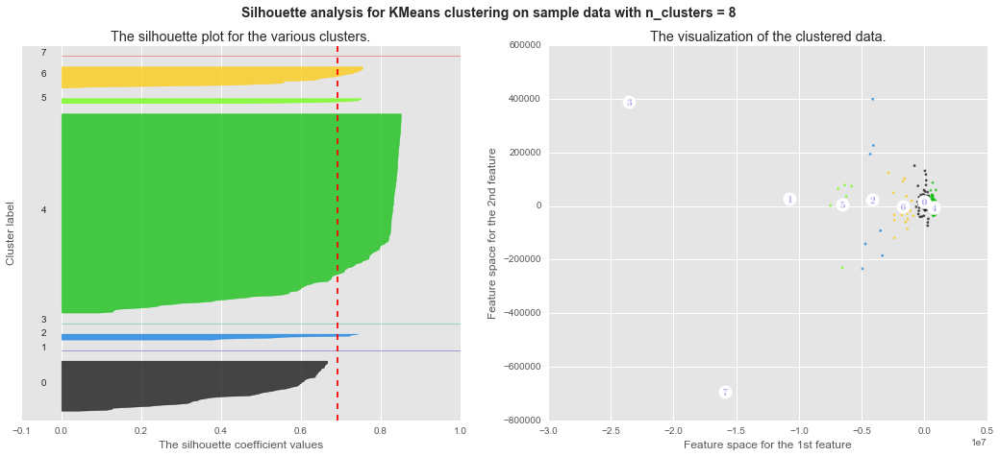

********************
Number of Components for PCA: 17
For n_clusters = 9 The average silhouette_score is : 0.655873930797


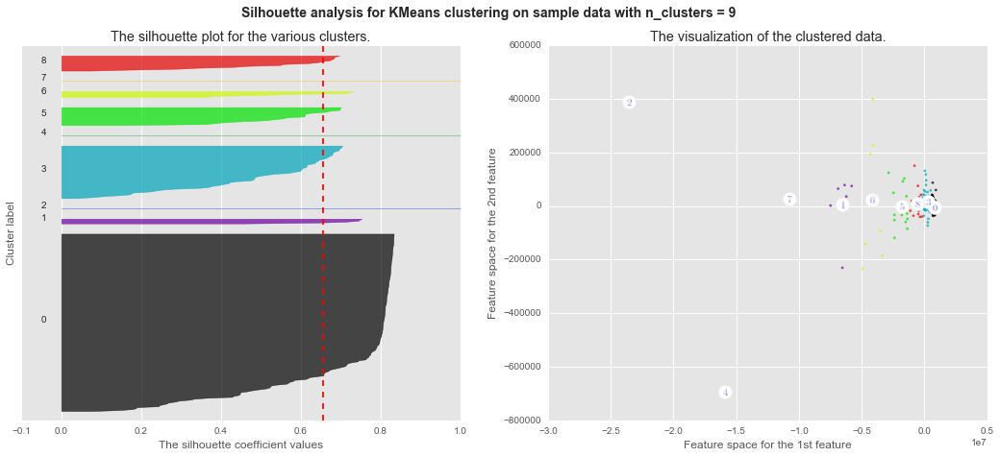

********************
Number of Components for PCA: 17
For n_clusters = 10 The average silhouette_score is : 0.617198793481


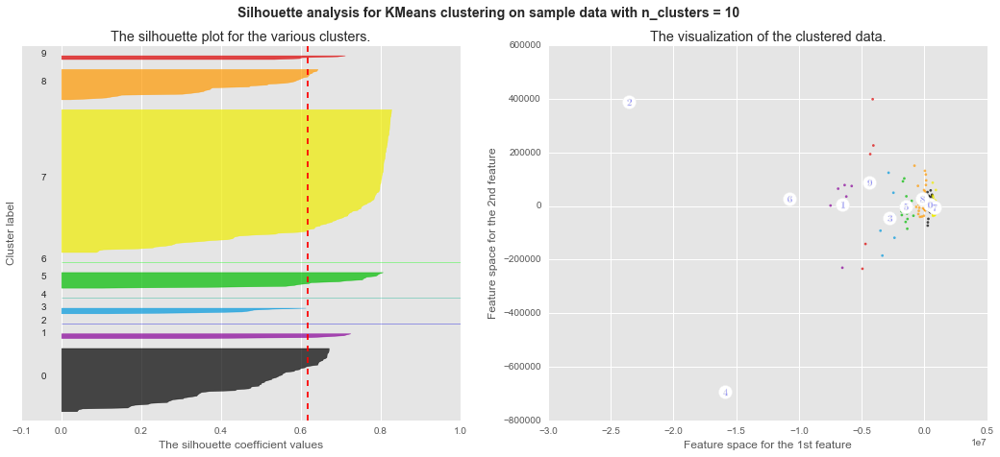

********************
Number of Components for PCA: 17
For n_clusters = 11 The average silhouette_score is : 0.615127709088


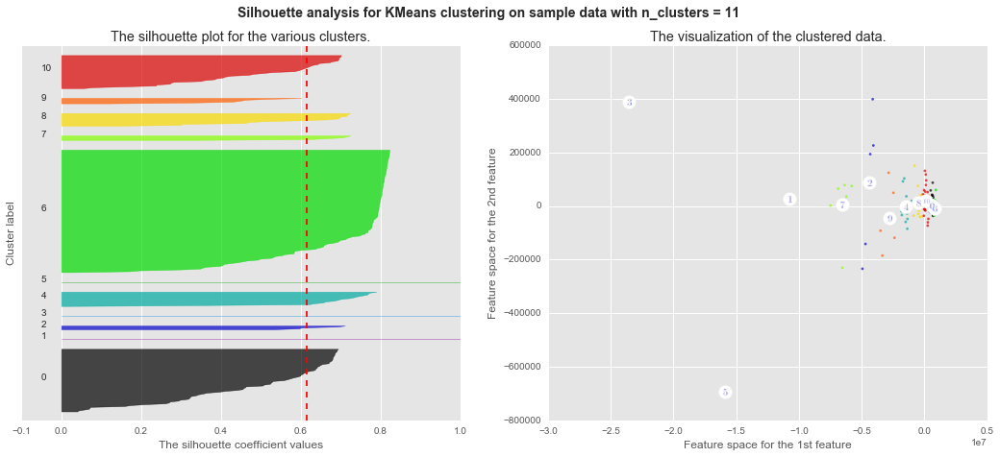

********************
Number of Components for PCA: 17
For n_clusters = 12 The average silhouette_score is : 0.614084682946


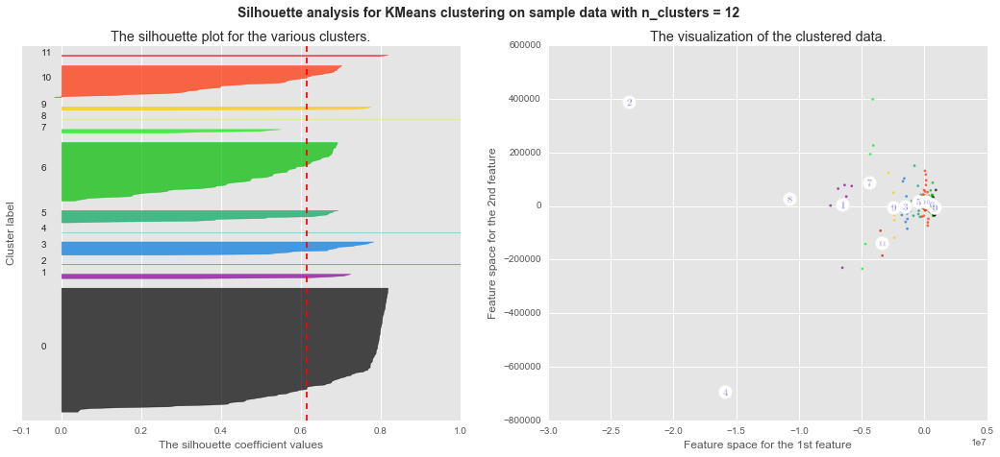

********************
Number of Components for PCA: 17
For n_clusters = 13 The average silhouette_score is : 0.61190510724


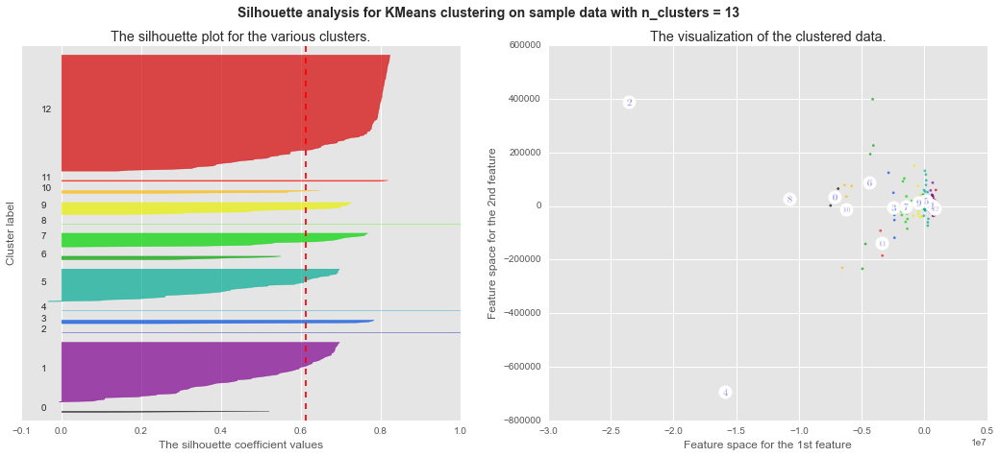

********************
Number of Components for PCA: 17
For n_clusters = 14 The average silhouette_score is : 0.594718002504


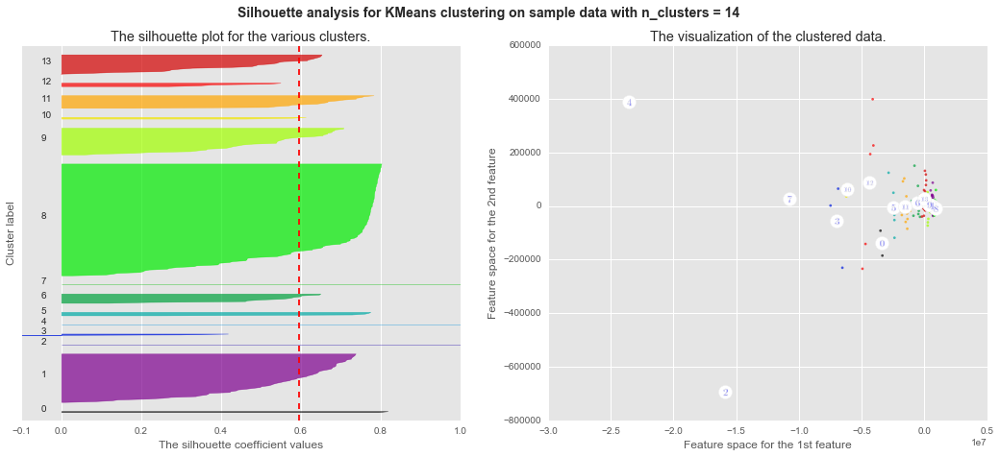

********************
Number of Components for PCA: 17
For n_clusters = 15 The average silhouette_score is : 0.6004175842


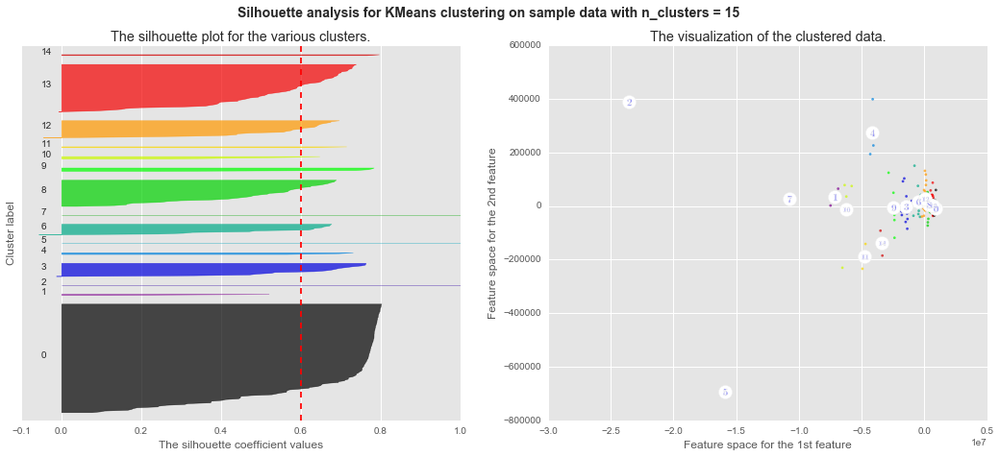

********************
Number of Components for PCA: 17
For n_clusters = 16 The average silhouette_score is : 0.591380393111


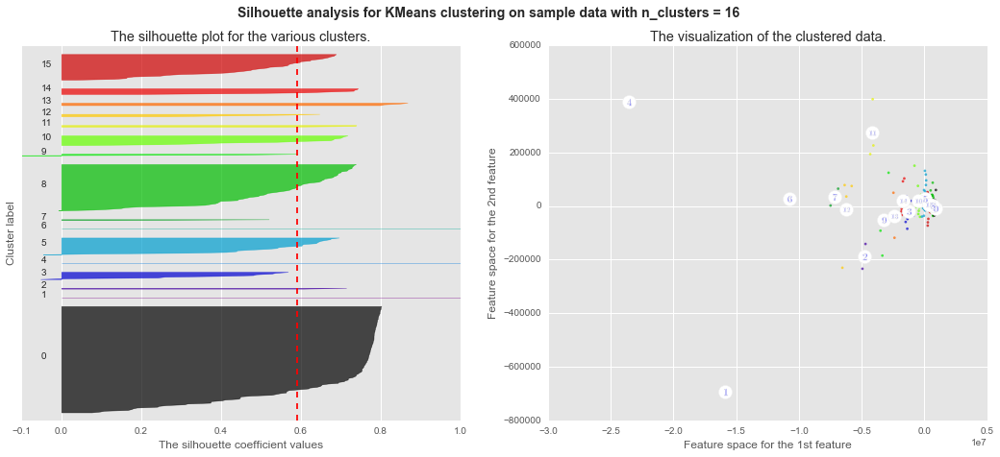

********************
Number of Components for PCA: 17
For n_clusters = 17 The average silhouette_score is : 0.551725738458


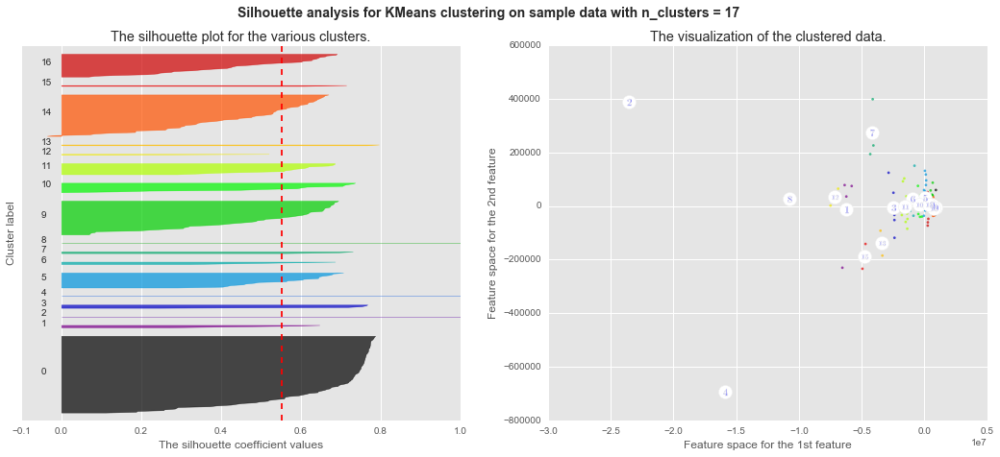

********************
Number of Components for PCA: 17
For n_clusters = 18 The average silhouette_score is : 0.550306672165


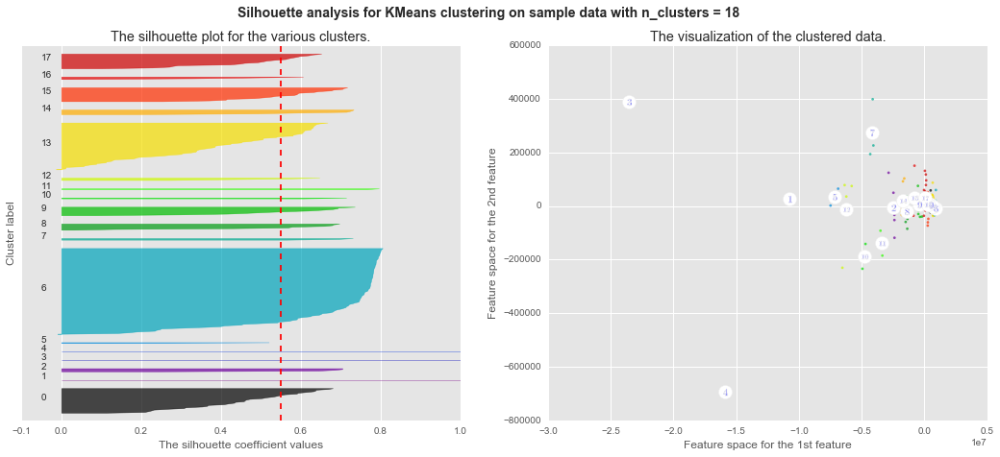

********************
Number of Components for PCA: 17
For n_clusters = 19 The average silhouette_score is : 0.550863919877


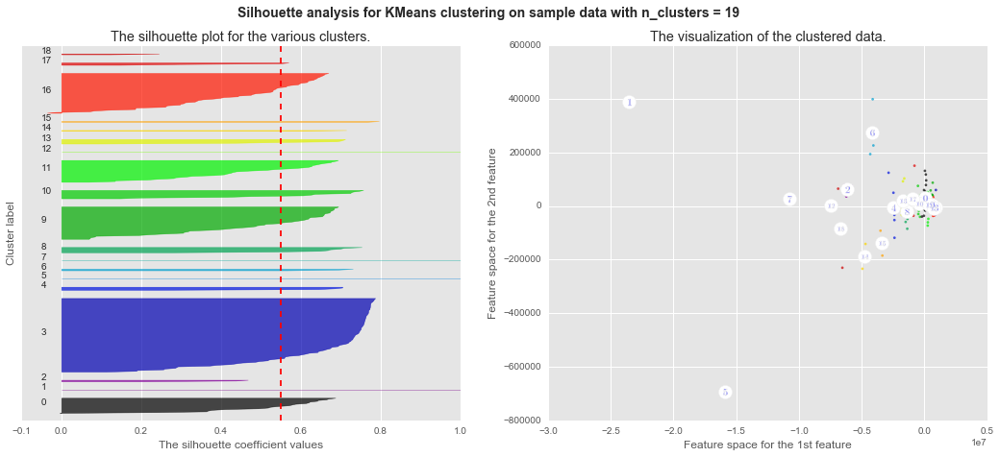

********************
Number of Components for PCA: 17
For n_clusters = 20 The average silhouette_score is : 0.535697264358


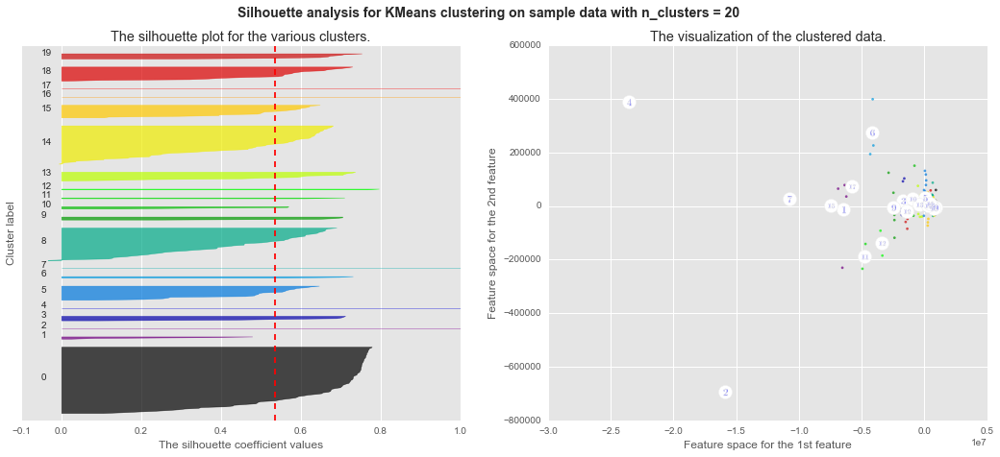

********************
Number of Components for PCA: 17
For n_clusters = 21 The average silhouette_score is : 0.539396429403


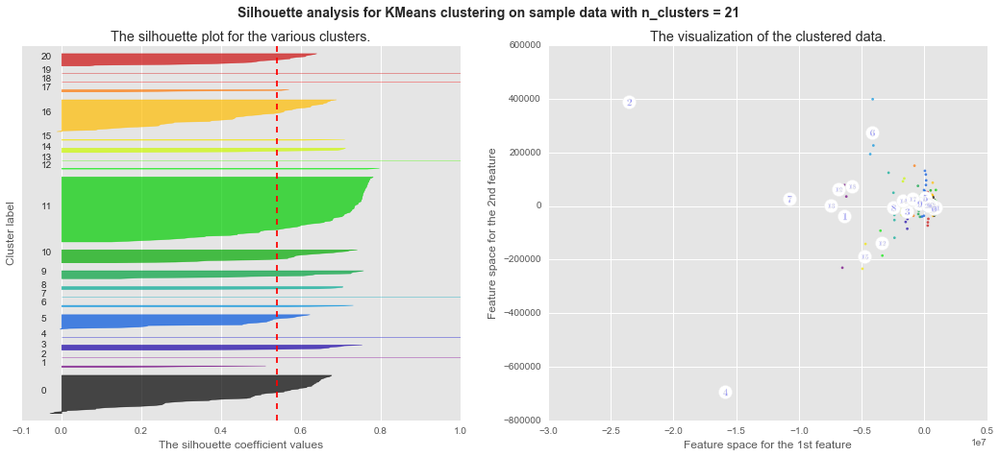

********************
Number of Components for PCA: 18
********************
********************
Number of Components for PCA: 18
For n_clusters = 4 The average silhouette_score is : 0.794910205799


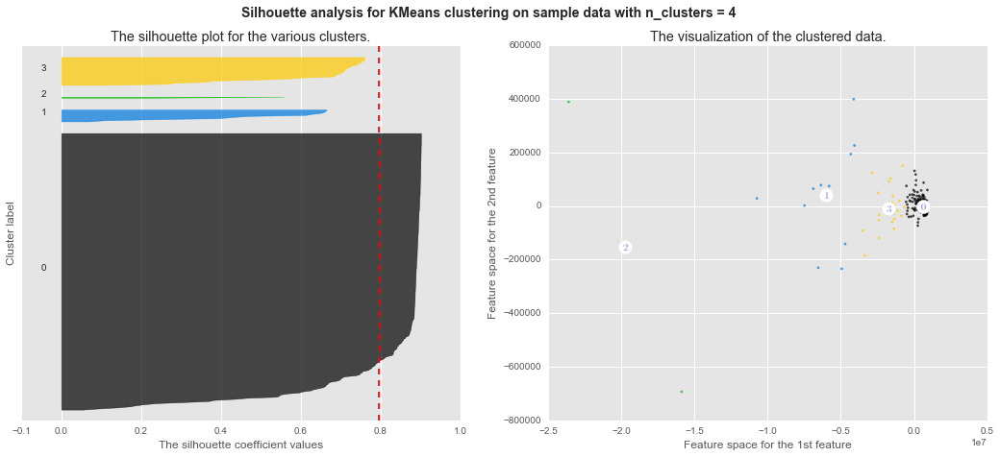

********************
Number of Components for PCA: 18
For n_clusters = 5 The average silhouette_score is : 0.77719748267


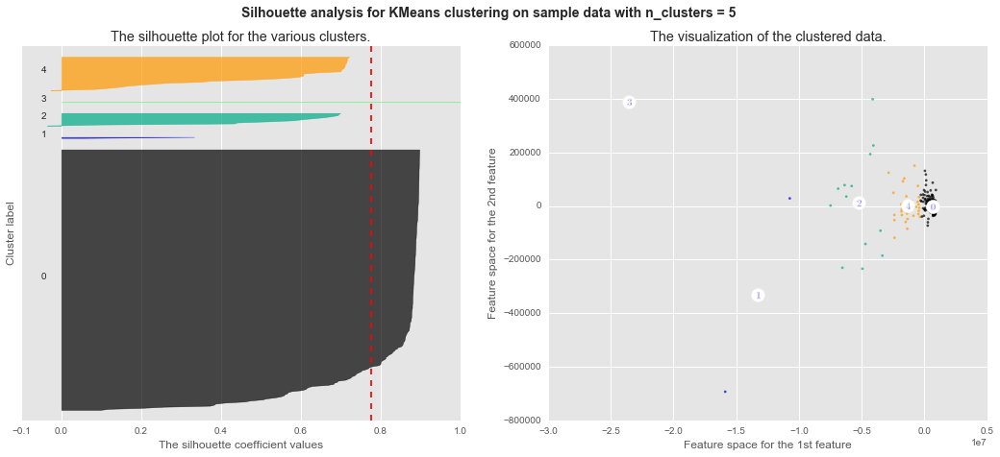

********************
Number of Components for PCA: 18
For n_clusters = 6 The average silhouette_score is : 0.683324550116


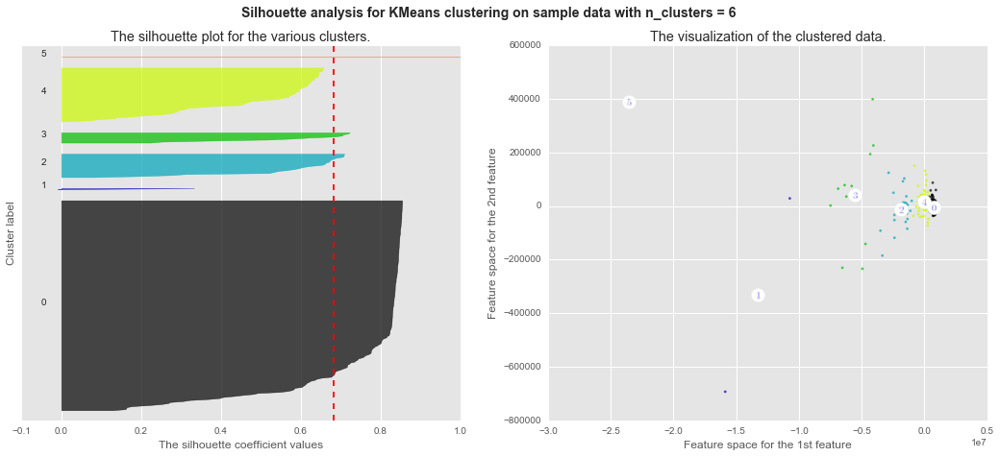

********************
Number of Components for PCA: 18
For n_clusters = 7 The average silhouette_score is : 0.686222453151


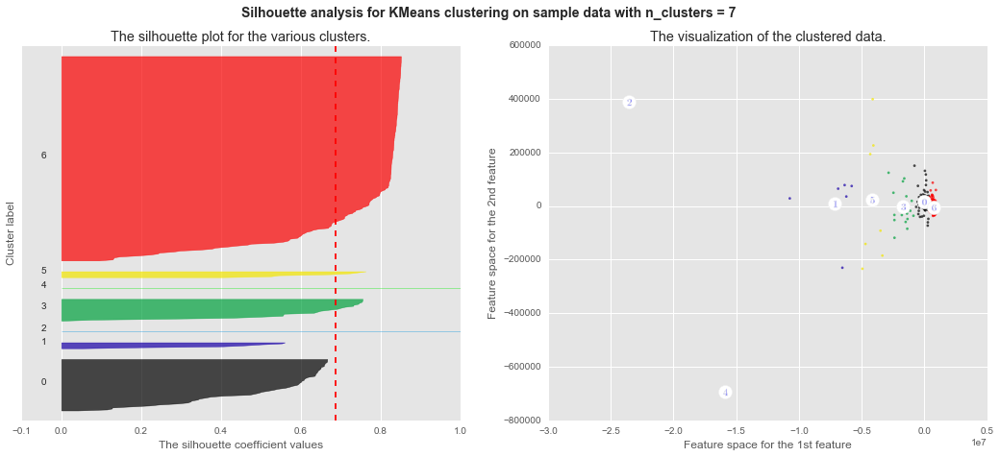

********************
Number of Components for PCA: 18
For n_clusters = 8 The average silhouette_score is : 0.692963485803


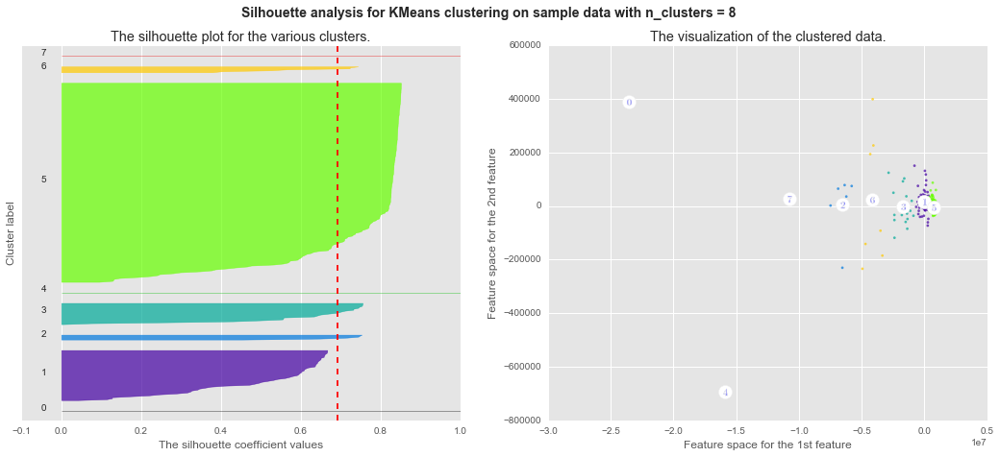

********************
Number of Components for PCA: 18
For n_clusters = 9 The average silhouette_score is : 0.655873927873


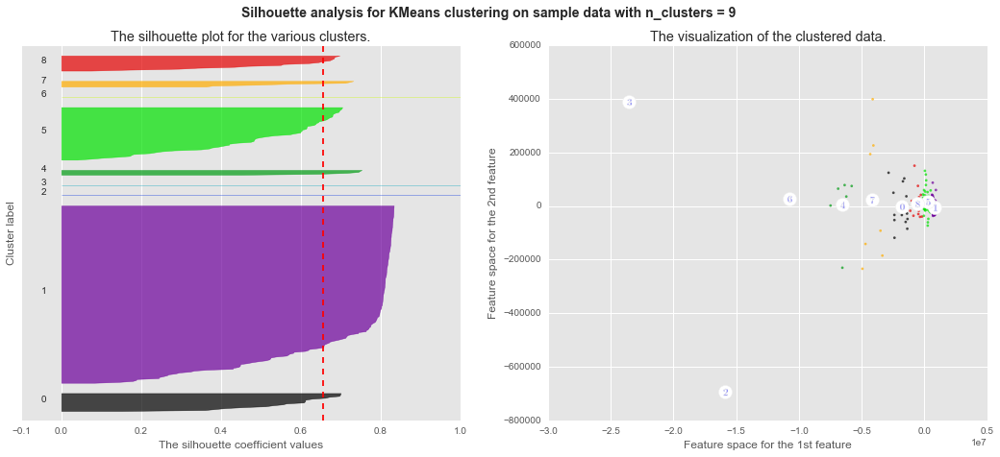

********************
Number of Components for PCA: 18
For n_clusters = 10 The average silhouette_score is : 0.61719878861


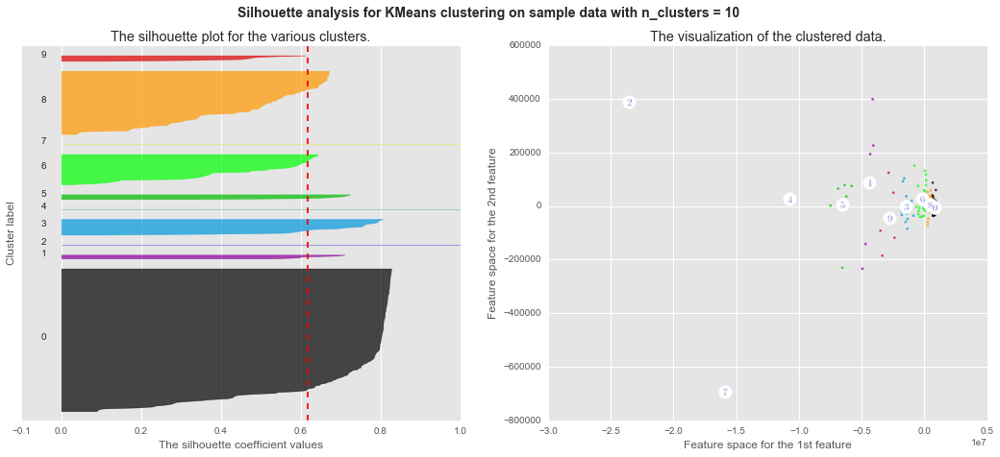

********************
Number of Components for PCA: 18
For n_clusters = 11 The average silhouette_score is : 0.615127702342


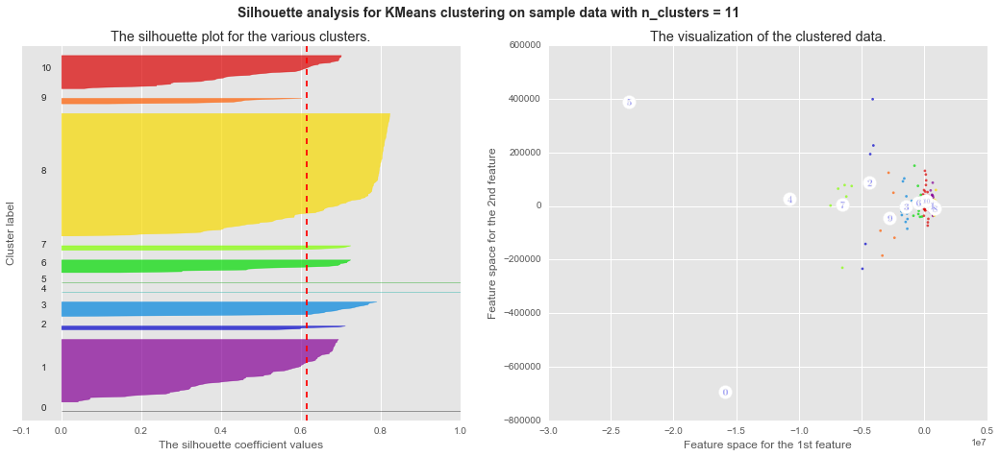

********************
Number of Components for PCA: 18
For n_clusters = 12 The average silhouette_score is : 0.611810974569


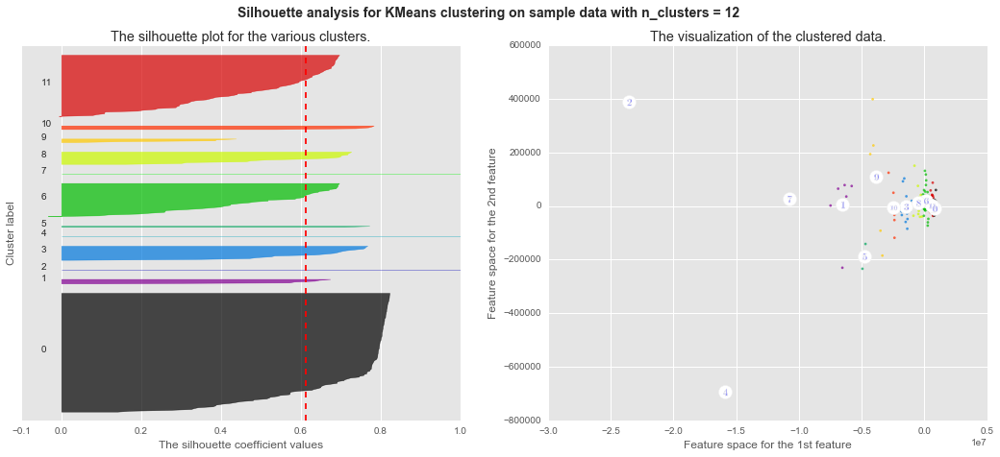

********************
Number of Components for PCA: 18
For n_clusters = 13 The average silhouette_score is : 0.609613074796


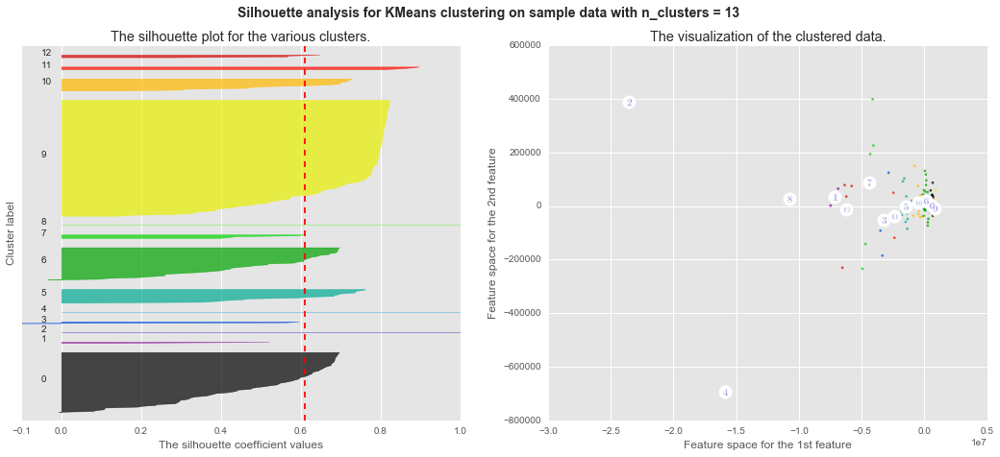

********************
Number of Components for PCA: 18
For n_clusters = 14 The average silhouette_score is : 0.595276188143


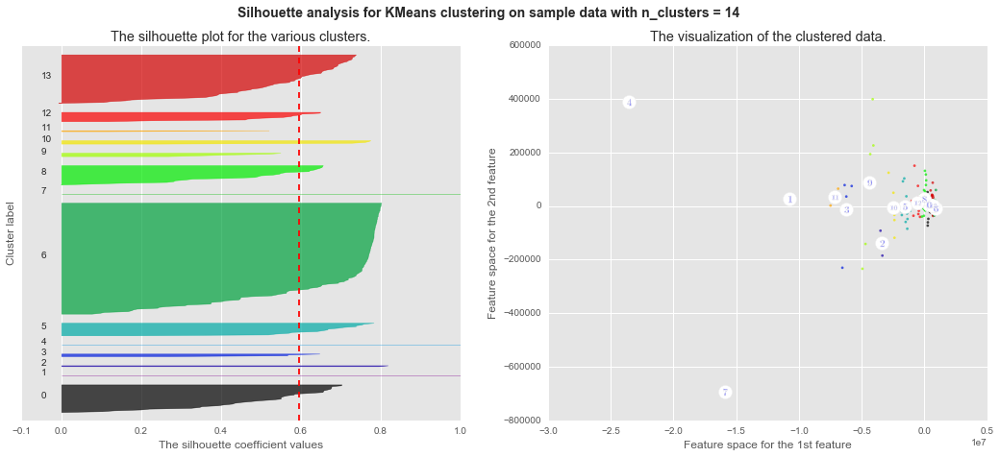

********************
Number of Components for PCA: 18
For n_clusters = 15 The average silhouette_score is : 0.578100217716


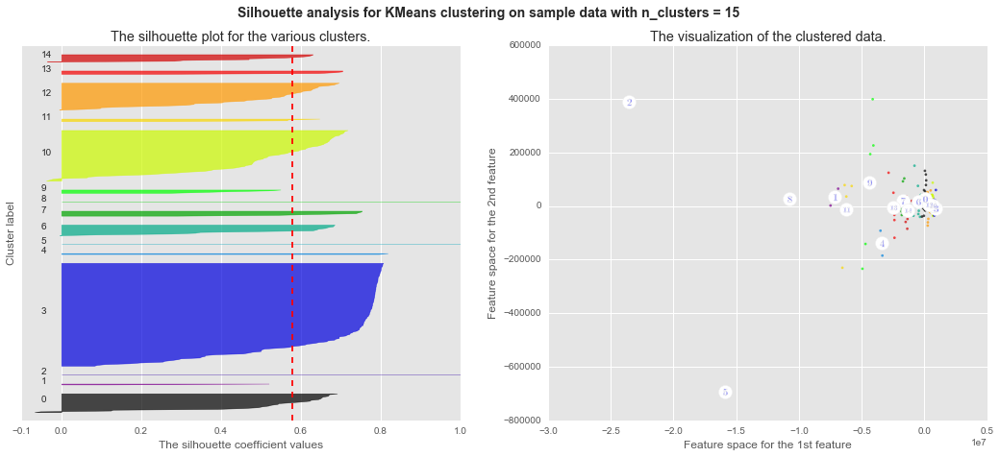

********************
Number of Components for PCA: 18
For n_clusters = 16 The average silhouette_score is : 0.600977577196


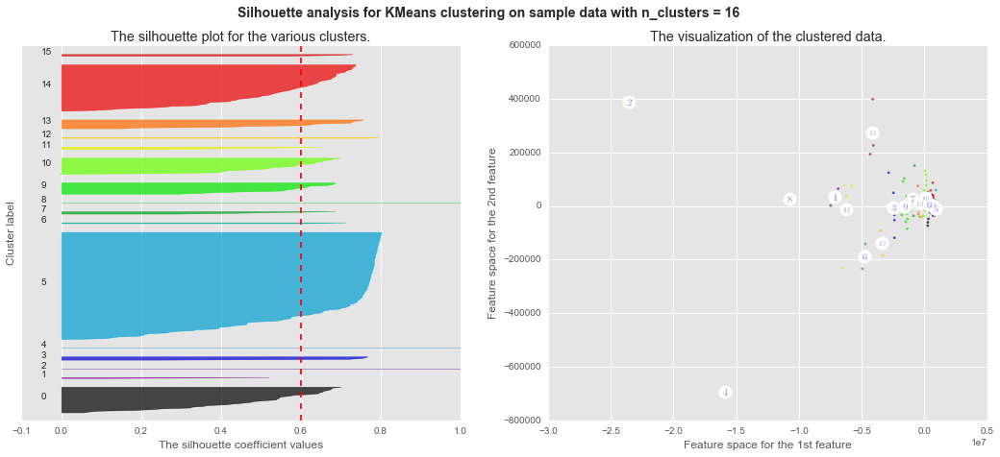

********************
Number of Components for PCA: 18
For n_clusters = 17 The average silhouette_score is : 0.54792732235


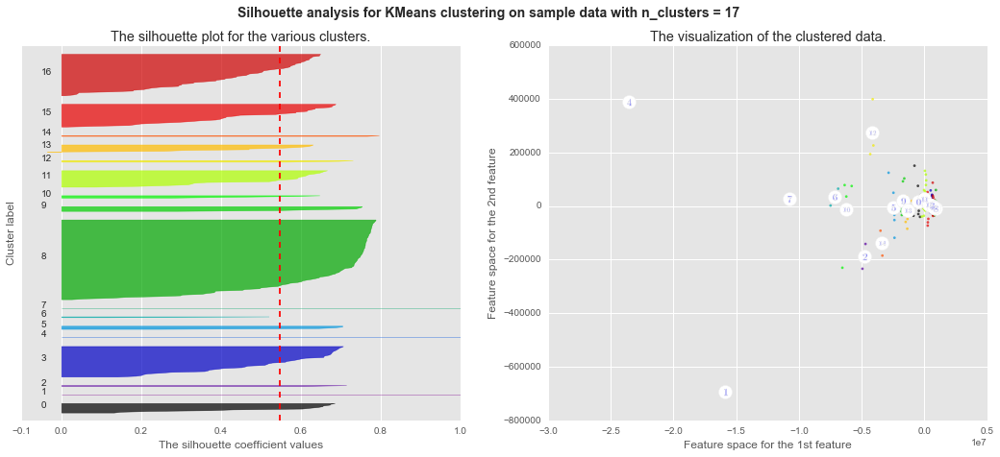

********************
Number of Components for PCA: 18
For n_clusters = 18 The average silhouette_score is : 0.596368411841


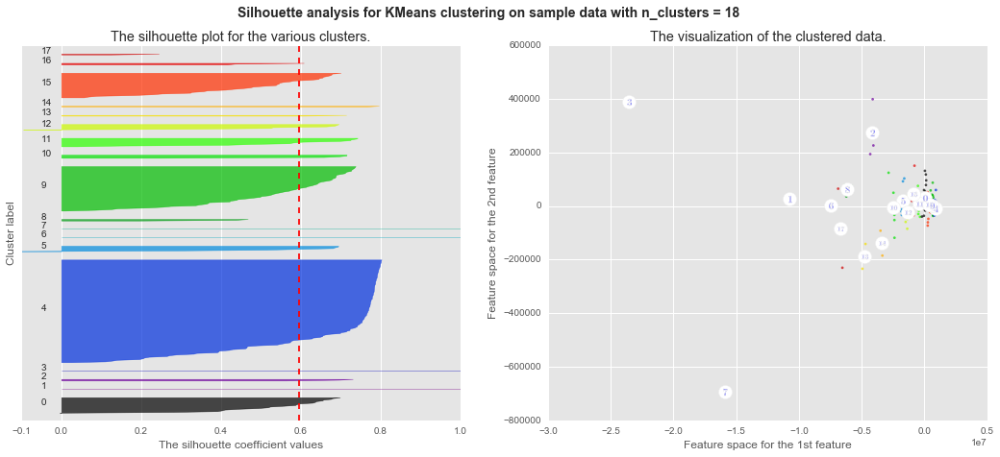

********************
Number of Components for PCA: 18
For n_clusters = 19 The average silhouette_score is : 0.552711219274


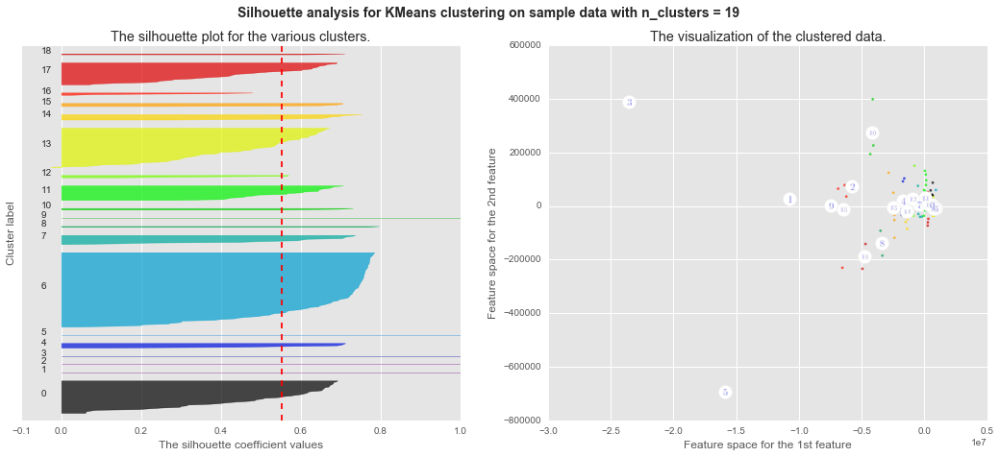

********************
Number of Components for PCA: 18
For n_clusters = 20 The average silhouette_score is : 0.543616904709


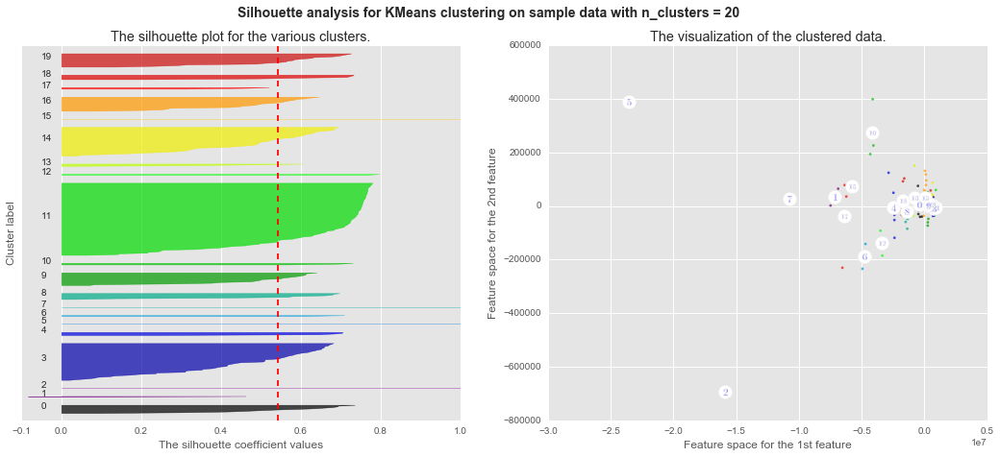

********************
Number of Components for PCA: 18
For n_clusters = 21 The average silhouette_score is : 0.526049901697


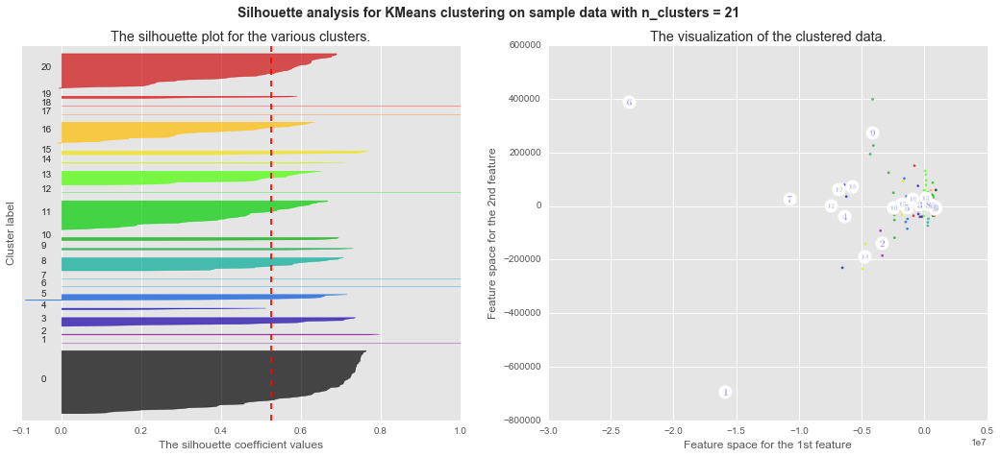

********************
Number of Components for PCA: 19
********************
********************
Number of Components for PCA: 19
For n_clusters = 4 The average silhouette_score is : 0.794910205429


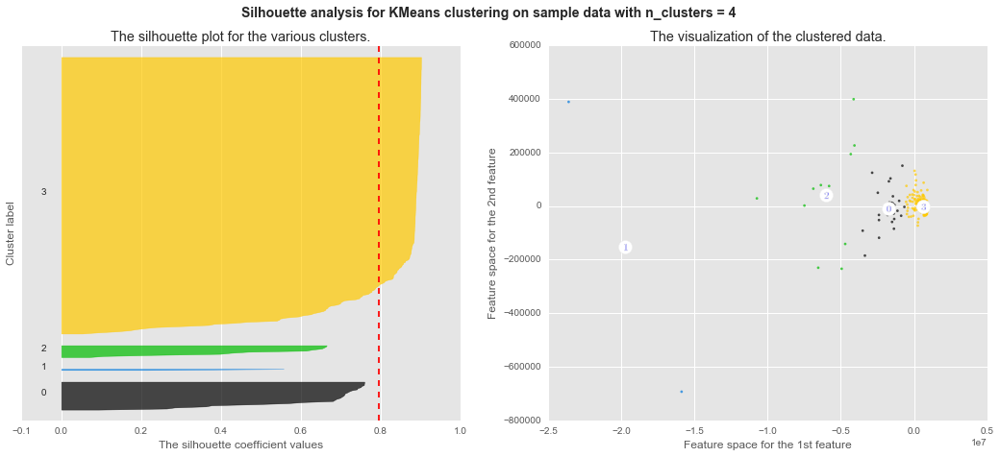

********************
Number of Components for PCA: 19
For n_clusters = 5 The average silhouette_score is : 0.798095898734


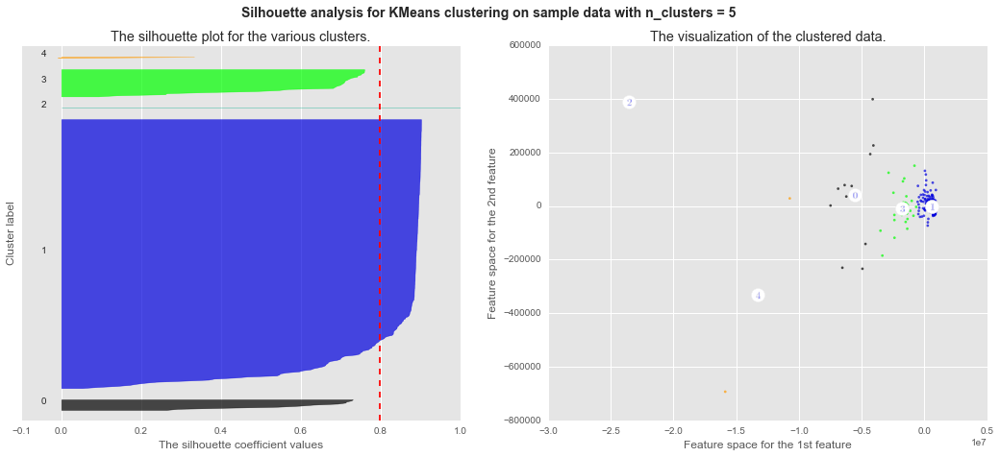

********************
Number of Components for PCA: 19
For n_clusters = 6 The average silhouette_score is : 0.683324548845


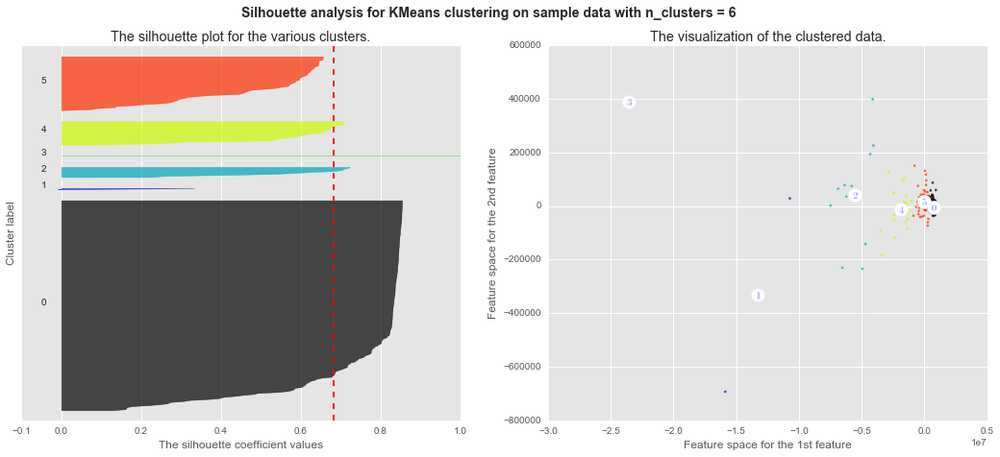

********************
Number of Components for PCA: 19
For n_clusters = 7 The average silhouette_score is : 0.686222451858


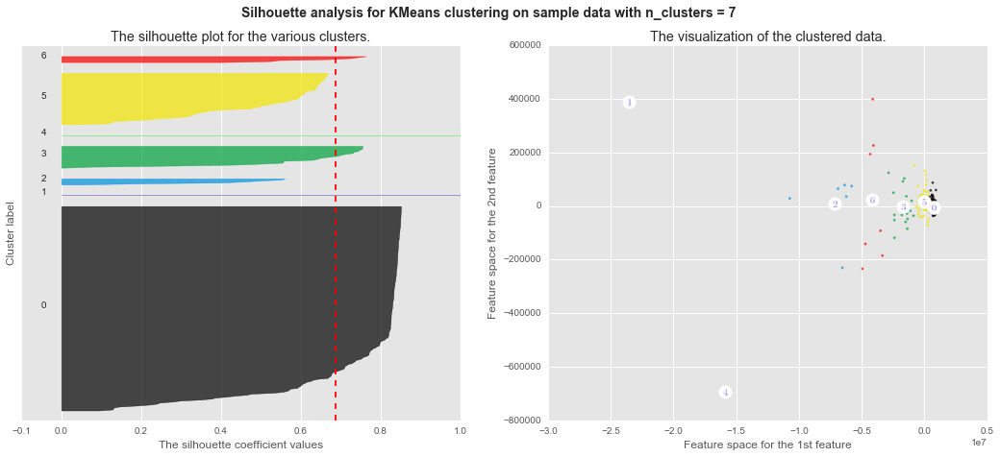

********************
Number of Components for PCA: 19
For n_clusters = 8 The average silhouette_score is : 0.692963484509


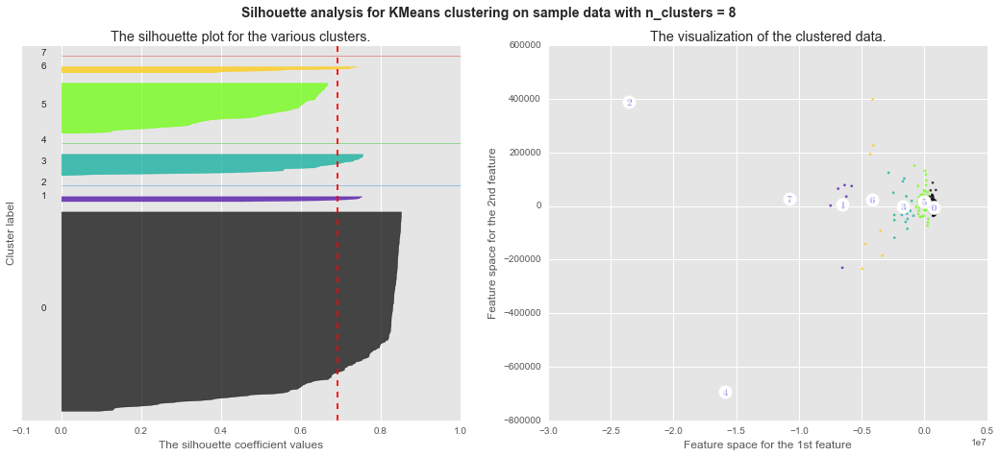

********************
Number of Components for PCA: 19
For n_clusters = 9 The average silhouette_score is : 0.655873925077


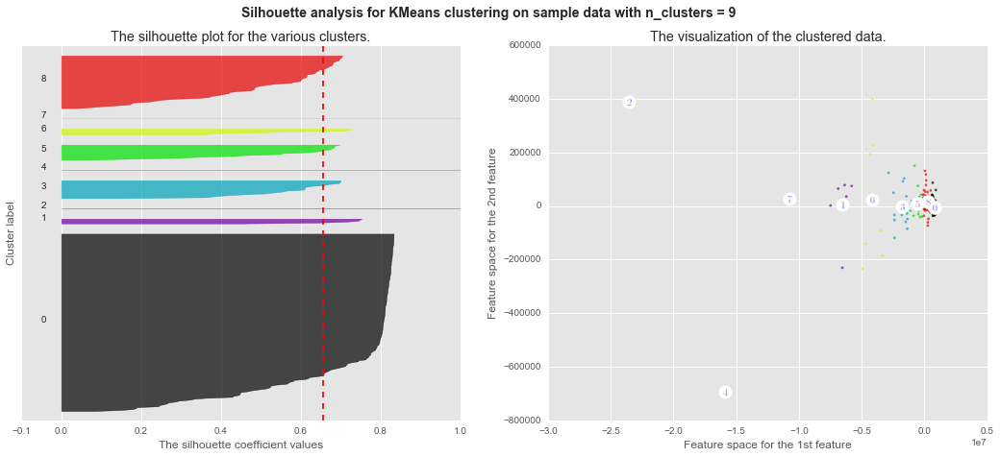

********************
Number of Components for PCA: 19
For n_clusters = 10 The average silhouette_score is : 0.617198784685


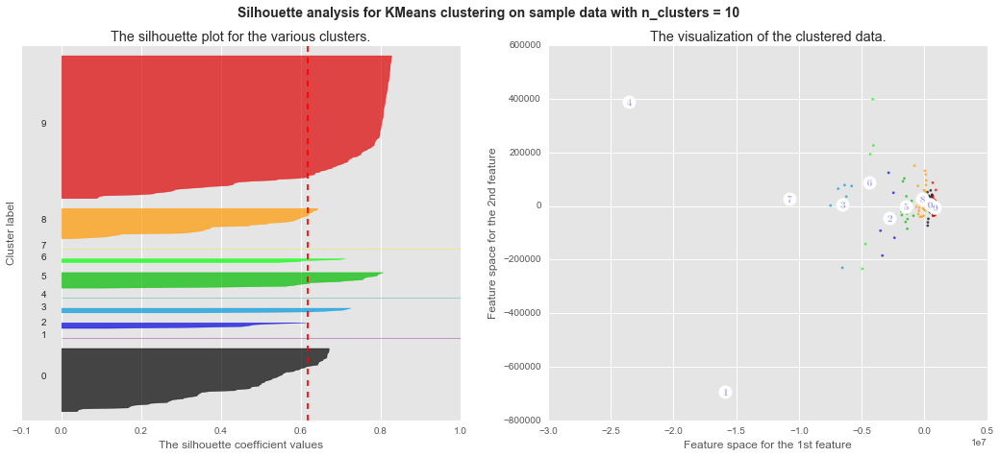

********************
Number of Components for PCA: 19
For n_clusters = 11 The average silhouette_score is : 0.61448523564


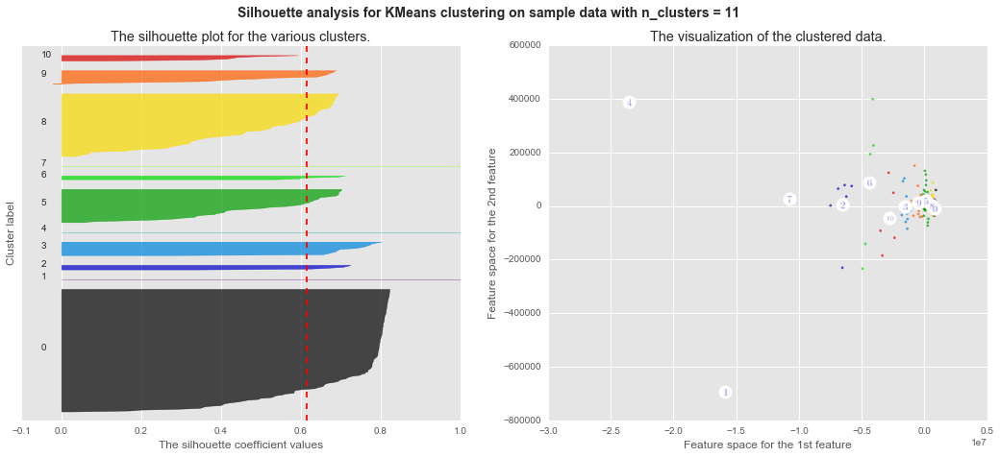

********************
Number of Components for PCA: 19
For n_clusters = 12 The average silhouette_score is : 0.61191155589


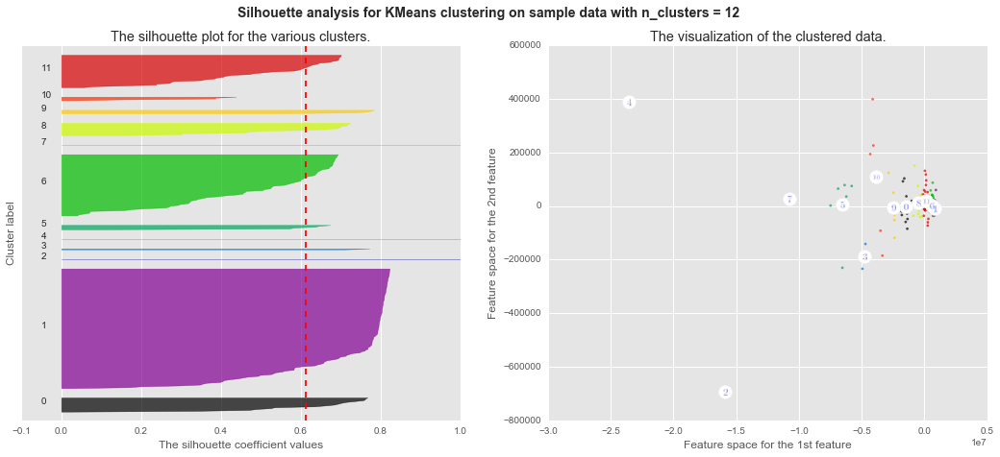

********************
Number of Components for PCA: 19
For n_clusters = 13 The average silhouette_score is : 0.609251380043


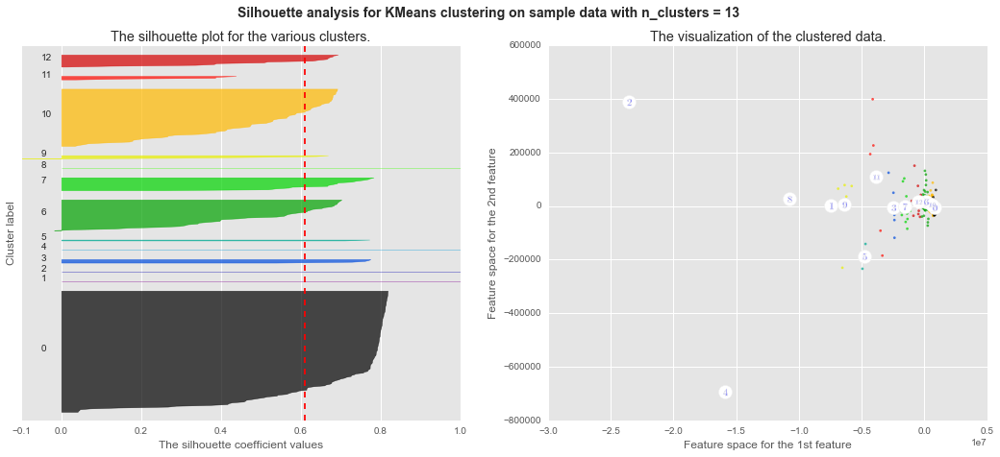

********************
Number of Components for PCA: 19
For n_clusters = 14 The average silhouette_score is : 0.615217796625


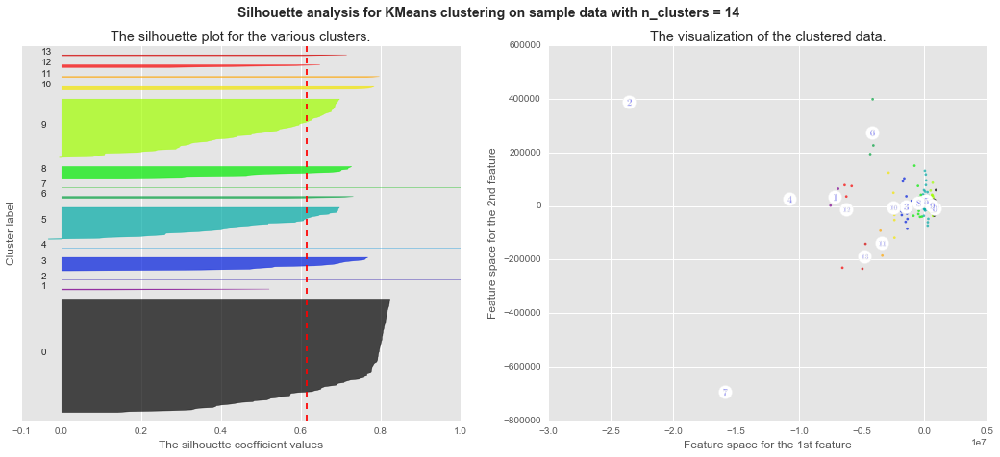

********************
Number of Components for PCA: 19
For n_clusters = 15 The average silhouette_score is : 0.598588881135


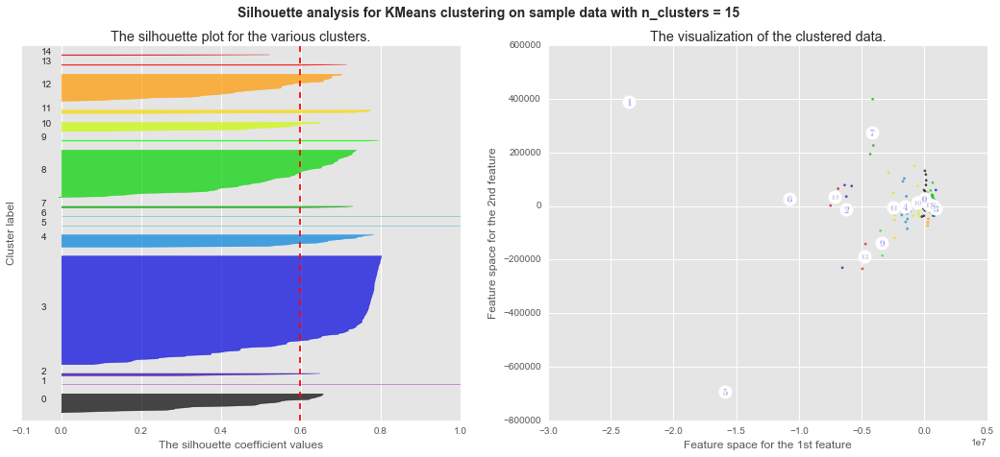

********************
Number of Components for PCA: 19
For n_clusters = 16 The average silhouette_score is : 0.580644238812


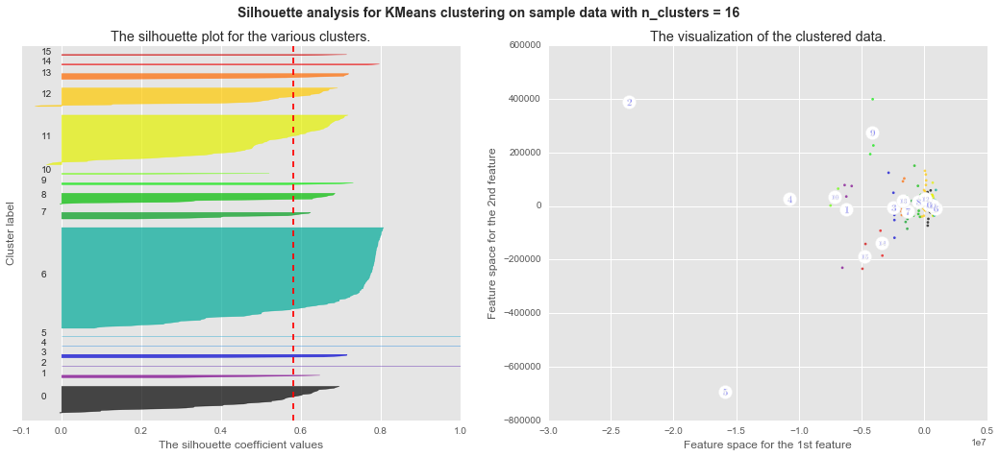

********************
Number of Components for PCA: 19
For n_clusters = 17 The average silhouette_score is : 0.54755615708


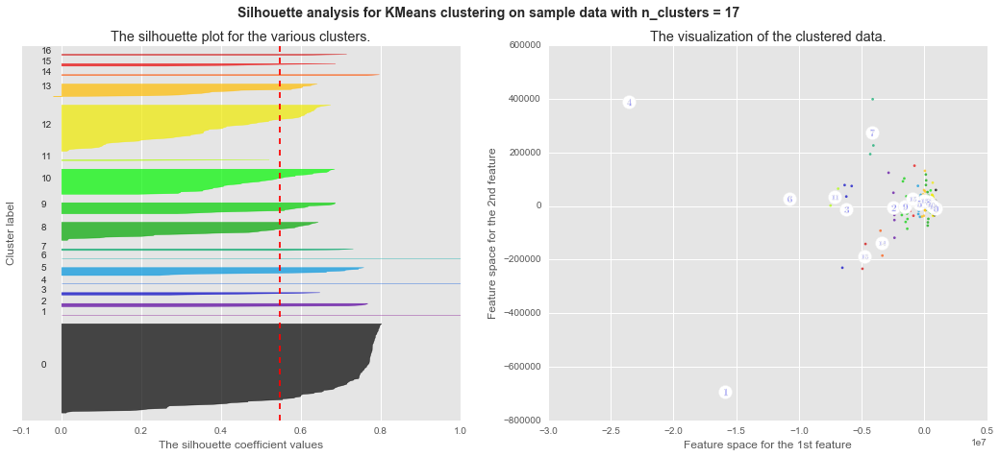

********************
Number of Components for PCA: 19
For n_clusters = 18 The average silhouette_score is : 0.600732295175


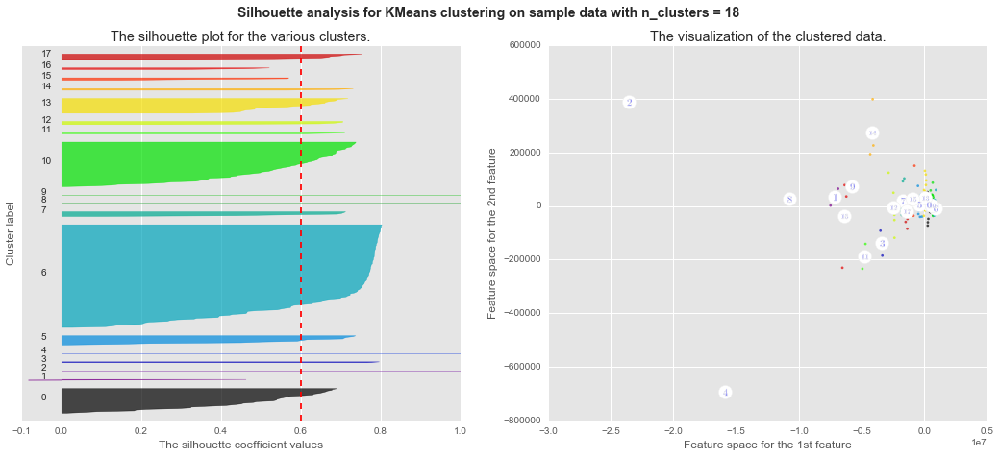

********************
Number of Components for PCA: 19
For n_clusters = 19 The average silhouette_score is : 0.548576973002


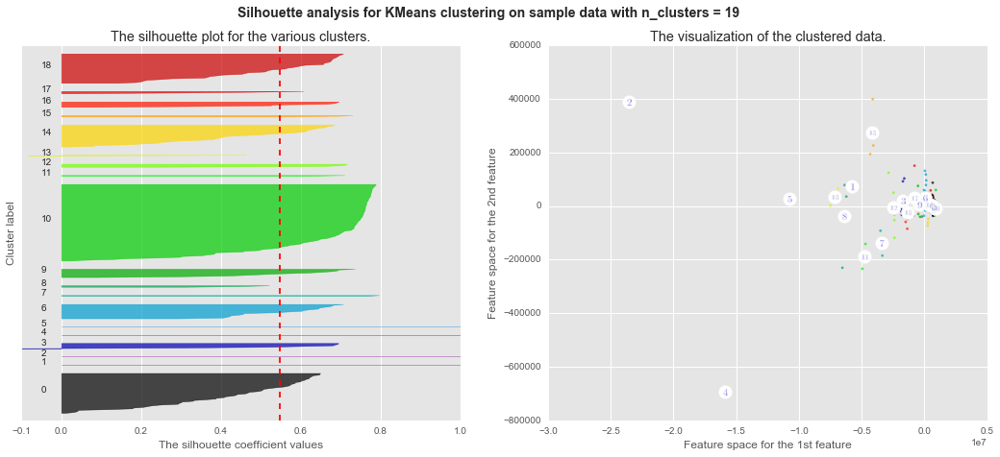

********************
Number of Components for PCA: 19
For n_clusters = 20 The average silhouette_score is : 0.554912099187


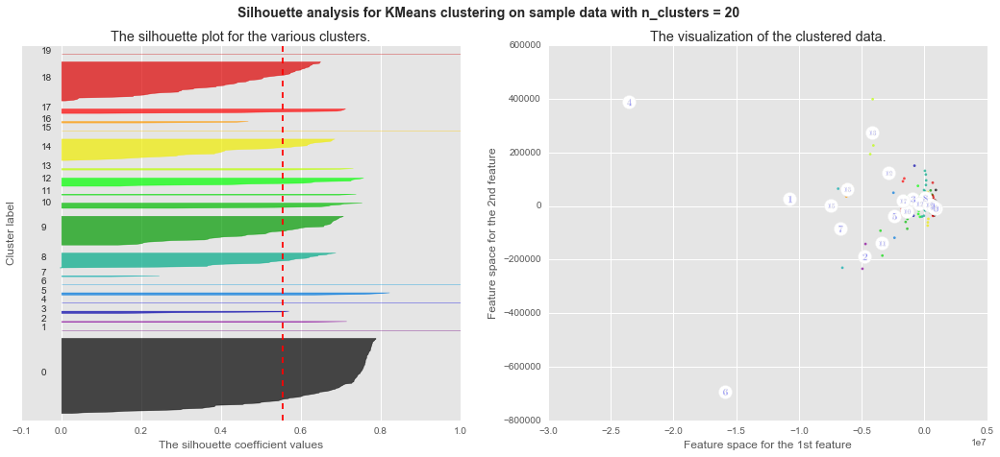

********************
Number of Components for PCA: 19
For n_clusters = 21 The average silhouette_score is : 0.537949328778


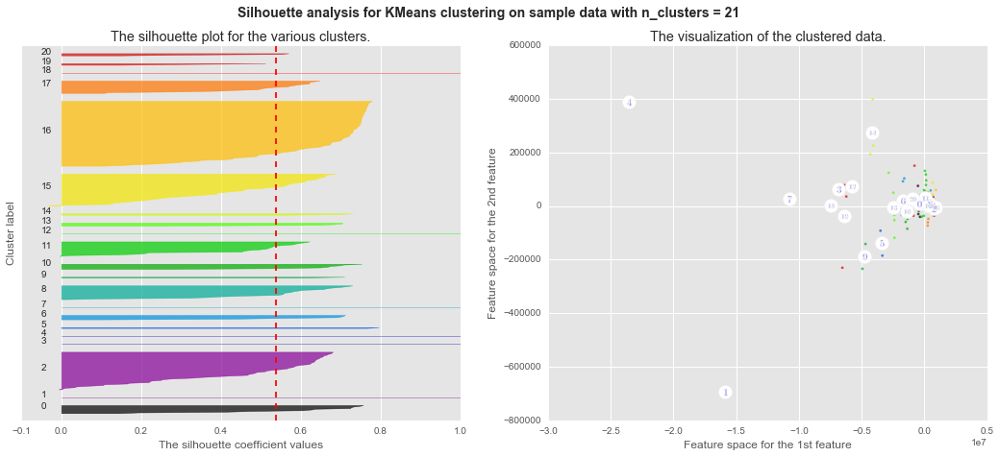

********************
Number of Components for PCA: 20
********************
********************
Number of Components for PCA: 20
For n_clusters = 4 The average silhouette_score is : 0.794910205084


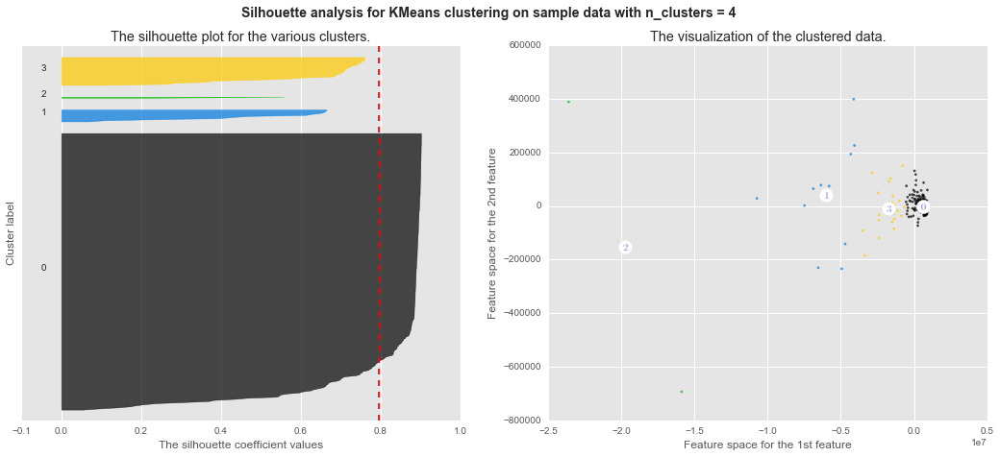

********************
Number of Components for PCA: 20
For n_clusters = 5 The average silhouette_score is : 0.782388138564


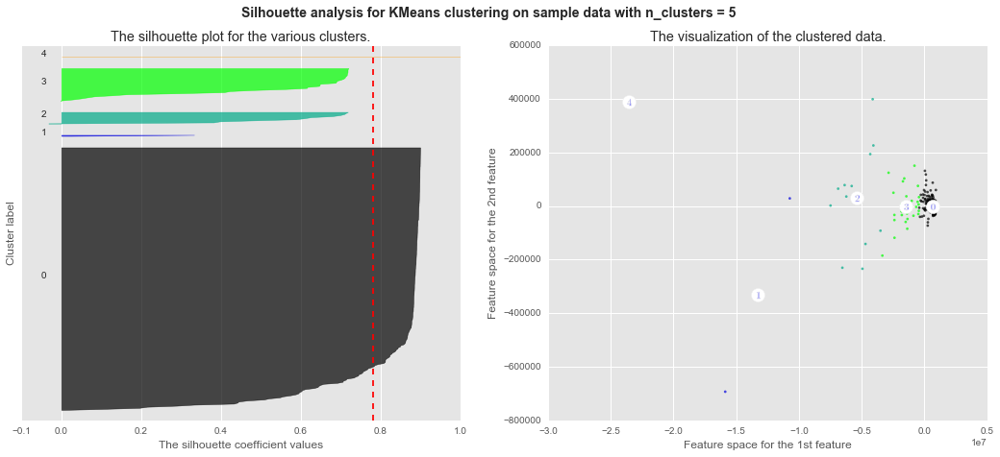

********************
Number of Components for PCA: 20
For n_clusters = 6 The average silhouette_score is : 0.683324547553


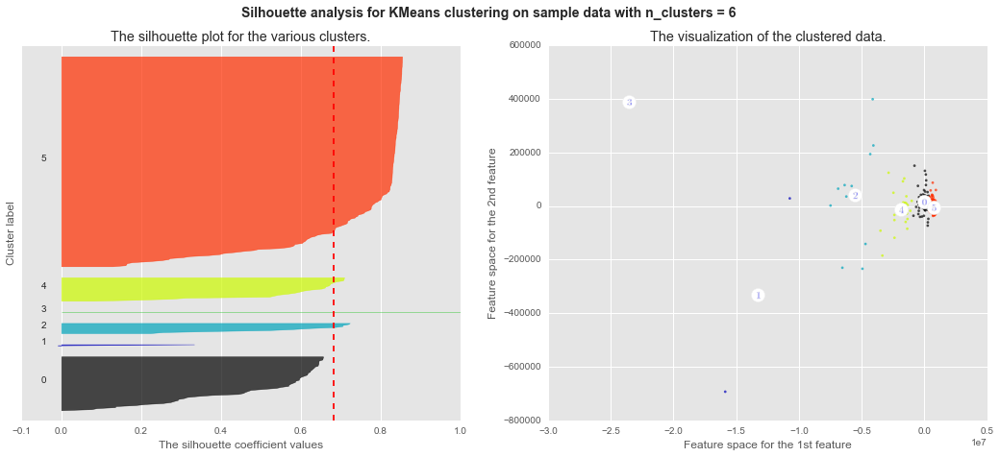

********************
Number of Components for PCA: 20
For n_clusters = 7 The average silhouette_score is : 0.686222450542


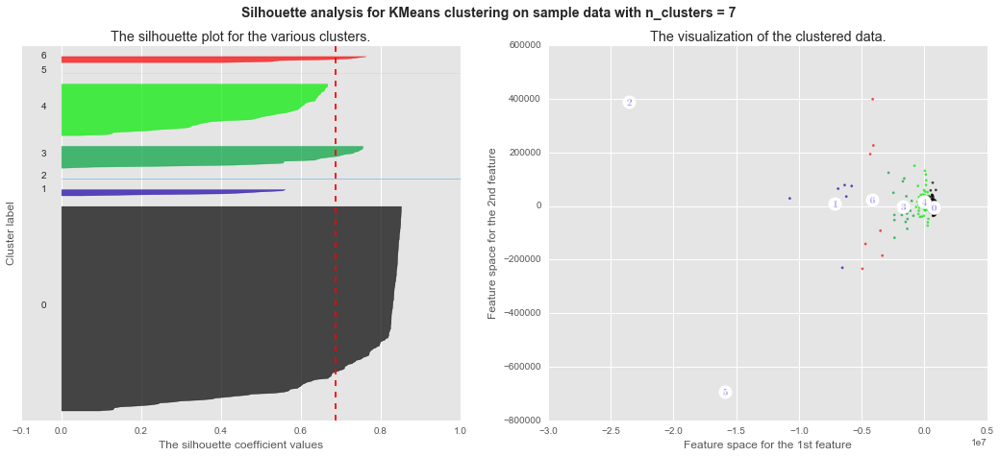

********************
Number of Components for PCA: 20
For n_clusters = 8 The average silhouette_score is : 0.692963483193


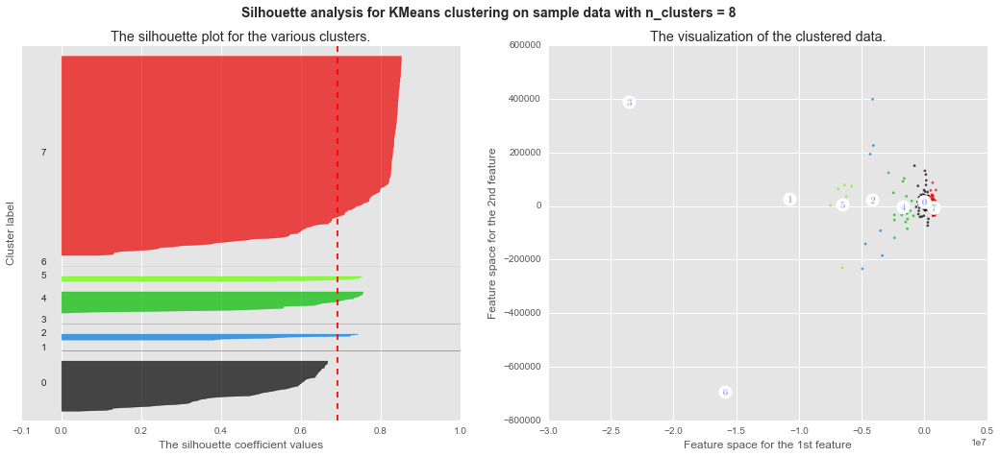

********************
Number of Components for PCA: 20
For n_clusters = 9 The average silhouette_score is : 0.655873922967


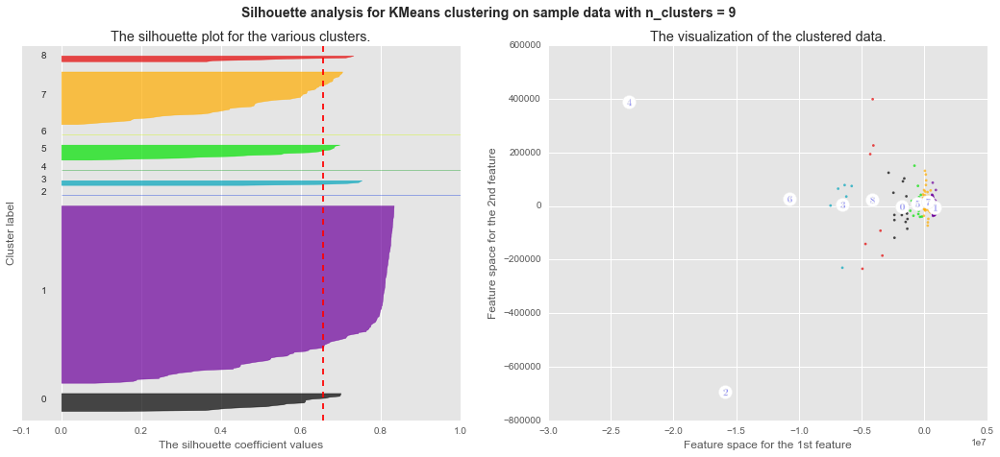

********************
Number of Components for PCA: 20
For n_clusters = 10 The average silhouette_score is : 0.617198781115


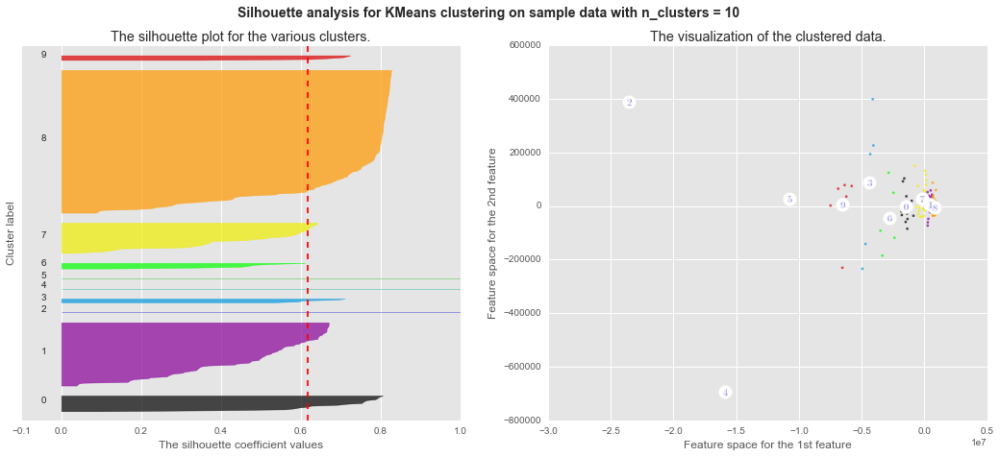

********************
Number of Components for PCA: 20
For n_clusters = 11 The average silhouette_score is : 0.614485230556


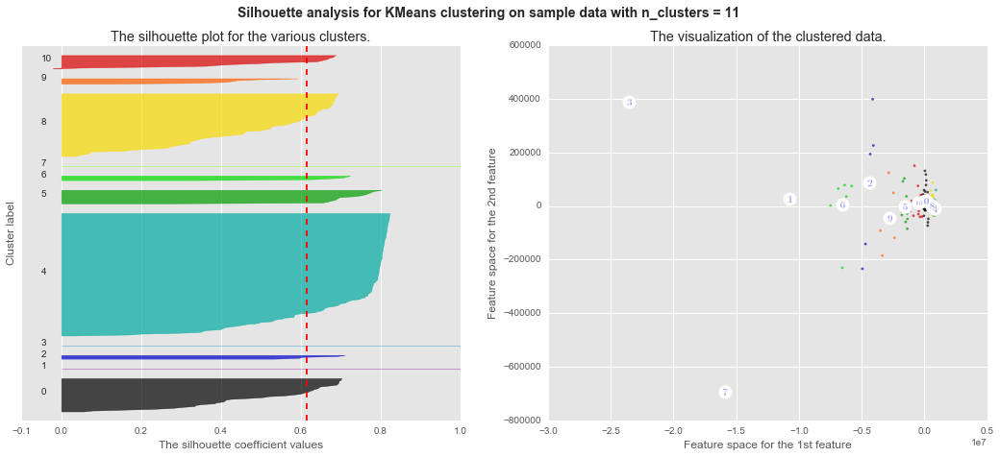

********************
Number of Components for PCA: 20
For n_clusters = 12 The average silhouette_score is : 0.615833403523


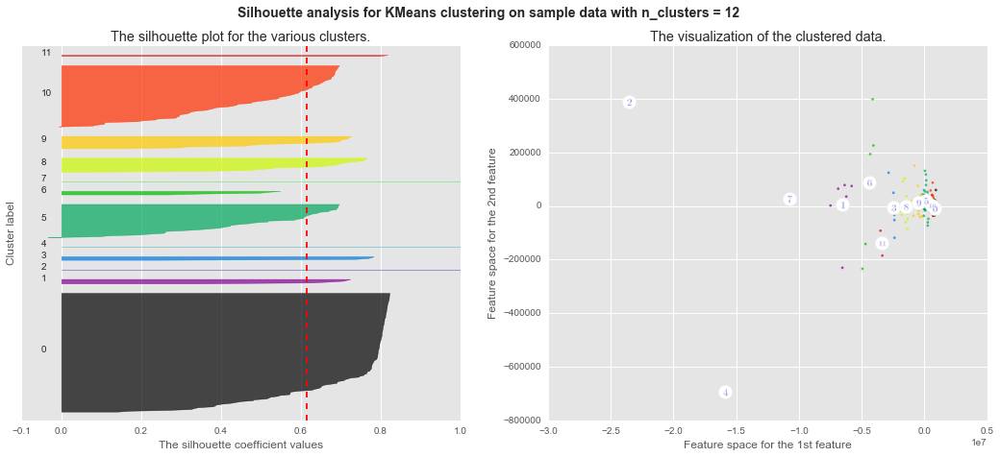

********************
Number of Components for PCA: 20
For n_clusters = 13 The average silhouette_score is : 0.609636746296


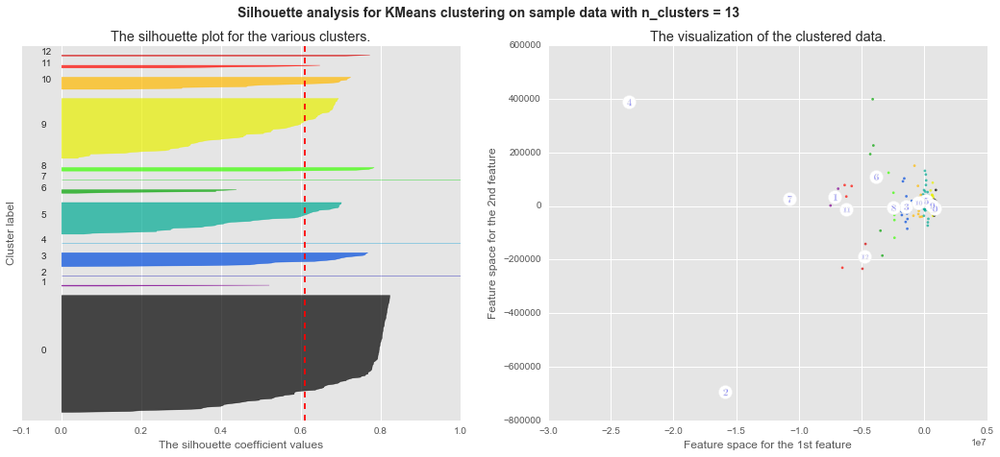

********************
Number of Components for PCA: 20
For n_clusters = 14 The average silhouette_score is : 0.602255902231


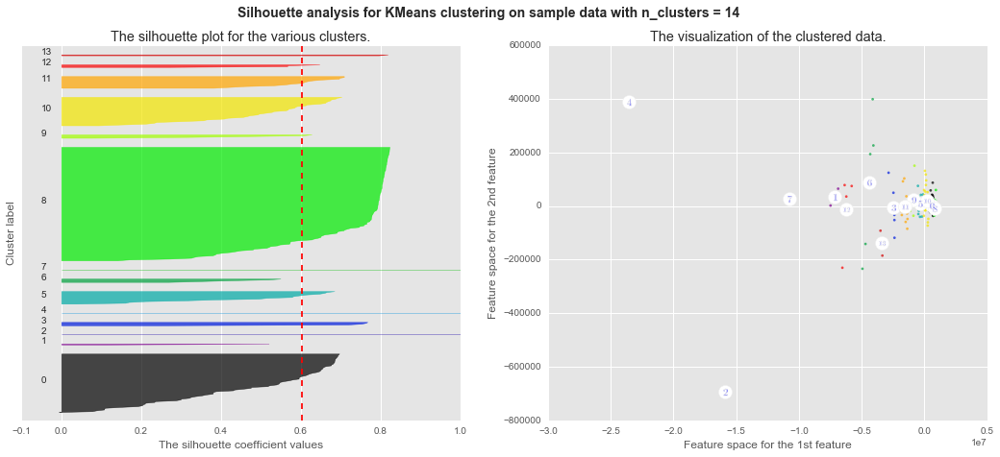

********************
Number of Components for PCA: 20
For n_clusters = 15 The average silhouette_score is : 0.591812643411


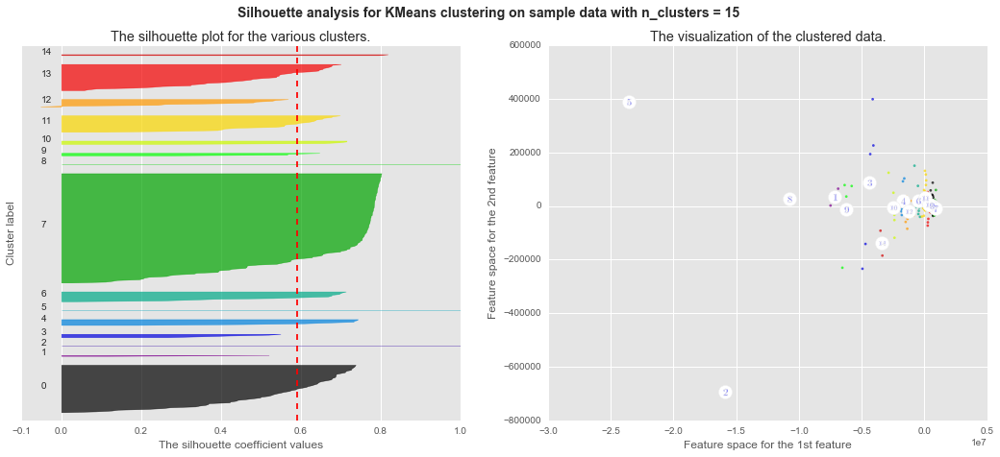

********************
Number of Components for PCA: 20
For n_clusters = 16 The average silhouette_score is : 0.59541713563


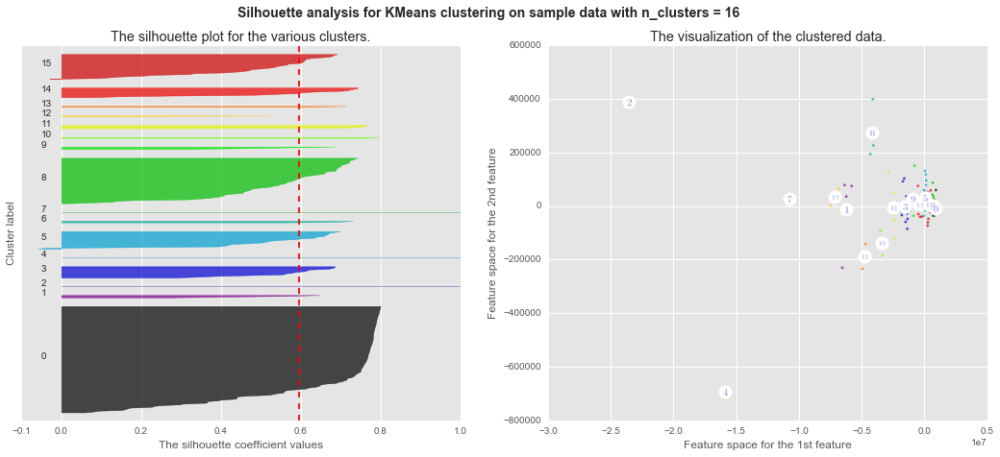

********************
Number of Components for PCA: 20
For n_clusters = 17 The average silhouette_score is : 0.5995039756


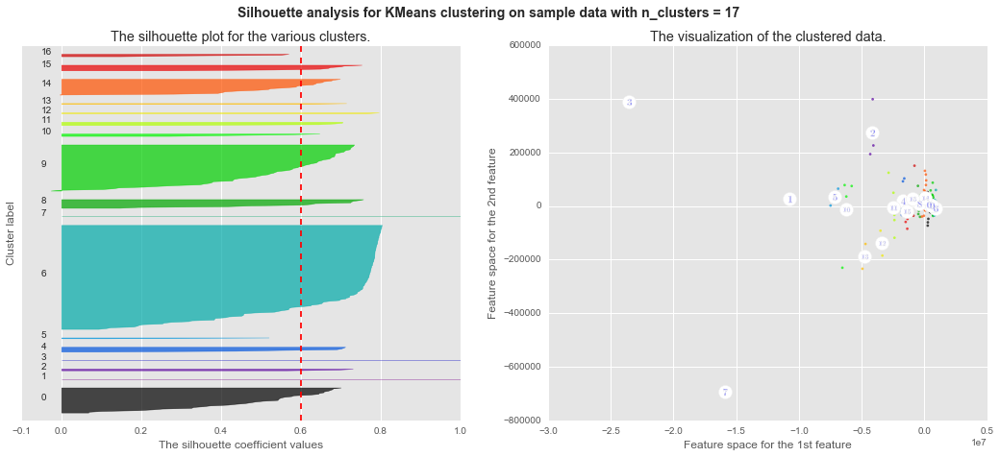

********************
Number of Components for PCA: 20
For n_clusters = 18 The average silhouette_score is : 0.547167877915


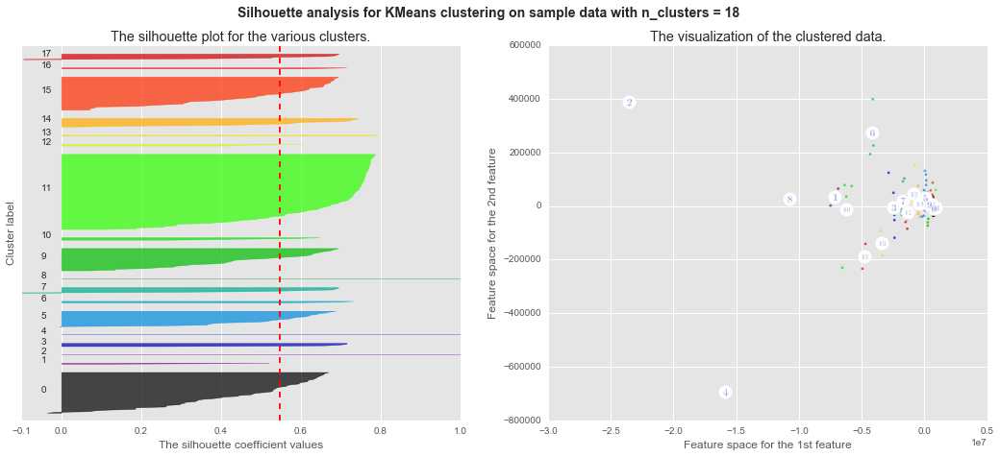

********************
Number of Components for PCA: 20
For n_clusters = 19 The average silhouette_score is : 0.540635061495


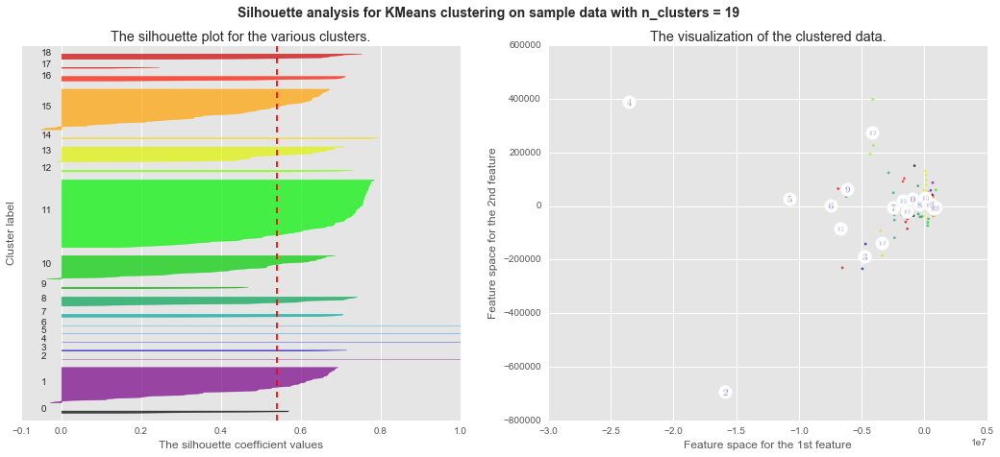

********************
Number of Components for PCA: 20
For n_clusters = 20 The average silhouette_score is : 0.543024486544


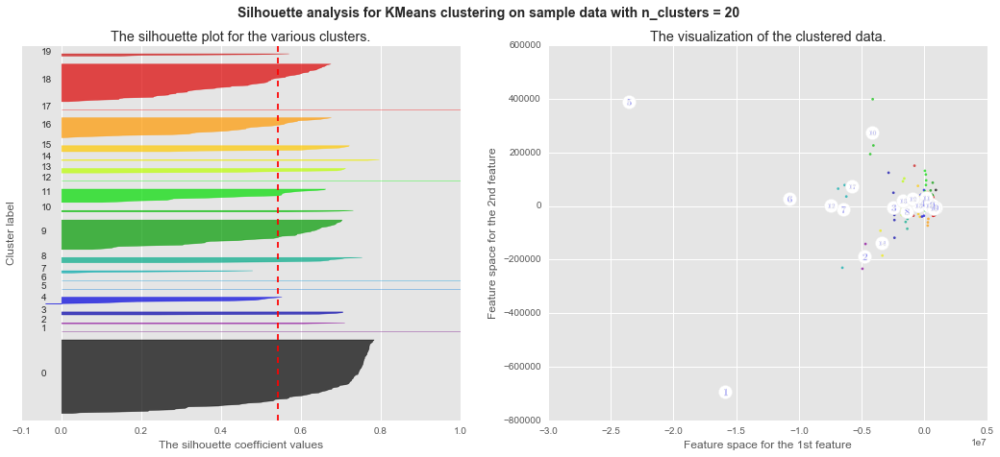

********************
Number of Components for PCA: 20
For n_clusters = 21 The average silhouette_score is : 0.521807175823


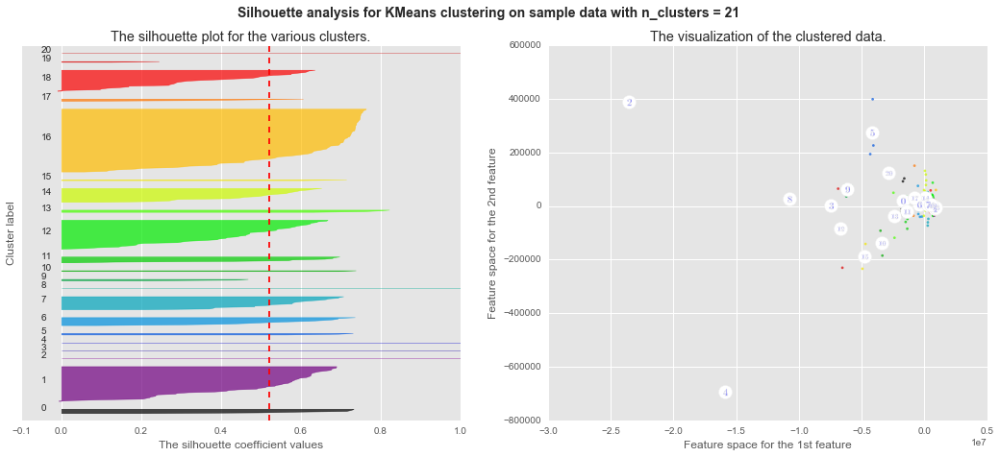

********************
Number of Components for PCA: 21
********************
********************
Number of Components for PCA: 21
For n_clusters = 4 The average silhouette_score is : 0.794910204887


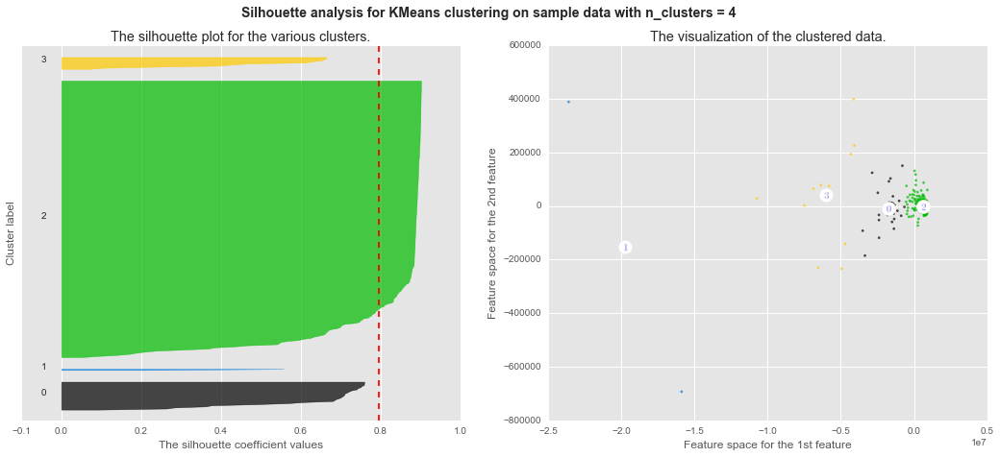

********************
Number of Components for PCA: 21
For n_clusters = 5 The average silhouette_score is : 0.798095898192


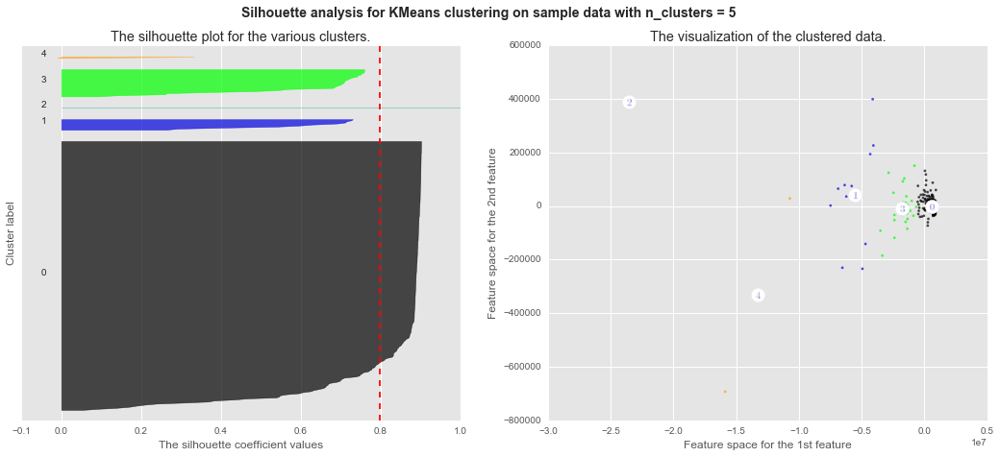

********************
Number of Components for PCA: 21
For n_clusters = 6 The average silhouette_score is : 0.683324546827


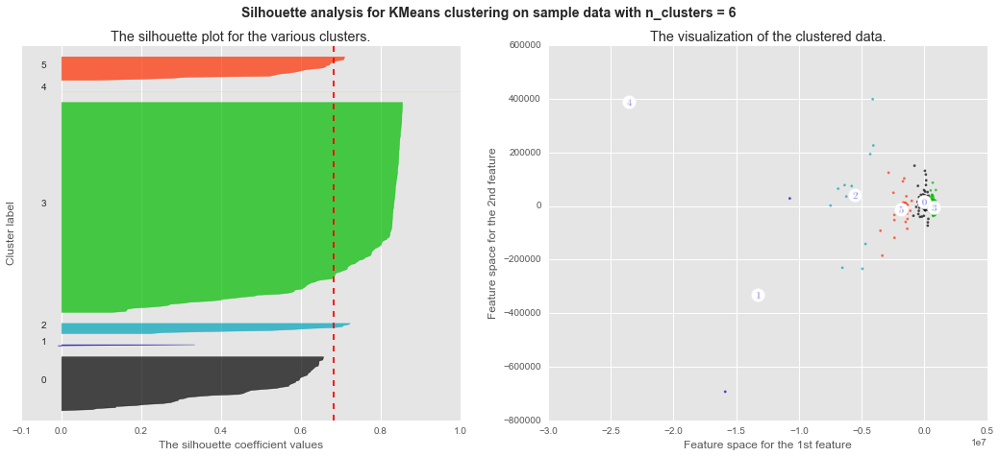

********************
Number of Components for PCA: 21
For n_clusters = 7 The average silhouette_score is : 0.686222449802


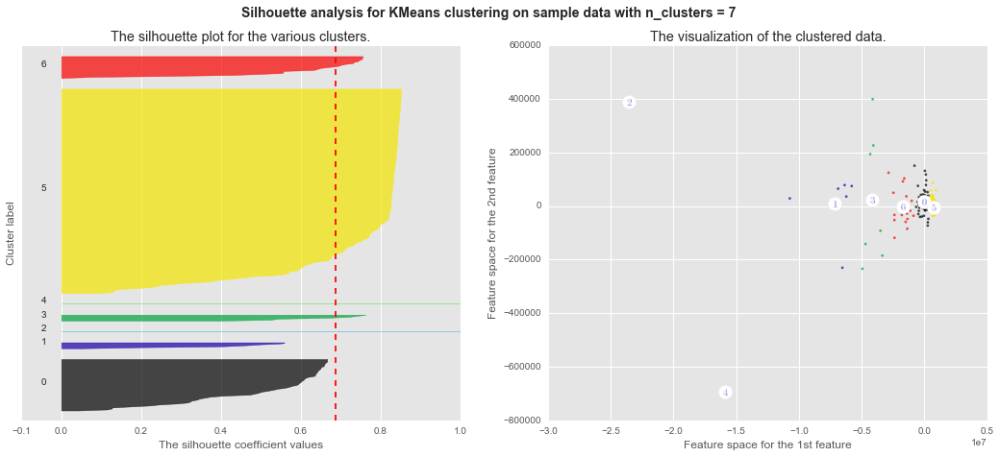

********************
Number of Components for PCA: 21
For n_clusters = 8 The average silhouette_score is : 0.692963482453


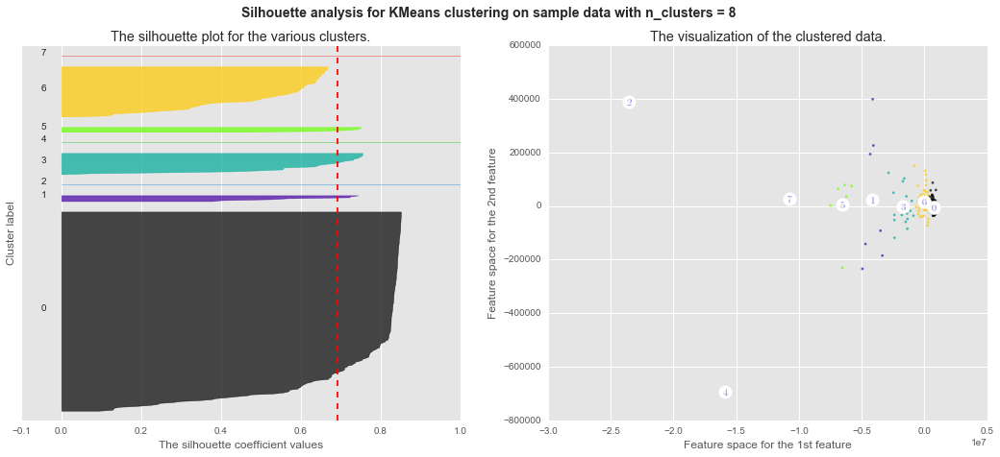

********************
Number of Components for PCA: 21
For n_clusters = 9 The average silhouette_score is : 0.655873921811


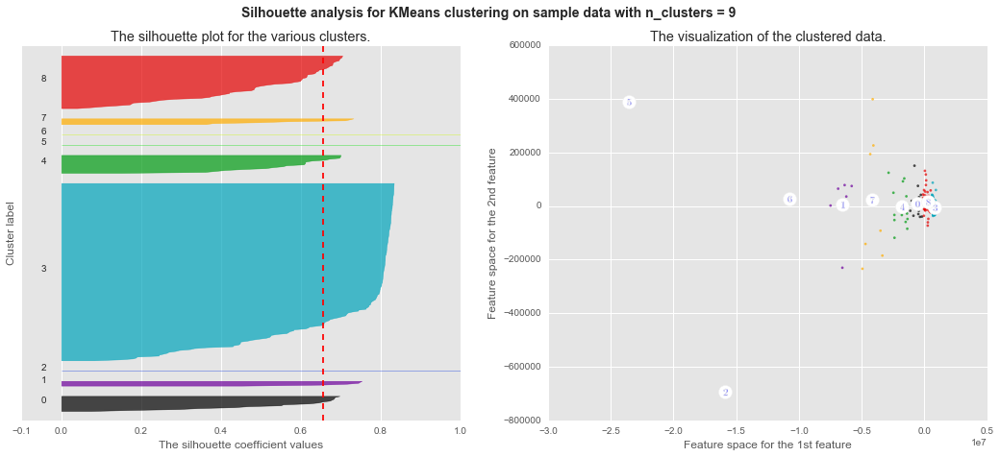

********************
Number of Components for PCA: 21
For n_clusters = 10 The average silhouette_score is : 0.617198779167


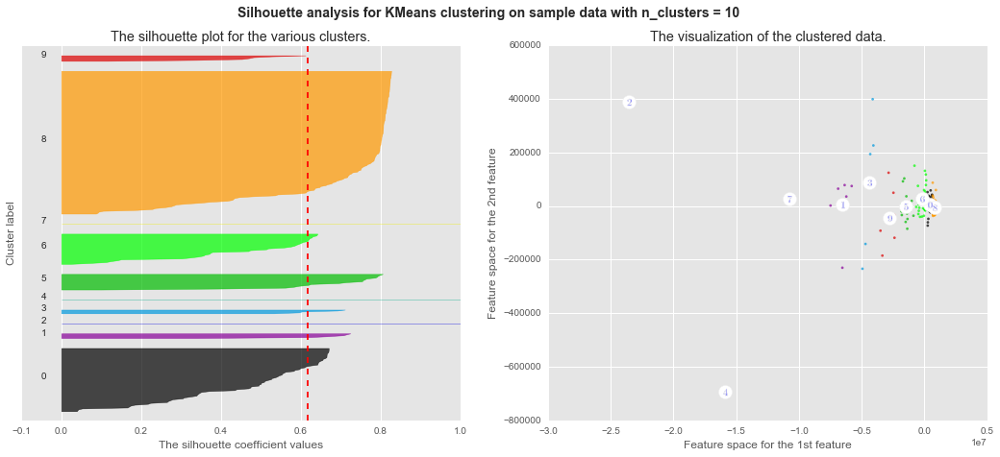

********************
Number of Components for PCA: 21
For n_clusters = 11 The average silhouette_score is : 0.6127592979


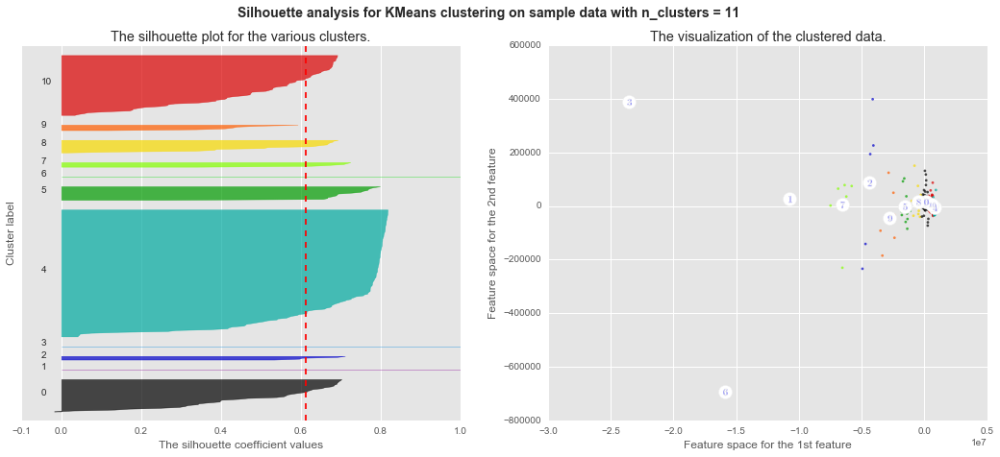

********************
Number of Components for PCA: 21
For n_clusters = 12 The average silhouette_score is : 0.615933987298


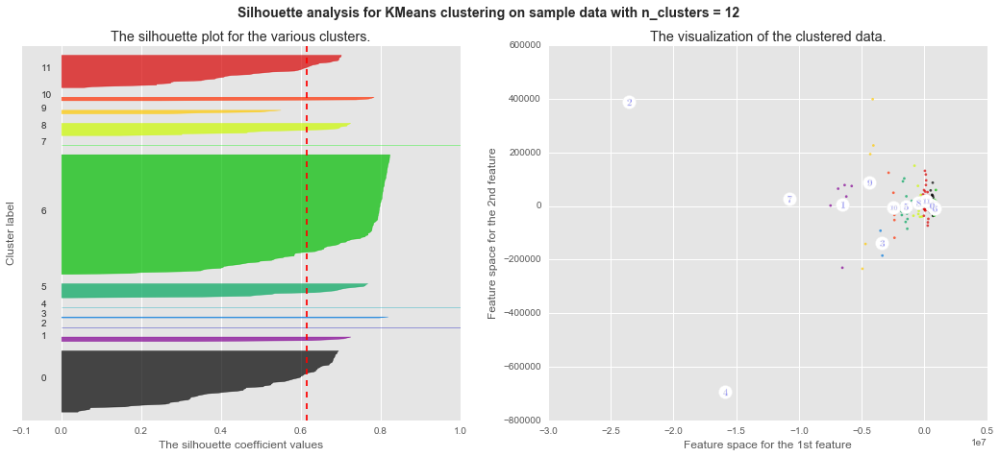

********************
Number of Components for PCA: 21
For n_clusters = 13 The average silhouette_score is : 0.613649979901


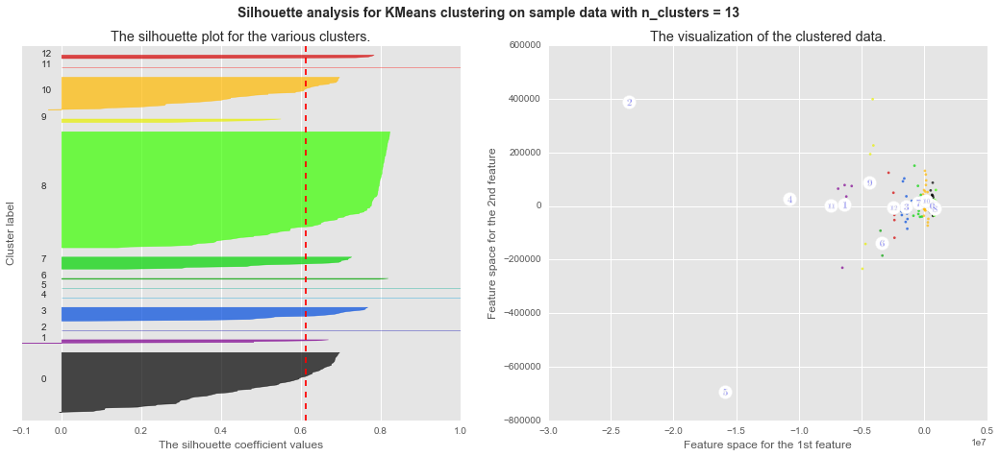

********************
Number of Components for PCA: 21
For n_clusters = 14 The average silhouette_score is : 0.615318375221


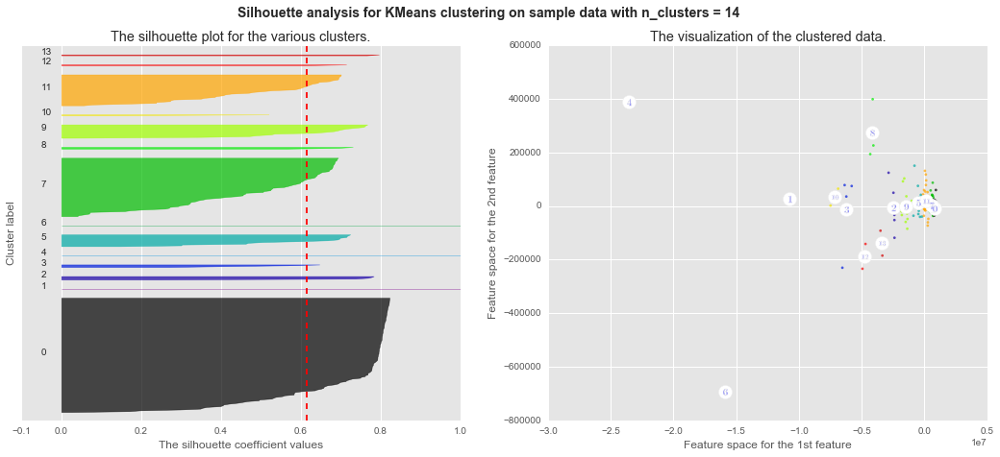

********************
Number of Components for PCA: 21
For n_clusters = 15 The average silhouette_score is : 0.592172689539


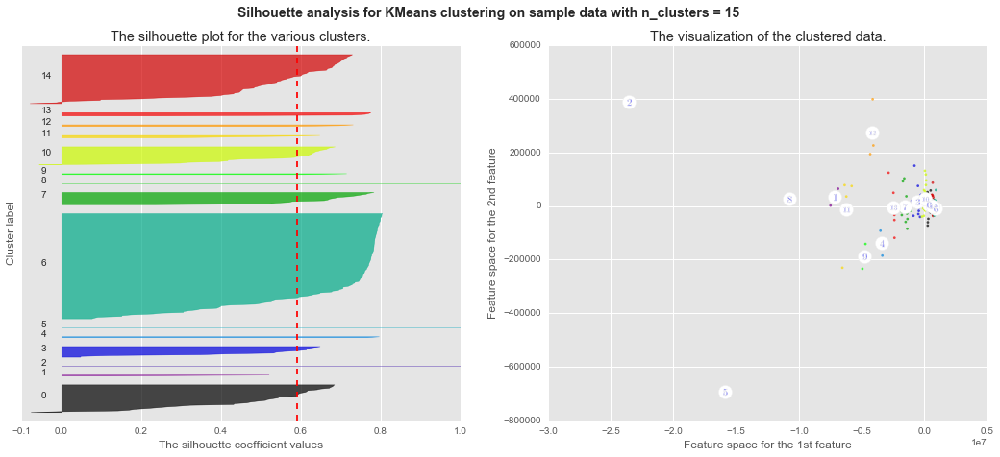

********************
Number of Components for PCA: 21
For n_clusters = 16 The average silhouette_score is : 0.599207750964


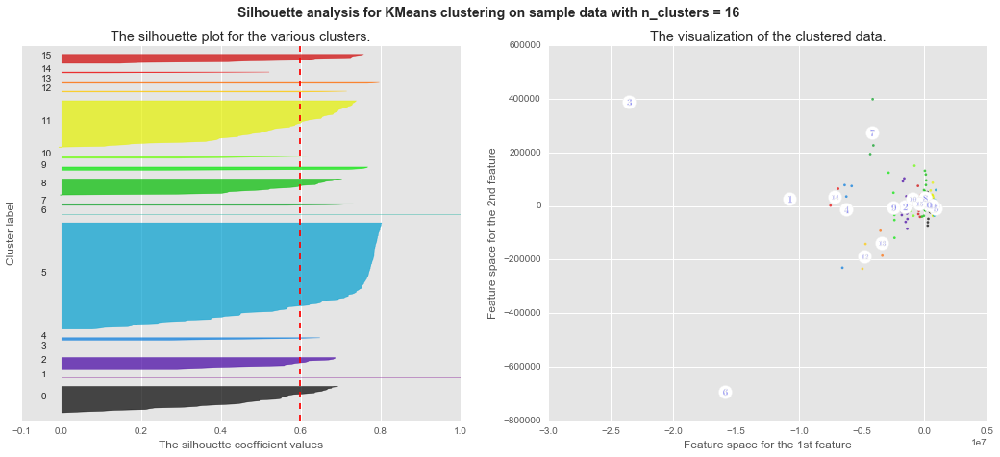

********************
Number of Components for PCA: 21
For n_clusters = 17 The average silhouette_score is : 0.600442863428


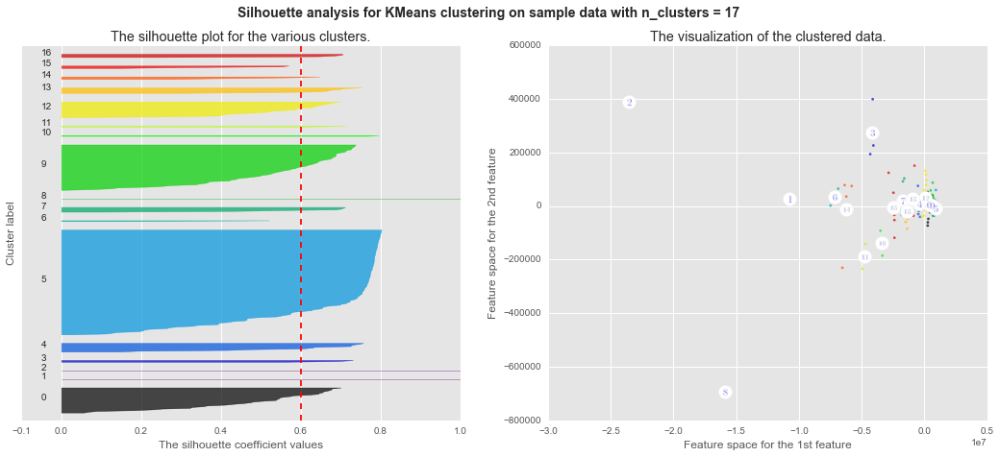

********************
Number of Components for PCA: 21
For n_clusters = 18 The average silhouette_score is : 0.548273376589


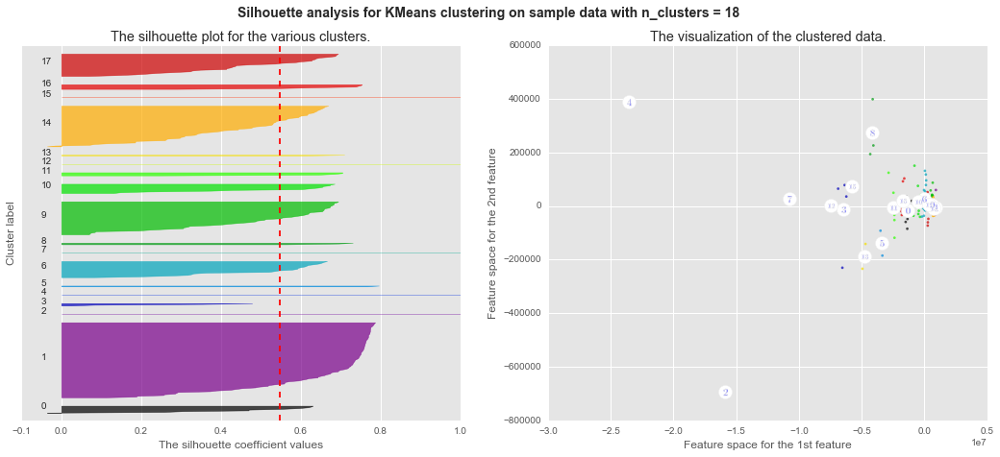

********************
Number of Components for PCA: 21
For n_clusters = 19 The average silhouette_score is : 0.548937622691


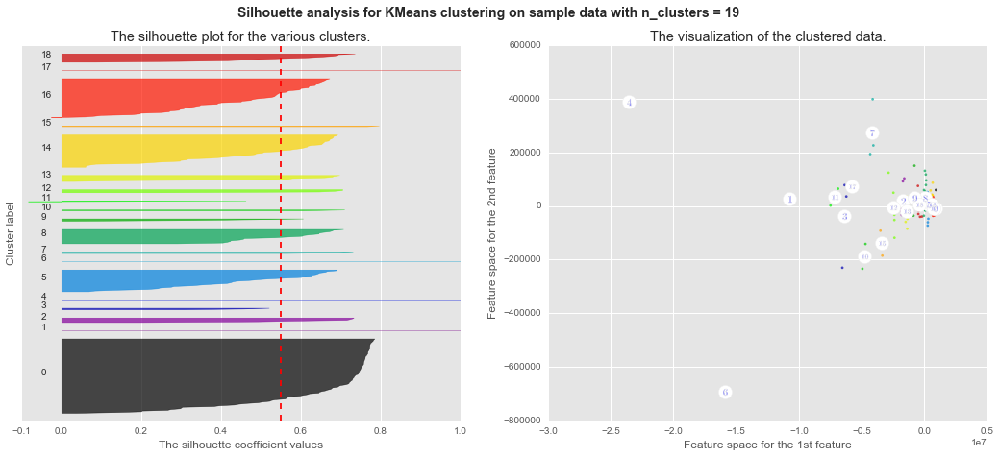

********************
Number of Components for PCA: 21
For n_clusters = 20 The average silhouette_score is : 0.555179794832


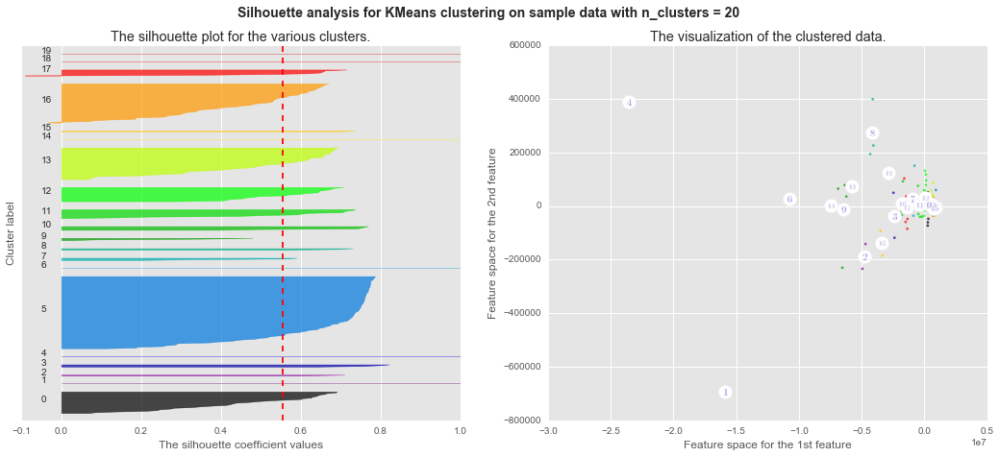

********************
Number of Components for PCA: 21
For n_clusters = 21 The average silhouette_score is : 0.536343840756


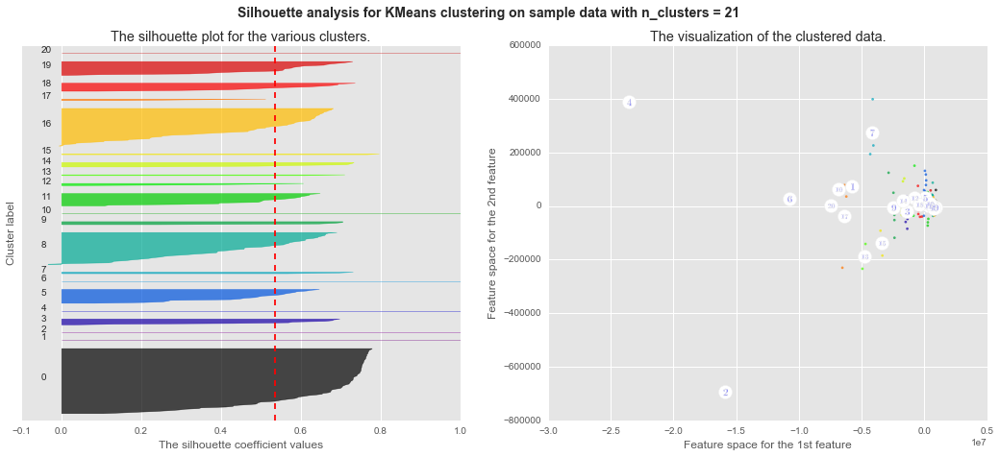

********************
Number of Components for PCA: 22
********************
********************
Number of Components for PCA: 22
For n_clusters = 4 The average silhouette_score is : 0.794910204773


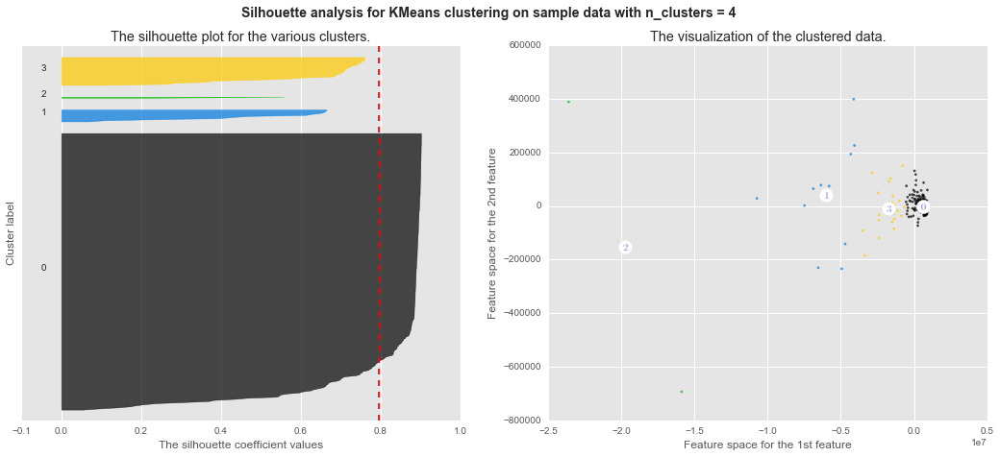

********************
Number of Components for PCA: 22
For n_clusters = 5 The average silhouette_score is : 0.798095898078


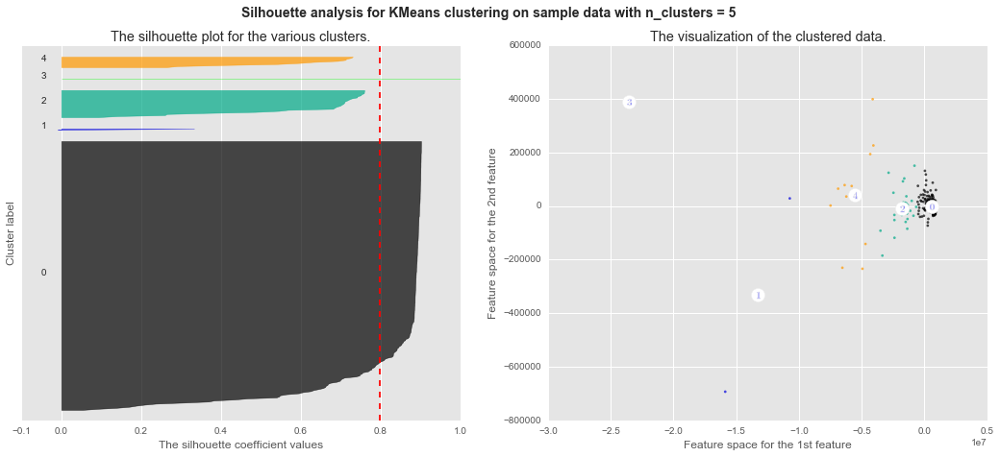

********************
Number of Components for PCA: 22
For n_clusters = 6 The average silhouette_score is : 0.683324546412


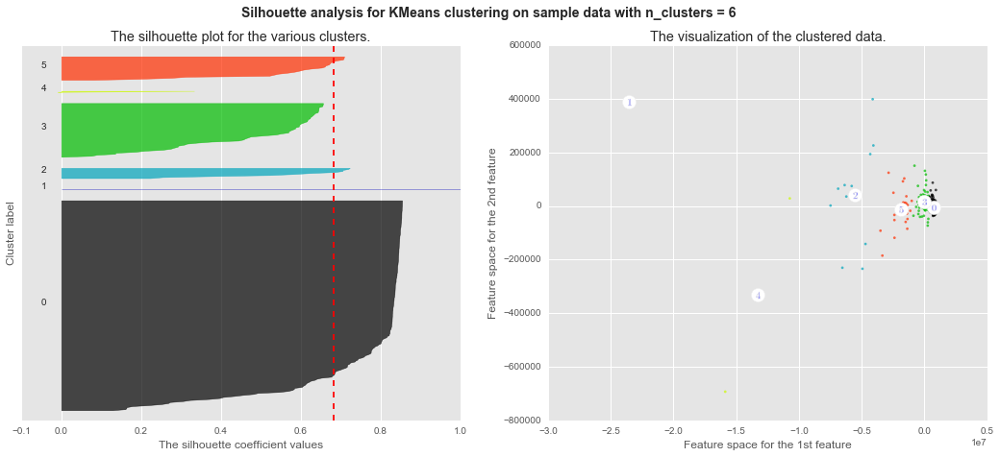

********************
Number of Components for PCA: 22
For n_clusters = 7 The average silhouette_score is : 0.68679316158


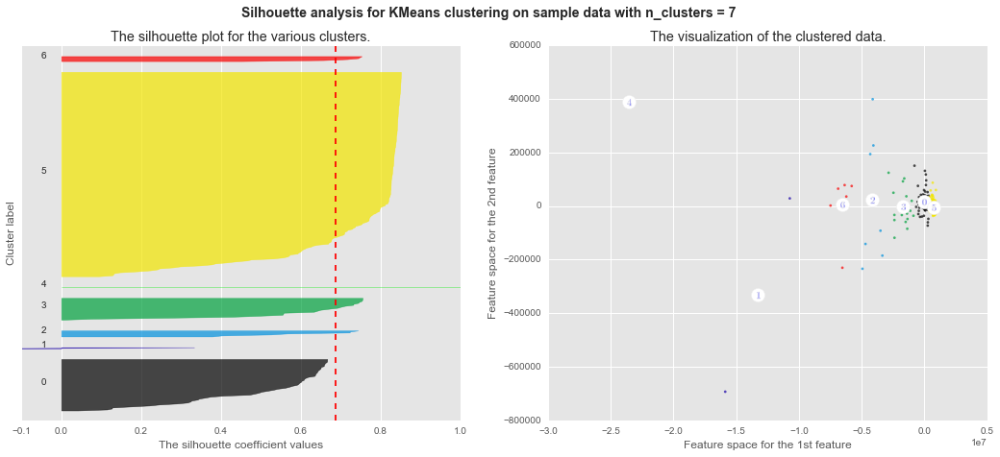

********************
Number of Components for PCA: 22
For n_clusters = 8 The average silhouette_score is : 0.692963482029


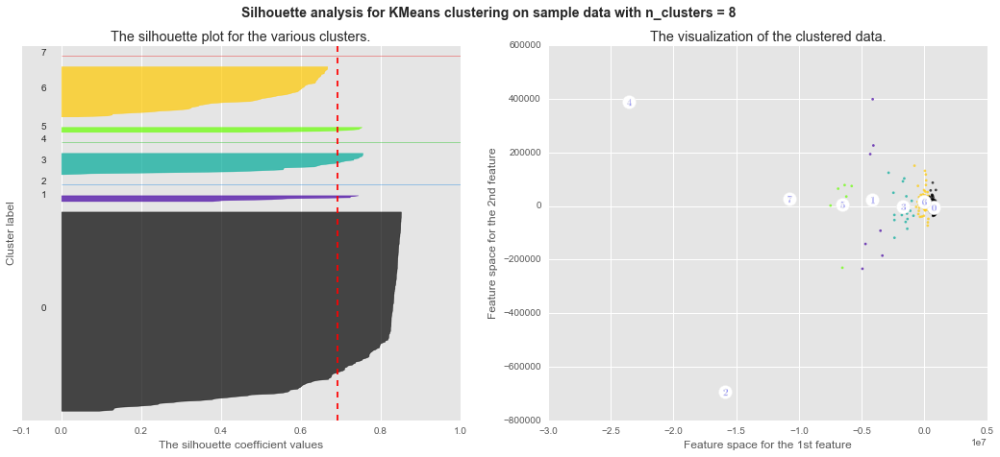

********************
Number of Components for PCA: 22
For n_clusters = 9 The average silhouette_score is : 0.655873921172


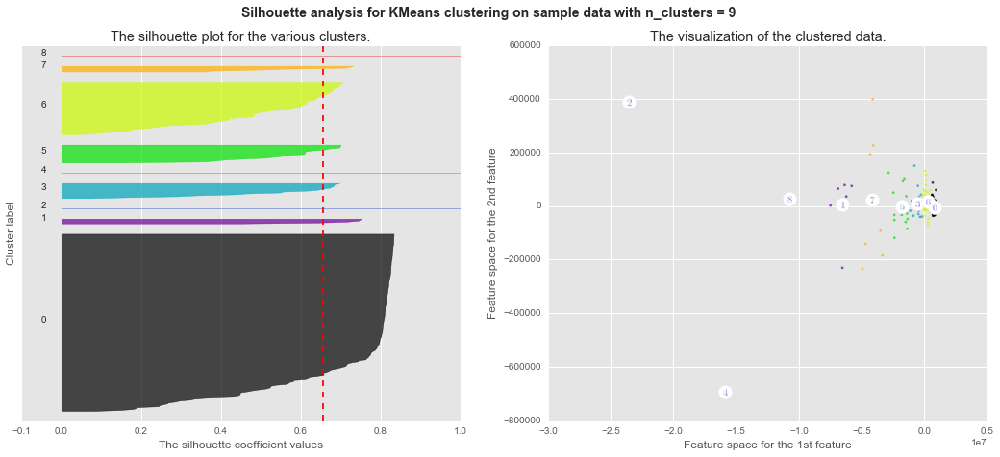

********************
Number of Components for PCA: 22
For n_clusters = 10 The average silhouette_score is : 0.617198778034


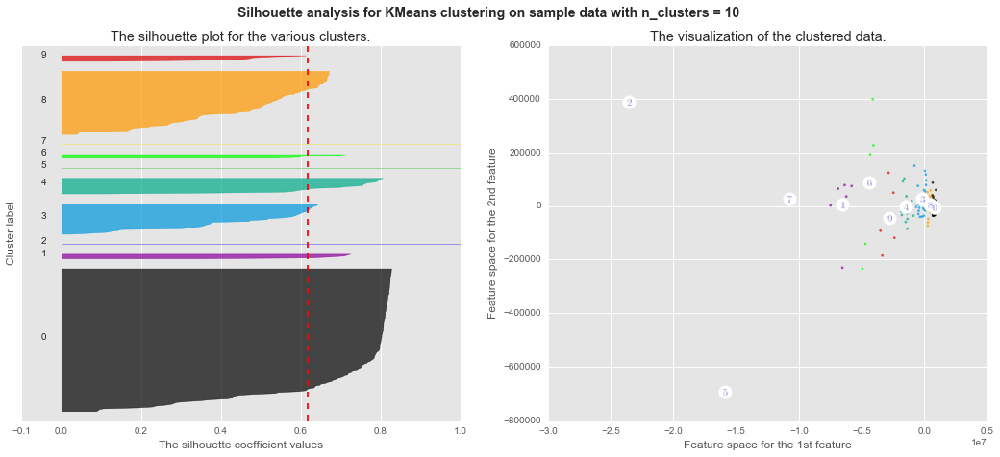

********************
Number of Components for PCA: 22
For n_clusters = 11 The average silhouette_score is : 0.615027101125


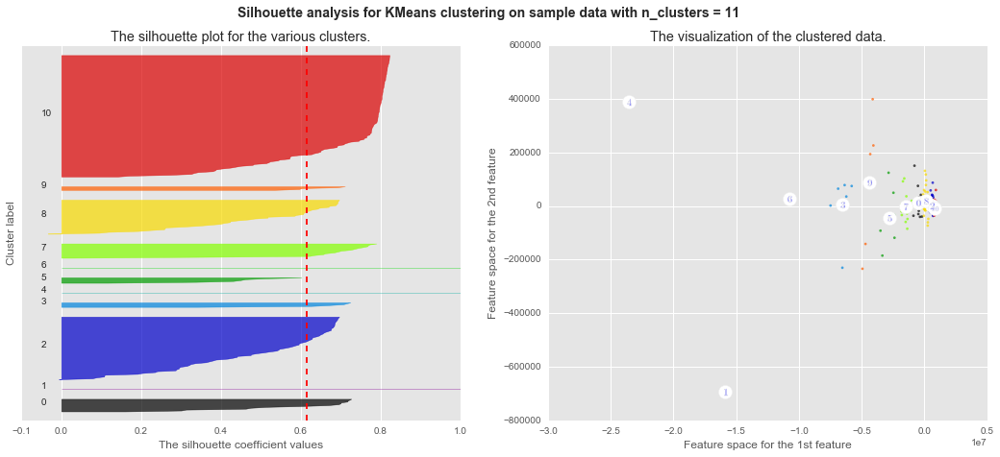

********************
Number of Components for PCA: 22
For n_clusters = 12 The average silhouette_score is : 0.615784619218


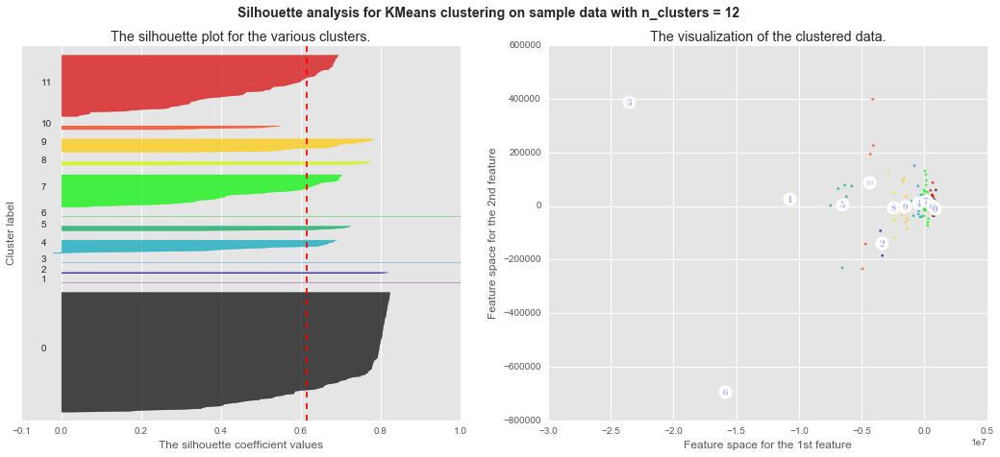

********************
Number of Components for PCA: 22
For n_clusters = 13 The average silhouette_score is : 0.611856305671


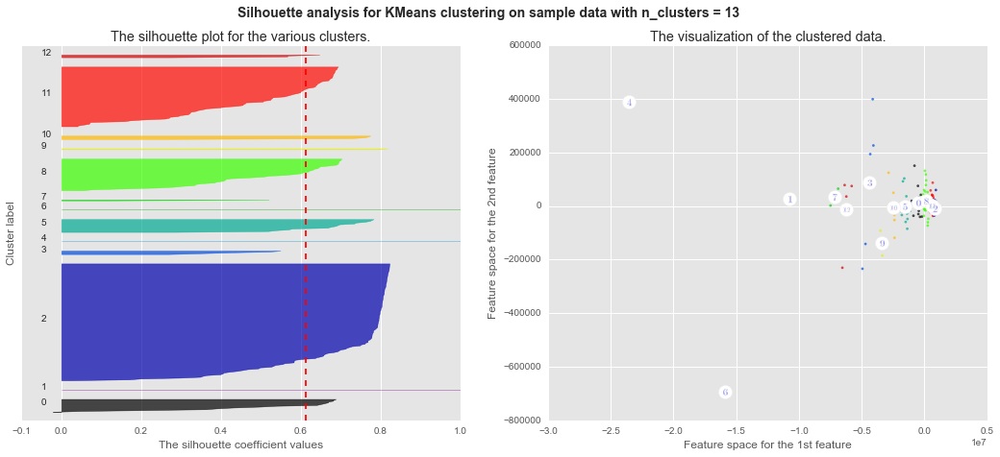

********************
Number of Components for PCA: 22
For n_clusters = 14 The average silhouette_score is : 0.592907237203


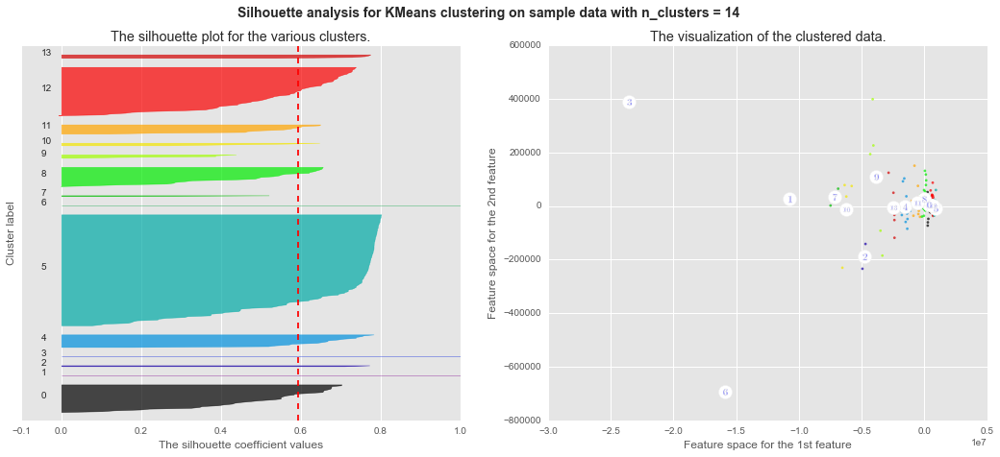

********************
Number of Components for PCA: 22
For n_clusters = 15 The average silhouette_score is : 0.592172687404


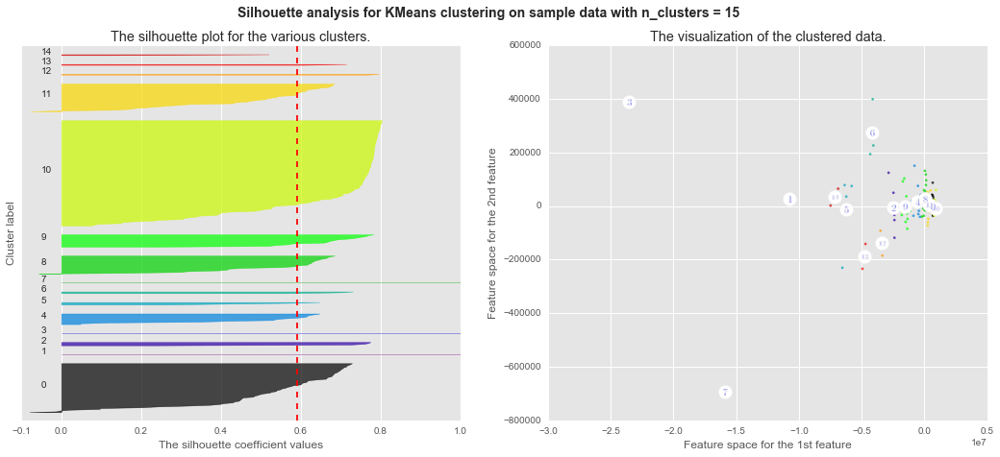

********************
Number of Components for PCA: 22
For n_clusters = 16 The average silhouette_score is : 0.600820589709


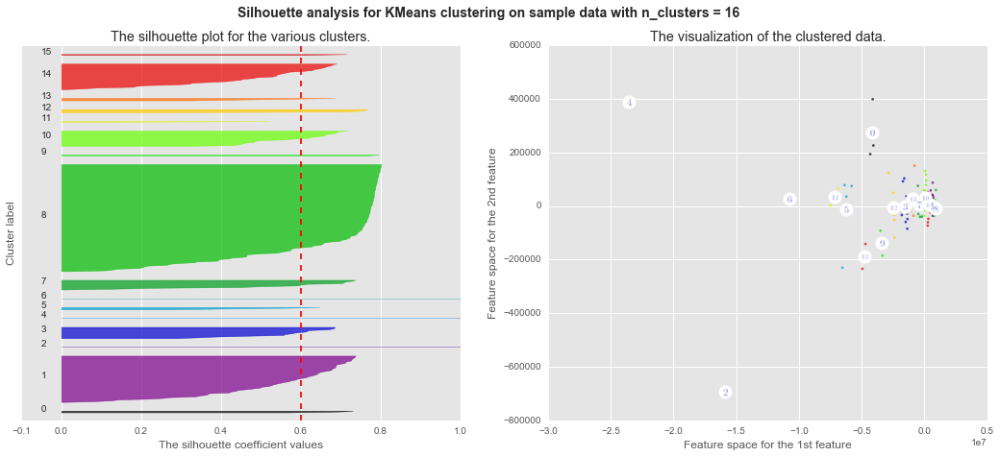

********************
Number of Components for PCA: 22
For n_clusters = 17 The average silhouette_score is : 0.596986524382


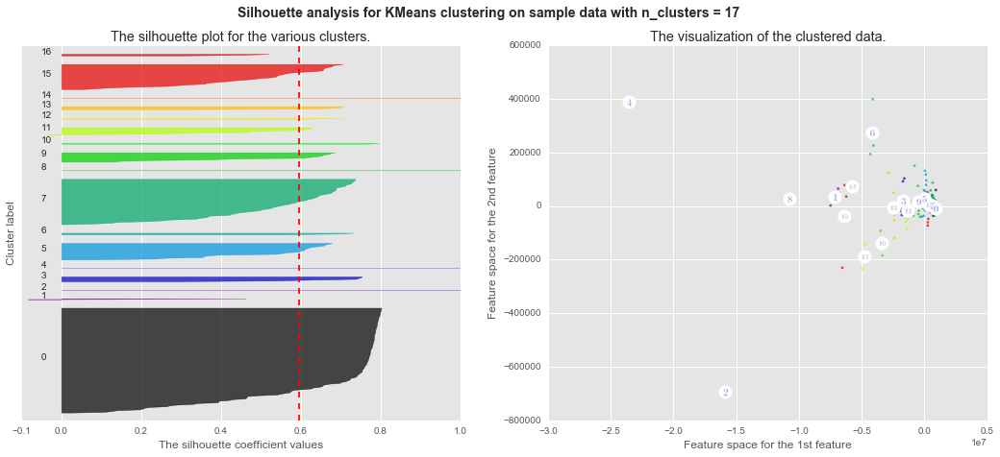

********************
Number of Components for PCA: 22
For n_clusters = 18 The average silhouette_score is : 0.548336984953


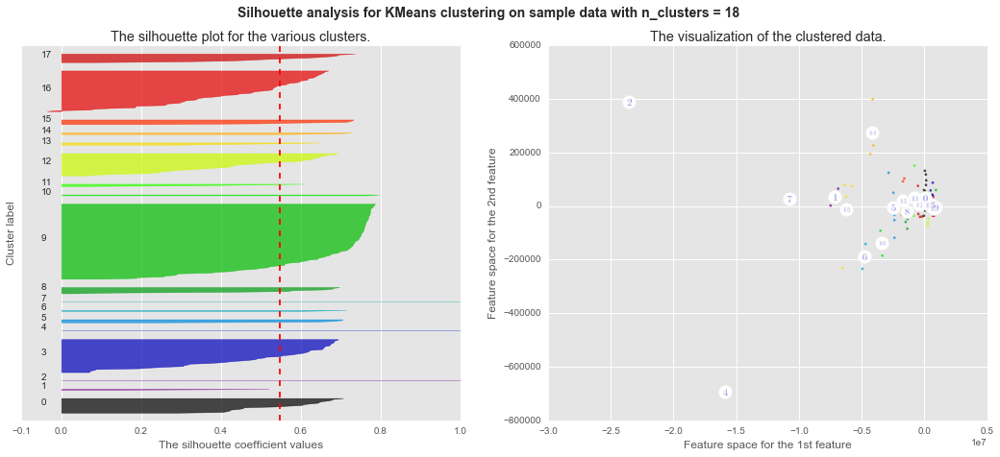

********************
Number of Components for PCA: 22
For n_clusters = 19 The average silhouette_score is : 0.552164893278


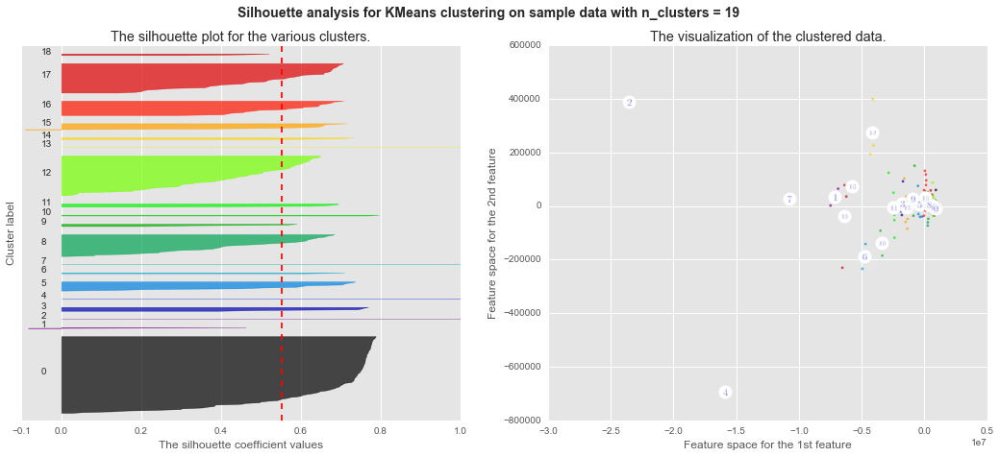

********************
Number of Components for PCA: 22
For n_clusters = 20 The average silhouette_score is : 0.542590566016


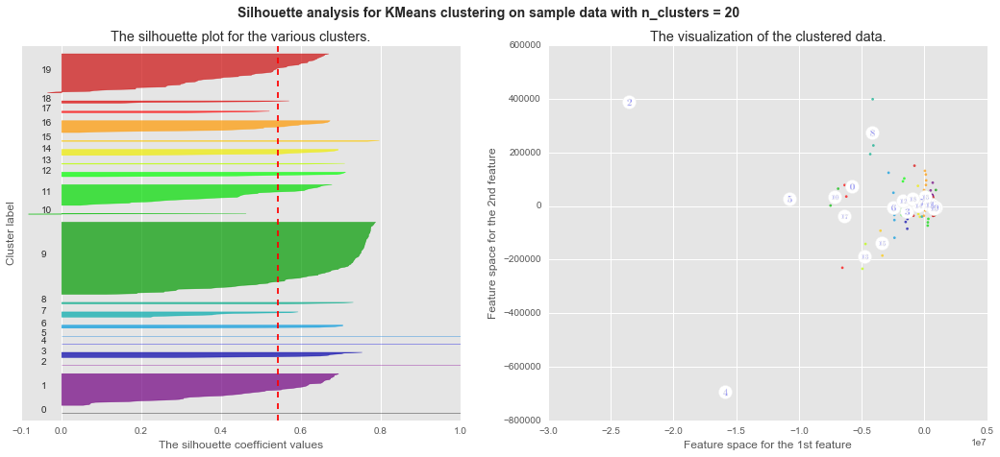

********************
Number of Components for PCA: 22
For n_clusters = 21 The average silhouette_score is : 0.535020373875


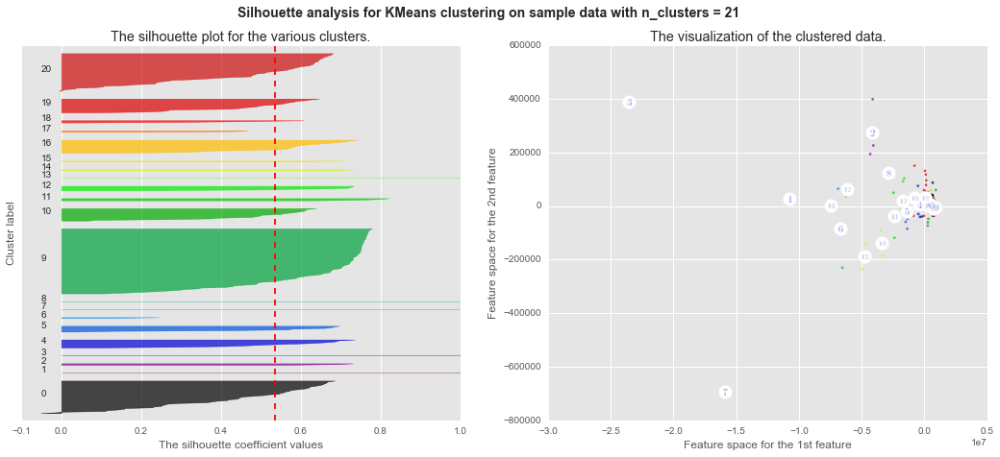

********************
Number of Components for PCA: 23
********************
********************
Number of Components for PCA: 23
For n_clusters = 4 The average silhouette_score is : 0.794910204703


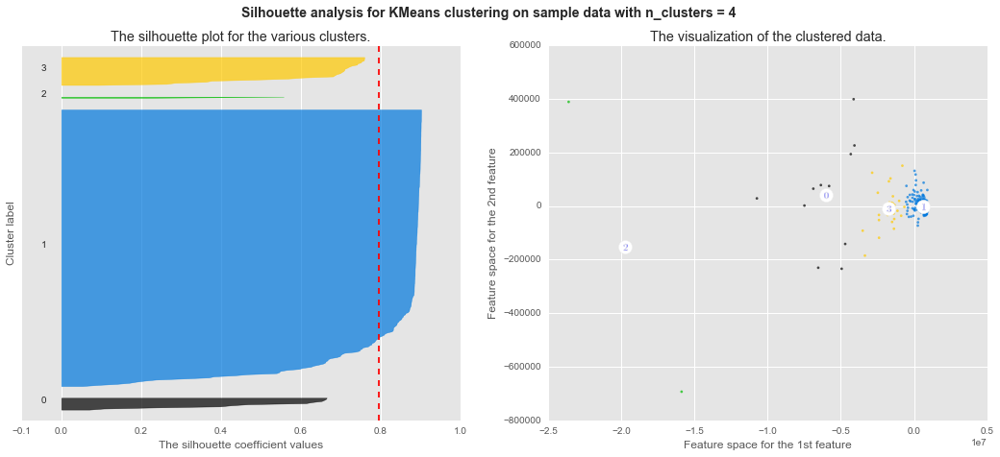

********************
Number of Components for PCA: 23
For n_clusters = 5 The average silhouette_score is : 0.798095898007


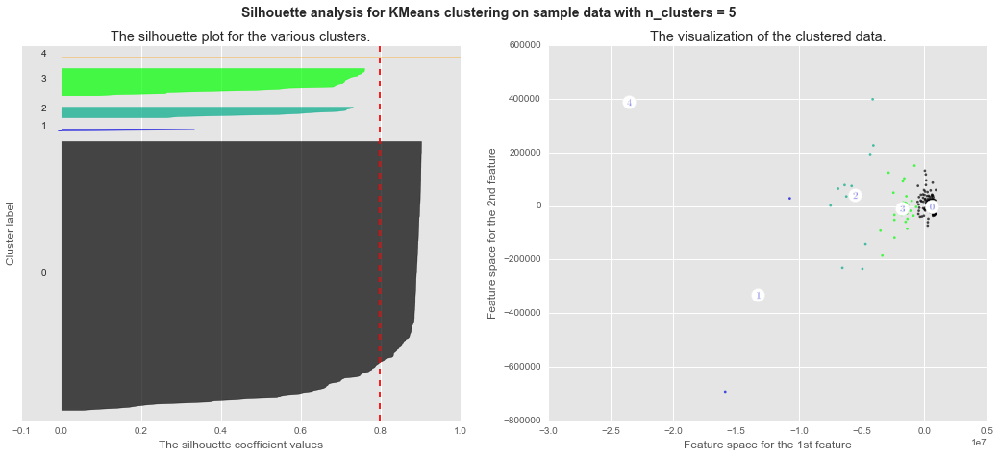

********************
Number of Components for PCA: 23
For n_clusters = 6 The average silhouette_score is : 0.683324546153


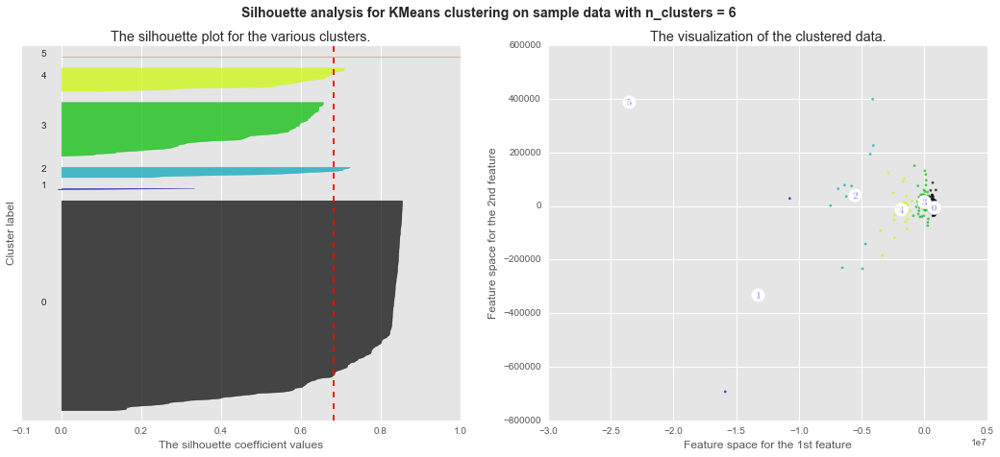

********************
Number of Components for PCA: 23
For n_clusters = 7 The average silhouette_score is : 0.686222449114


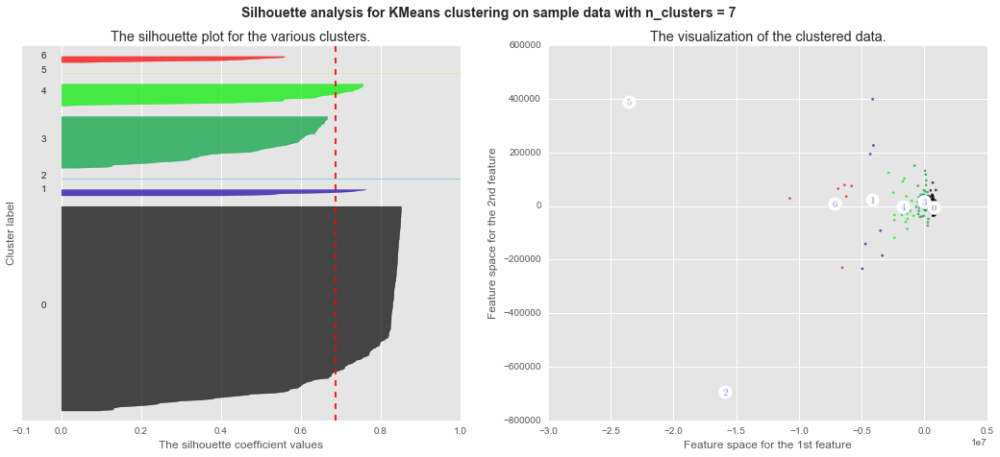

********************
Number of Components for PCA: 23
For n_clusters = 8 The average silhouette_score is : 0.692963481765


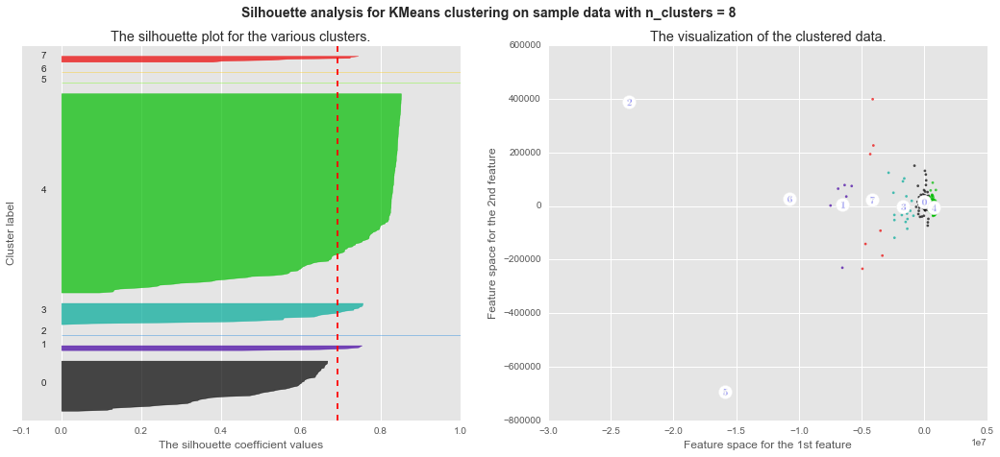

********************
Number of Components for PCA: 23
For n_clusters = 9 The average silhouette_score is : 0.655873920767


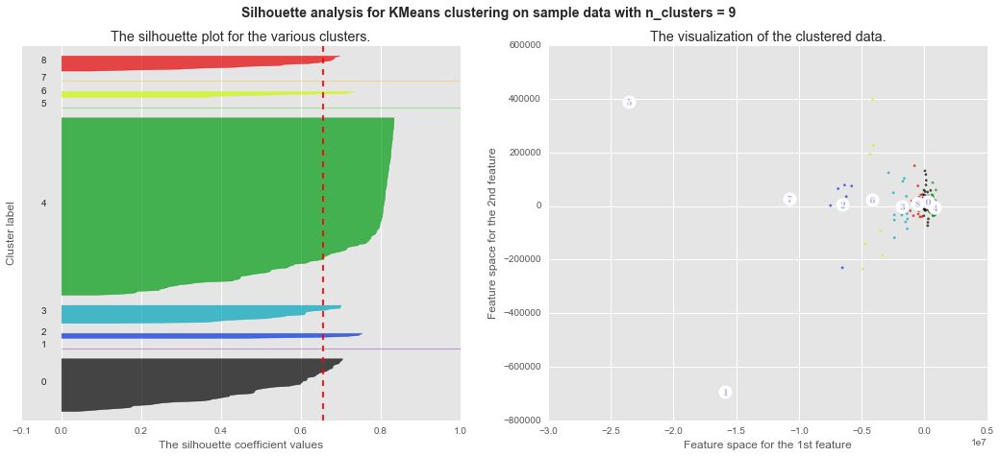

********************
Number of Components for PCA: 23
For n_clusters = 10 The average silhouette_score is : 0.617198777325


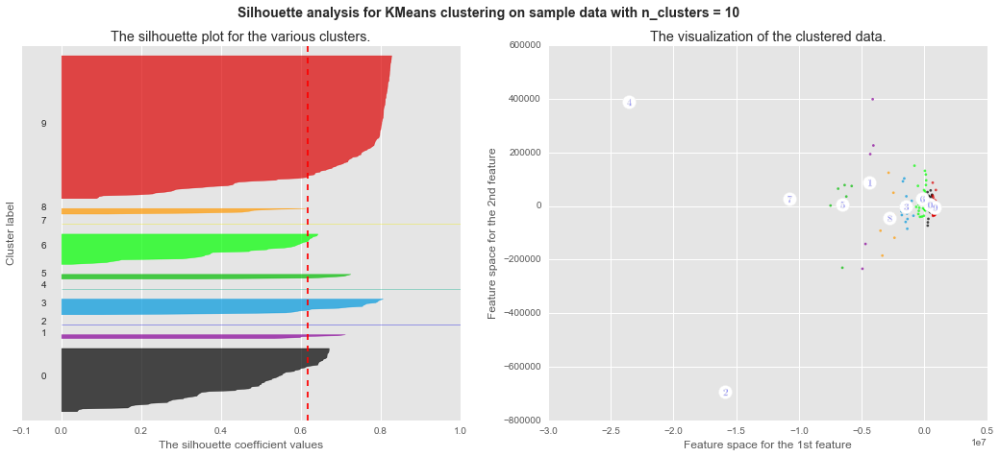

********************
Number of Components for PCA: 23
For n_clusters = 11 The average silhouette_score is : 0.614409567605


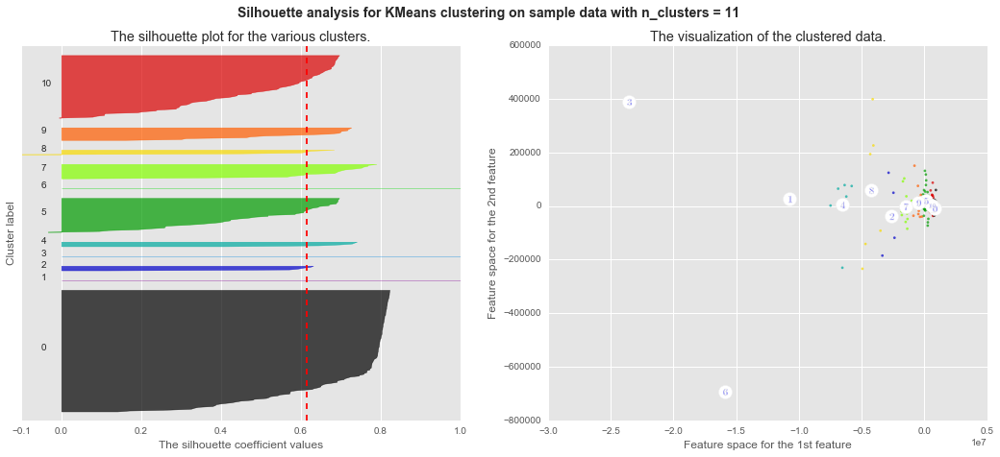

********************
Number of Components for PCA: 23
For n_clusters = 12 The average silhouette_score is : 0.611810958629


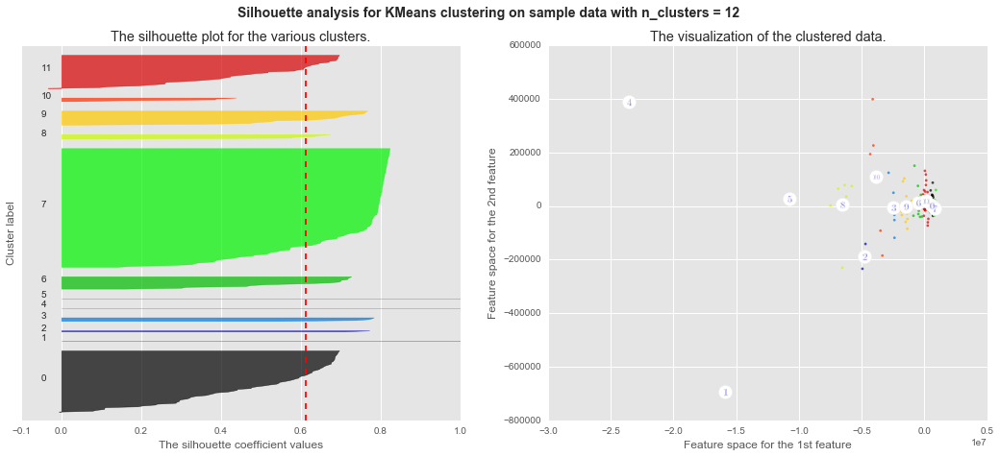

********************
Number of Components for PCA: 23
For n_clusters = 13 The average silhouette_score is : 0.609636740808


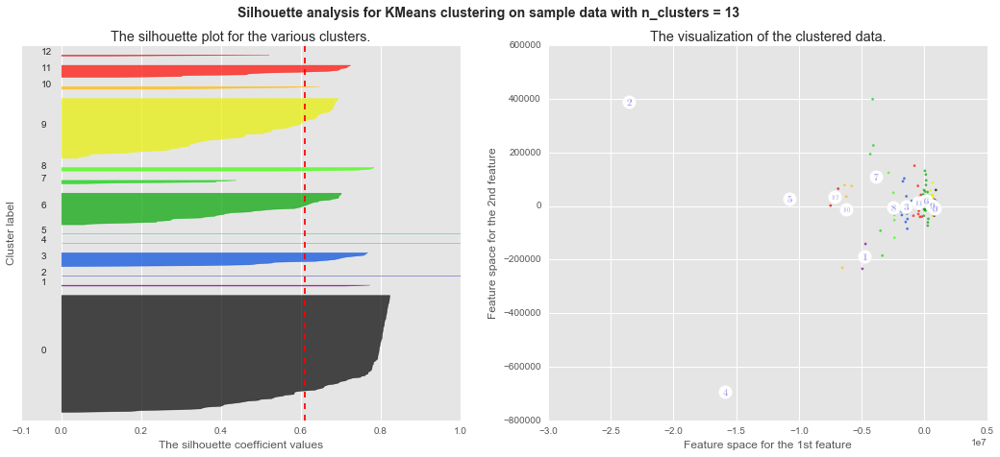

********************
Number of Components for PCA: 23
For n_clusters = 14 The average silhouette_score is : 0.59681045254


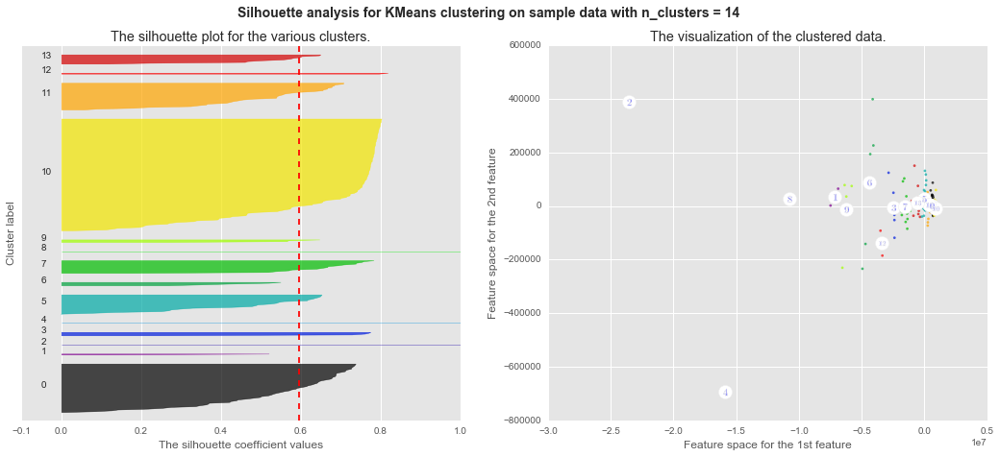

********************
Number of Components for PCA: 23
For n_clusters = 15 The average silhouette_score is : 0.590823610342


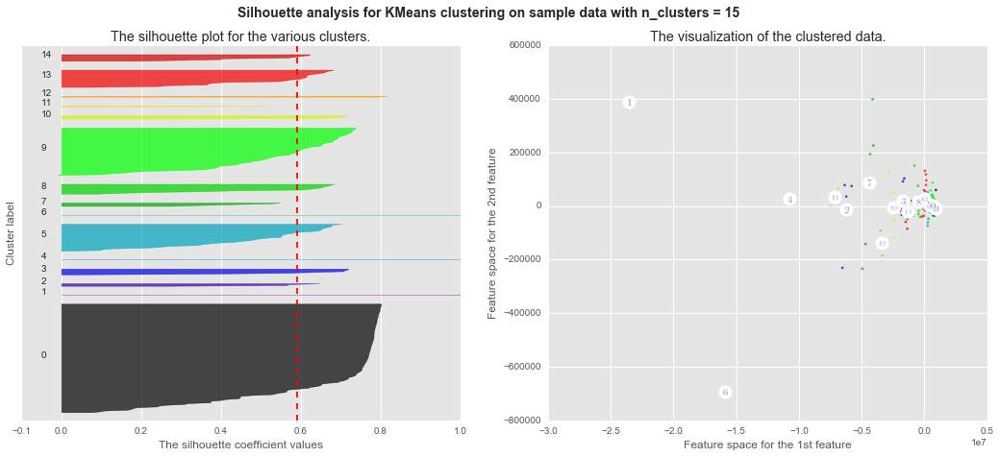

********************
Number of Components for PCA: 23
For n_clusters = 16 The average silhouette_score is : 0.585565701856


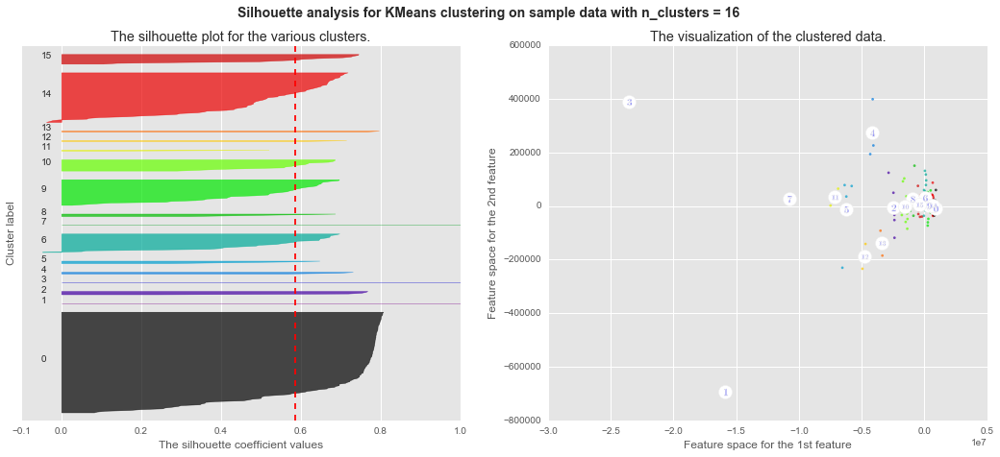

********************
Number of Components for PCA: 23
For n_clusters = 17 The average silhouette_score is : 0.546793073738


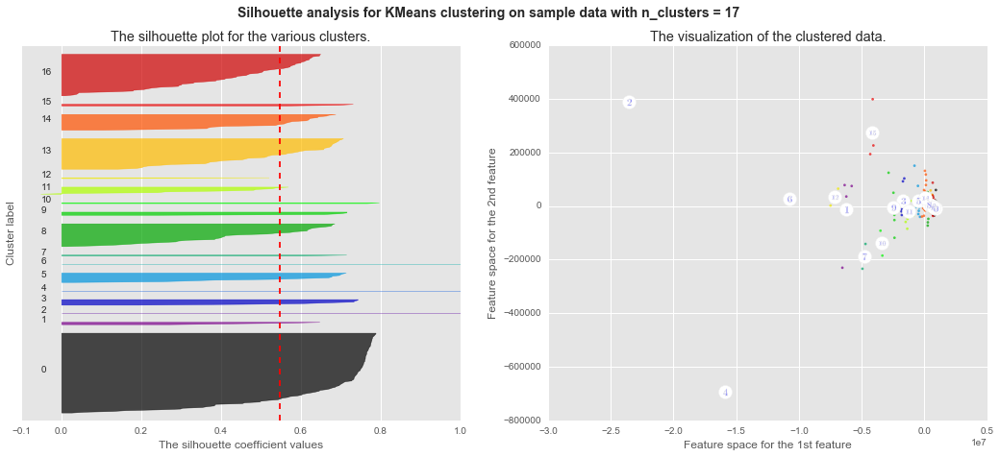

********************
Number of Components for PCA: 23
For n_clusters = 18 The average silhouette_score is : 0.598562232498


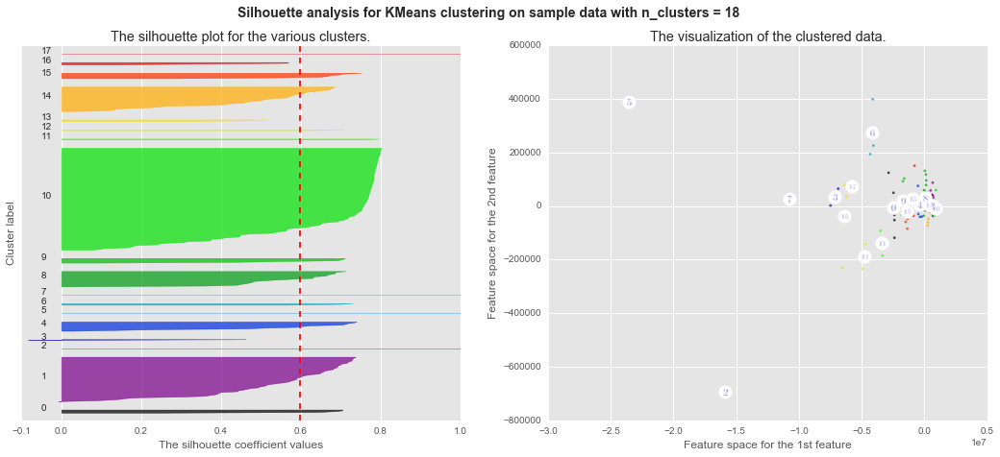

********************
Number of Components for PCA: 23
For n_clusters = 19 The average silhouette_score is : 0.553476543498


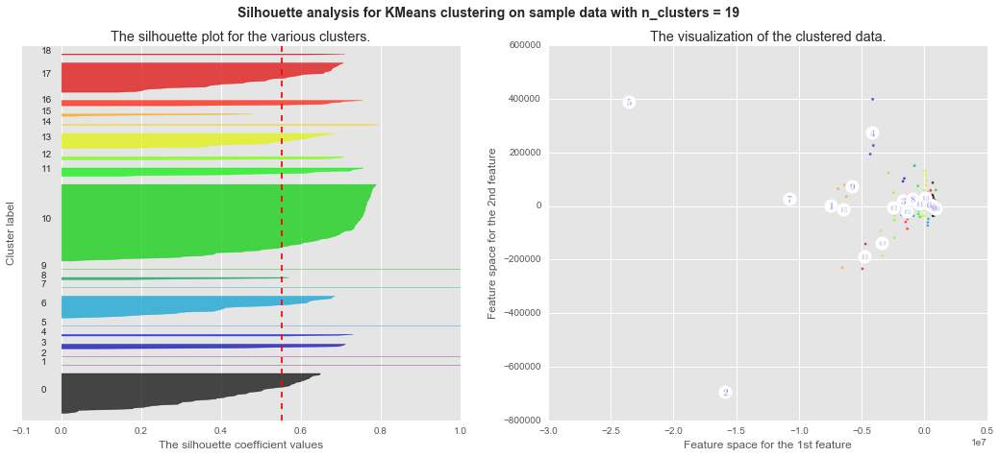

********************
Number of Components for PCA: 23
For n_clusters = 20 The average silhouette_score is : 0.551283787508


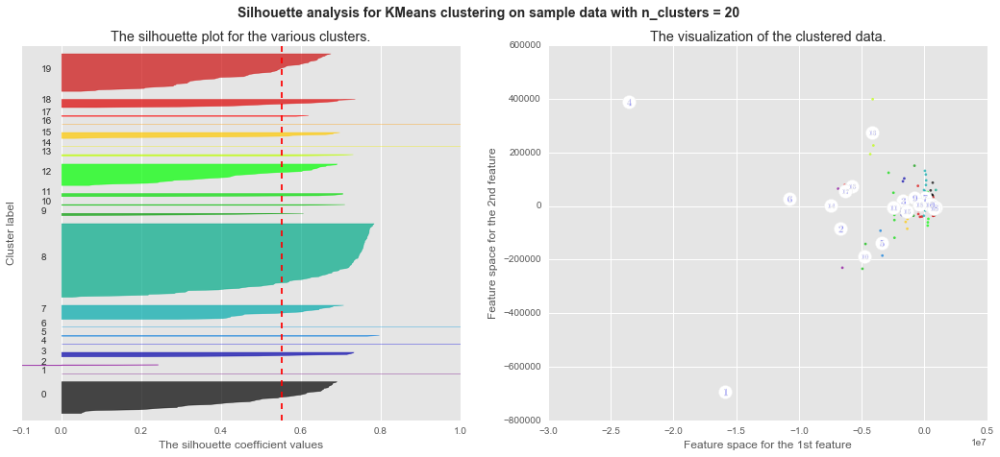

********************
Number of Components for PCA: 23
For n_clusters = 21 The average silhouette_score is : 0.544998774864


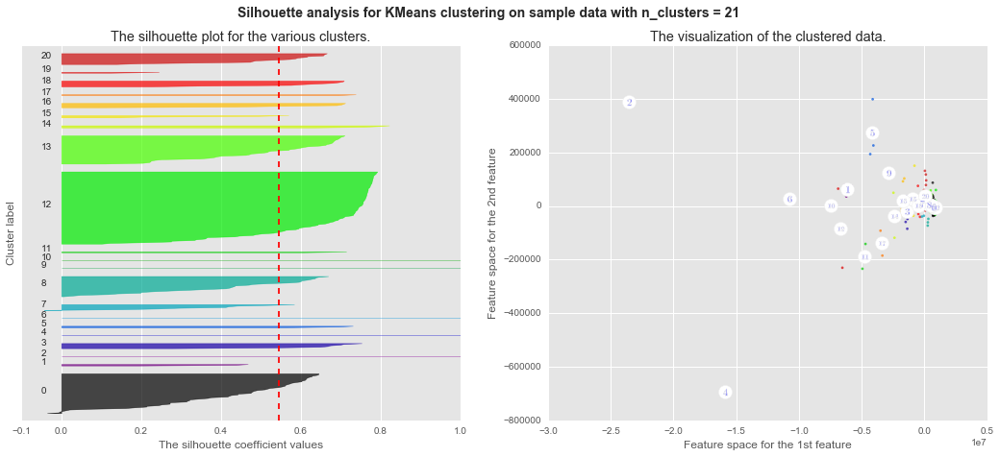

********************
Number of Components for PCA: 24
********************
********************
Number of Components for PCA: 24
For n_clusters = 4 The average silhouette_score is : 0.794910204675


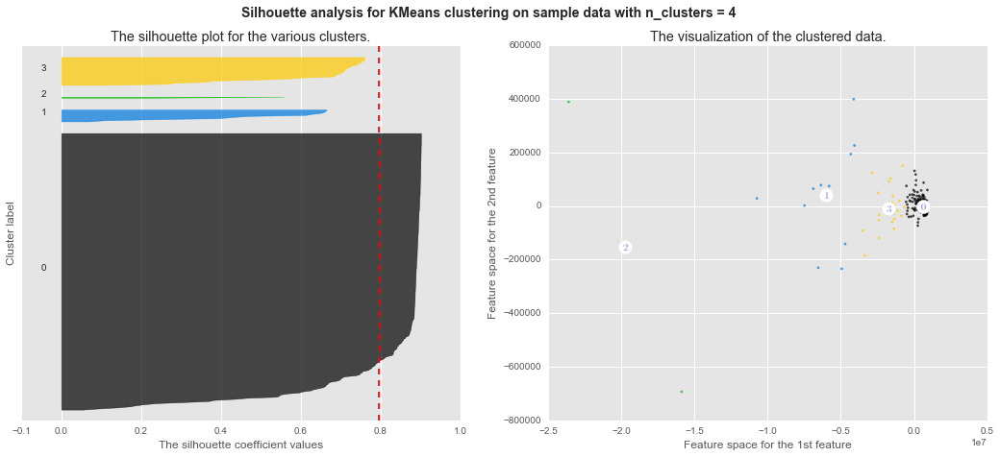

********************
Number of Components for PCA: 24
For n_clusters = 5 The average silhouette_score is : 0.777197481283


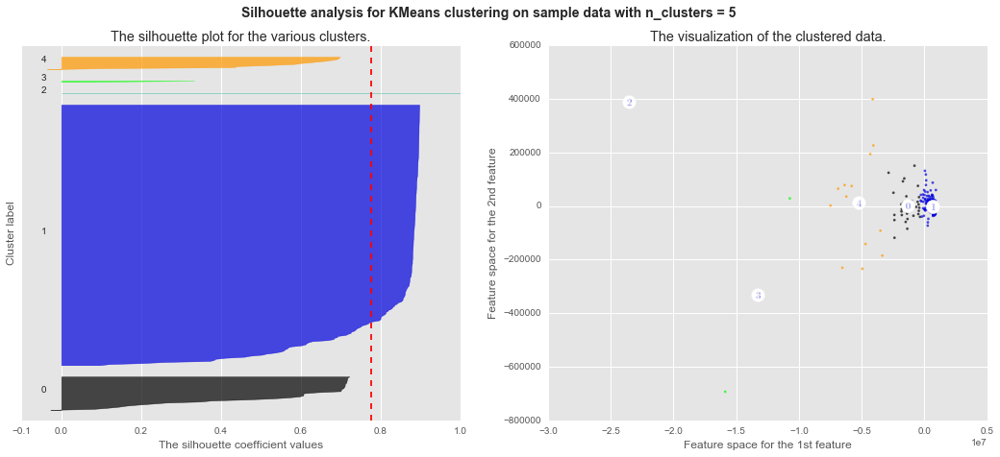

********************
Number of Components for PCA: 24
For n_clusters = 6 The average silhouette_score is : 0.683324546045


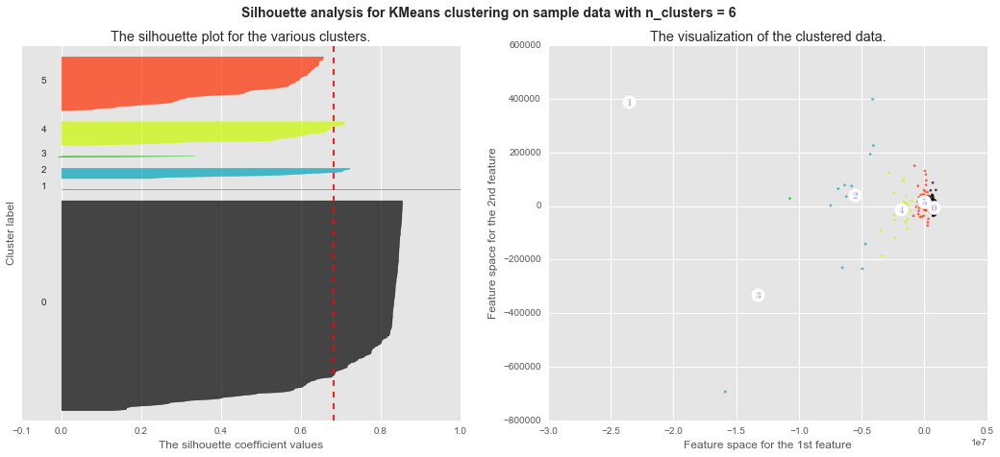

********************
Number of Components for PCA: 24
For n_clusters = 7 The average silhouette_score is : 0.688361932449


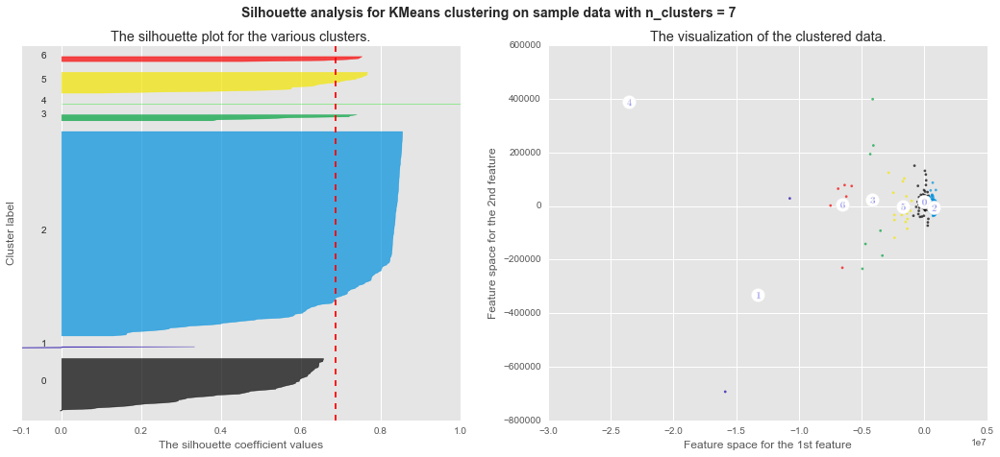

********************
Number of Components for PCA: 24
For n_clusters = 8 The average silhouette_score is : 0.692963481654


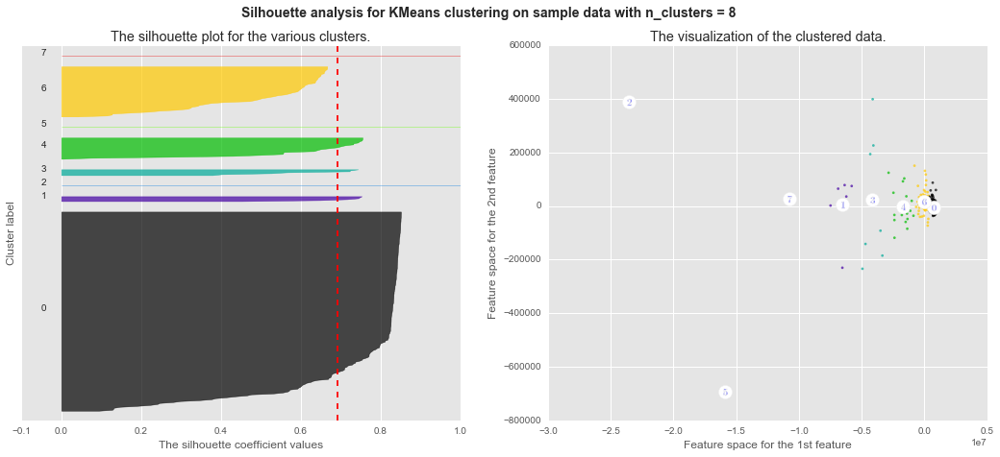

********************
Number of Components for PCA: 24
For n_clusters = 9 The average silhouette_score is : 0.628577170215


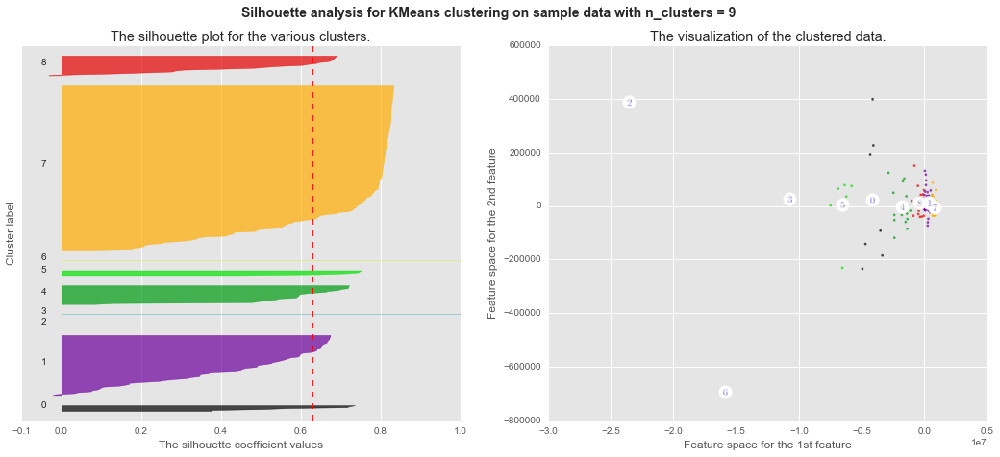

********************
Number of Components for PCA: 24
For n_clusters = 10 The average silhouette_score is : 0.616145664145


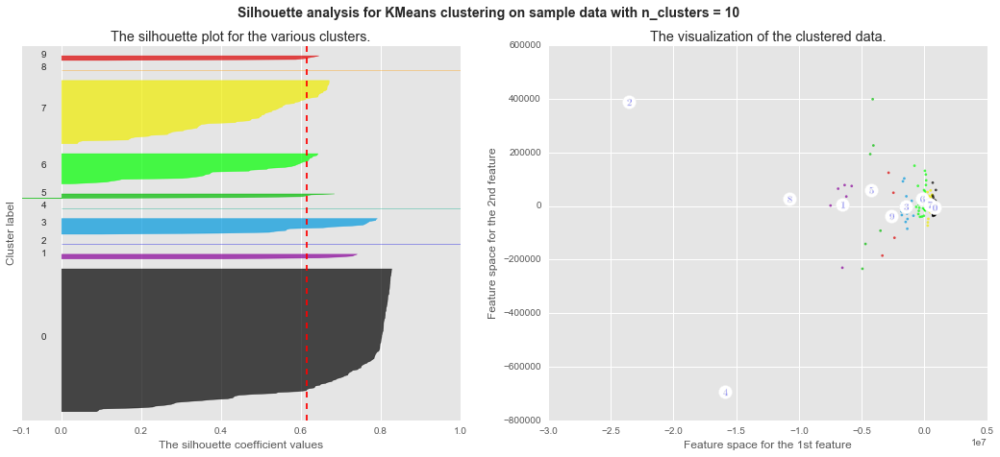

********************
Number of Components for PCA: 24
For n_clusters = 11 The average silhouette_score is : 0.615027099561


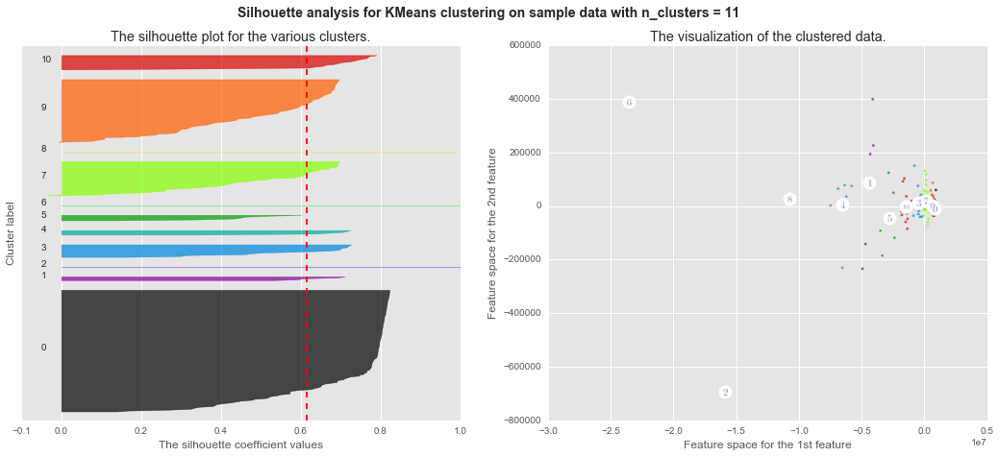

********************
Number of Components for PCA: 24
For n_clusters = 12 The average silhouette_score is : 0.615833397403


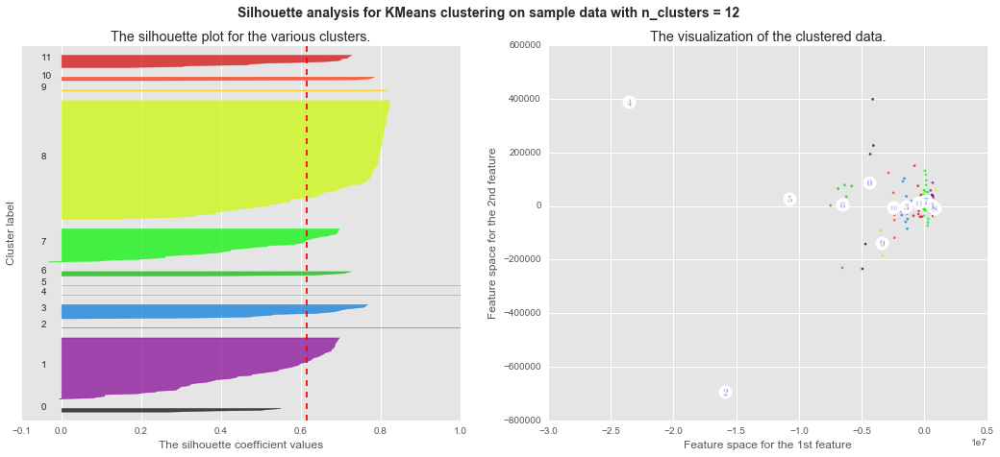

********************
Number of Components for PCA: 24
For n_clusters = 13 The average silhouette_score is : 0.612005670542


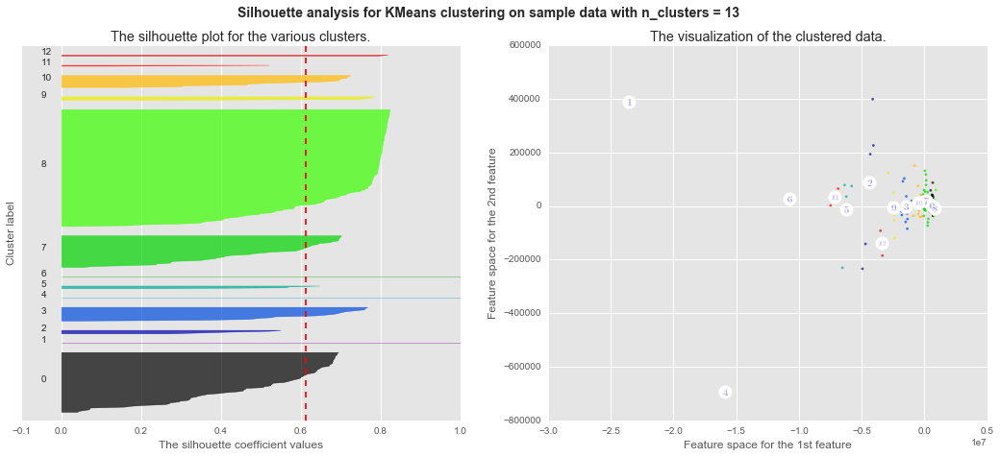

********************
Number of Components for PCA: 24
For n_clusters = 14 The average silhouette_score is : 0.594441521689


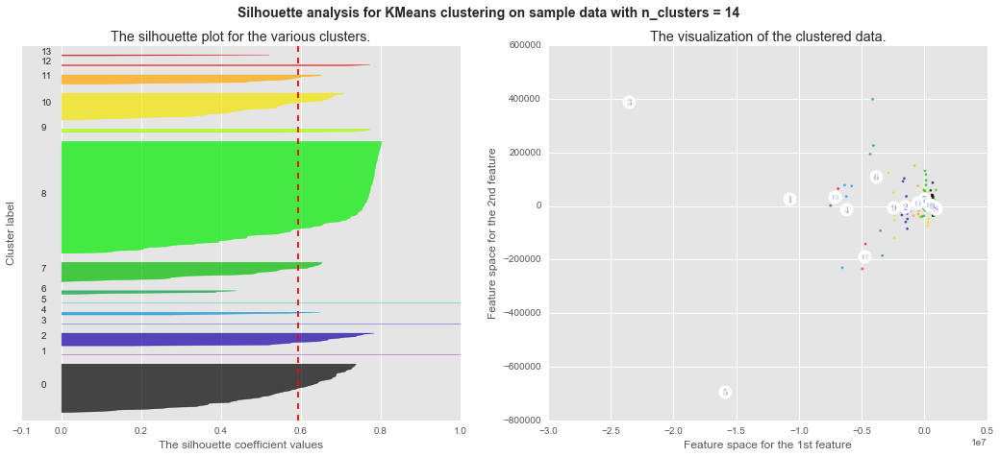

********************
Number of Components for PCA: 24
For n_clusters = 15 The average silhouette_score is : 0.602113130778


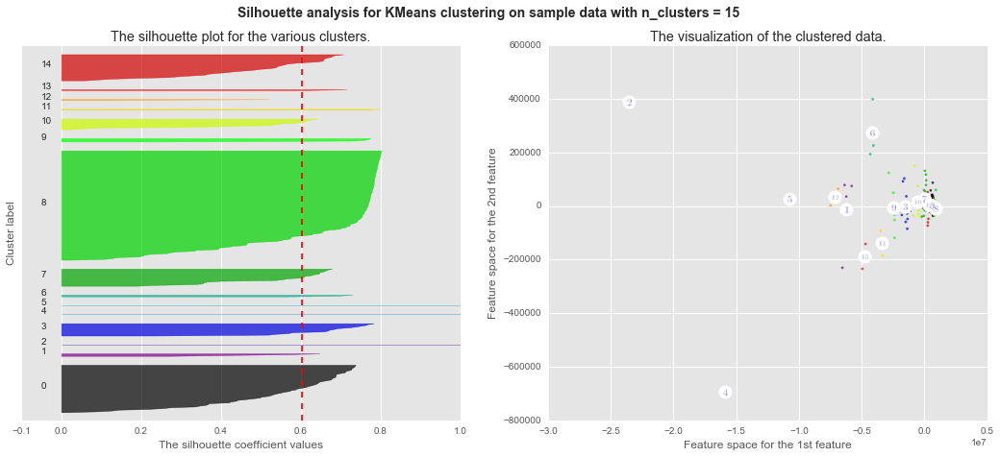

********************
Number of Components for PCA: 24
For n_clusters = 16 The average silhouette_score is : 0.594402369046


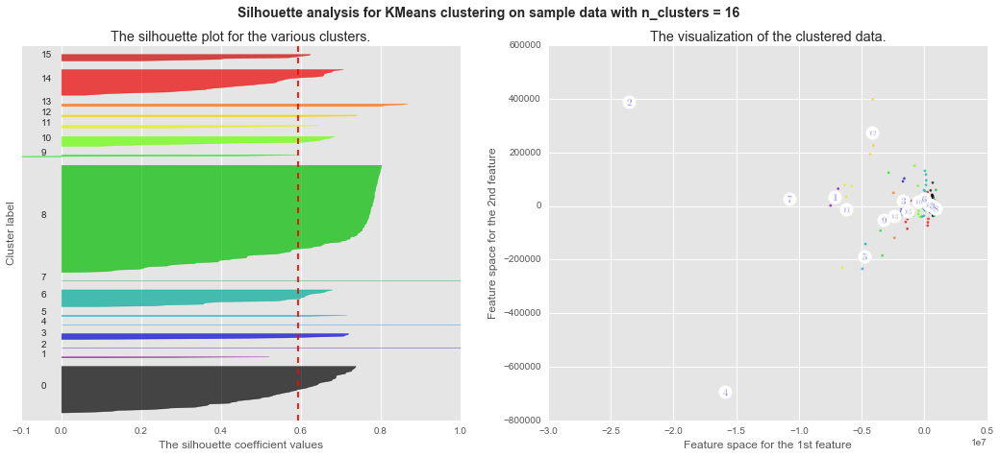

********************
Number of Components for PCA: 24
For n_clusters = 17 The average silhouette_score is : 0.54690742125


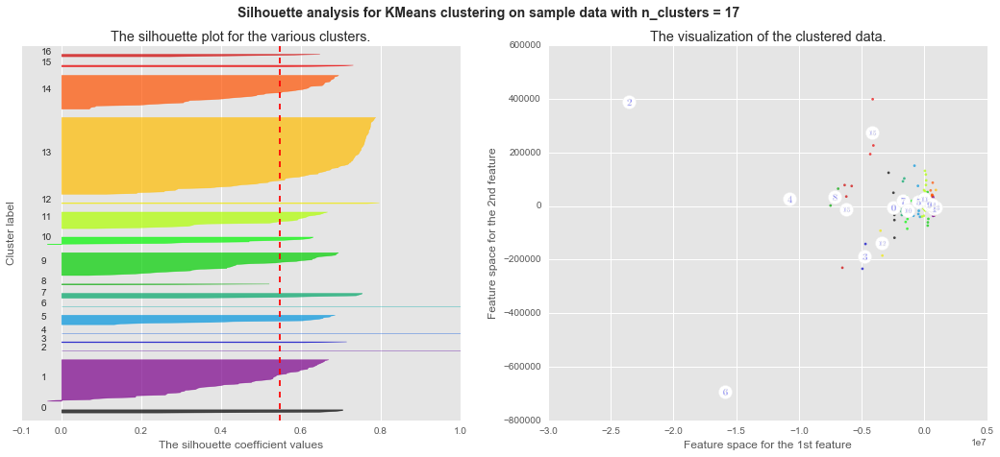

********************
Number of Components for PCA: 24
For n_clusters = 18 The average silhouette_score is : 0.551053098877


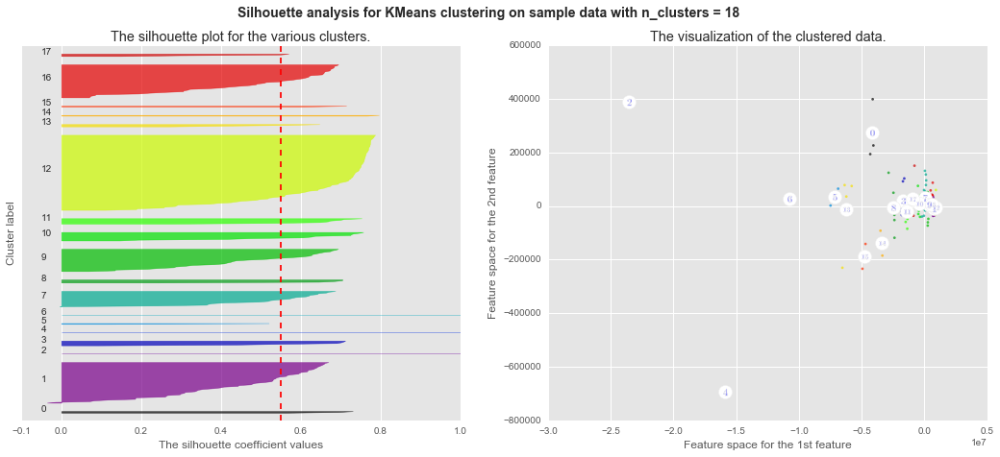

********************
Number of Components for PCA: 24
For n_clusters = 19 The average silhouette_score is : 0.542876368642


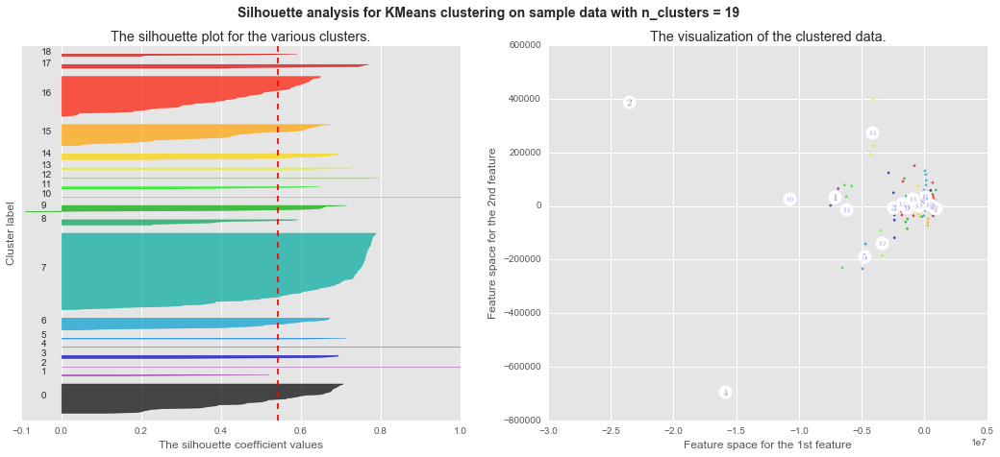

********************
Number of Components for PCA: 24
For n_clusters = 20 The average silhouette_score is : 0.557055845088


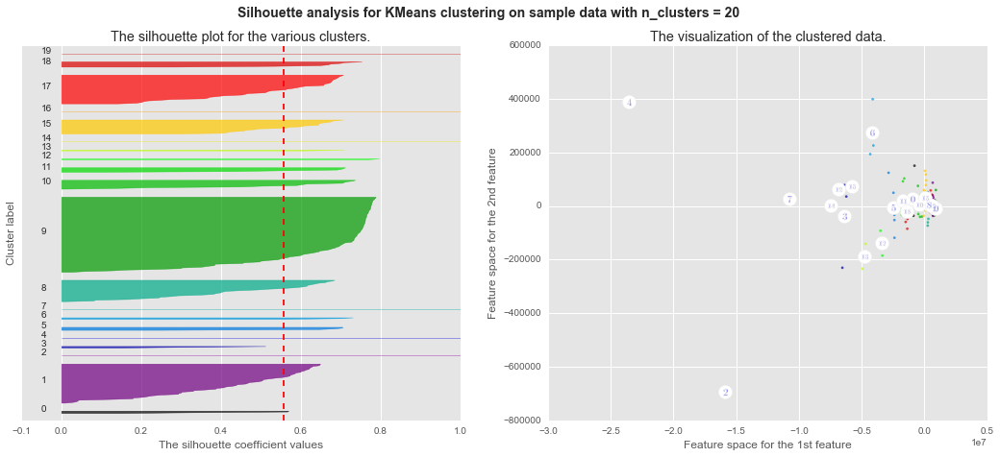

********************
Number of Components for PCA: 24
For n_clusters = 21 The average silhouette_score is : 0.5428625372


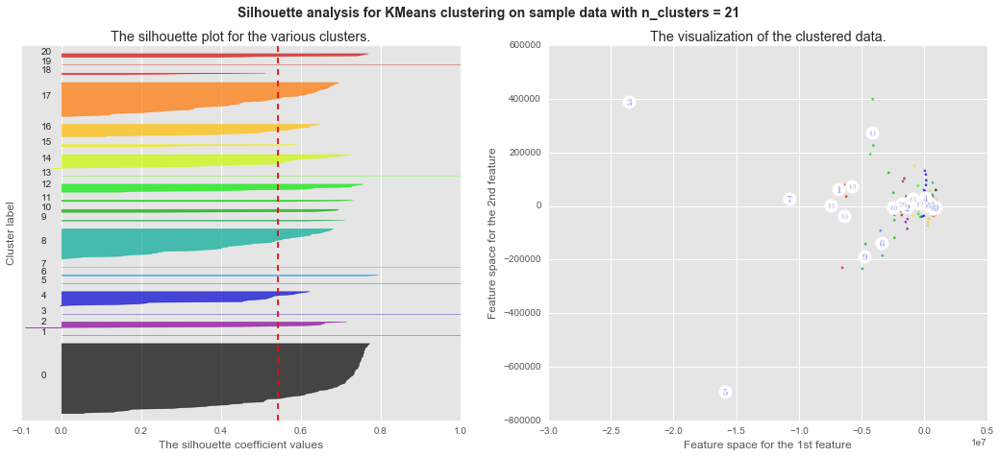

********************
Number of Components for PCA: 25
********************
********************
Number of Components for PCA: 25
For n_clusters = 4 The average silhouette_score is : 0.794910204645


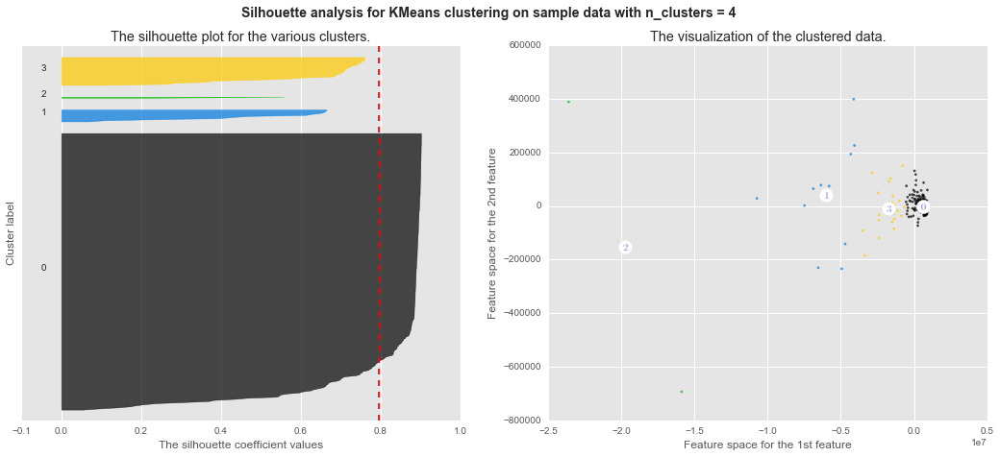

********************
Number of Components for PCA: 25
For n_clusters = 5 The average silhouette_score is : 0.777197481246


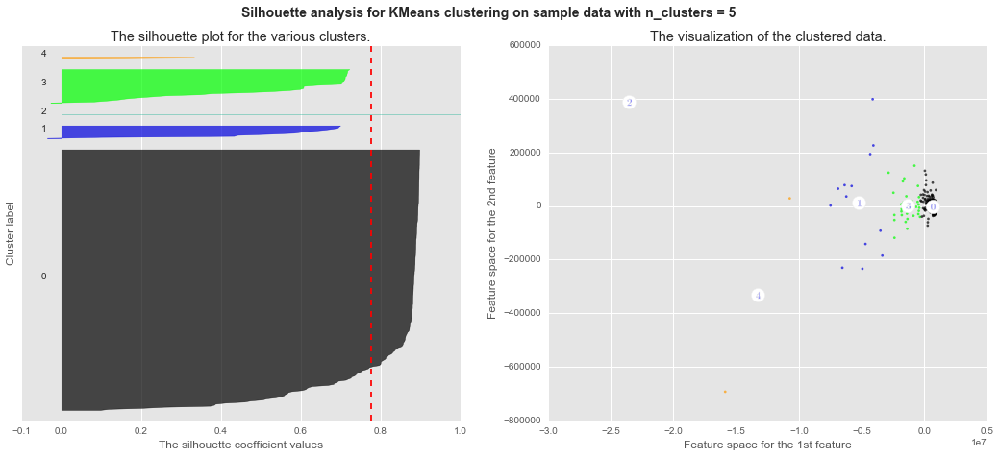

********************
Number of Components for PCA: 25
For n_clusters = 6 The average silhouette_score is : 0.77375822944


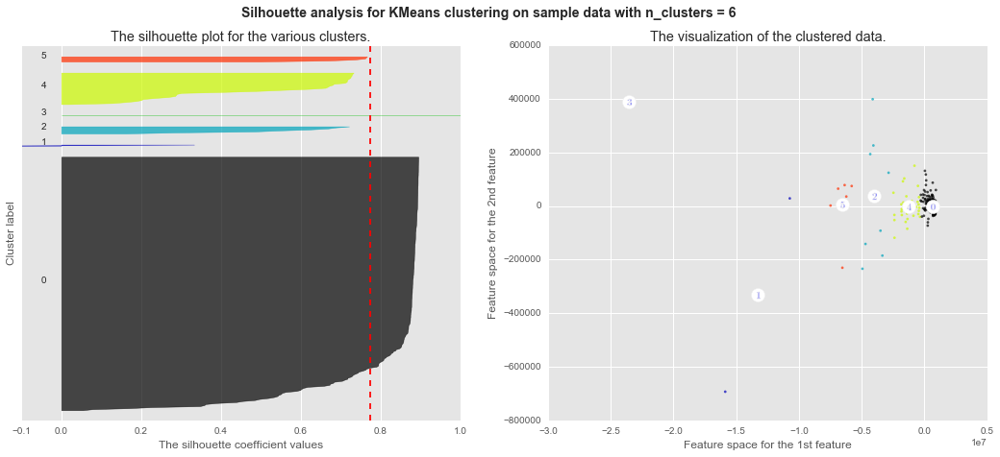

********************
Number of Components for PCA: 25
For n_clusters = 7 The average silhouette_score is : 0.686222448888


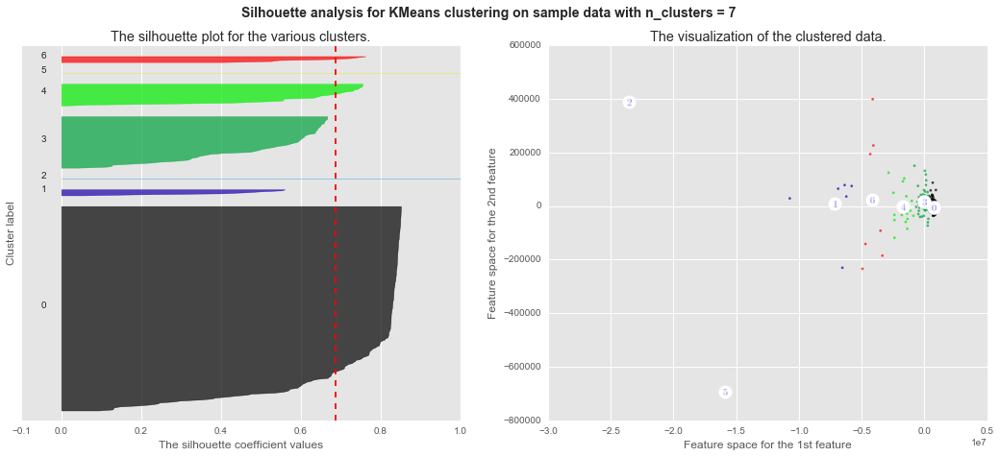

********************
Number of Components for PCA: 25
For n_clusters = 8 The average silhouette_score is : 0.692963481539


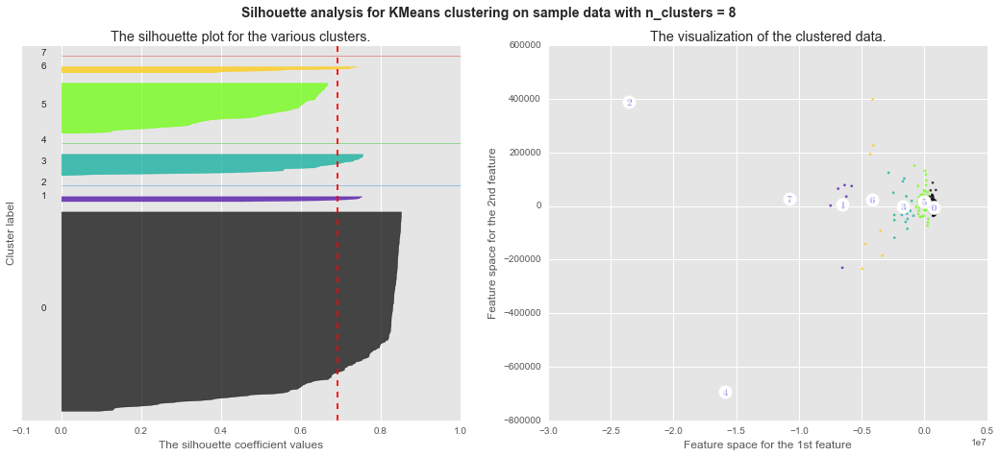

********************
Number of Components for PCA: 25
For n_clusters = 9 The average silhouette_score is : 0.655873920426


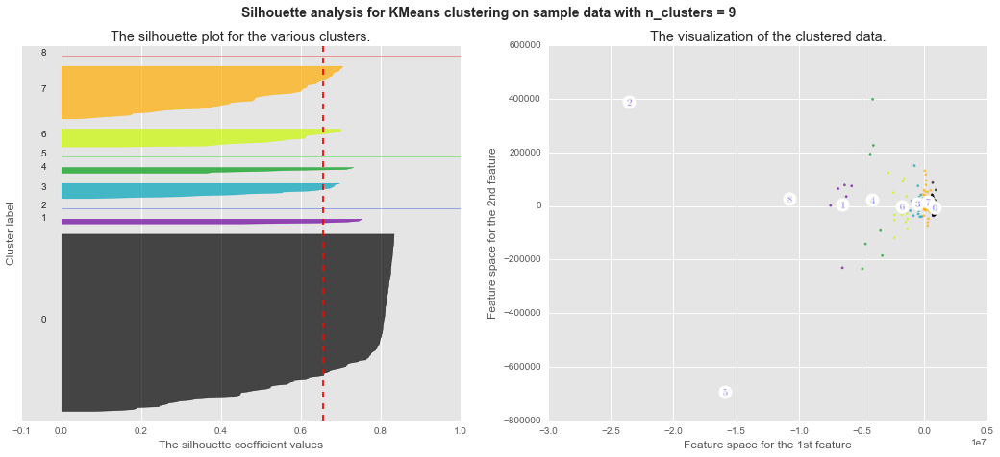

********************
Number of Components for PCA: 25
For n_clusters = 10 The average silhouette_score is : 0.61719877664


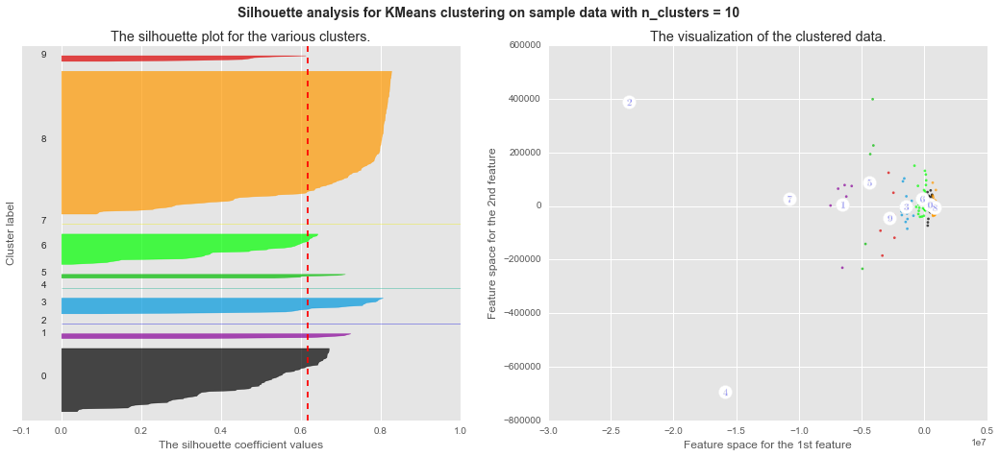

********************
Number of Components for PCA: 25
For n_clusters = 11 The average silhouette_score is : 0.614409566646


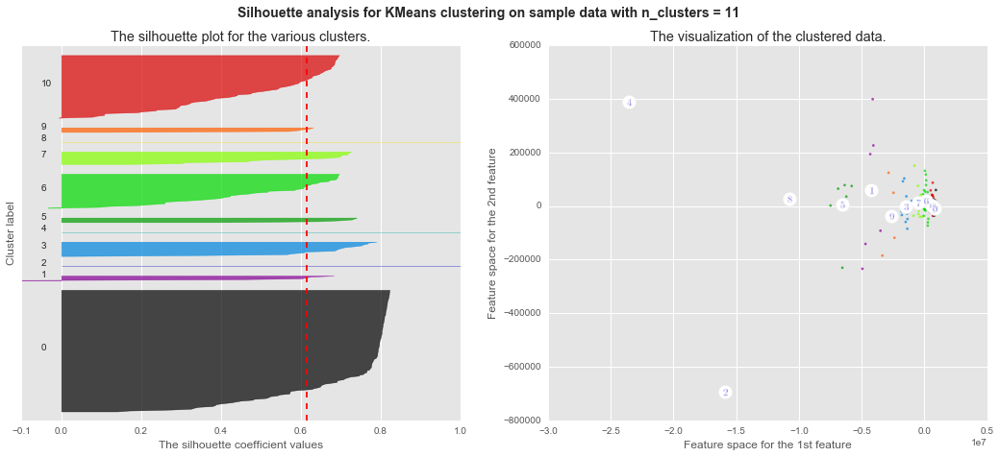

********************
Number of Components for PCA: 25
For n_clusters = 12 The average silhouette_score is : 0.61077059439


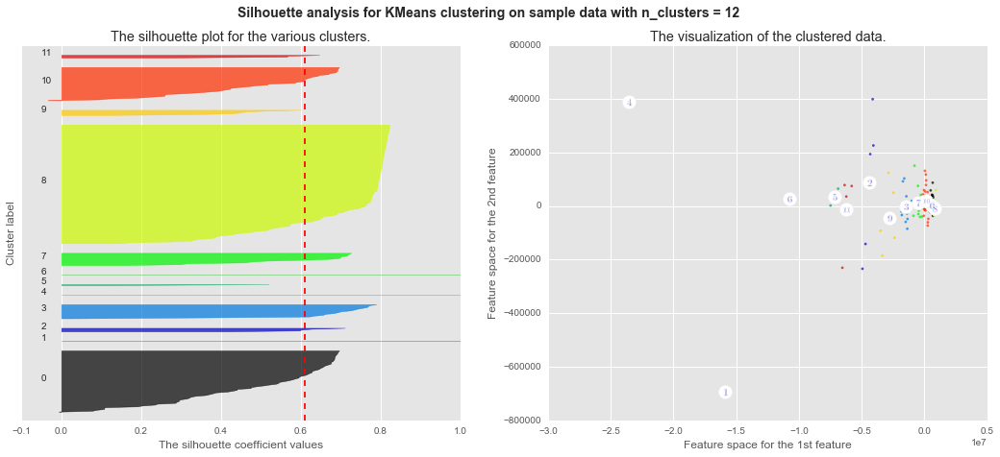

********************
Number of Components for PCA: 25
For n_clusters = 13 The average silhouette_score is : 0.60981260277


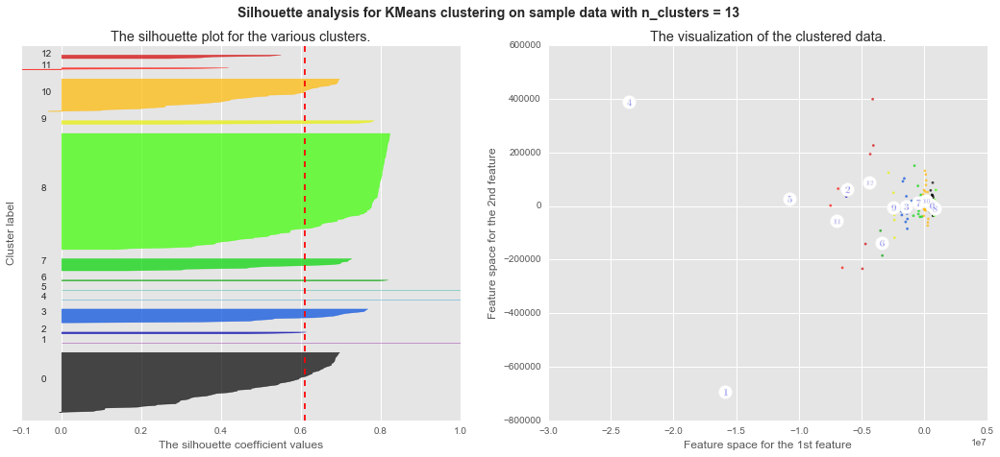

********************
Number of Components for PCA: 25
For n_clusters = 14 The average silhouette_score is : 0.594751950004


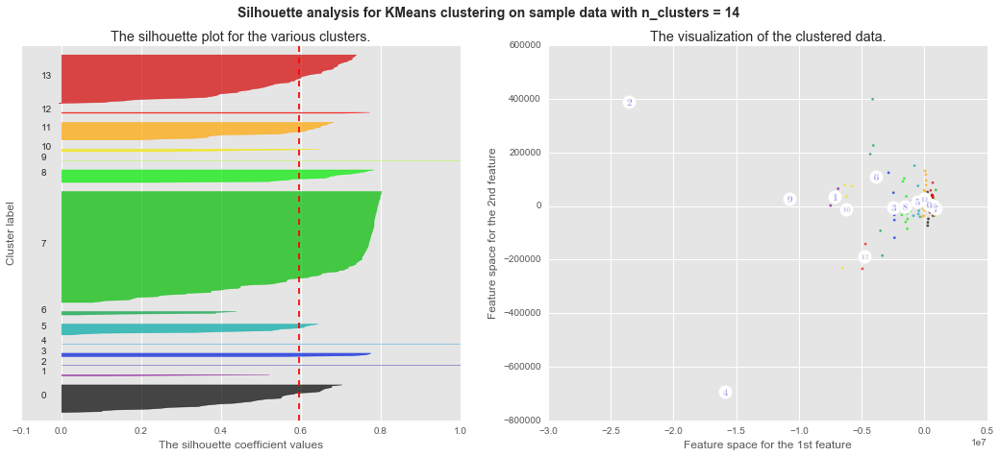

********************
Number of Components for PCA: 25
For n_clusters = 15 The average silhouette_score is : 0.601182243202


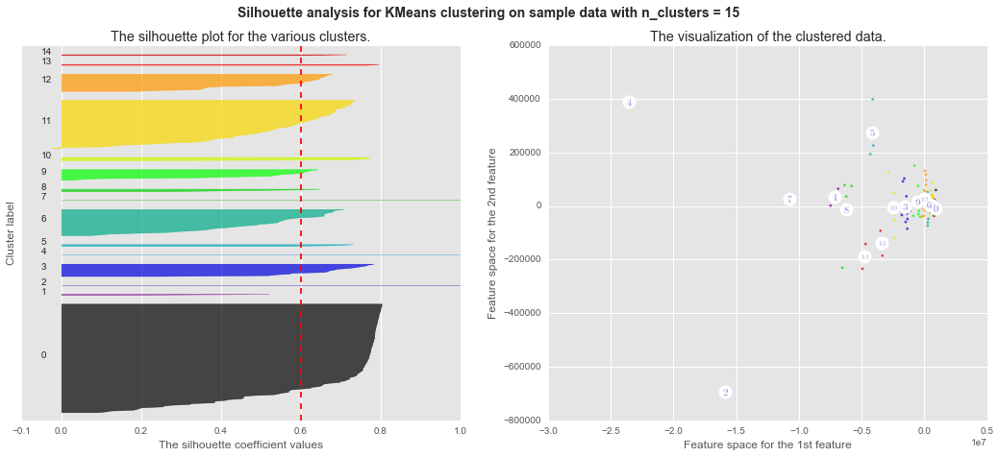

********************
Number of Components for PCA: 25
For n_clusters = 16 The average silhouette_score is : 0.594849952412


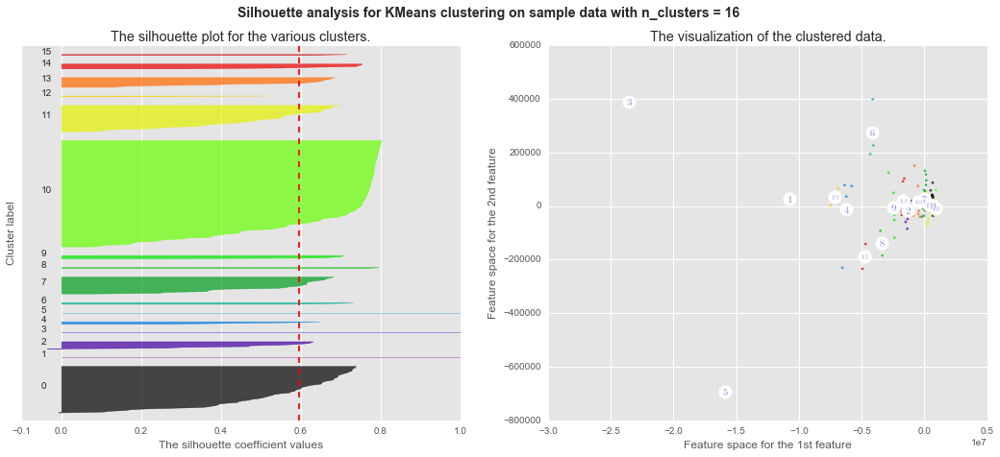

********************
Number of Components for PCA: 25
For n_clusters = 17 The average silhouette_score is : 0.547061665335


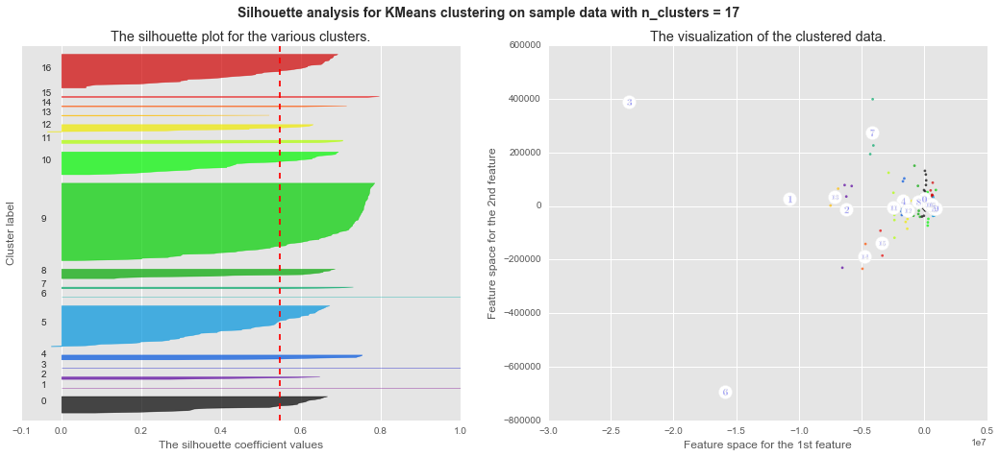

********************
Number of Components for PCA: 25
For n_clusters = 18 The average silhouette_score is : 0.569053300751


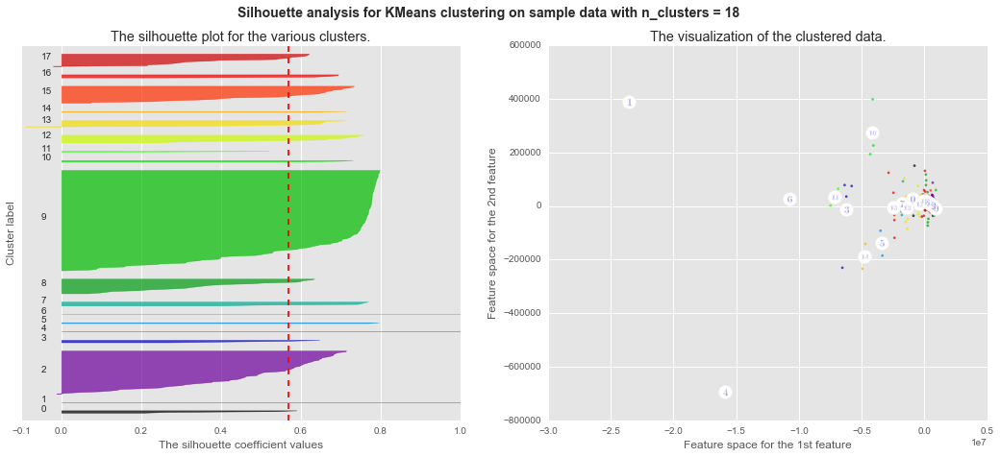

********************
Number of Components for PCA: 25
For n_clusters = 19 The average silhouette_score is : 0.551565960302


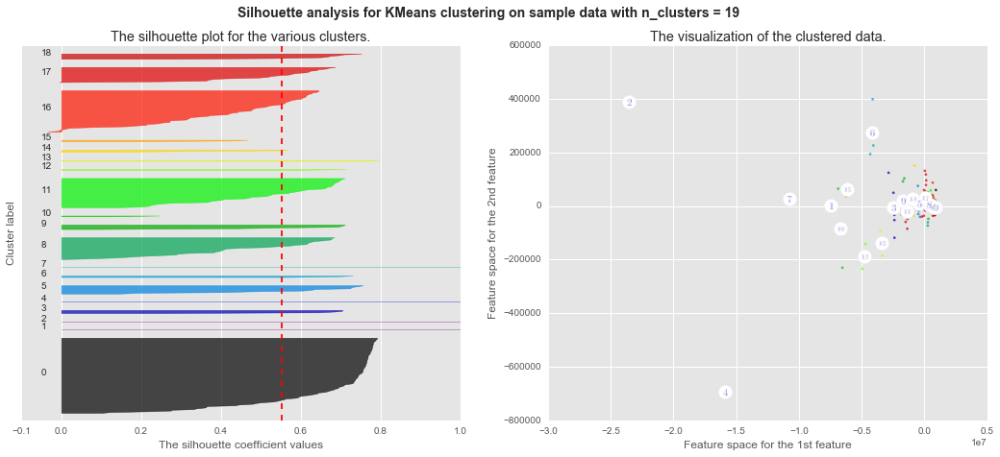

********************
Number of Components for PCA: 25
For n_clusters = 20 The average silhouette_score is : 0.555989020042


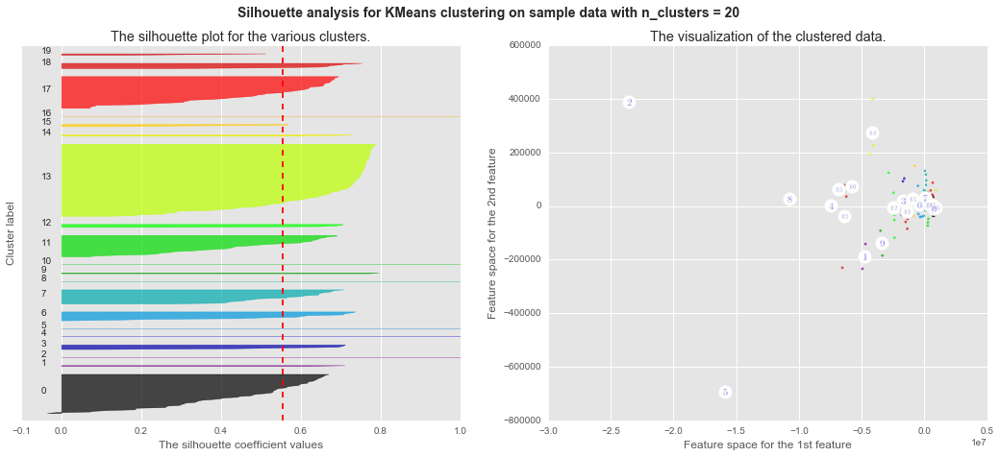

********************
Number of Components for PCA: 25
For n_clusters = 21 The average silhouette_score is : 0.542034693233


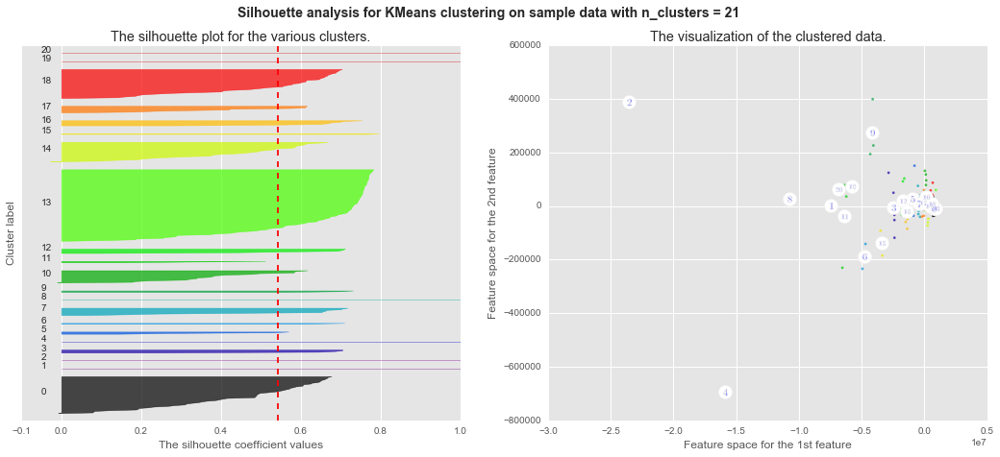

********************
Number of Components for PCA: 26
********************
********************
Number of Components for PCA: 26
For n_clusters = 4 The average silhouette_score is : 0.794910204627


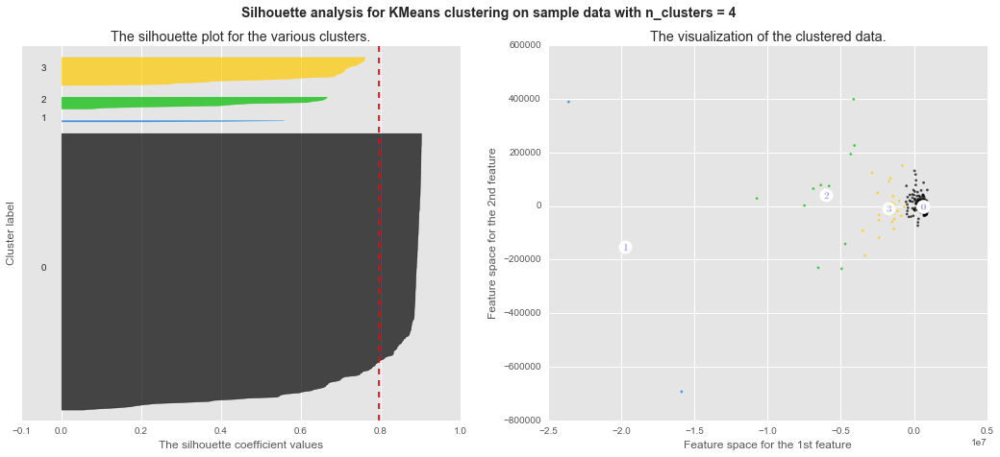

********************
Number of Components for PCA: 26
For n_clusters = 5 The average silhouette_score is : 0.798095897931


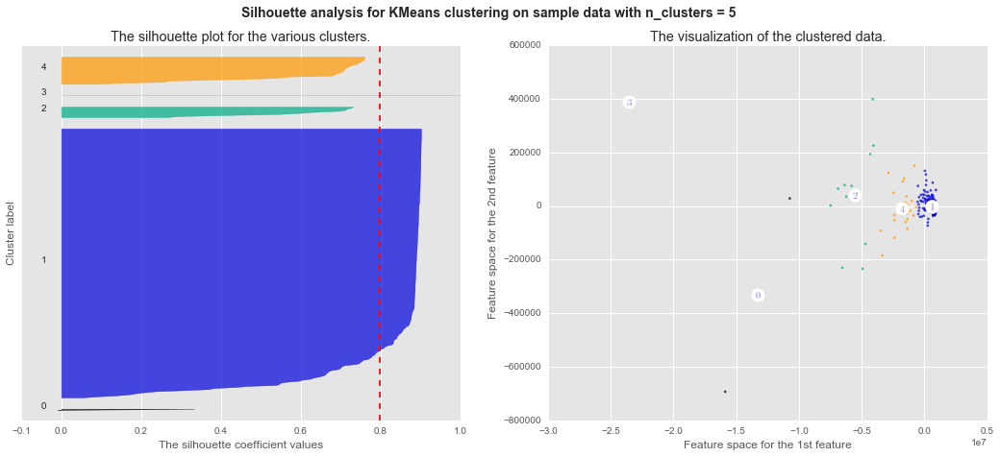

********************
Number of Components for PCA: 26
For n_clusters = 6 The average silhouette_score is : 0.683324545867


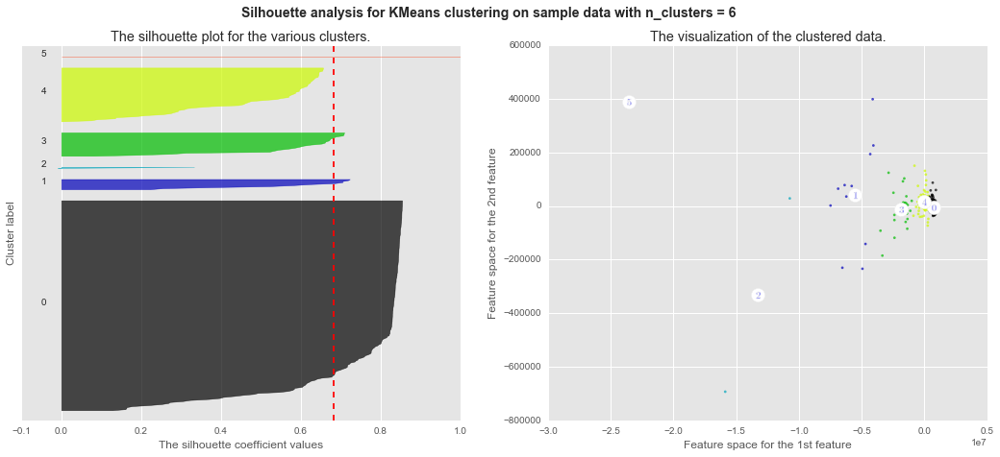

********************
Number of Components for PCA: 26
For n_clusters = 7 The average silhouette_score is : 0.687779732279


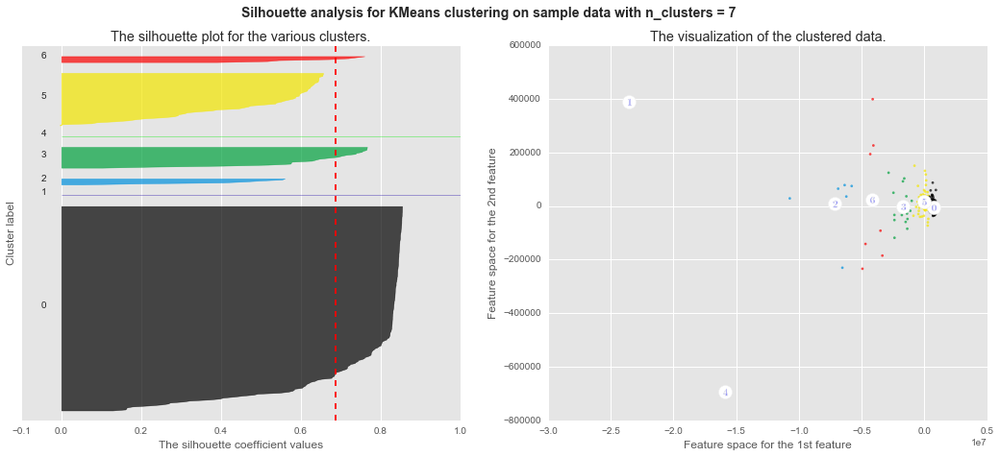

********************
Number of Components for PCA: 26
For n_clusters = 8 The average silhouette_score is : 0.69453225272


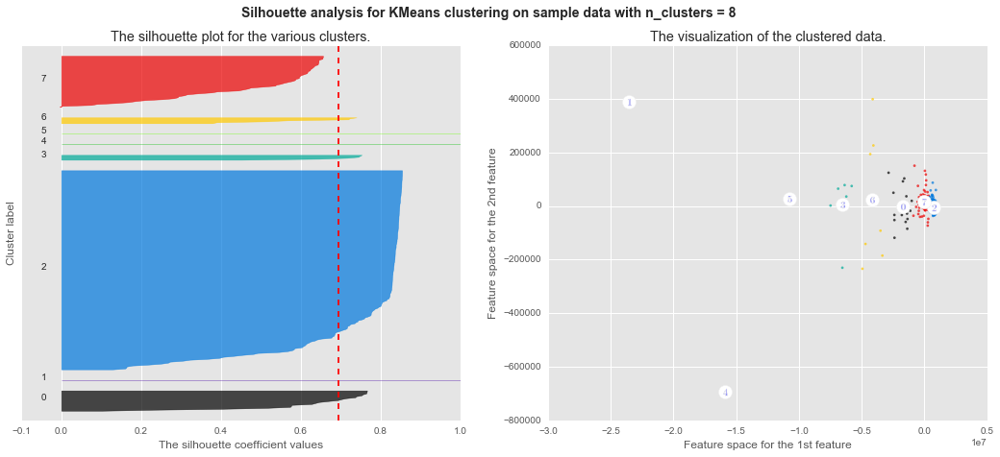

********************
Number of Components for PCA: 26
For n_clusters = 9 The average silhouette_score is : 0.645750321082


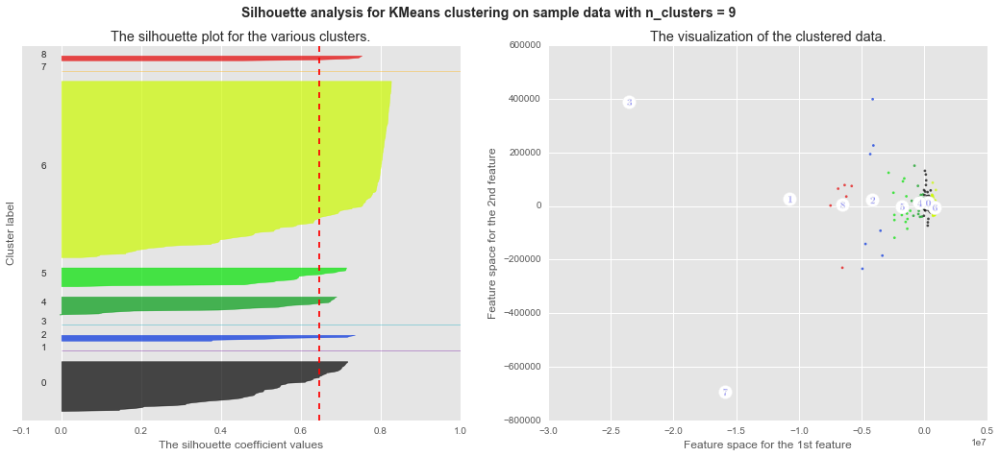

********************
Number of Components for PCA: 26
For n_clusters = 10 The average silhouette_score is : 0.617198776463


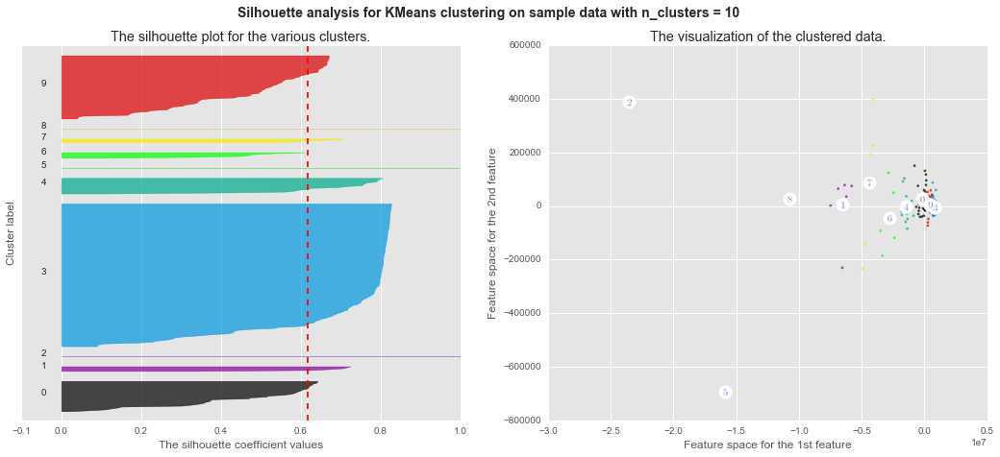

********************
Number of Components for PCA: 26
For n_clusters = 11 The average silhouette_score is : 0.615127685555


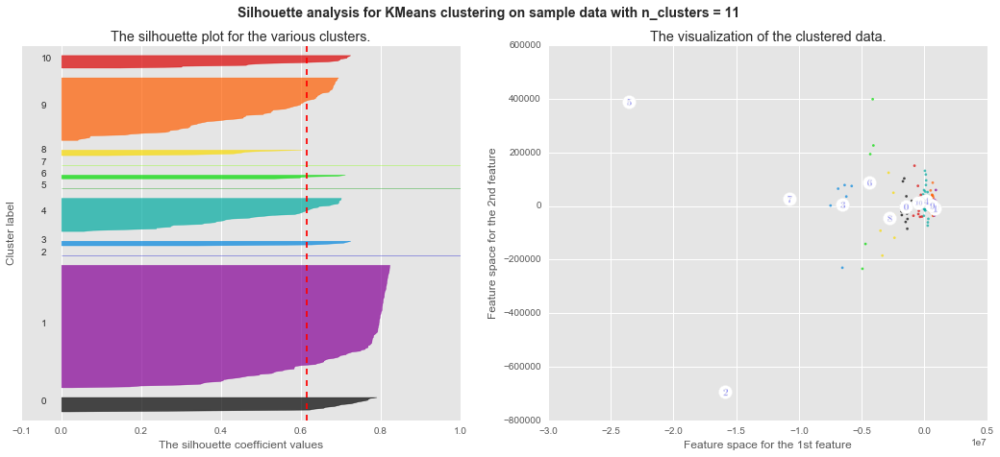

********************
Number of Components for PCA: 26
For n_clusters = 12 The average silhouette_score is : 0.610871180829


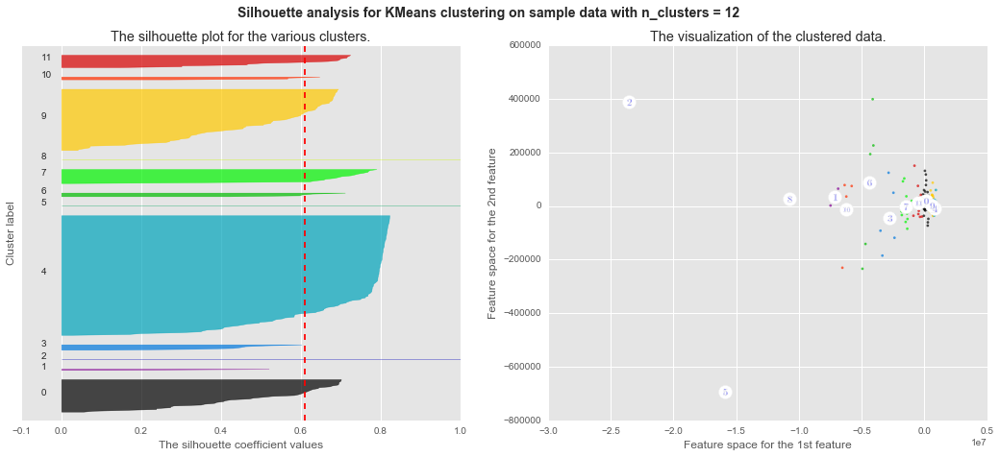

********************
Number of Components for PCA: 26
For n_clusters = 13 The average silhouette_score is : 0.610156347097


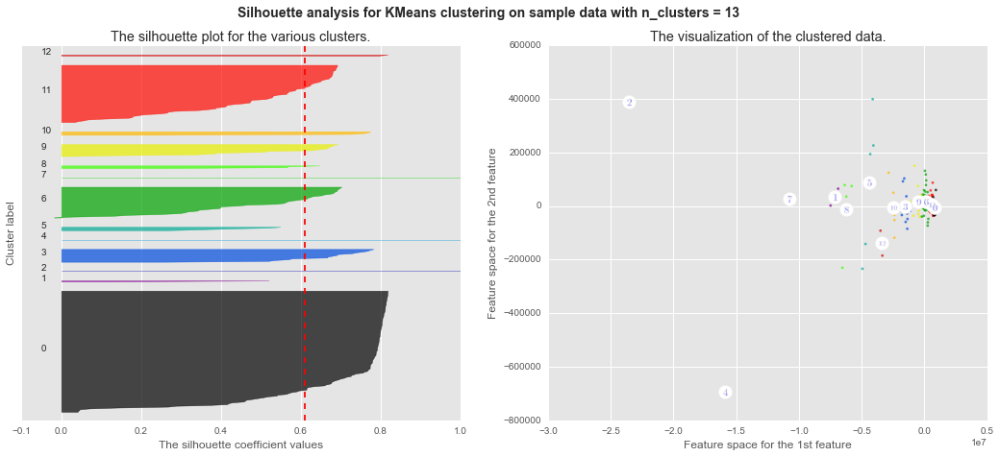

********************
Number of Components for PCA: 26
For n_clusters = 14 The average silhouette_score is : 0.596810451071


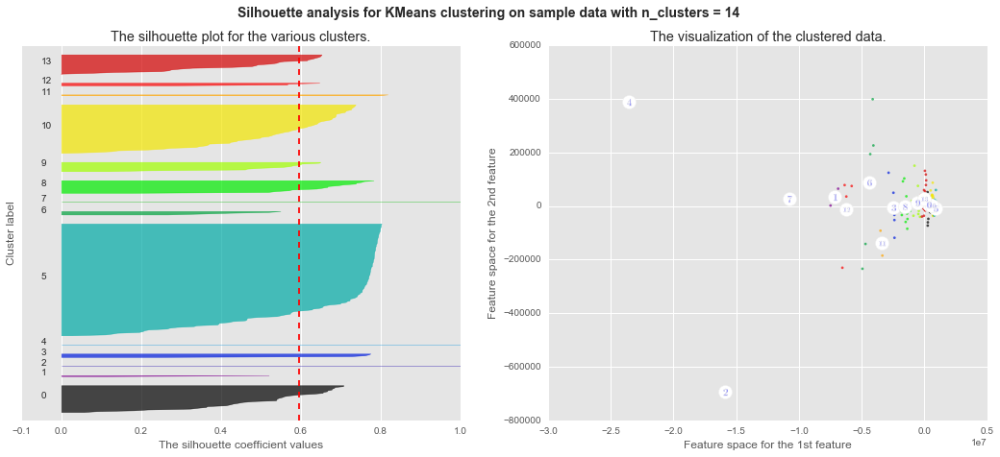

********************
Number of Components for PCA: 26
For n_clusters = 15 The average silhouette_score is : 0.602113129913


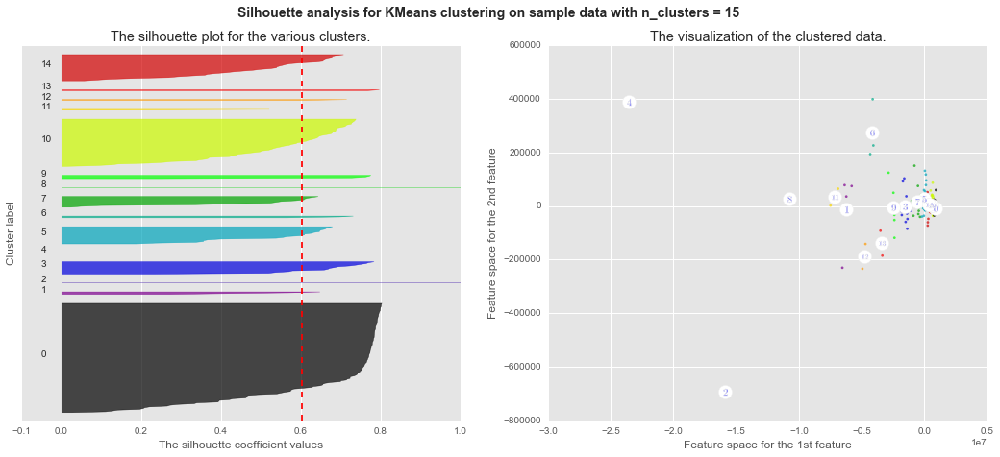

********************
Number of Components for PCA: 26
For n_clusters = 16 The average silhouette_score is : 0.59654013319


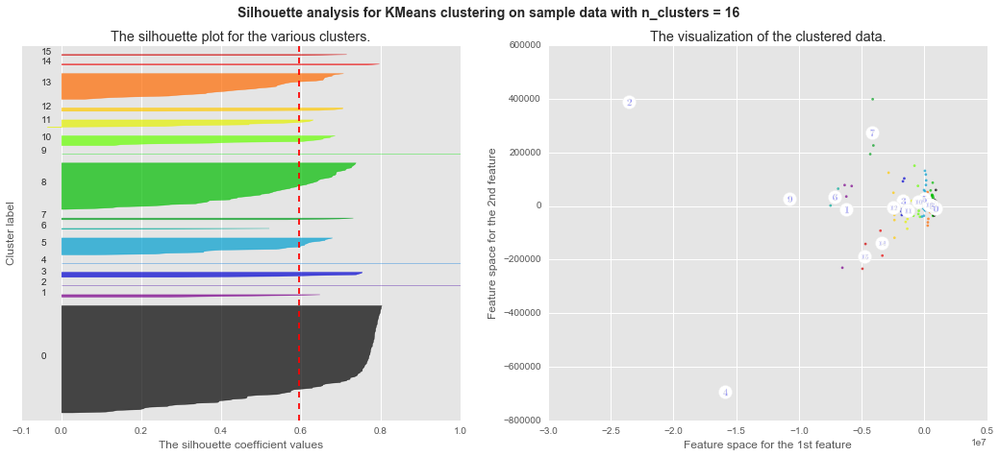

********************
Number of Components for PCA: 26
For n_clusters = 17 The average silhouette_score is : 0.59707666765


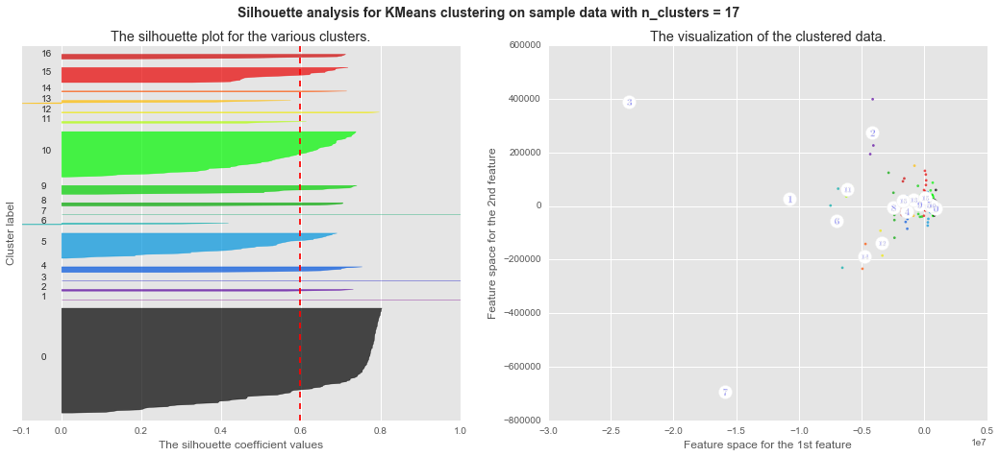

********************
Number of Components for PCA: 26
For n_clusters = 18 The average silhouette_score is : 0.586112675899


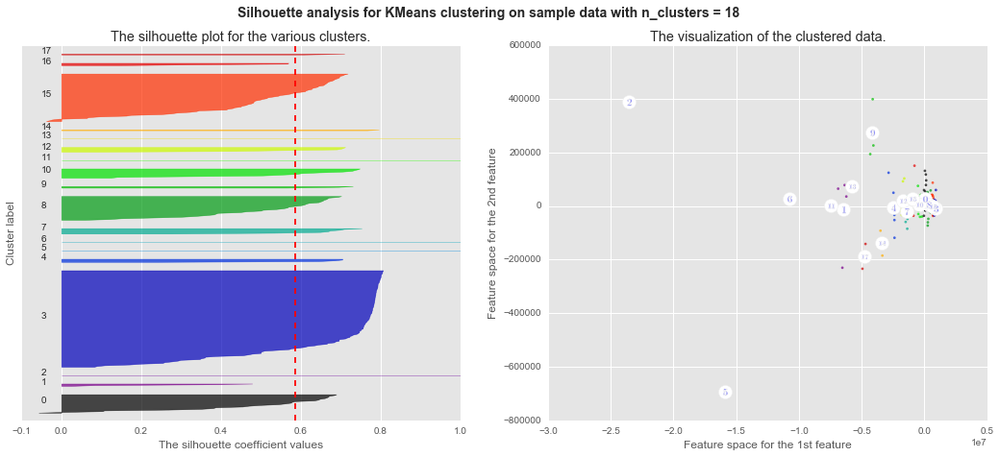

********************
Number of Components for PCA: 26
For n_clusters = 19 The average silhouette_score is : 0.524711441635


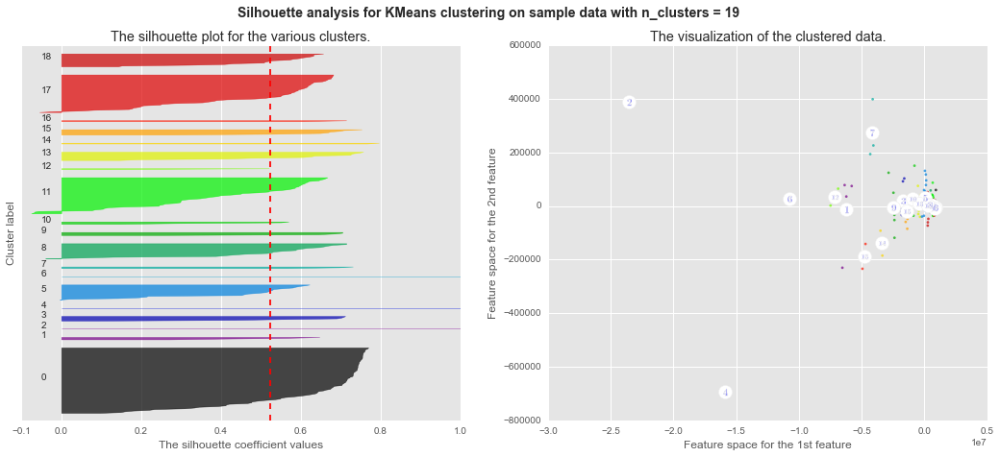

********************
Number of Components for PCA: 26
For n_clusters = 20 The average silhouette_score is : 0.545755559901


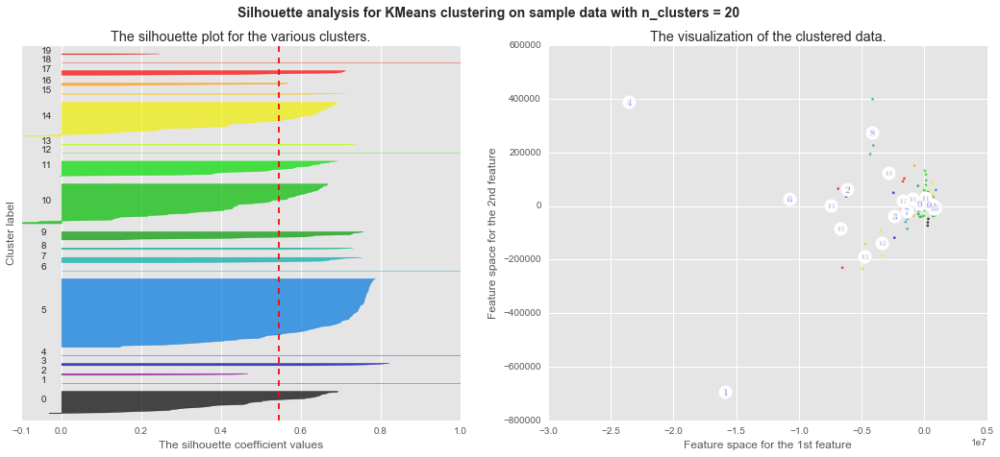

********************
Number of Components for PCA: 26
For n_clusters = 21 The average silhouette_score is : 0.548979062907


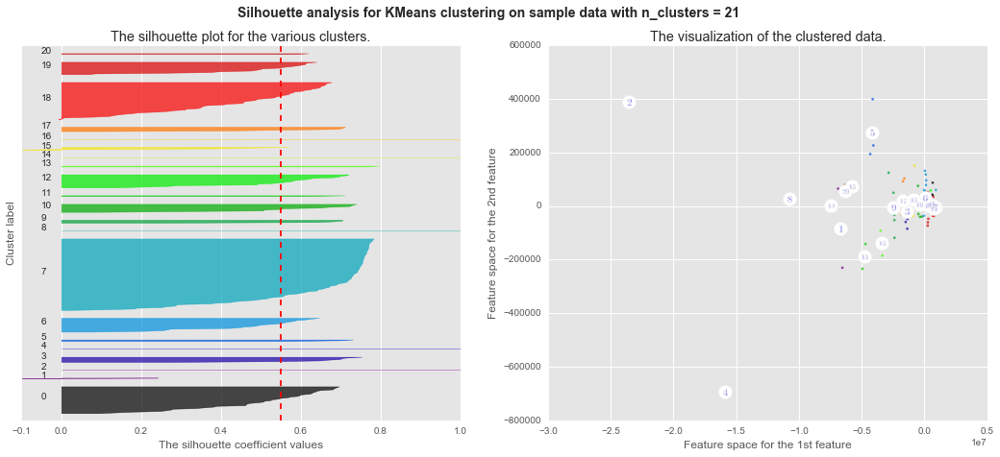

********************
Number of Components for PCA: 27
********************
********************
Number of Components for PCA: 27
For n_clusters = 4 The average silhouette_score is : 0.794910204613


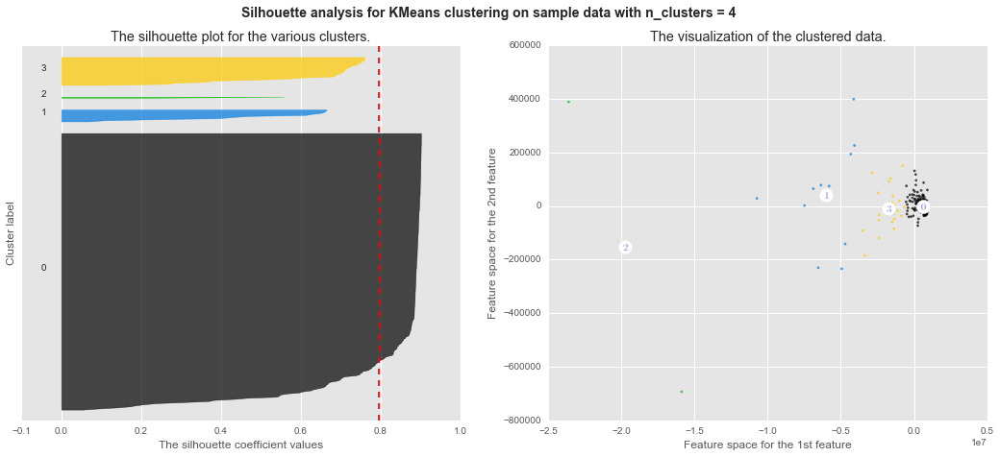

********************
Number of Components for PCA: 27
For n_clusters = 5 The average silhouette_score is : 0.798095897918


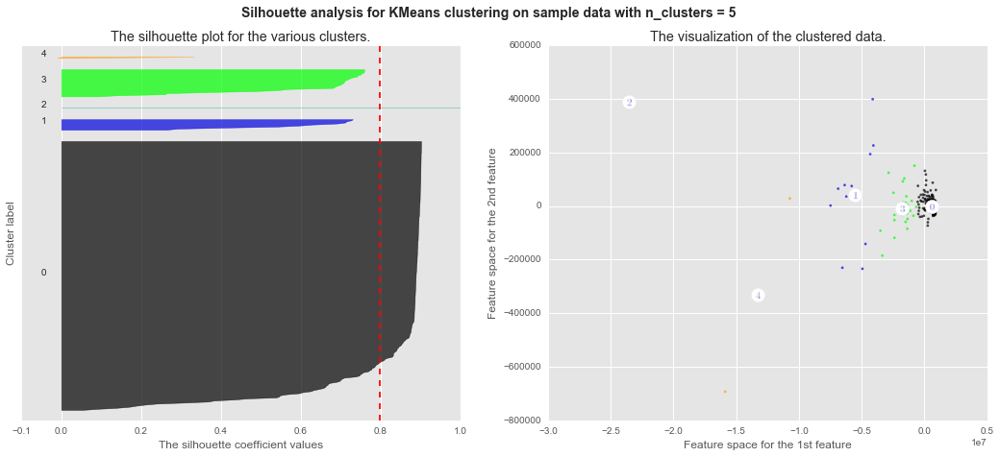

********************
Number of Components for PCA: 27
For n_clusters = 6 The average silhouette_score is : 0.683324545818


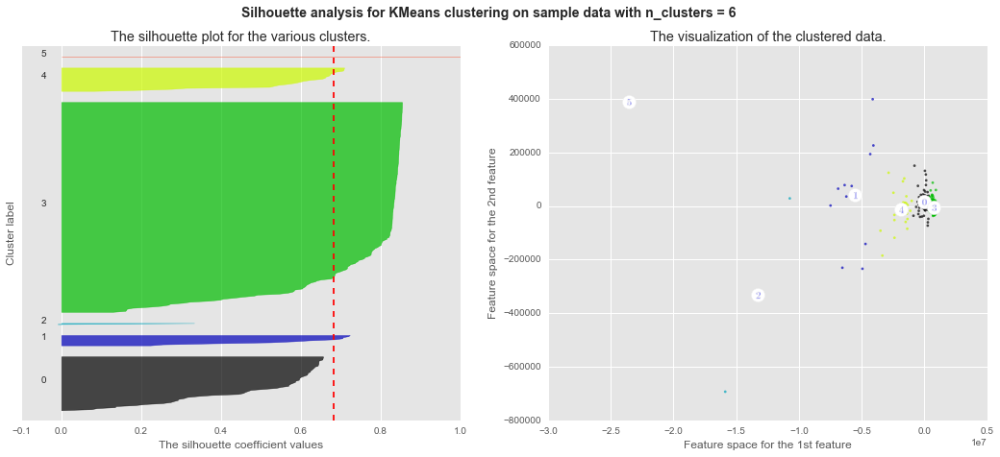

********************
Number of Components for PCA: 27
For n_clusters = 7 The average silhouette_score is : 0.686594374358


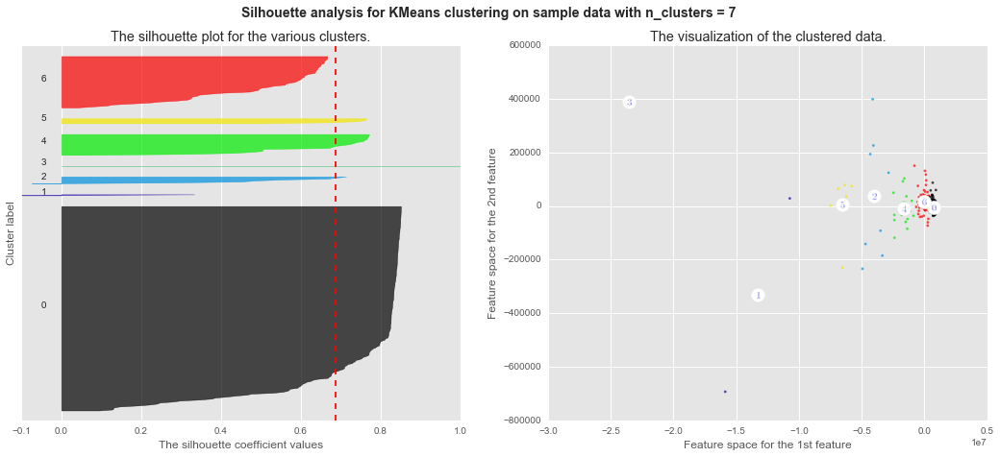

********************
Number of Components for PCA: 27
For n_clusters = 8 The average silhouette_score is : 0.692963481422


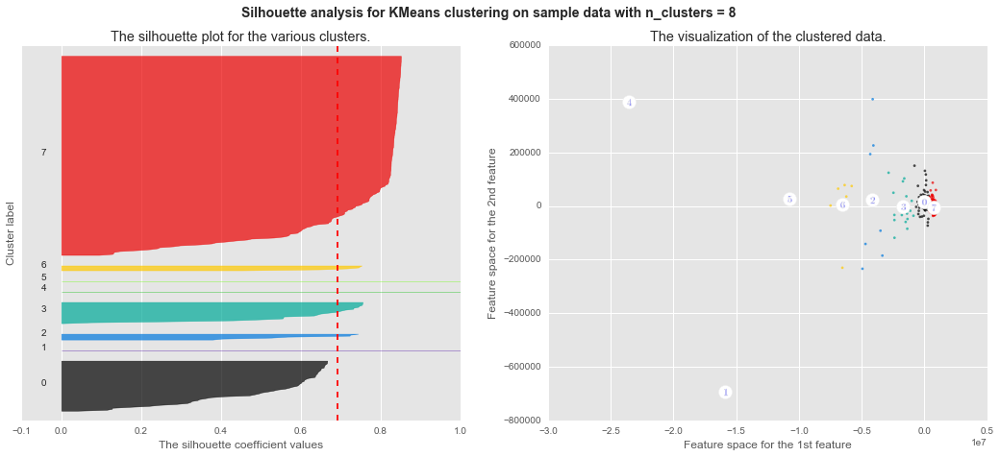

********************
Number of Components for PCA: 27
For n_clusters = 9 The average silhouette_score is : 0.655873920246


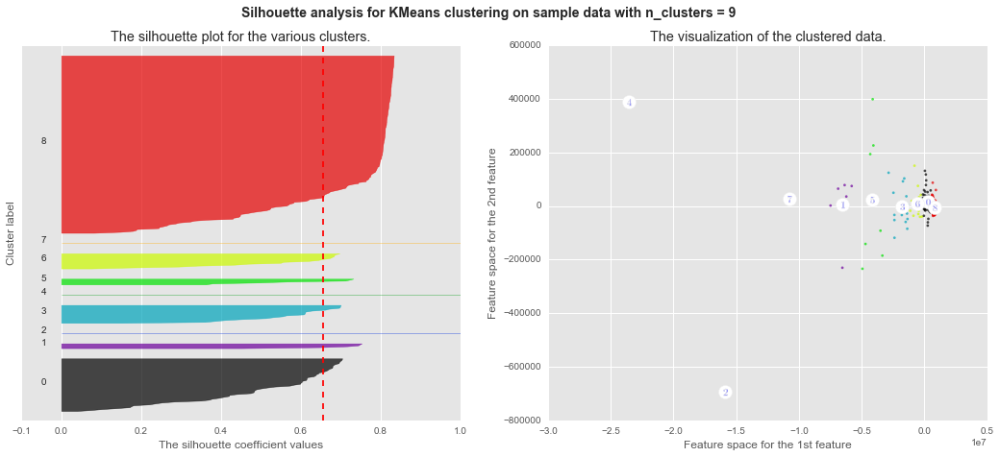

********************
Number of Components for PCA: 27
For n_clusters = 10 The average silhouette_score is : 0.617198776332


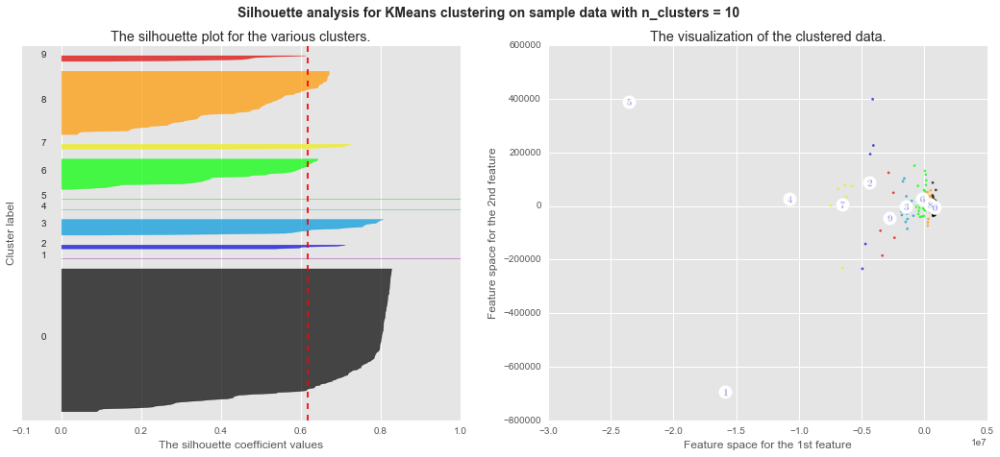

********************
Number of Components for PCA: 27
For n_clusters = 11 The average silhouette_score is : 0.615243083798


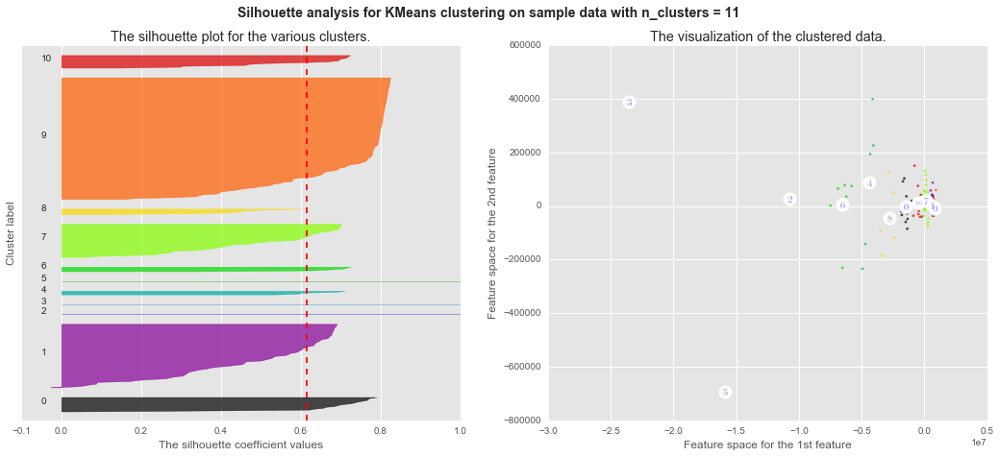

********************
Number of Components for PCA: 27
For n_clusters = 12 The average silhouette_score is : 0.609496334891


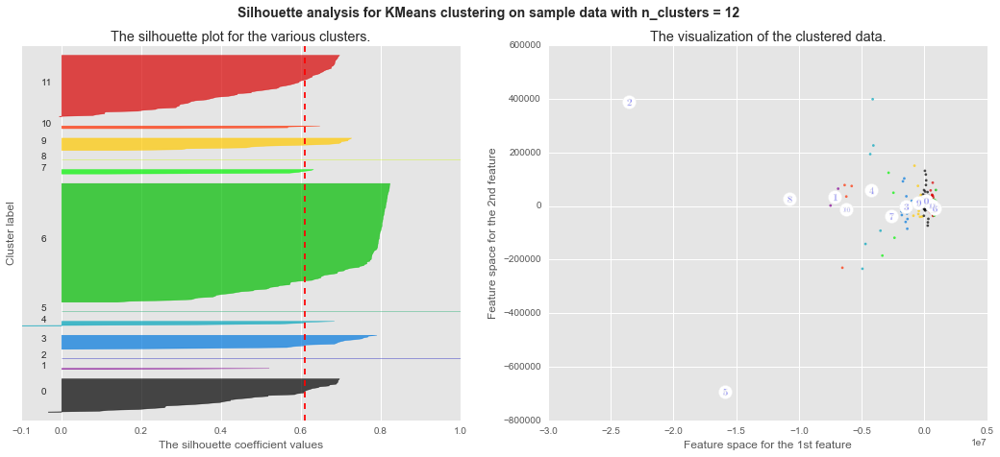

********************
Number of Components for PCA: 27
For n_clusters = 13 The average silhouette_score is : 0.611905082951


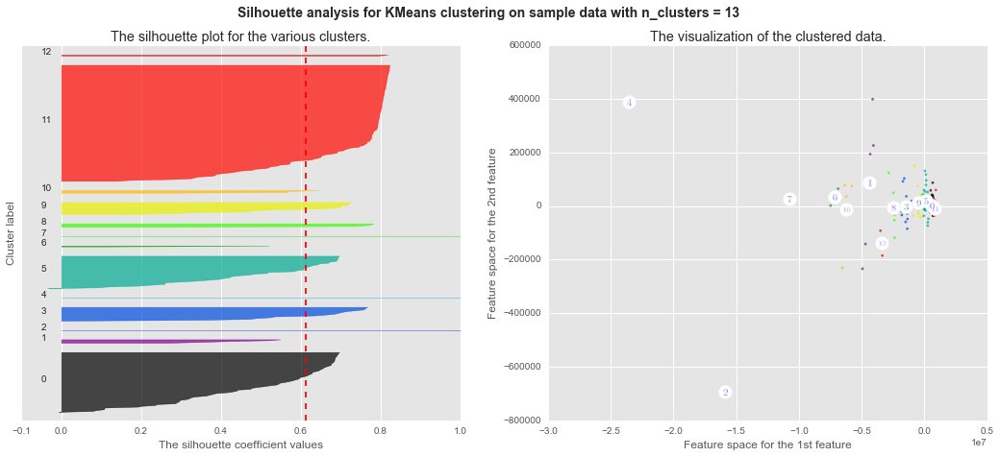

********************
Number of Components for PCA: 27
For n_clusters = 14 The average silhouette_score is : 0.597120879683


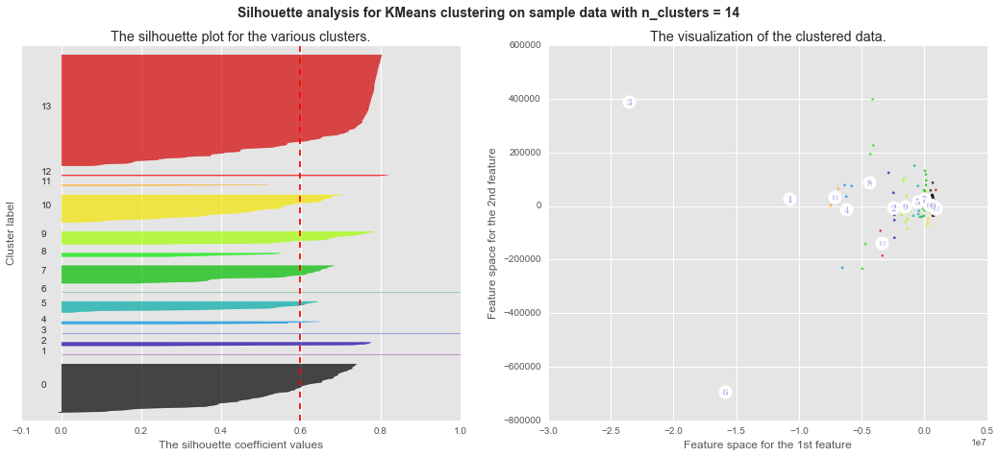

********************
Number of Components for PCA: 27
For n_clusters = 15 The average silhouette_score is : 0.600123152302


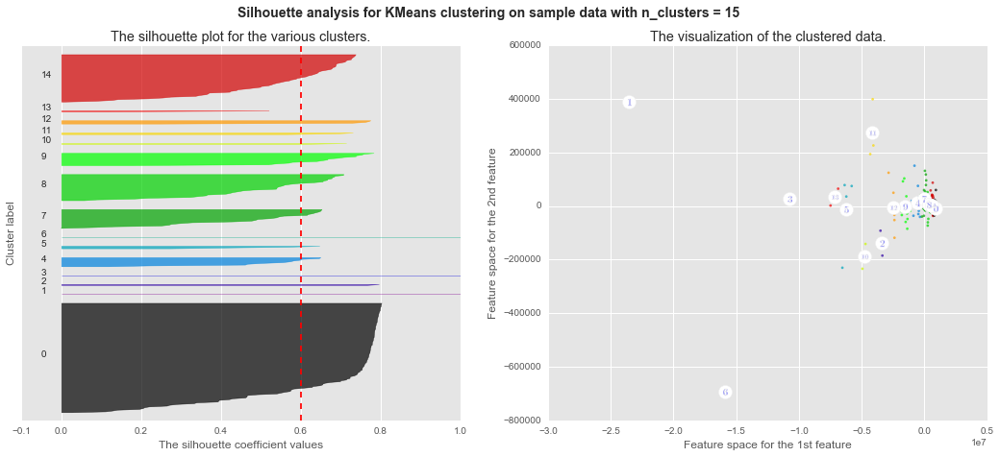

********************
Number of Components for PCA: 27
For n_clusters = 16 The average silhouette_score is : 0.59021850442


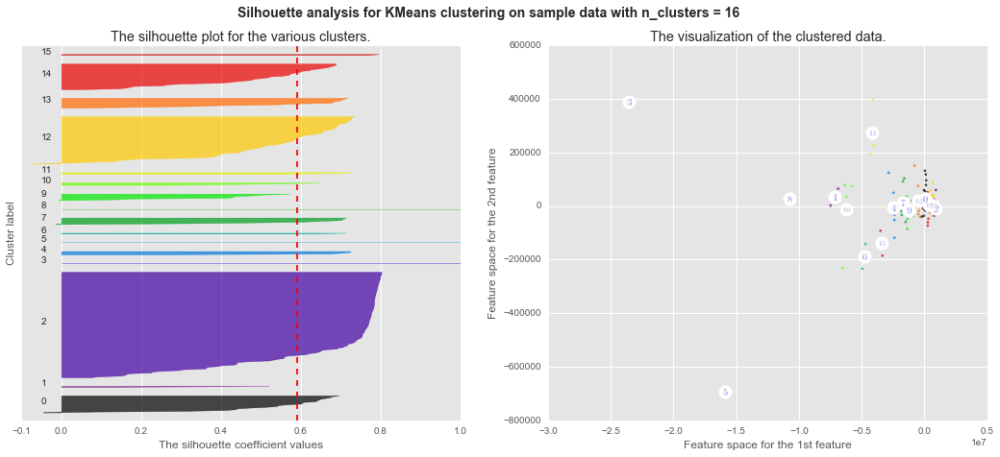

********************
Number of Components for PCA: 27
For n_clusters = 17 The average silhouette_score is : 0.591151217855


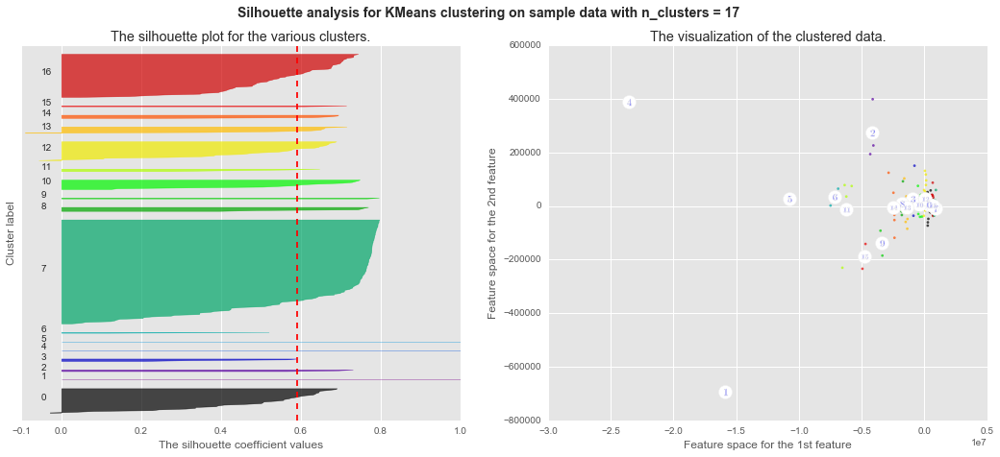

********************
Number of Components for PCA: 27
For n_clusters = 18 The average silhouette_score is : 0.542414769694


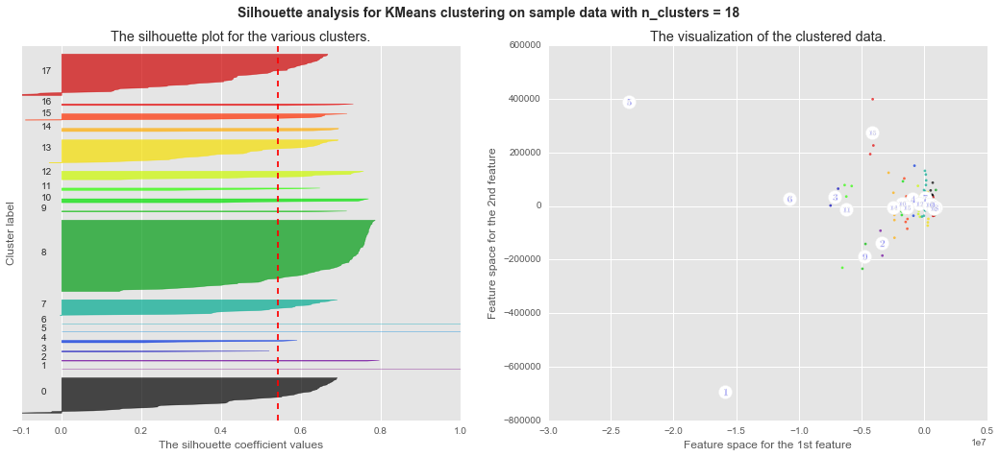

********************
Number of Components for PCA: 27
For n_clusters = 19 The average silhouette_score is : 0.551921357642


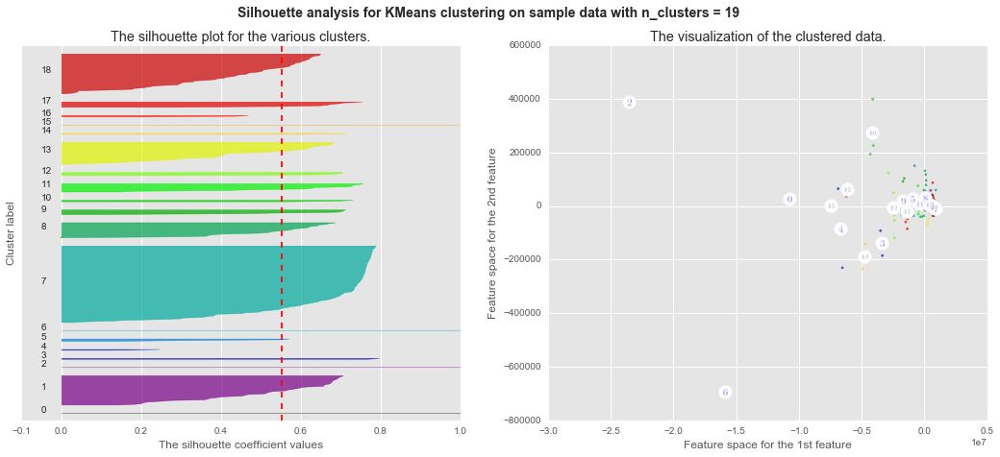

********************
Number of Components for PCA: 27
For n_clusters = 20 The average silhouette_score is : 0.539661673107


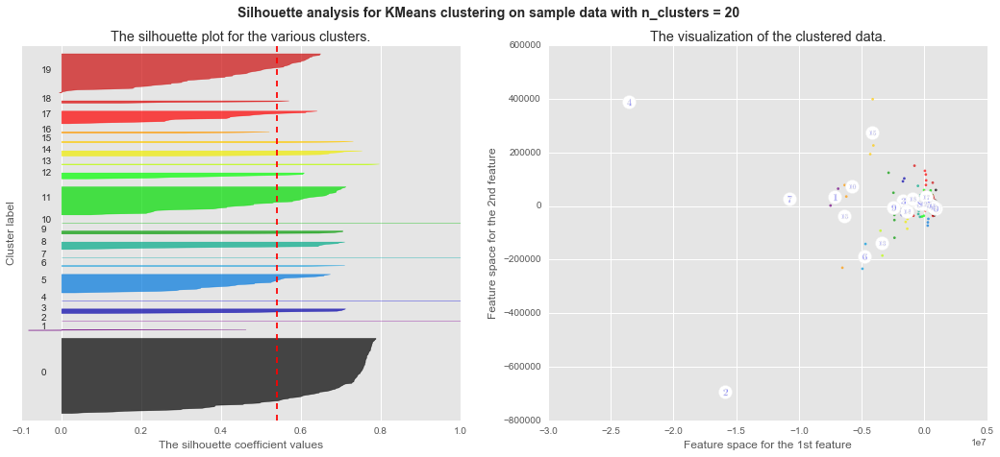

********************
Number of Components for PCA: 27
For n_clusters = 21 The average silhouette_score is : 0.531860906632


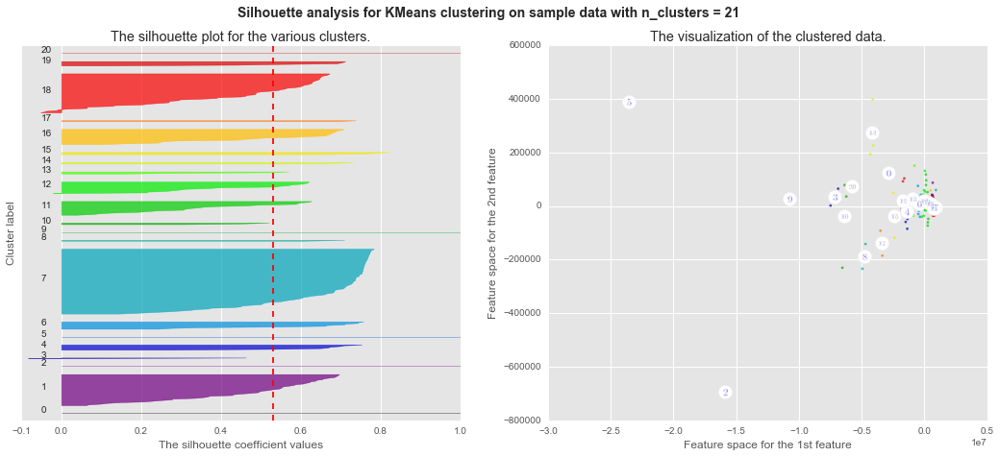

********************
Number of Components for PCA: 28
********************
********************
Number of Components for PCA: 28
For n_clusters = 4 The average silhouette_score is : 0.794910204602


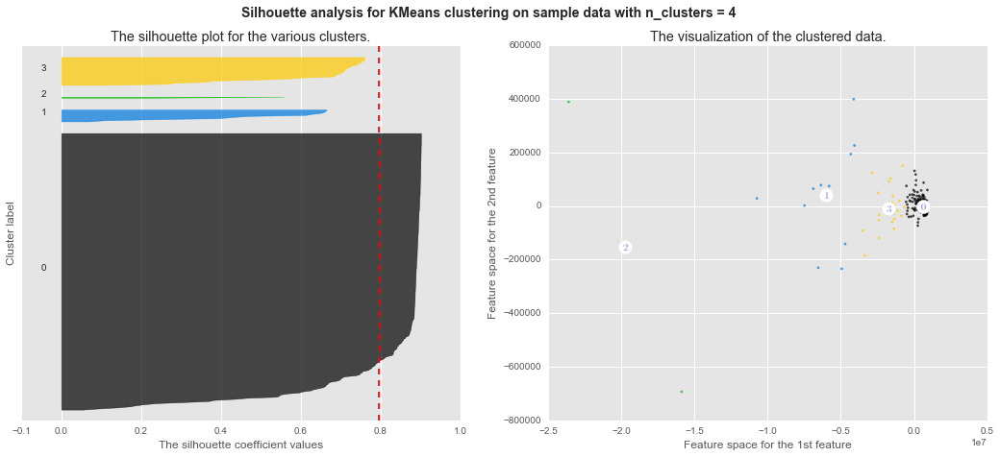

********************
Number of Components for PCA: 28
For n_clusters = 5 The average silhouette_score is : 0.798095897907


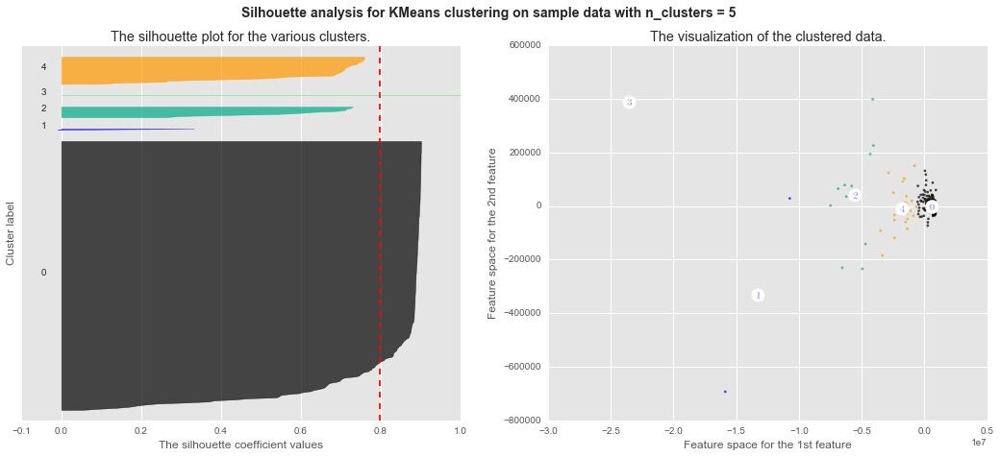

********************
Number of Components for PCA: 28
For n_clusters = 6 The average silhouette_score is : 0.683324545778


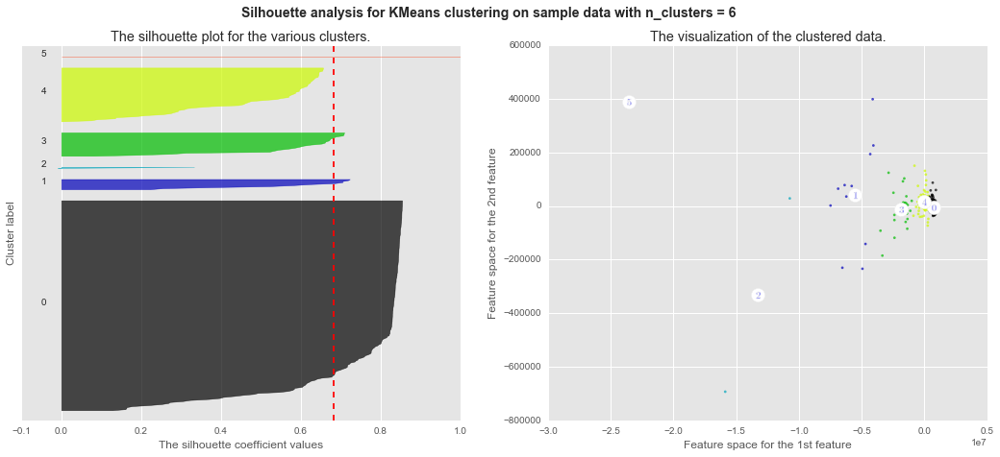

********************
Number of Components for PCA: 28
For n_clusters = 7 The average silhouette_score is : 0.686594374317


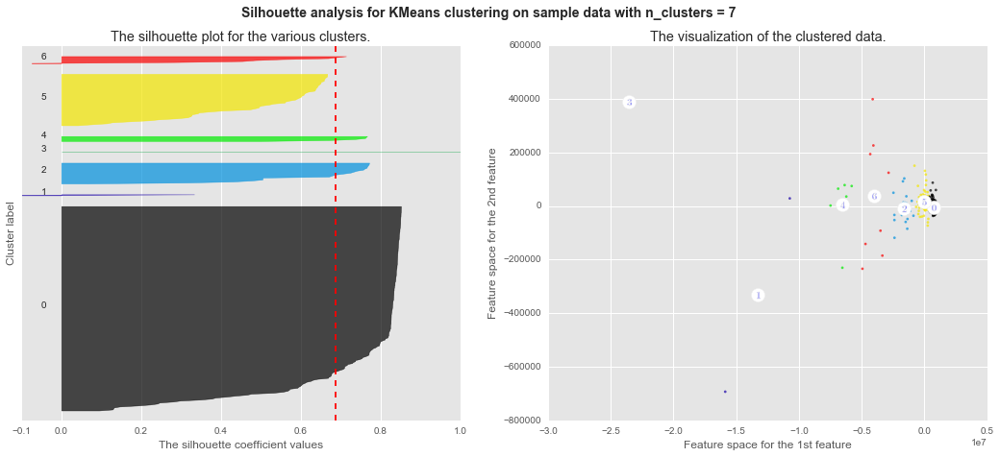

********************
Number of Components for PCA: 28
For n_clusters = 8 The average silhouette_score is : 0.692963481381


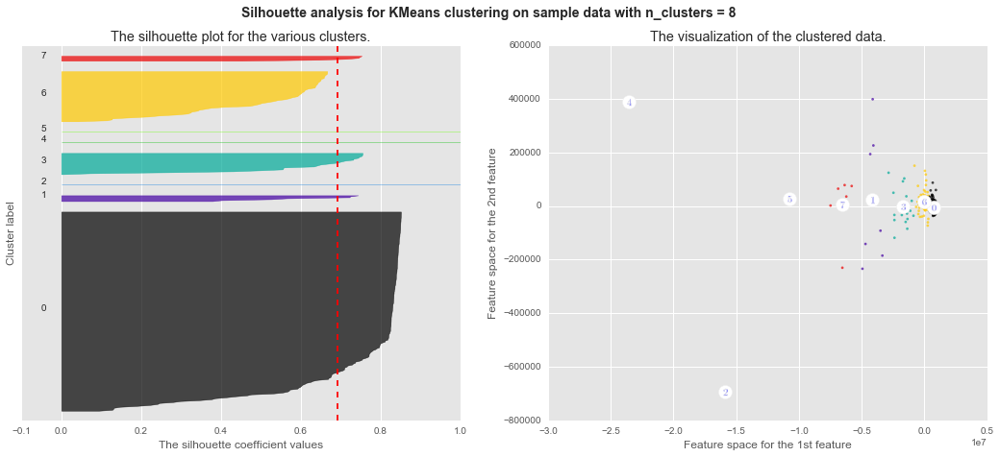

********************
Number of Components for PCA: 28
For n_clusters = 9 The average silhouette_score is : 0.655873920183


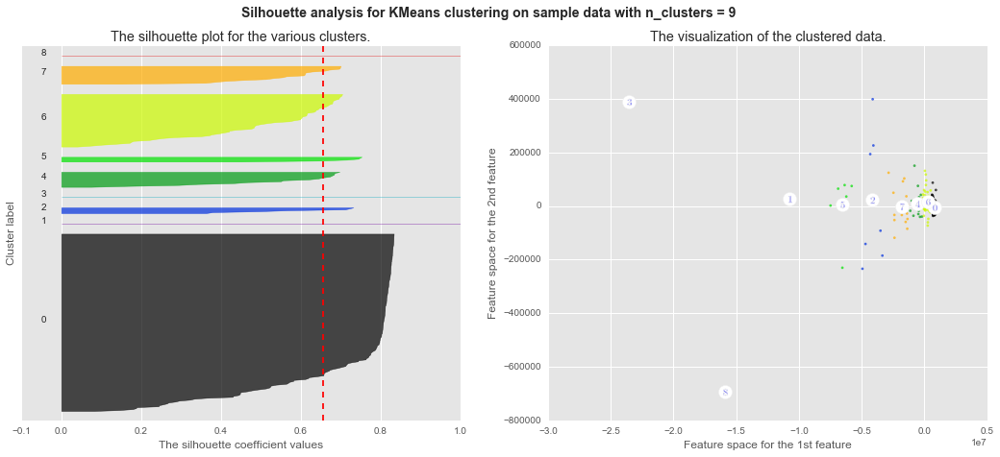

********************
Number of Components for PCA: 28
For n_clusters = 10 The average silhouette_score is : 0.617198776226


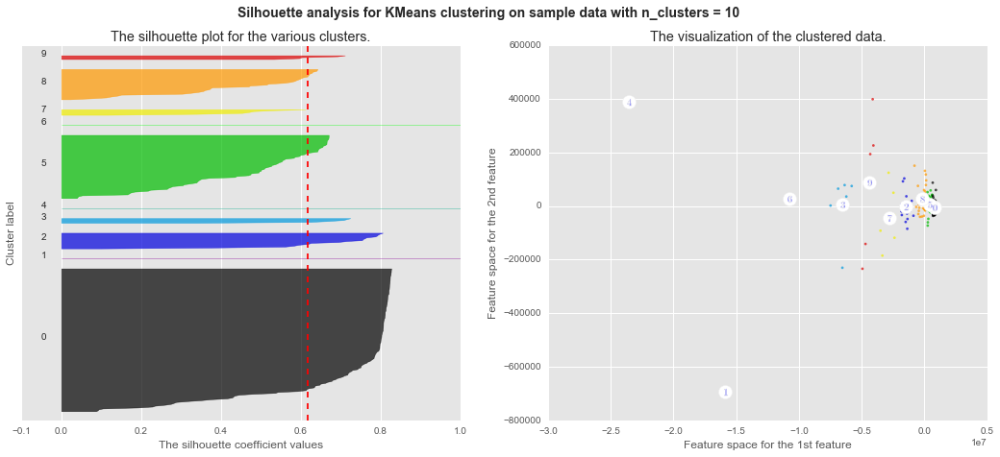

********************
Number of Components for PCA: 28
For n_clusters = 11 The average silhouette_score is : 0.615127685205


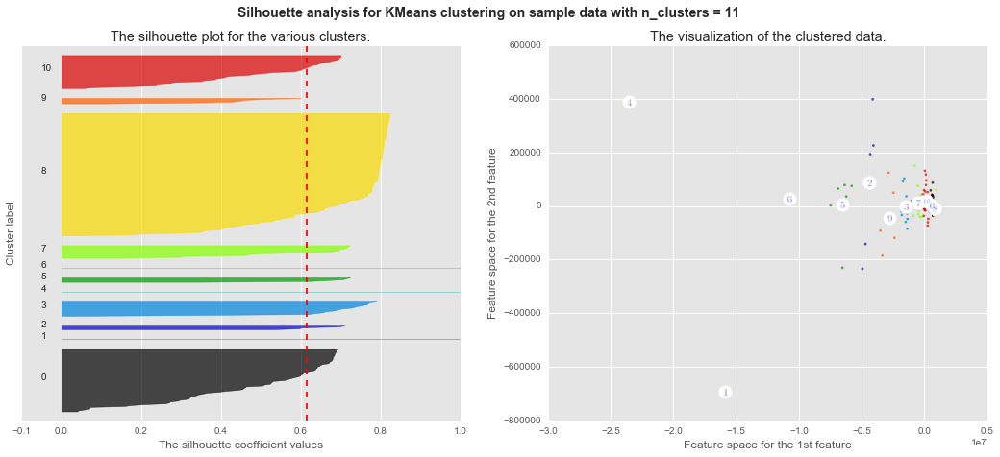

********************
Number of Components for PCA: 28
For n_clusters = 12 The average silhouette_score is : 0.615833396339


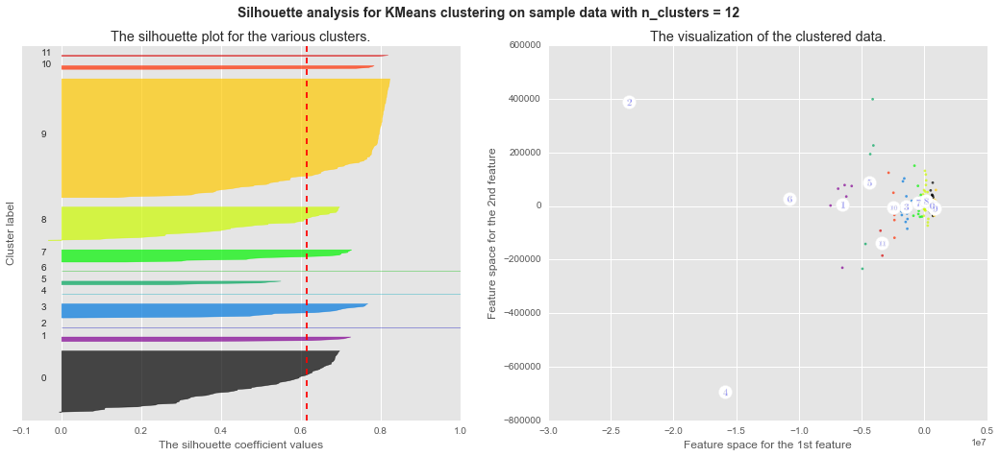

********************
Number of Components for PCA: 28
For n_clusters = 13 The average silhouette_score is : 0.611856303084


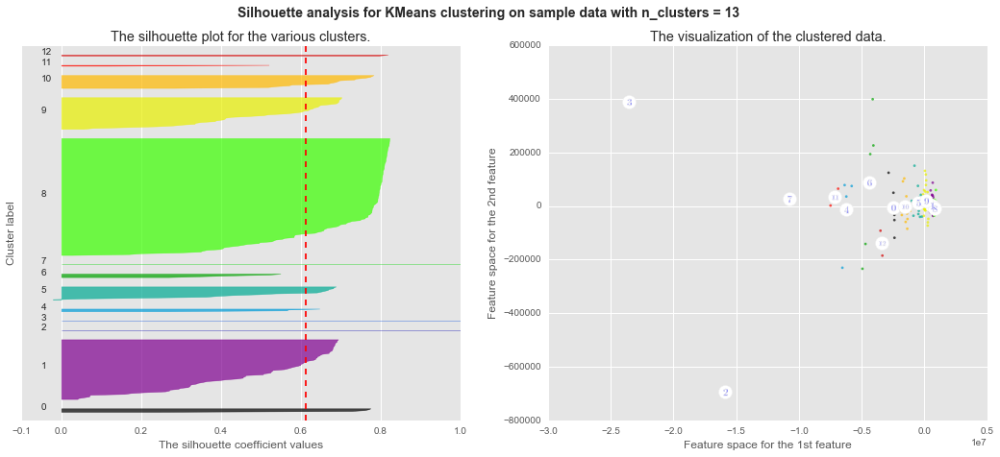

********************
Number of Components for PCA: 28
For n_clusters = 14 The average silhouette_score is : 0.5931836836


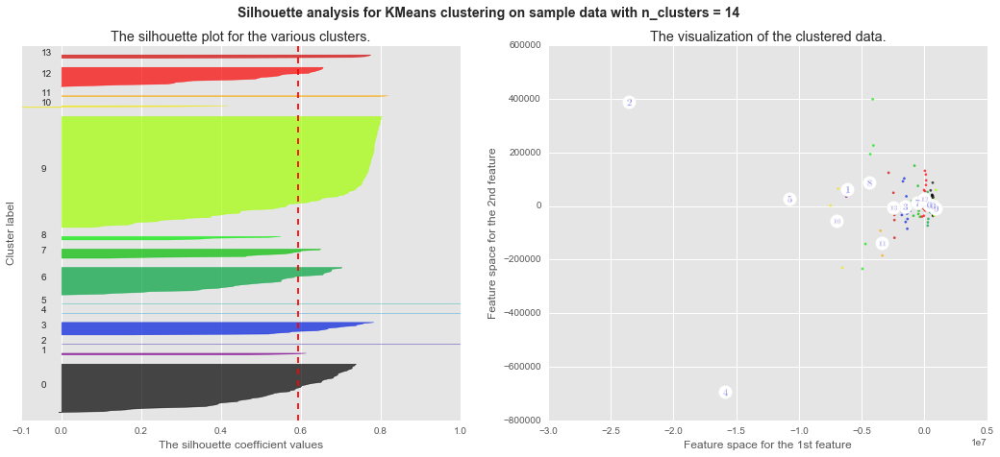

********************
Number of Components for PCA: 28
For n_clusters = 15 The average silhouette_score is : 0.600052817777


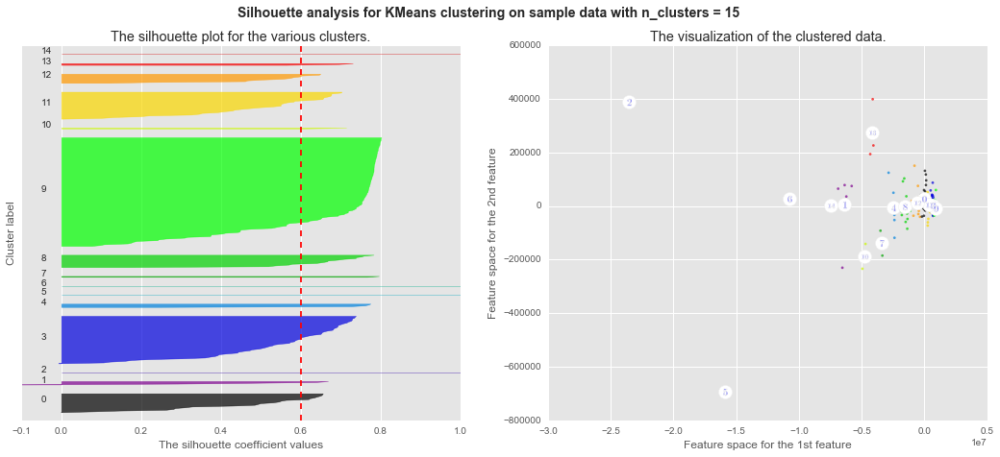

********************
Number of Components for PCA: 28
For n_clusters = 16 The average silhouette_score is : 0.596540132755


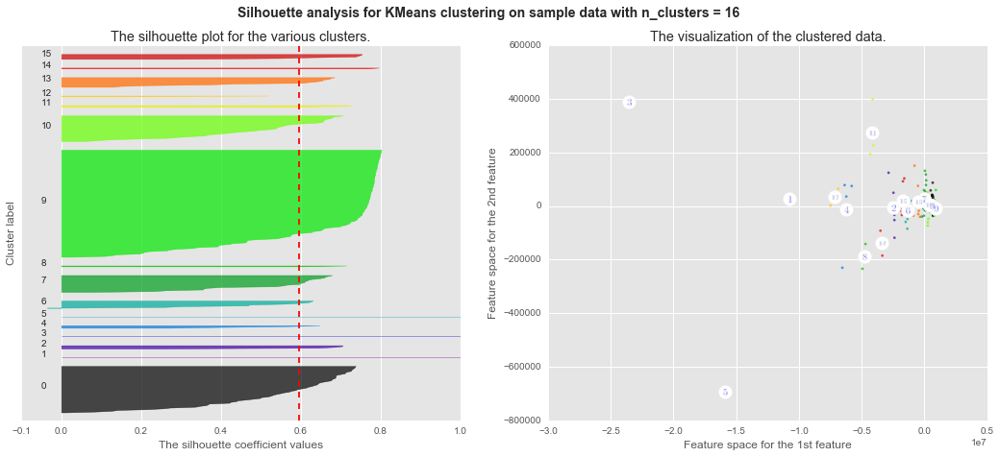

********************
Number of Components for PCA: 28
For n_clusters = 17 The average silhouette_score is : 0.597408994294


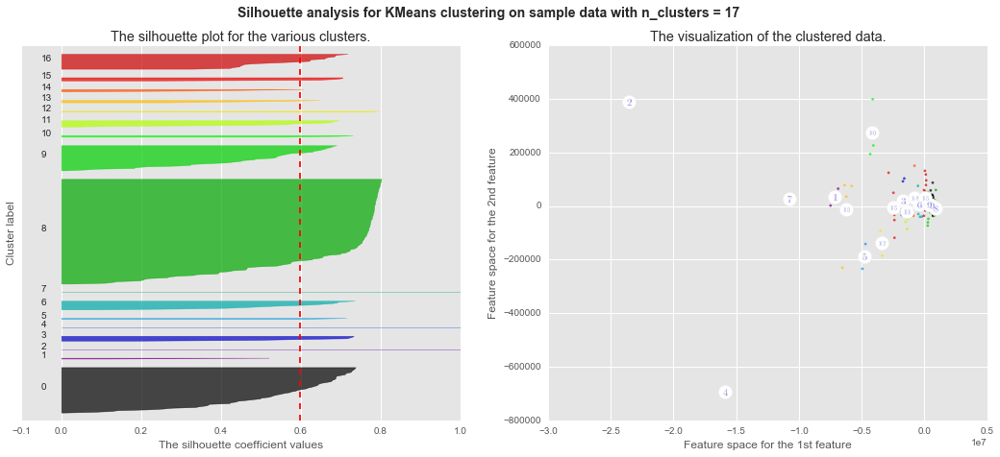

********************
Number of Components for PCA: 28
For n_clusters = 18 The average silhouette_score is : 0.599714313298


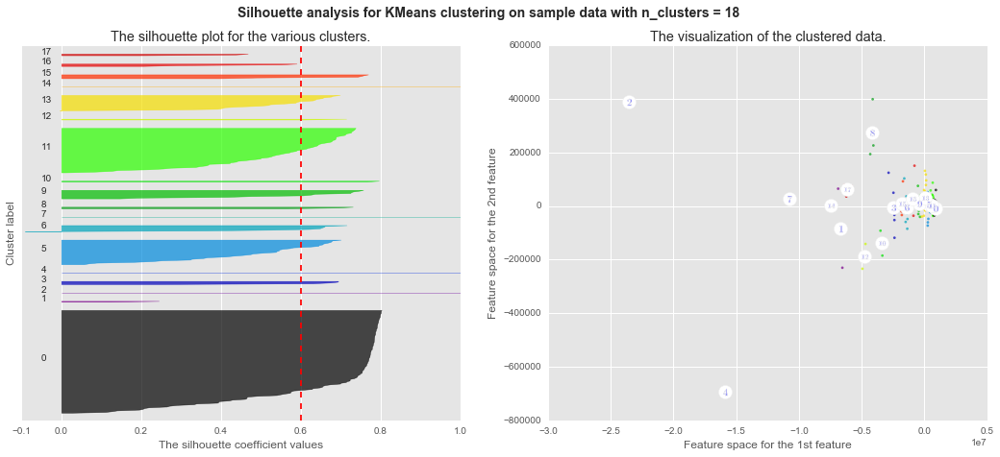

********************
Number of Components for PCA: 28
For n_clusters = 19 The average silhouette_score is : 0.550462439947


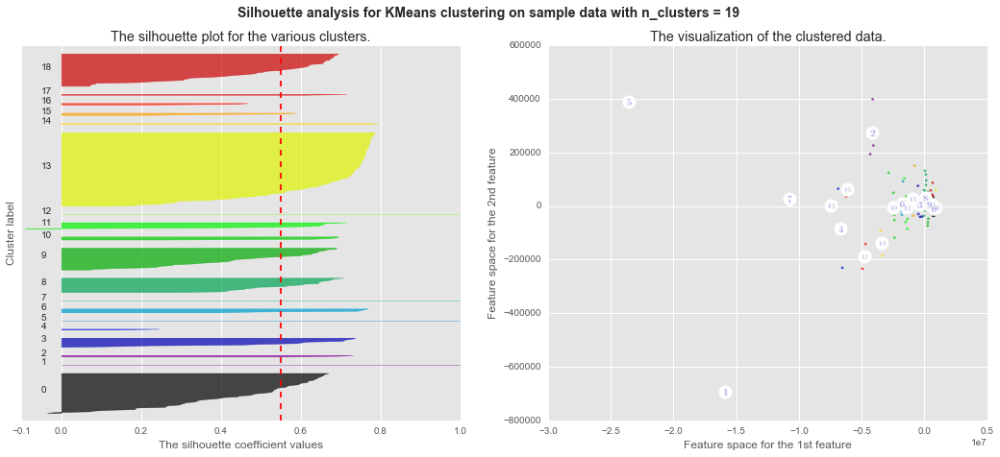

********************
Number of Components for PCA: 28
For n_clusters = 20 The average silhouette_score is : 0.547426411528


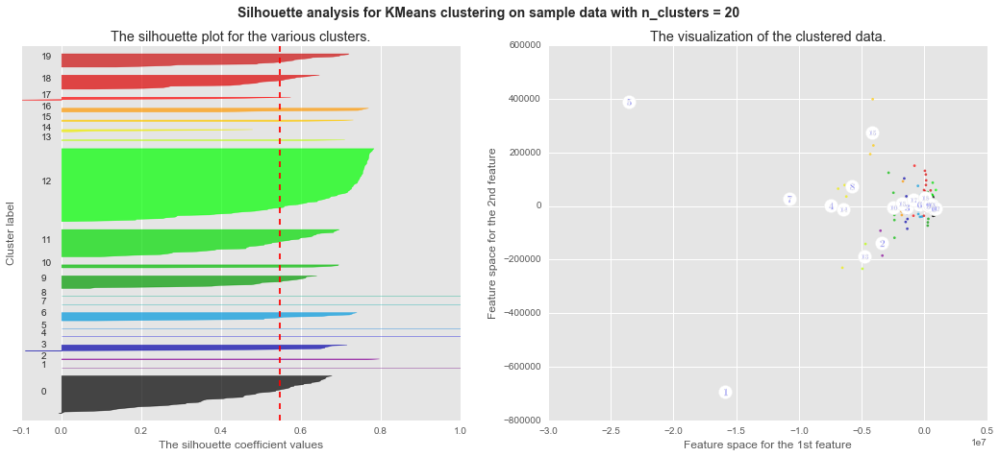

********************
Number of Components for PCA: 28
For n_clusters = 21 The average silhouette_score is : 0.54796850161


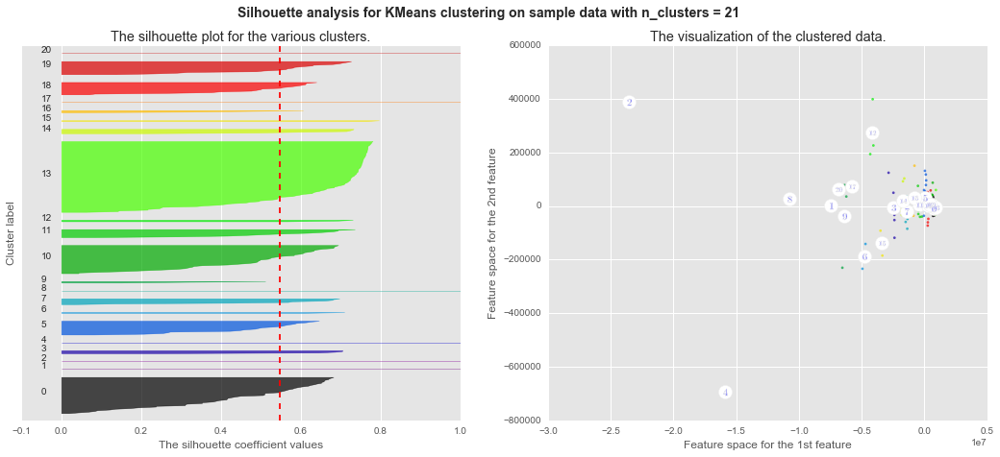

********************
Number of Components for PCA: 29
********************
********************
Number of Components for PCA: 29
For n_clusters = 4 The average silhouette_score is : 0.794910204592


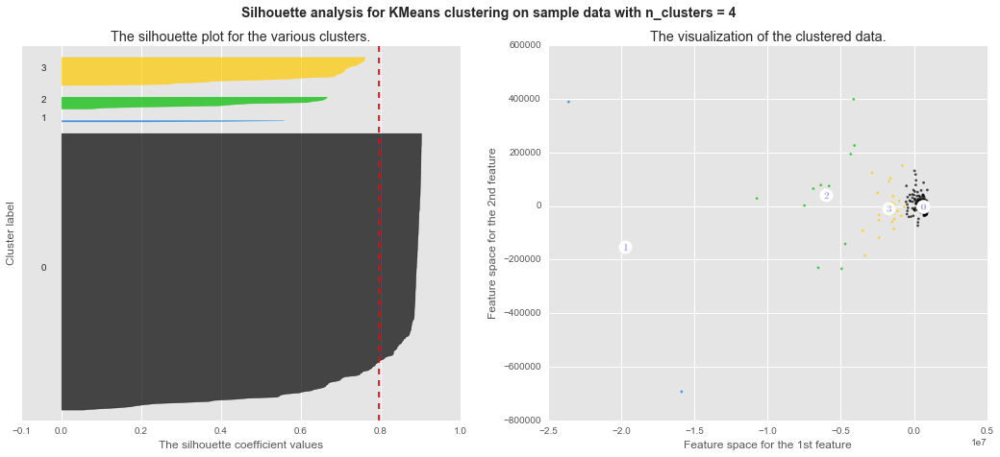

********************
Number of Components for PCA: 29
For n_clusters = 5 The average silhouette_score is : 0.777197481181


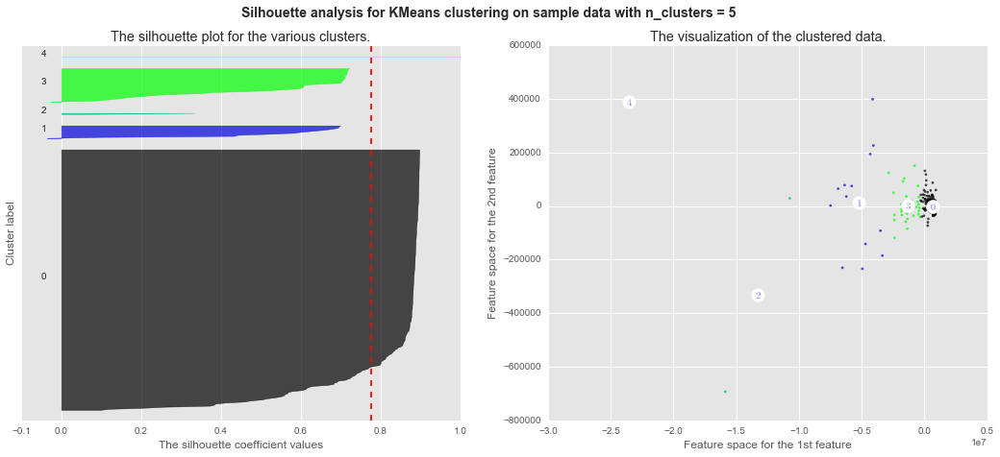

********************
Number of Components for PCA: 29
For n_clusters = 6 The average silhouette_score is : 0.683324545741


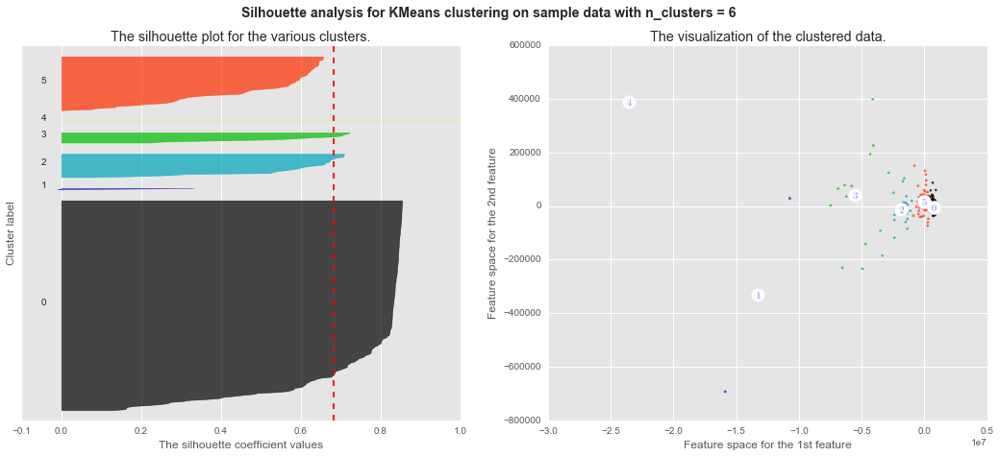

********************
Number of Components for PCA: 29
For n_clusters = 7 The average silhouette_score is : 0.686594374279


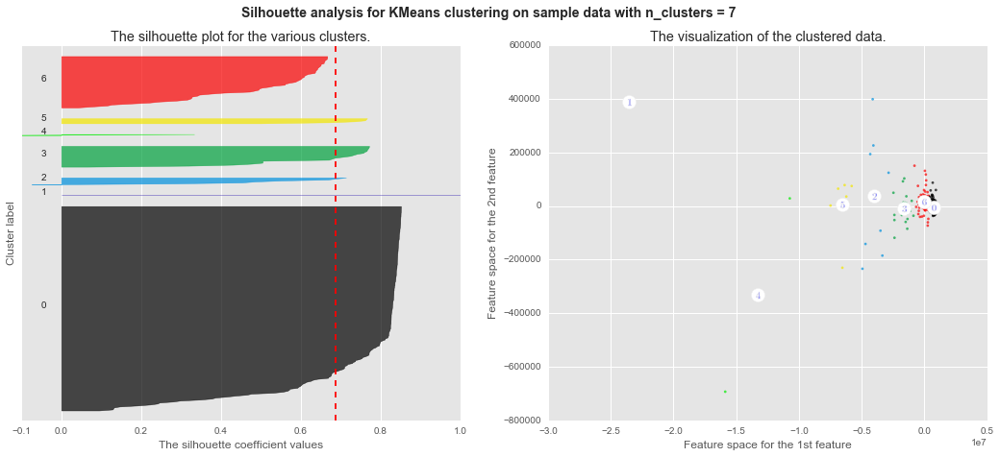

********************
Number of Components for PCA: 29
For n_clusters = 8 The average silhouette_score is : 0.692963481343


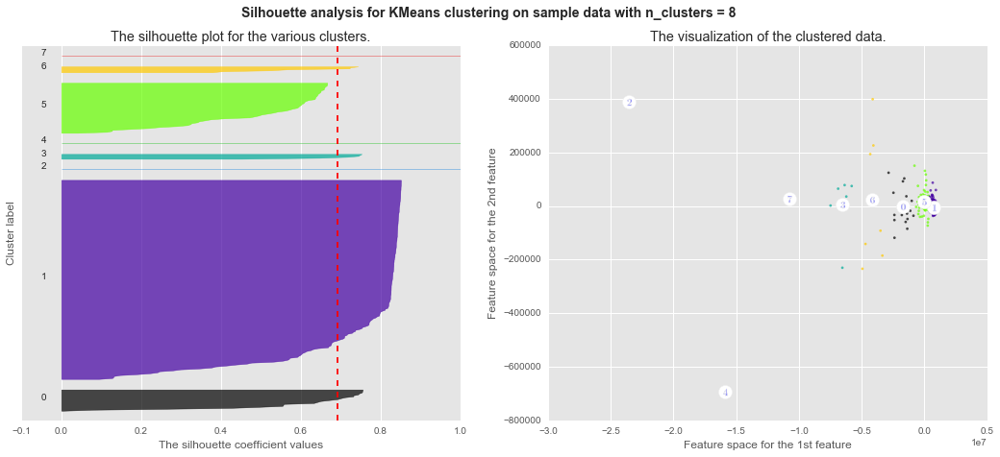

********************
Number of Components for PCA: 29
For n_clusters = 9 The average silhouette_score is : 0.655873920126


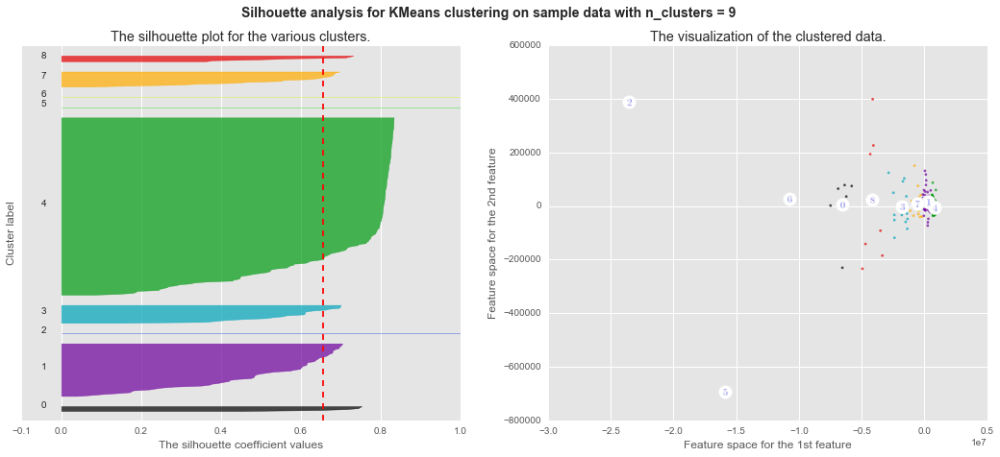

********************
Number of Components for PCA: 29
For n_clusters = 10 The average silhouette_score is : 0.617198776124


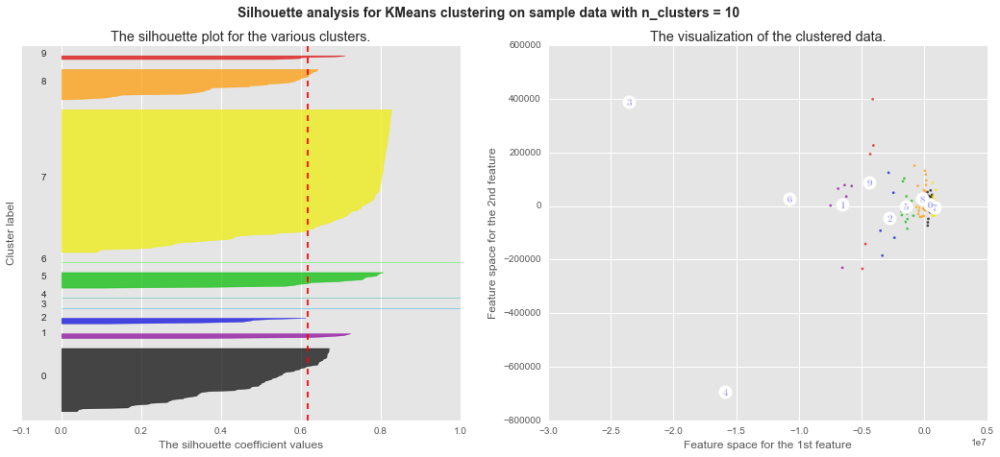

********************
Number of Components for PCA: 29
For n_clusters = 11 The average silhouette_score is : 0.615027098346


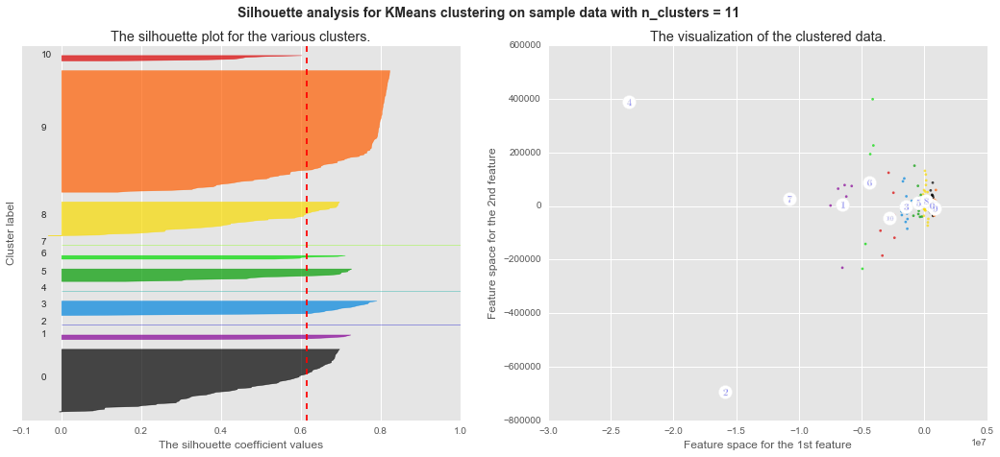

********************
Number of Components for PCA: 29
For n_clusters = 12 The average silhouette_score is : 0.615833396187


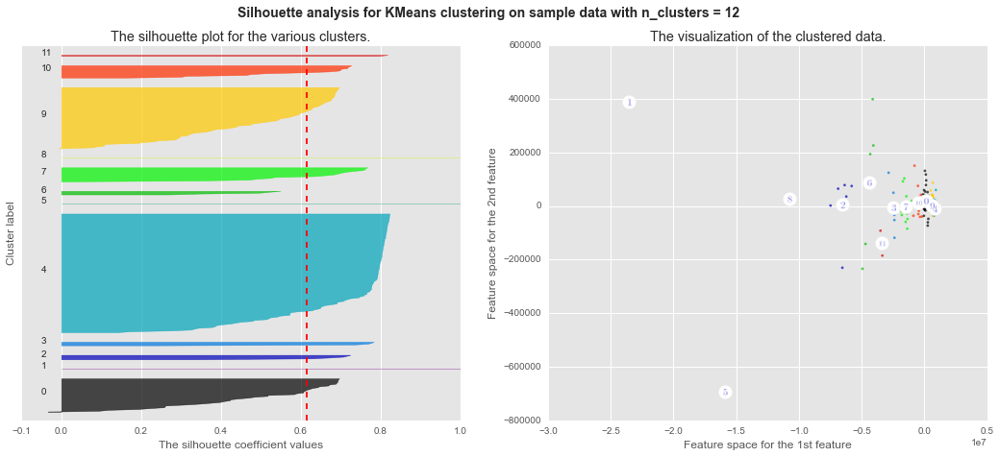

********************
Number of Components for PCA: 29
For n_clusters = 13 The average silhouette_score is : 0.610156346632


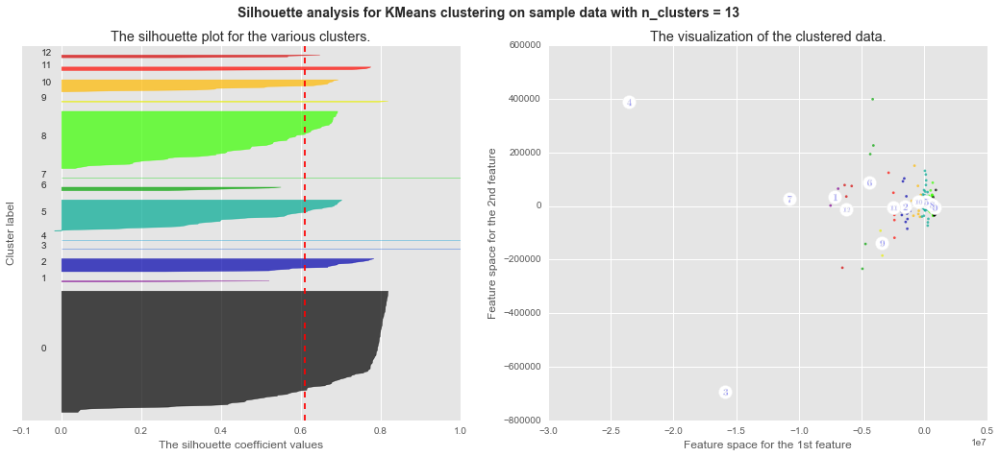

********************
Number of Components for PCA: 29
For n_clusters = 14 The average silhouette_score is : 0.595276164056


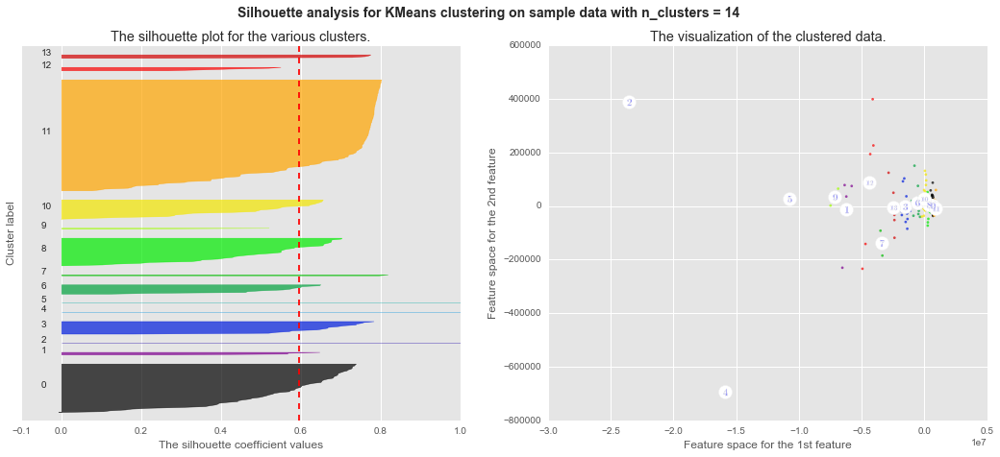

********************
Number of Components for PCA: 29
For n_clusters = 15 The average silhouette_score is : 0.600433580769


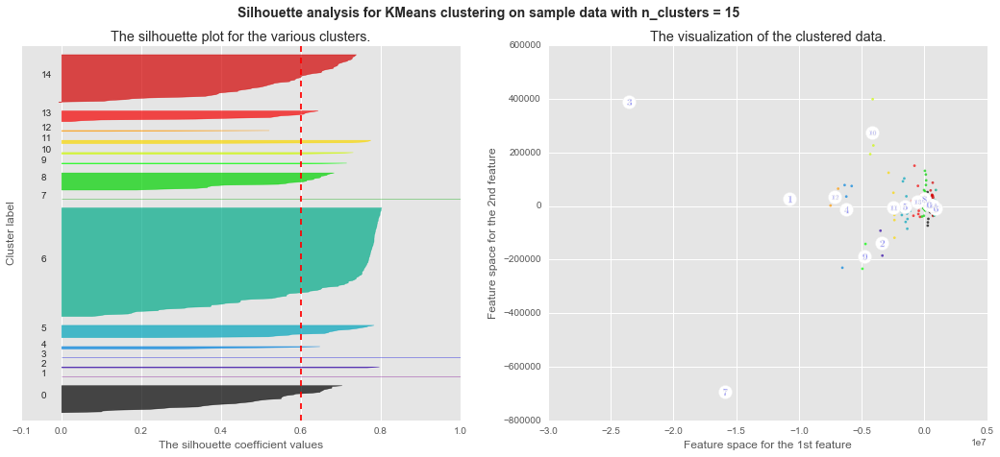

********************
Number of Components for PCA: 29
For n_clusters = 16 The average silhouette_score is : 0.582393380816


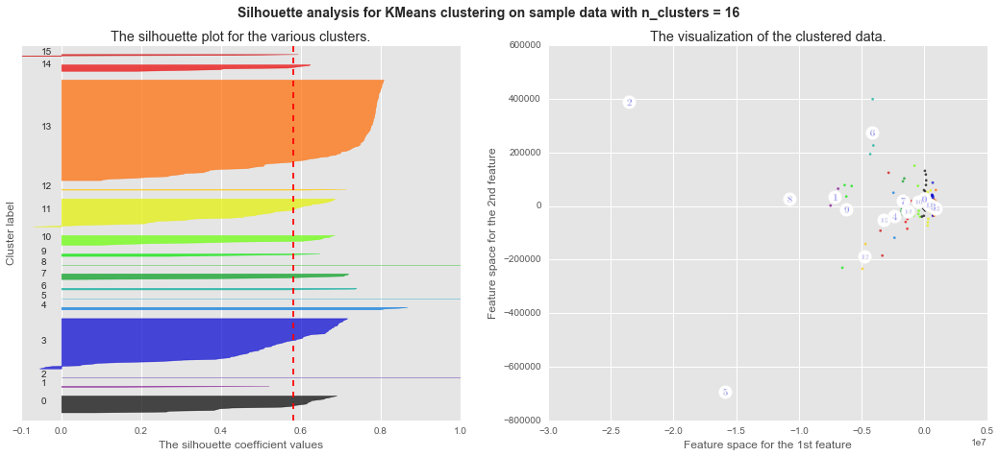

********************
Number of Components for PCA: 29
For n_clusters = 17 The average silhouette_score is : 0.538882520126


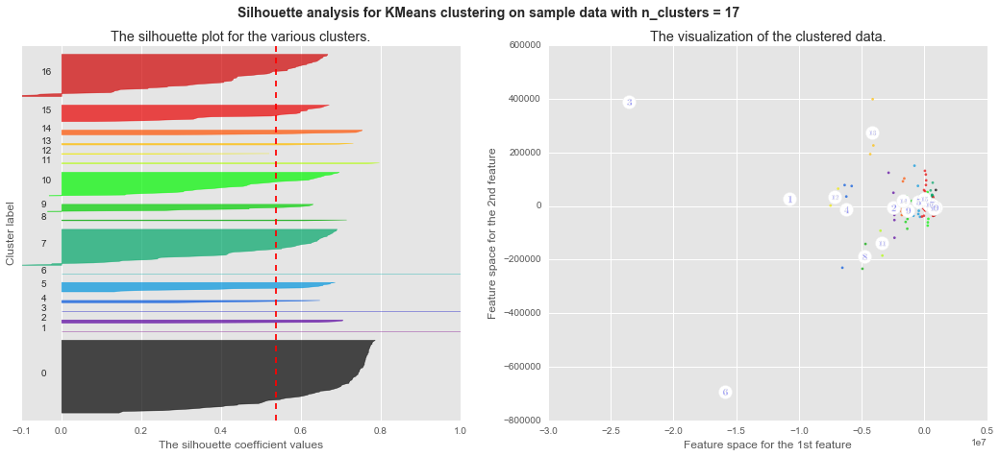

********************
Number of Components for PCA: 29
For n_clusters = 18 The average silhouette_score is : 0.54698103146


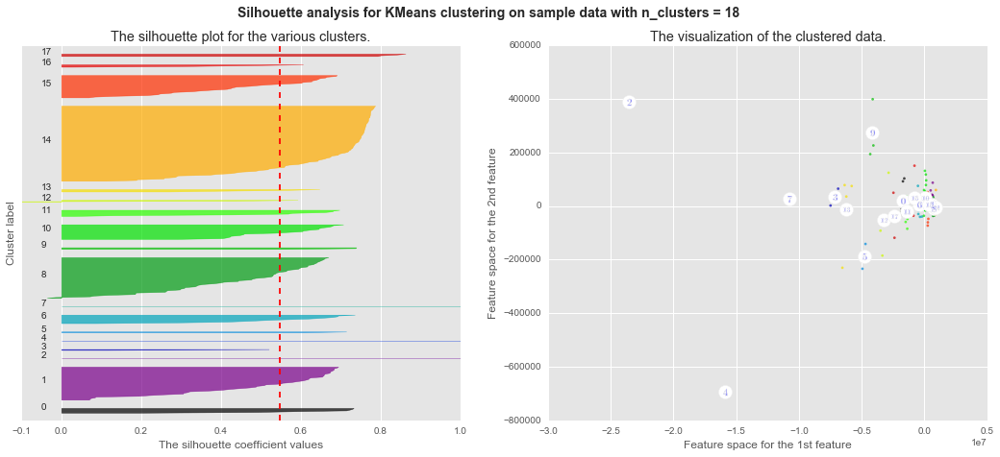

********************
Number of Components for PCA: 29
For n_clusters = 19 The average silhouette_score is : 0.552614741094


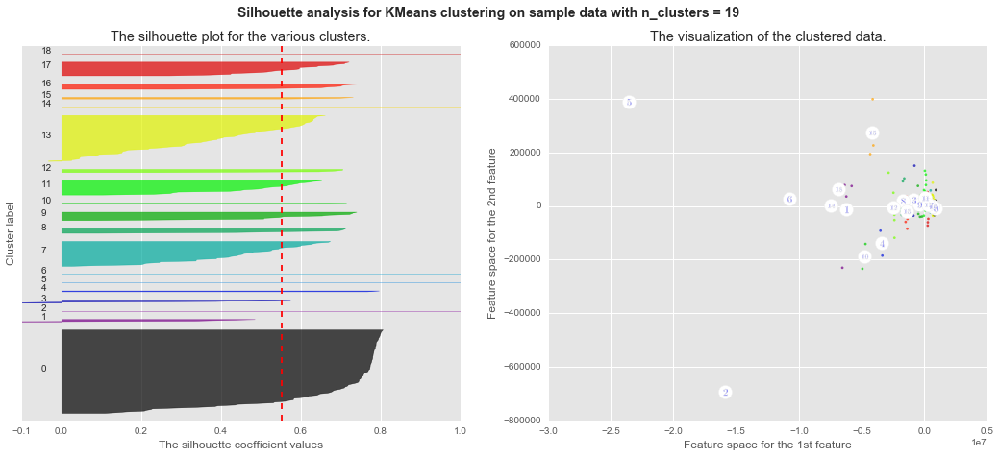

********************
Number of Components for PCA: 29
For n_clusters = 20 The average silhouette_score is : 0.539223600776


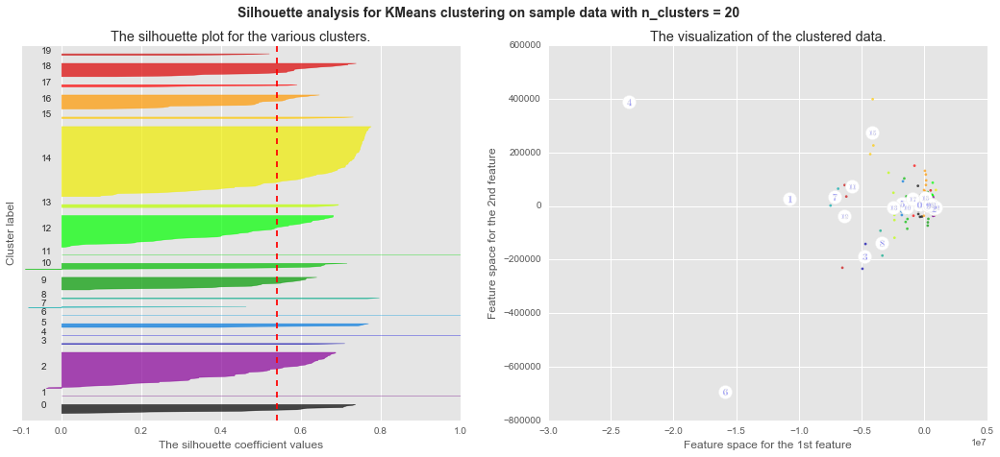

********************
Number of Components for PCA: 29
For n_clusters = 21 The average silhouette_score is : 0.524592603631


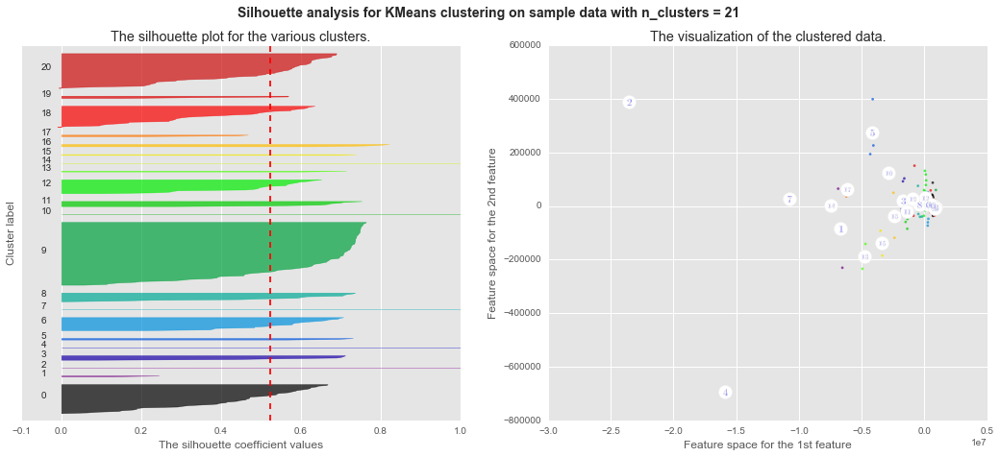

********************
Number of Components for PCA: 30
********************
********************
Number of Components for PCA: 30
For n_clusters = 4 The average silhouette_score is : 0.794910204585


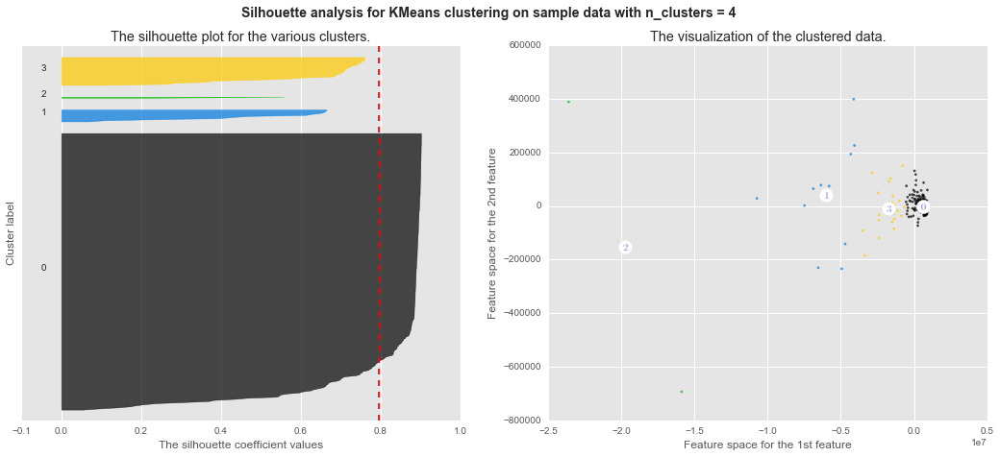

********************
Number of Components for PCA: 30
For n_clusters = 5 The average silhouette_score is : 0.79809589789


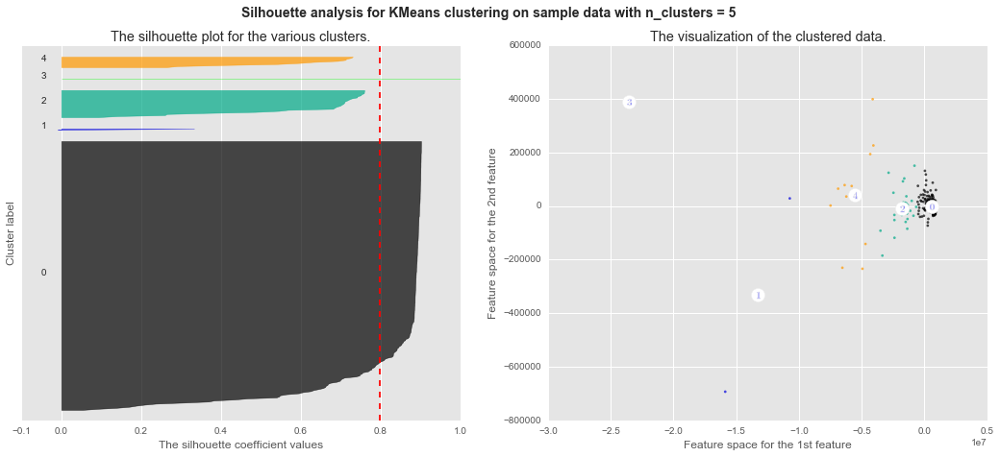

********************
Number of Components for PCA: 30
For n_clusters = 6 The average silhouette_score is : 0.683324545714


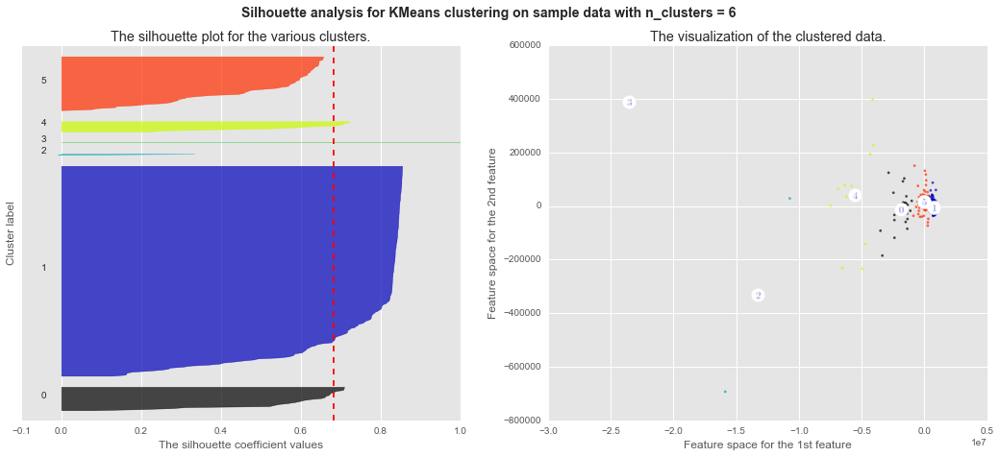

********************
Number of Components for PCA: 30
For n_clusters = 7 The average silhouette_score is : 0.688361932117


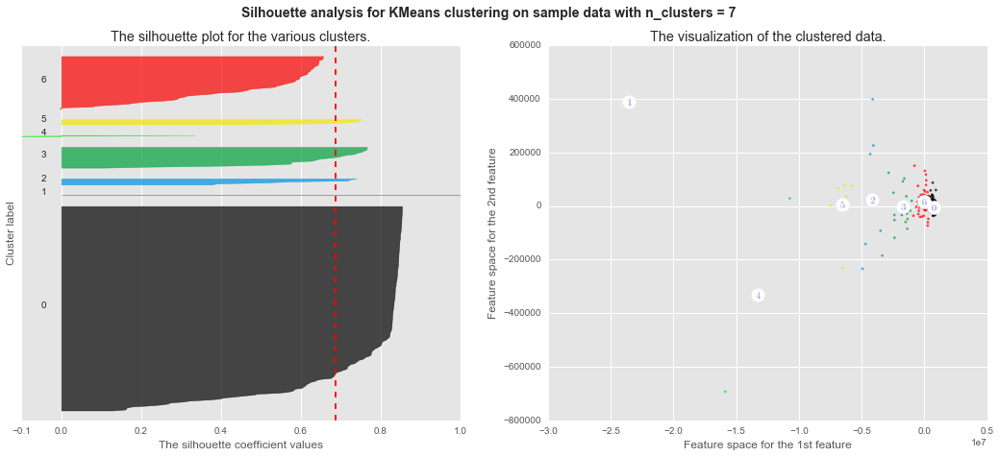

********************
Number of Components for PCA: 30
For n_clusters = 8 The average silhouette_score is : 0.692963481316


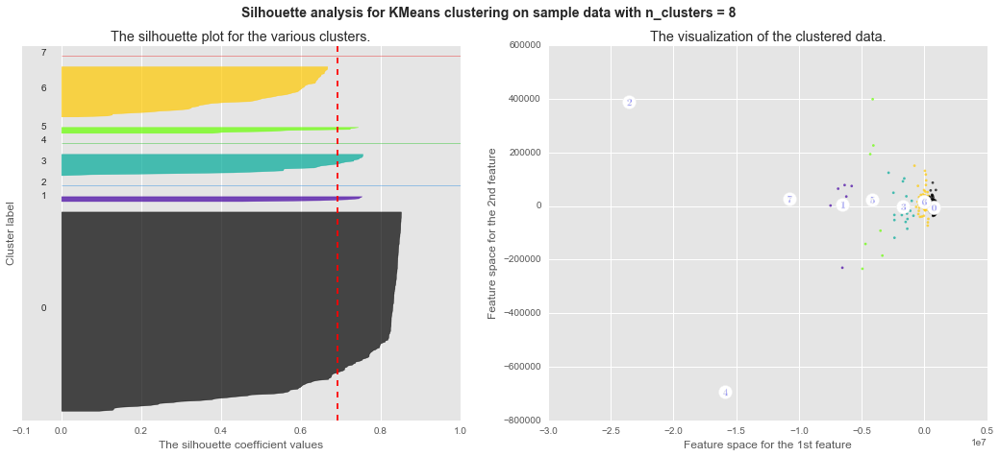

********************
Number of Components for PCA: 30
For n_clusters = 9 The average silhouette_score is : 0.655873920083


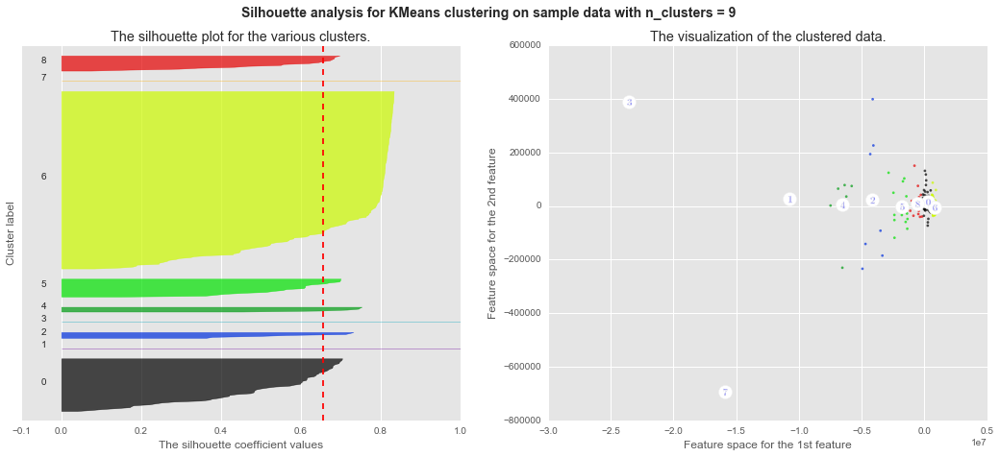

********************
Number of Components for PCA: 30
For n_clusters = 10 The average silhouette_score is : 0.617198776053


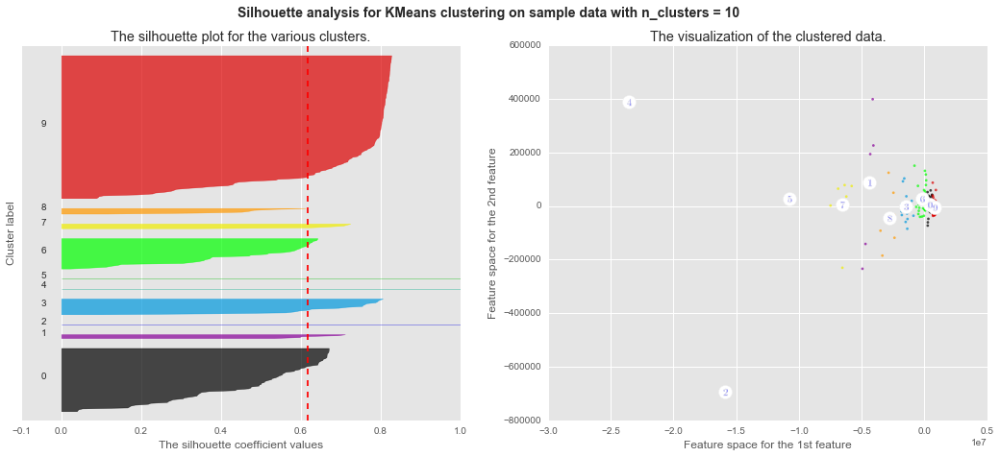

********************
Number of Components for PCA: 30
For n_clusters = 11 The average silhouette_score is : 0.615243083386


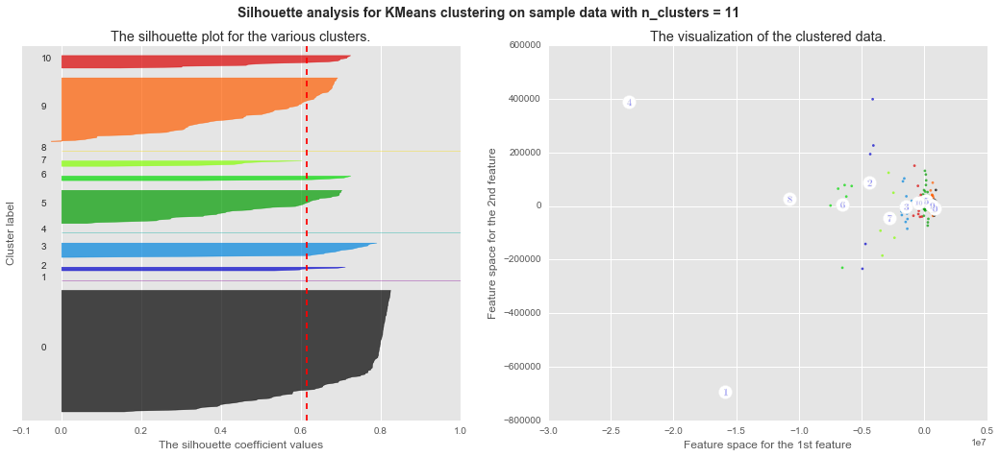

********************
Number of Components for PCA: 30
For n_clusters = 12 The average silhouette_score is : 0.614084660088


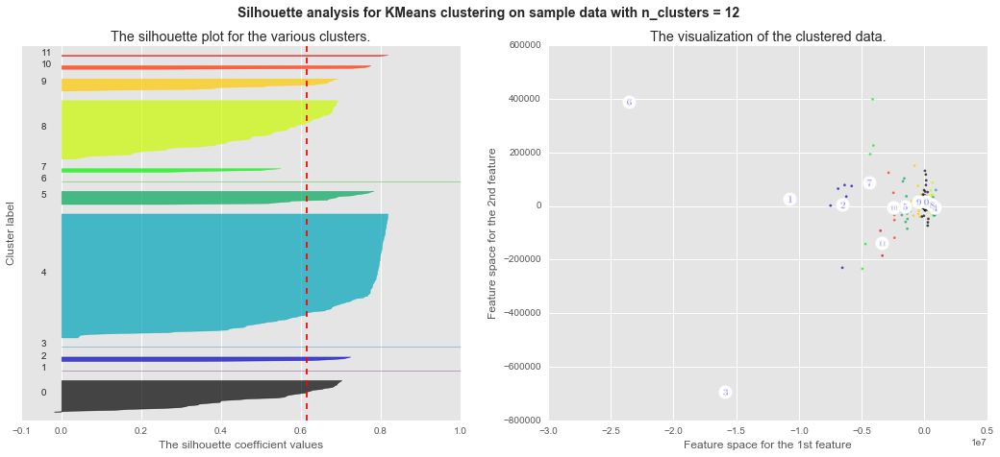

********************
Number of Components for PCA: 30
For n_clusters = 13 The average silhouette_score is : 0.611905082533


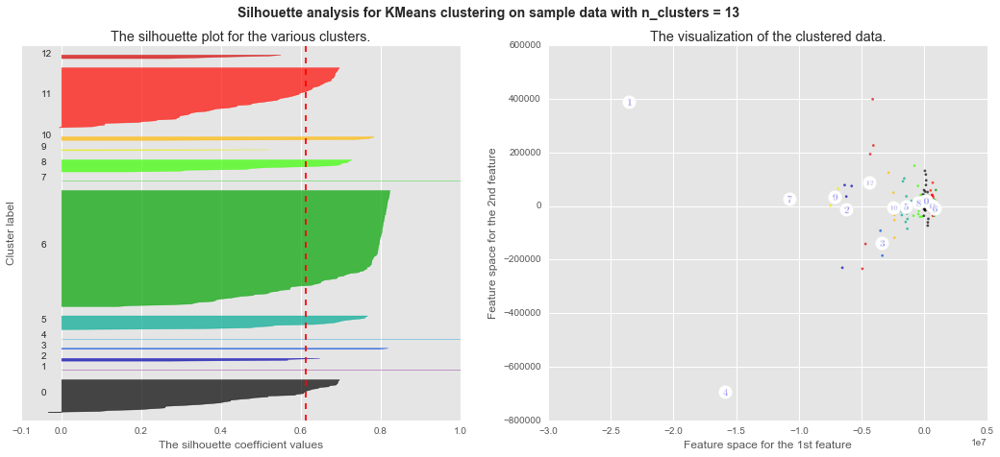

********************
Number of Components for PCA: 30
For n_clusters = 14 The average silhouette_score is : 0.596810450331


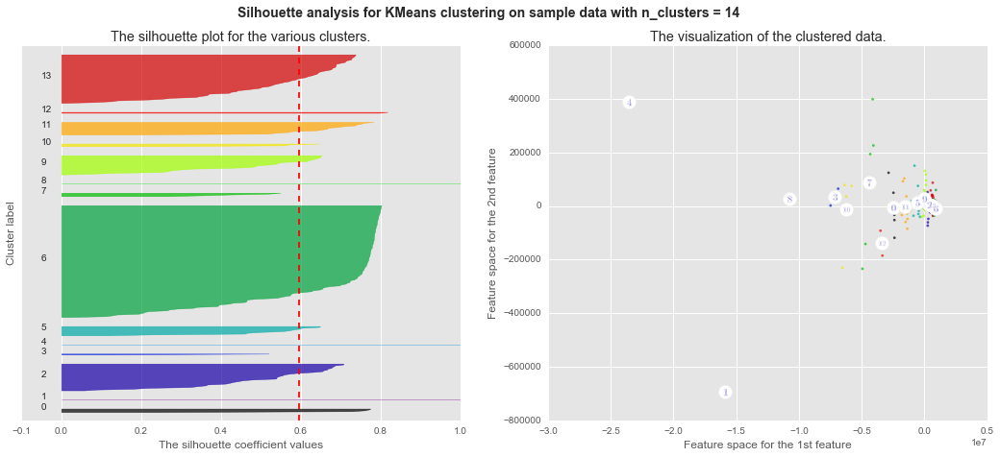

********************
Number of Components for PCA: 30
For n_clusters = 15 The average silhouette_score is : 0.596893135478


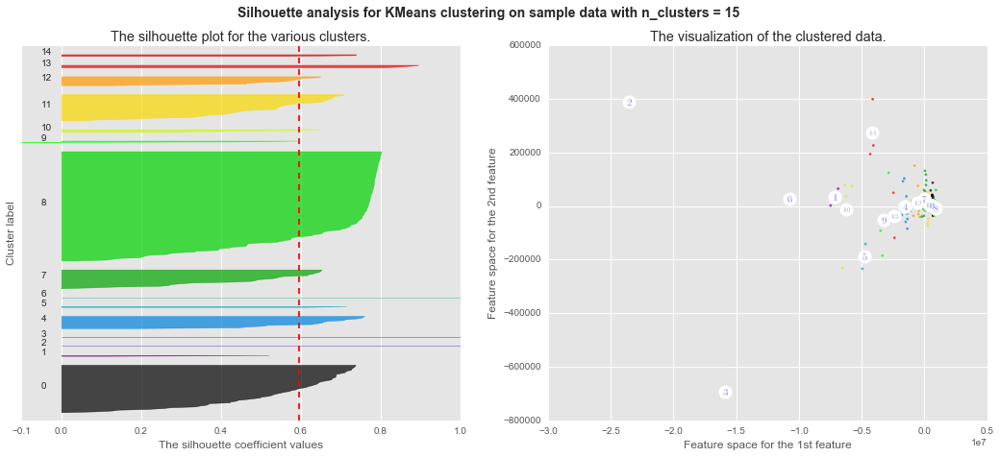

********************
Number of Components for PCA: 30
For n_clusters = 16 The average silhouette_score is : 0.578624870811


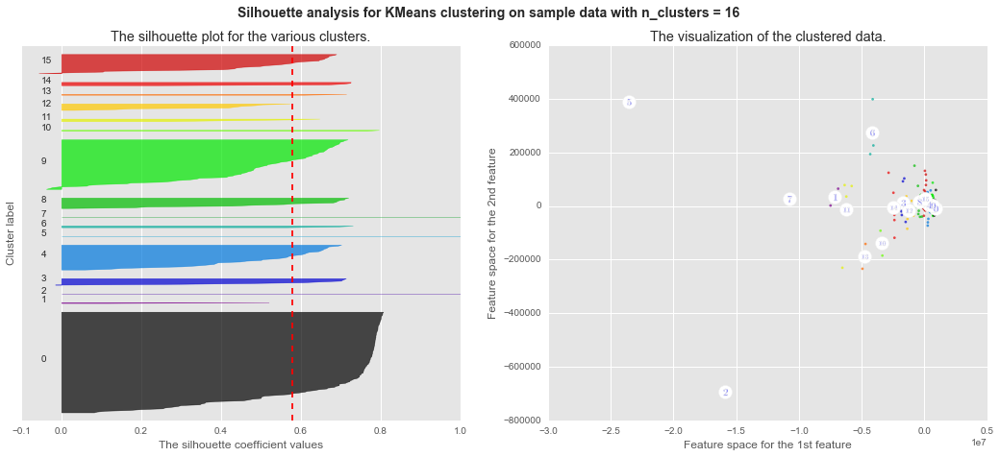

********************
Number of Components for PCA: 30
For n_clusters = 17 The average silhouette_score is : 0.595108696793


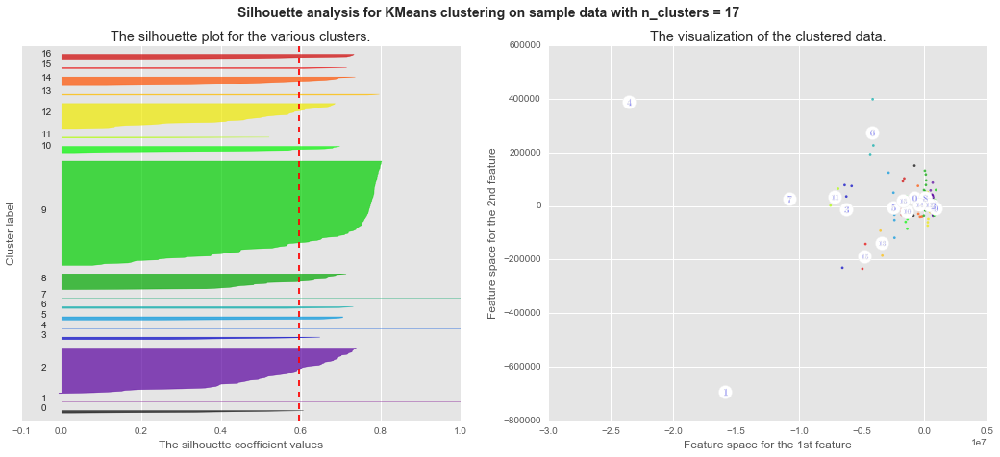

********************
Number of Components for PCA: 30
For n_clusters = 18 The average silhouette_score is : 0.549293229691


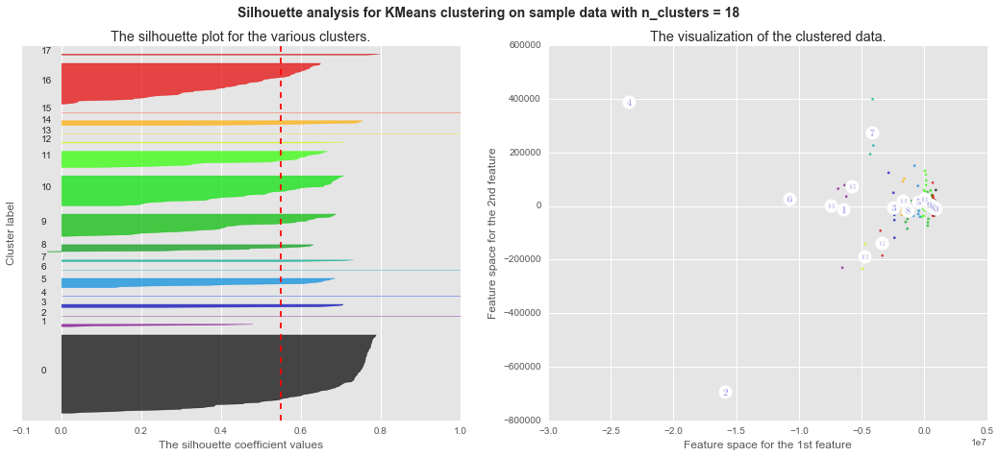

********************
Number of Components for PCA: 30
For n_clusters = 19 The average silhouette_score is : 0.538995791351


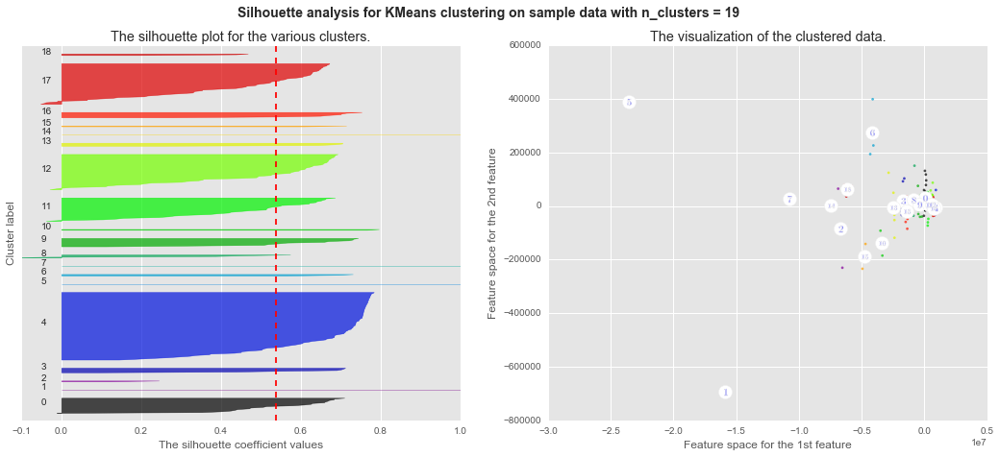

********************
Number of Components for PCA: 30
For n_clusters = 20 The average silhouette_score is : 0.543862063906


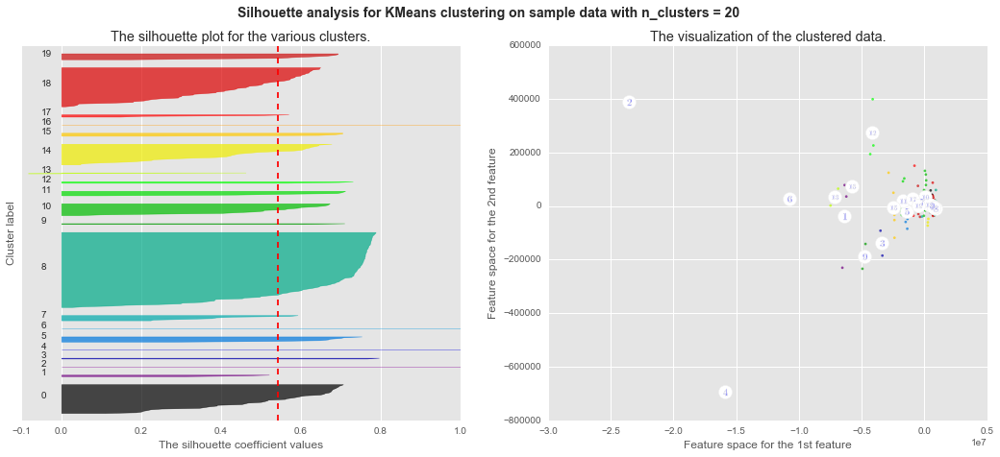

********************
Number of Components for PCA: 30
For n_clusters = 21 The average silhouette_score is : 0.535135304514


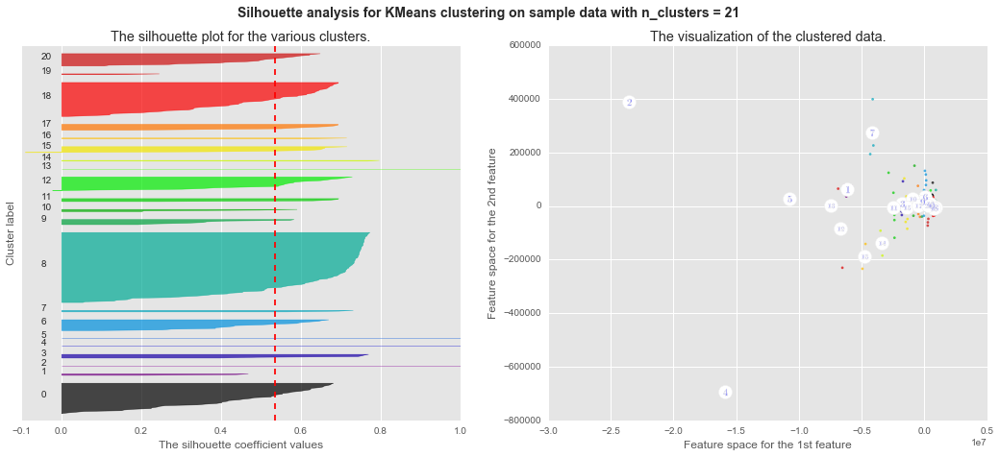

In [1448]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np



# Generating the sample data from make_blobs
# This particular setting has one distict cluster and 3 clusters placed close
# together.

range_n_components = range(11,31)

for n_components in range_n_components:
    print (20* '*')
    print ('Number of Components for PCA: %s' % (n_components))
    print (20* '*')
    pca = PCA(n_components = n_components)
    pca_features = pca.fit(featuresx).transform(featuresx)
    pca_features = pd.DataFrame(pca_features)

    features = pca_features
    features = features.values
    
    range_n_clusters = range(4, 22)

    for n_clusters in range_n_clusters:
        print (20* '*')
        print ('Number of Components for PCA: %s' % (n_components))
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(features) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, n_init = 12)
        cluster_labels = clusterer.fit_predict(features)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(features, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(features, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhoutte score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(features[:, 0], features[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors)

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1],
                    marker='o', c="white", alpha=1, s=200)

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50)

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

        plt.show()

## do silhouette scores and graph  again with best 3 from above

********************
Number of Components for PCA: 17
********************
********************
Number of Components for PCA: 17
For n_clusters = 16 The average silhouette_score is : 0.593464649356


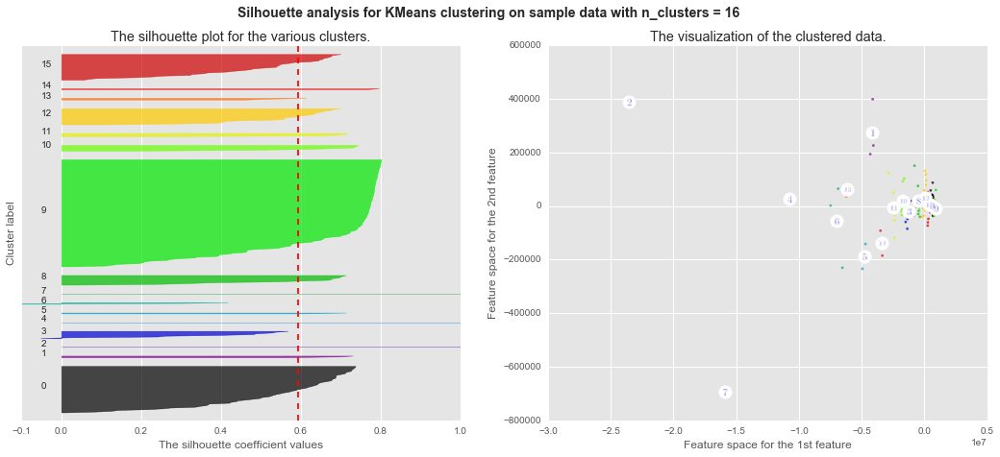

********************
Number of Components for PCA: 25
********************
********************
Number of Components for PCA: 25
For n_clusters = 16 The average silhouette_score is : 0.596540133512


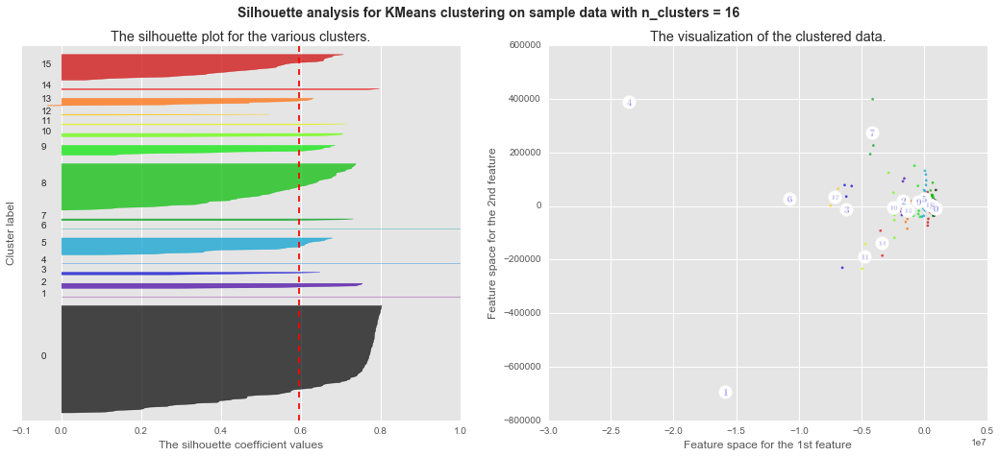

********************
Number of Components for PCA: 28
********************
********************
Number of Components for PCA: 28
For n_clusters = 16 The average silhouette_score is : 0.595826490986


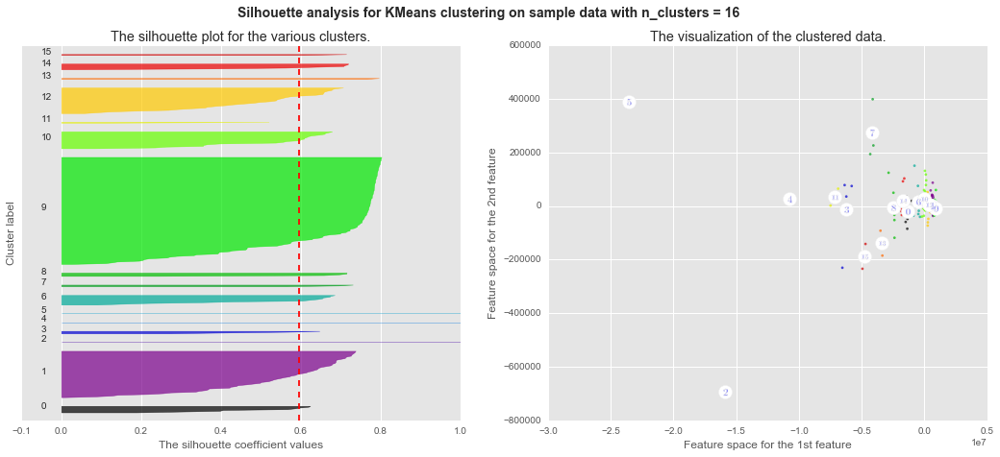

In [1449]:
from __future__ import print_function

from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np



# Generating the sample data from make_blobs
# This particular setting has one distict cluster and 3 clusters placed close
# together.

range_n_components = [17, 25, 28]

for n_components in range_n_components:
    print (20* '*')
    print ('Number of Components for PCA: %s' % (n_components))
    print (20* '*')
    pca = PCA(n_components = n_components)
    pca_features = pca.fit(featuresx).transform(featuresx)
    pca_features = pd.DataFrame(pca_features)

    features = pca_features
    features = features.values
    
    range_n_clusters = [16]

    for n_clusters in range_n_clusters:
        print (20* '*')
        print ('Number of Components for PCA: %s' % (n_components))
        # Create a subplot with 1 row and 2 columns
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(features) + (n_clusters + 1) * 10])

        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, n_init = 12)
        cluster_labels = clusterer.fit_predict(features)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(features, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(features, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhoutte score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # 2nd Plot showing the actual clusters formed
        colors = cm.spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(features[:, 0], features[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors)

        # Labeling the clusters
        centers = clusterer.cluster_centers_
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1],
                    marker='o', c="white", alpha=1, s=200)

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50)

        ax2.set_title("The visualization of the clustered data.")
        ax2.set_xlabel("Feature space for the 1st feature")
        ax2.set_ylabel("Feature space for the 2nd feature")

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

        plt.show()

# PART 3: FINAL CLUSTER MODEL CHOSEN



### CHOOSE COMPONENT NUMBER

### CHOOSE CLUSTER NUMBER

number of clusters = 16

number PCA components = 25

### Insert component numbr chosen below 

In [15]:
n_components = 25
pca = PCA(n_components = n_components)
pca_features = pca.fit(featuresx).transform(featuresx)
pca_features = pd.DataFrame(pca_features)



In [17]:
features = pca_features
features = features.values

### Insert chosen cluster number into 'k' below 

In [1452]:
k = 16
cluster = KMeans(init='k-means++', n_clusters=k, n_init=12)
cluster.fit(features)

KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=16, n_init=12,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

# Part 4 : Final Cluster metrics 

In [1453]:
print ('FINAL MODEL METRICS')


print ('Number of Components for PCA: %s' % (n_components))
print (20* '*')

for n_clusters in range_n_clusters:
    print ('number of clusters: %d' % (n_clusters))
    print ('% 9s' % 'name'
          ' time  silhouettescore')


    def bench_clustering(estimator, name, data):
        t0 = time()
        estimator.fit(data)
        print('% 9s   %.2fs    %.3f'
          % (name, (time() - t0), 
             metrics.silhouette_score(data, estimator.labels_)))

    bench_clustering(cluster,name="k-means", data=features)

FINAL MODEL METRICS
Number of Components for PCA: 25
********************
number of clusters: 16
name time  silhouettescore
  k-means   0.14s    0.594


##### SILHOUETTE ANALYSIS
* note that scattor plot is for 1st and second feature of the PCA features only


In [ ]:

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.set_size_inches(18, 7)

# The 1st subplot is the silhouette plot
# The silhouette coefficient can range from -1, 1 but in this example all
# lie within [-0.1, 1]
ax1.set_xlim([-0.1, 1])
# The (n_clusters+1)*10 is for inserting blank space between silhouette
# plots of individual clusters, to demarcate them clearly.
ax1.set_ylim([0, len(features) + (n_clusters + 1) * 10])

# Initialize the clusterer with n_clusters value and a random generator
# seed of 10 for reproducibility.
clusterer = cluster
cluster_labels = clusterer.fit_predict(features)

# The silhouette_score gives the average value for all the samples.
# This gives a perspective into the density and separation of the formed
# clusters
silhouette_avg = silhouette_score(features, cluster_labels)
print("For n_clusters =", n_clusters,
      "The average silhouette_score is :", silhouette_avg)

# Compute the silhouette scores for each sample
sample_silhouette_values = silhouette_samples(features, cluster_labels)

y_lower = 10
for i in range(n_clusters):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = \
        sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.spectral(float(i) / n_clusters)
    ax1.fill_betweenx(np.arange(y_lower, y_upper),
                      0, ith_cluster_silhouette_values,
                      facecolor=color, edgecolor=color, alpha=0.7)

    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("The silhouette coefficient values")
ax1.set_ylabel("Cluster label")

# The vertical line for average silhoutte score of all the values
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

# 2nd Plot showing the actual clusters formed
colors = cm.spectral(cluster_labels.astype(float) / n_clusters)
ax2.scatter(features[:, 0], features[:, 1], marker='.', s=30, lw=0, alpha=0.7,
            c=colors)

# Labeling the clusters
centers = clusterer.cluster_centers_
# Draw white circles at cluster centers
ax2.scatter(centers[:, 0], centers[:, 1],
            marker='o', c="white", alpha=1, s=200)

for i, c in enumerate(centers):
    ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50)

ax2.set_title("The visualization of the clustered data.")
ax2.set_xlabel("Feature space for the 1st feature")
ax2.set_ylabel("Feature space for the 2nd feature")

plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
              "with n_clusters = %d" % n_clusters),
             fontsize=14, fontweight='bold')

plt.show()

# Part 5:  Assignment of cluster to MSA

In [1455]:
cluster_assigned = cluster.fit_predict(features)

# Part 6: Final Cluster Plotting

In [1456]:
labels = cluster.labels_
centroids = cluster.cluster_centers_
 ## turns into scaled array


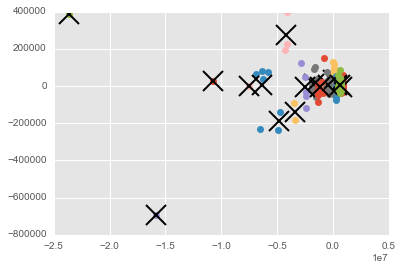

In [1457]:
from matplotlib import pyplot
import numpy as np

for i in range(k):
    # select only data observations with cluster label == i
    ds = features[np.where(labels==i)]
    # plot the data observations
    pyplot.plot(ds[:,0],ds[:,1],'o')
    # plot the centroids
    lines = pyplot.plot(centroids[i,0],centroids[i,1],'kx')
    # make the centroid x's bigger
    pyplot.setp(lines,ms=20.0)
    pyplot.setp(lines,mew=2.0)
pyplot.show()
## find out how to make the graph plane field bigger

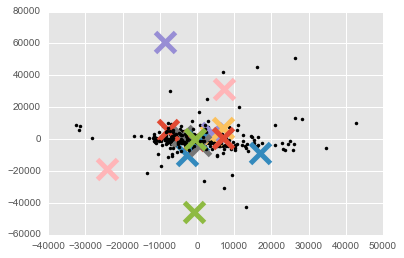

In [1458]:
import matplotlib.pyplot as plt
import numpy as np

for i in range(16):
    # Plot the points. Hint: Try using principal component analysis (PCA) to narrow down features.
    datapoints = features[np.where(labels==i)]
    plt.plot(datapoints[:,3],datapoints[:,4],'k.')
    # Plot the centroids.
    centers = plt.plot(centroids[i,3],centroids[i,4],'x')
    plt.setp(centers,markersize=20.0)
    plt.setp(centers,markeredgewidth=5.0)
plt.show()

# Part 7: Computing Cluster Distances of features from centroid of cluster
* using scipy euclidean distance; calculate distance of the point of features in the 25 dimensions from the centroids which is also in 25 dimensions
* saved features and distances of an instances in a csv, just in case (cluster_feat_distances.csv)
* also saved cbsa name with corresponding distance and cluster in csv, just in case (cluster_distance.csv)



#### get cluster location and put in dataframe with corresponding cluster number

In [1459]:
center = cluster.cluster_centers_
centroids_all = pd.DataFrame(center)

In [1460]:
centroids_all['cluster'] = range(0, len(center))

#### create a dataframe that has all location of instances with corresponding cluster number

In [1461]:
features_all = pd.DataFrame(features)


In [1462]:
features_all['cluster'] = cluster_assigned

In [1463]:
features_all.to_csv('features_cluster.csv')

#### merge features_all and centroids_all on cluster number so that we can easily calcuate the euclidean distance by row 

In [1464]:
cluster_distance = pd.merge(features_all, centroids_all, on = 'cluster', how = 'left')

In [1465]:
cluster_distance.columns.values

array(['0_x', '1_x', '2_x', '3_x', '4_x', '5_x', '6_x', '7_x', '8_x',
       '9_x', '10_x', '11_x', '12_x', '13_x', '14_x', '15_x', '16_x',
       '17_x', '18_x', '19_x', '20_x', '21_x', '22_x', '23_x', '24_x',
       'cluster', '0_y', '1_y', '2_y', '3_y', '4_y', '5_y', '6_y', '7_y',
       '8_y', '9_y', '10_y', '11_y', '12_y', '13_y', '14_y', '15_y',
       '16_y', '17_y', '18_y', '19_y', '20_y', '21_y', '22_y', '23_y',
       '24_y'], dtype=object)

#### calcuate euclidean distance
* this will compute distance and put it in a new column corresponding to row of instance.
* then that new column is added to the existing dataframe

In [1466]:
new_column = []

for index,row in cluster_distance.iterrows():
    feat_0 = row['0_x']
    feat_1 = row['1_x']
    feat_2 = row['2_x']
    feat_3 = row['3_x']
    feat_4 = row['4_x']
    feat_5 = row['5_x']
    feat_6 = row['6_x']
    feat_7 = row['7_x']
    feat_8 = row['8_x']
    feat_9 = row['9_x']
    feat_10 = row['10_x']
    feat_11 = row['11_x']
    feat_12 = row['12_x']
    feat_13 = row['13_x']
    feat_14 = row['14_x']
    feat_15 = row['15_x']
    feat_16 = row['16_x']
    feat_17 = row['17_x']
    feat_18 = row['18_x']
    feat_19 = row['19_x']
    feat_20 = row['20_x']
    feat_21 = row['21_x']
    feat_22 = row['22_x']
    feat_23 = row['23_x']
    feat_24 = row['24_x']
    cent_0 = row['0_y']
    cent_1 = row['1_y']
    cent_2 = row['2_y']
    cent_3 = row['3_y']
    cent_4 = row['4_y']
    cent_5 = row['5_y']
    cent_6 = row['6_y']
    cent_7 = row['7_y']
    cent_8 = row['8_y']
    cent_9 = row['9_y']
    cent_10 = row['10_y']
    cent_11 = row['11_y']
    cent_12 = row['12_y']
    cent_13 = row['13_y']
    cent_14 = row['14_y']
    cent_15 = row['15_y']
    cent_16 = row['16_y']
    cent_17 = row['17_y']
    cent_18 = row['18_y']
    cent_19 = row['19_y']
    cent_20 = row['20_y']
    cent_21 = row['21_y']
    cent_22 = row['22_y']
    cent_23 = row['23_y']
    cent_24 = row['24_y']
    
    warnings.filterwarnings('ignore')
    value = eucl([feat_0,feat_1,feat_2,feat_3,feat_4,feat_5,feat_6,feat_7,feat_8,feat_9,feat_10,feat_11,feat_12,feat_13, 
                  feat_14,feat_15,feat_16,feat_17,feat_18,feat_19,feat_20,feat_21,feat_22,feat_23,feat_24], 
                 [cent_0,cent_1,cent_2,cent_3,cent_4,cent_5,cent_6,cent_7,cent_8,cent_9,cent_10,cent_11,cent_12,cent_13, 
                  cent_14,cent_15,cent_16,cent_17,cent_18,cent_19,cent_20,cent_21,cent_22,cent_23,cent_24])  #get the distance
    new_column.append(value)   #append the empty list with distance values

cluster_distance.insert(51,"distance",new_column)

In [1467]:
cluster_distance.head(10).columns.values

array(['0_x', '1_x', '2_x', '3_x', '4_x', '5_x', '6_x', '7_x', '8_x',
       '9_x', '10_x', '11_x', '12_x', '13_x', '14_x', '15_x', '16_x',
       '17_x', '18_x', '19_x', '20_x', '21_x', '22_x', '23_x', '24_x',
       'cluster', '0_y', '1_y', '2_y', '3_y', '4_y', '5_y', '6_y', '7_y',
       '8_y', '9_y', '10_y', '11_y', '12_y', '13_y', '14_y', '15_y',
       '16_y', '17_y', '18_y', '19_y', '20_y', '21_y', '22_y', '23_y',
       '24_y', 'distance'], dtype=object)

In [1468]:
cluster_distance.head()

,0_x,1_x,2_x,3_x,4_x,5_x,6_x,7_x,8_x,9_x,...,16_y,17_y,18_y,19_y,20_y,21_y,22_y,23_y,24_y,distance
0,-2.359721e+07,388671.823243,216001.155843,-798.046351,-45681.629327,-14606.395819,-81.529636,94.613047,-12.738274,88.227929,...,-2.432053,-4.166191,2.330391,1.307745,-2.783344,1.054845,-3.048246,0.704423,0.681401,0.000000
1,-1.588039e+07,-693254.838043,146420.522711,-8646.772148,61081.045199,12192.926583,225.187086,189.197966,-178.522036,17.276668,...,10.440871,-0.975446,3.932128,4.230337,-2.986215,-0.390968,-0.560501,-0.702888,-0.259441,0.000000
2,-1.073320e+07,28422.272682,-13668.178922,-7855.074051,5720.795211,30305.597024,-708.205387,541.060411,-54.008981,-63.855496,...,-2.148035,-5.556304,-2.578220,-2.641663,7.564142,-0.323215,0.449456,0.004900,-1.844827,0.000000
3,-7.484877e+06,1573.994149,-250356.464900,-24268.960635,-18585.910268,-2475.816857,-1262.973933,-123.866648,398.051893,18.990484,...,0.865232,-15.244582,8.198086,1.802836,10.766570,0.214658,1.144150,0.595372,0.135112,0.000000
4,-6.877704e+06,64577.271553,-169128.957884,-7102.603745,9233.848585,-17421.790746,-597.162687,-357.059989,-105.515749,-44.899871,...,-3.572956,-2.094821,-2.262651,1.471050,1.584798,-0.573060,2.941821,-0.296824,1.015166,533747.839921


#### save featuress and distances of an instances into a csv


In [1469]:
cluster_distance.to_csv('cluster_feat_distances.csv')

In [1470]:
cluster_distance= cluster_distance[['cluster', 'distance']]

In [1471]:
cluster_distance.head()

,cluster,distance
0,5,0.000000
1,2,0.000000
2,7,0.000000
3,13,0.000000
4,1,533747.839921


In [1472]:
cluster_distance['cbsa'] = indicators['cbsa']

In [1473]:
cluster_distance['msa_name'] = indicators['msa_name']

In [1474]:
cluster_distance.head()

,cluster,distance,cbsa,msa_name
0,5,0.000000,35620,New York-Newark-Jersey City NY-NJ-PA Metro Are...
1,2,0.000000,31080,Los Angeles-Long Beach-Anaheim CA Metro Area ...
2,7,0.000000,16980,Chicago-Naperville-Elgin IL-IN-WI Metro Area ...
3,13,0.000000,19100,Dallas-Fort Worth-Arlington TX Metro Area ...
4,1,533747.839921,26420,Houston-The Woodlands-Sugar Land TX Metro Area...


In [1475]:
cluster_distance.to_csv('cluster_distances.csv')

# PART 8: Subsetting by clusters to find the closest MSAs to the centroids 

* This will be done using the calcuated distance in Part 6
* each cluster subset  
 * will be sorted by distance
 * select  only the top five MSA's which has the smallest distance (some clusters have less than five)
 * select only the 'msa_name' column
 * remove excess spaces using regular expressions
 * put all msa names in one string
* create a new dictionary
 * cluster number as key
 * names of msas closest to string as the value
* save cluster and msa name values into csv (MSA_by_cluster.csv)

#### check count

In [1476]:
cluster_msa_count = cluster_distance[['cluster','msa_name']].groupby(['cluster']).count().reset_index()
print (cluster_msa_count)

    cluster  msa_name
0         0       134
1         1         5
2         2         1
3         3        11
4         4        21
5         5         1
6         6         3
7         7         1
8         8        33
9         9         5
10       10        13
11       11         2
12       12        59
13       13         1
14       14         8
15       15         2


#### create subsets by cluster using dictionary

In [1477]:
cluster_range = range(0,16)
clust = {}

for c in cluster_range:
    cl = cluster_distance[cluster_distance['cluster'] == c]
    clust[c] = pd.DataFrame(cl)


#### convert dictionary entries into single dataframes


In [1478]:
warnings.filterwarnings('ignore')
cluster_0 = clust[0]
cluster_1 = clust[1]
cluster_2 = clust[2]
cluster_3 = clust[3]
cluster_4 = clust[4]
cluster_5 = clust[5]
cluster_6 = clust[6]
cluster_7 = clust[7]
cluster_8 = clust[8]
cluster_9 = clust[9]
cluster_10 = clust[10]
cluster_11 = clust[11]
cluster_12 = clust[12]
cluster_13 = clust[13]
cluster_14 = clust[14]
cluster_15 = clust[15]



In [1479]:
# check cluster_0.head()

#### sort subsets by distance in ascending order

In [1480]:
warnings.filterwarnings('ignore')
cluster_0 = cluster_0.sort('distance', ascending=True)
cluster_1 = cluster_1.sort('distance', ascending=True)
cluster_2 = cluster_2.sort('distance', ascending=True)
cluster_3 = cluster_3.sort('distance', ascending=True)
cluster_4 = cluster_4.sort('distance', ascending=True)
cluster_5 = cluster_5.sort('distance', ascending=True)
cluster_6 = cluster_6.sort('distance', ascending=True)
cluster_7 = cluster_7.sort('distance', ascending=True)
cluster_8 = cluster_8.sort('distance', ascending=True)
cluster_9 = cluster_9.sort('distance', ascending=True)
cluster_10 = cluster_10.sort('distance', ascending=True)
cluster_11 = cluster_11.sort('distance', ascending=True)
cluster_12 = cluster_12.sort('distance', ascending=True)
cluster_13 = cluster_13.sort('distance', ascending=True)
cluster_14 = cluster_14.sort('distance', ascending=True)
cluster_15 = cluster_15.sort('distance', ascending=True)



In [1481]:
cluster_0.head()

,cluster,distance,cbsa,msa_name
224,0,7308.361801,40980,Saginaw MI Metro Area ...
225,0,7548.757394,25900,Hilo HI Micro Area ...
229,0,8483.362195,23580,Gainesville GA Metro Area ...
227,0,8552.306544,37460,Panama City FL Metro Area ...
221,0,9378.564363,19300,Daphne-Fairhope-Foley AL Metro Area ...


#### select top 5 if more than 5 msa in cluster using

In [1482]:
cluster_0 = cluster_0.head(5)
cluster_1 = cluster_1.head(5)
cluster_2 = cluster_2.head(5)
cluster_3 = cluster_3.head(5)
cluster_4 = cluster_4.head(5)
cluster_5 = cluster_5.head(5)
cluster_6 = cluster_6.head(5)
cluster_7 = cluster_7.head(5)
cluster_8 = cluster_8.head(5)
cluster_9 = cluster_9.head(5)
cluster_10 = cluster_10.head(5)
cluster_11 = cluster_11.head(5)
cluster_12 = cluster_12.head(5)
cluster_13 = cluster_13.head(5)
cluster_14 = cluster_14.head(5)
cluster_15 = cluster_15.head(5)


In [1483]:
#check 
cluster_15

,cluster,distance,cbsa,msa_name
9,15,133179.277088,14460,Boston-Cambridge-Newton MA-NH Metro Area ...
10,15,133179.277088,41860,San Francisco-Oakland-Hayward CA Metro Area ...


####  subset of each cluster  with msa name oly

In [1484]:
cluster_0 = cluster_0['msa_name']
cluster_1 = cluster_1['msa_name']
cluster_2 = cluster_2['msa_name']
cluster_3 = cluster_3['msa_name']
cluster_4 = cluster_4['msa_name']
cluster_5 = cluster_5['msa_name']
cluster_6 = cluster_6['msa_name']
cluster_7 = cluster_7['msa_name']
cluster_8 = cluster_8['msa_name']
cluster_9 = cluster_9['msa_name']
cluster_10 = cluster_10['msa_name']
cluster_11 = cluster_11['msa_name']
cluster_12 = cluster_12['msa_name']
cluster_13 = cluster_13['msa_name']
cluster_14 = cluster_14['msa_name']
cluster_15 = cluster_15['msa_name']


#### removes multiple space

In [1485]:
cluster_0 = cluster_0.replace(to_replace = ' +', value = ' ', regex=True)
cluster_1 = cluster_1.replace(to_replace = ' +', value = ' ', regex=True)
cluster_2 = cluster_2.replace(to_replace = ' +', value = ' ', regex=True)
cluster_3 = cluster_3.replace(to_replace = ' +', value = ' ', regex=True)
cluster_4 = cluster_4.replace(to_replace = ' +', value = ' ', regex=True)
cluster_5 = cluster_5.replace(to_replace = ' +', value = ' ', regex=True)
cluster_6 = cluster_6.replace(to_replace = ' +', value = ' ', regex=True)
cluster_7 = cluster_7.replace(to_replace = ' +', value = ' ', regex=True)
cluster_8 = cluster_8.replace(to_replace = ' +', value = ' ', regex=True)
cluster_9 = cluster_9.replace(to_replace = ' +', value = ' ', regex=True)
cluster_10 = cluster_10.replace(to_replace = ' +', value = ' ', regex=True)
cluster_11 = cluster_11.replace(to_replace = ' +', value = ' ', regex=True)
cluster_12 = cluster_12.replace(to_replace = ' +', value = ' ', regex=True)
cluster_13 = cluster_13.replace(to_replace = ' +', value = ' ', regex=True)
cluster_14 = cluster_14.replace(to_replace = ' +', value = ' ', regex=True)
cluster_15 = cluster_15.replace(to_replace = ' +', value = ' ', regex=True)


#### convert subset into list

In [1486]:
cluster_0 = cluster_0.tolist()
cluster_1 = cluster_1.tolist()
cluster_2 = cluster_2.tolist()
cluster_3 = cluster_3.tolist()
cluster_4 = cluster_4.tolist()
cluster_5 = cluster_5.tolist()
cluster_6 = cluster_6.tolist()
cluster_7 = cluster_7.tolist()
cluster_8 = cluster_8.tolist()
cluster_9 = cluster_9.tolist()
cluster_10 = cluster_10.tolist()
cluster_11 = cluster_11.tolist()
cluster_12 = cluster_12.tolist()
cluster_13 = cluster_13.tolist()
cluster_14 = cluster_14.tolist()
cluster_15 = cluster_15.tolist()


##### put list into 1 string

In [1487]:
# convert all values in cluster into a single string
cluster_0 = ', '.join(cluster_0)
cluster_1 = ', '.join(cluster_1)
cluster_2 = ', '.join(cluster_2)
cluster_3 = ', '.join(cluster_3)
cluster_4 = ', '.join(cluster_4)
cluster_5 = ', '.join(cluster_5)
cluster_6 = ', '.join(cluster_6)
cluster_7 = ', '.join(cluster_7)
cluster_8 = ', '.join(cluster_8)
cluster_9 = ', '.join(cluster_9)
cluster_10 = ', '.join(cluster_10)
cluster_11 = ', '.join(cluster_11)
cluster_12 = ', '.join(cluster_12)
cluster_13 = ', '.join(cluster_13)
cluster_14 = ', '.join(cluster_14)
cluster_15 = ', '.join(cluster_15)

#### create new dictionary for cluster as the key and the names of the msa as the value

In [1488]:
## create dictionary
MSA_per_cluster = {}

In [1489]:
MSA_per_cluster[0] = cluster_0
MSA_per_cluster[1] = cluster_1
MSA_per_cluster[2] = cluster_2
MSA_per_cluster[3] = cluster_3
MSA_per_cluster[4] = cluster_4
MSA_per_cluster[5] = cluster_5
MSA_per_cluster[6] = cluster_6
MSA_per_cluster[7] = cluster_7
MSA_per_cluster[8] = cluster_8
MSA_per_cluster[9] = cluster_9
MSA_per_cluster[10] = cluster_10
MSA_per_cluster[11] = cluster_11
MSA_per_cluster[12] = cluster_12
MSA_per_cluster[13] = cluster_13
MSA_per_cluster[14] = cluster_14
MSA_per_cluster[15] = cluster_15

In [1490]:
#check
MSA_per_cluster

{0: 'Saginaw MI Metro Area , Hilo HI Micro Area , Gainesville GA Metro Area , Panama City FL Metro Area , Daphne-Fairhope-Foley AL Metro Area ',
 1: 'Philadelphia-Camden-Wilmington PA-NJ-DE-MD Metro Area , Miami-Fort Lauderdale-West Palm Beach FL Metro Area , Washington-Arlington-Alexandria DC-VA-MD-WV Metro Area , Houston-The Woodlands-Sugar Land TX Metro Area , Atlanta-Sandy Springs-Roswell GA Metro Area ',
 2: 'Los Angeles-Long Beach-Anaheim CA Metro Area ',
 3: 'San Juan-Carolina-Caguas PR Metro Area , San Antonio-New Braunfels TX Metro Area , Sacramento--Roseville--Arden-Arcade CA Metro Area , Cincinnati OH-KY-IN Metro Area , Orlando-Kissimmee-Sanford FL Metro Area ',
 4: 'Greenville-Anderson-Mauldin SC Metro Area , Albuquerque NM Metro Area , Bakersfield CA Metro Area , Knoxville TN Metro Area , Oxnard-Thousand Oaks-Ventura CA Metro Area ',
 5: 'New York-Newark-Jersey City NY-NJ-PA Metro Area ',
 6: 'Detroit-Warren-Dearborn MI Metro Area , Riverside-San Bernardino-Ontario CA Metr

#### how to print dictionary values

In [1491]:
print (MSA_per_cluster[1].replace(", ", "\n"))

Philadelphia-Camden-Wilmington PA-NJ-DE-MD Metro Area 
Miami-Fort Lauderdale-West Palm Beach FL Metro Area 
Washington-Arlington-Alexandria DC-VA-MD-WV Metro Area 
Houston-The Woodlands-Sugar Land TX Metro Area 
Atlanta-Sandy Springs-Roswell GA Metro Area 


#### save into csv for later use

In [1492]:
with open('MSA_by_cluster.csv', 'wb') as csv_file:
    writer = csv.writer(csv_file)
    for k, v in MSA_per_cluster.items():
        writer.writerow([k, v])

# Part 9:  How to call dictionary from saved csv in Part 8 for later use

In [1493]:
reader = csv.reader(open('MSA_by_cluster.csv', 'r'))
dictionary = {}
for row in reader:
    k, v = row
    dictionary[int(k)] = v



In [1494]:
print (dictionary[1])

Philadelphia-Camden-Wilmington PA-NJ-DE-MD Metro Area , Miami-Fort Lauderdale-West Palm Beach FL Metro Area , Washington-Arlington-Alexandria DC-VA-MD-WV Metro Area , Houston-The Woodlands-Sugar Land TX Metro Area , Atlanta-Sandy Springs-Roswell GA Metro Area 


In [1495]:
print (d['1'].replace(", ", "\n"))

Miami-Fort Lauderdale-West Palm Beach FL Metro Area 
Philadelphia-Camden-Wilmington PA-NJ-DE-MD Metro Area 
Washington-Arlington-Alexandria DC-VA-MD-WV Metro Area 
Atlanta-Sandy Springs-Roswell GA Metro Area 


# Part 10: Saved cluster assignment column with unimputed indicators into a csv file
* indicators_clustered.csv is the final csv

In [1496]:
indicators['cluster'] = cluster_assigned


In [1497]:
indicators.head(1)

,cbsa,msa_name,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,larceny_theft,...,event_mpmt,fatalities_mpmt,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce,cluster
0,35620,New York-Newark-Jersey City NY-NJ-PA Metro Are...,371.4,3.1,16.6,135.3,216.3,1609.9,220.8,1254.4,...,0.418116,0.005243,0.396239,74.5,44.833333,30.333333,6.4,9324454.0,9965273.0,5


##### indicators with cluster number into csv (NOT IMPUTED)

In [1498]:
indicators.to_csv('indicators_clustered.csv')

# Part 11:  Saved imputed indicators and cluster assignment into a csv file
* This will be used for supervised machine learning
* indicators_clustered_completed.csv is the final csv

##### use featuresx which was imputed earlier

In [1499]:
featuresx['cbsa'] = indicators['cbsa']

In [1500]:
featuresx['msa_name'] = indicators['msa_name']

#### cluster assignment from previous part

In [1501]:
featuresx['cluster'] = indicators['cluster']

In [1502]:
# check
featuresx.head()

,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,larceny_theft,motor_vehicle_theft,total_crime_rate,...,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce,cbsa,msa_name,cluster
0,371.4,3.1,16.6,135.3,216.3,1609.9,220.80,1254.4,100.8,1981.3,...,0.396239,74.500000,44.833333,30.333333,6.40,9324454.0,9965273.0,35620,New York-Newark-Jersey City NY-NJ-PA Metro Are...,5
1,368.9,4.4,21.6,136.6,206.2,2050.4,402.80,1324.6,323.0,2419.3,...,0.345391,60.052632,19.368421,24.000000,6.75,6932227.5,7426637.5,31080,Los Angeles-Long Beach-Anaheim CA Metro Area ...,2
2,380.1,6.3,28.2,143.3,202.2,2135.4,361.70,1605.9,167.9,2515.5,...,0.708461,49.700000,20.300000,7.000000,7.10,4540001.0,4888002.0,16980,Chicago-Naperville-Elgin IL-IN-WI Metro Area ...,7
3,332.9,4.4,31.8,120.8,175.8,3036.4,525.15,2071.8,263.3,3369.3,...,0.583938,38.714286,19.714286,26.285714,5.00,3357271.0,3534675.0,19100,Dallas-Fort Worth-Arlington TX Metro Area ...,13
4,567.4,5.8,33.2,232.2,296.1,3208.1,688.60,2132.6,387.0,3775.5,...,0.724259,29.000000,7.400000,9.800000,5.00,3079095.0,3239227.0,26420,Houston-The Woodlands-Sugar Land TX Metro Area...,1


In [1503]:
indicators_complete = featuresx[['cbsa', 'msa_name', 'cluster', 'violent_crime_rate', 
                'murder_manslaughter',
                'rape', 'robbery',
                'aggravated_assault',
                'property_crime_rate',
                'burglary', 'larceny_theft',
                'motor_vehicle_theft',
                'total_crime_rate',
                'median_gross_rent',
                'median_monthly_mortgage',
                'rent_burden', 'mortgage_burden',
                'income_change_2012_to_2014',
                'median_age_of_men', 'median_age_of_women',
                'median_age', 'median_household_income',
                'single_men_population',
                'single_women_population',
                'ratio_of_single_men_to_single_women',
                'population_percent_of_single_men',
                'population_percent_of_single_women',
                'population', 'edu_average_scale_score',
                'pct_laccess_pop10', 'pct_laccess_lowi10',
                'pct_laccess_child10', 'pct_laccess_seniors10',
                'pct_laccess_hhnv10', 'event_mpmt',
                'fatalities_mpmt', 'injuries_mpmt',
                'walk_score', 'transit_score', 'bike_score',
                'unemploymentrate', 'employment', 'laborforce']]

In [1504]:
indicators_complete.head()

,cbsa,msa_name,cluster,violent_crime_rate,murder_manslaughter,rape,robbery,aggravated_assault,property_crime_rate,burglary,...,pct_laccess_hhnv10,event_mpmt,fatalities_mpmt,injuries_mpmt,walk_score,transit_score,bike_score,unemploymentrate,employment,laborforce
0,35620,New York-Newark-Jersey City NY-NJ-PA Metro Are...,5,371.4,3.1,16.6,135.3,216.3,1609.9,220.80,...,0.338235,0.418116,0.005243,0.396239,74.500000,44.833333,30.333333,6.40,9324454.0,9965273.0
1,31080,Los Angeles-Long Beach-Anaheim CA Metro Area ...,2,368.9,4.4,21.6,136.6,206.2,2050.4,402.80,...,0.224680,0.298524,0.004415,0.345391,60.052632,19.368421,24.000000,6.75,6932227.5,7426637.5
2,16980,Chicago-Naperville-Elgin IL-IN-WI Metro Area ...,7,380.1,6.3,28.2,143.3,202.2,2135.4,361.70,...,0.473720,0.579050,0.004533,0.708461,49.700000,20.300000,7.000000,7.10,4540001.0,4888002.0
3,19100,Dallas-Fort Worth-Arlington TX Metro Area ...,13,332.9,4.4,31.8,120.8,175.8,3036.4,525.15,...,0.650693,0.494725,0.006083,0.583938,38.714286,19.714286,26.285714,5.00,3357271.0,3534675.0
4,26420,Houston-The Woodlands-Sugar Land TX Metro Area...,1,567.4,5.8,33.2,232.2,296.1,3208.1,688.60,...,3.322921,0.492627,0.001631,0.724259,29.000000,7.400000,9.800000,5.00,3079095.0,3239227.0


In [1505]:
indicators_complete.to_csv('indicators_clustered_completed.csv')


# Part 12: Cluster Summaries

* do cluster count for reference again
* cluster summary by using groupby and decribe
* save summary into csv (cluster_summary.csv)

In [1506]:
cluster_msa_count = indicators_complete[['cluster','msa_name']].groupby(['cluster']).count().reset_index()
print (cluster_msa_count)

    cluster  msa_name
0         0       134
1         1         5
2         2         1
3         3        11
4         4        21
5         5         1
6         6         3
7         7         1
8         8        33
9         9         5
10       10        13
11       11         2
12       12        59
13       13         1
14       14         8
15       15         2


#### subset by cluster  + summary 

In [1507]:
cluster_summary = indicators_complete.groupby(['cluster']).describe()

In [1508]:
cluster_summary.head()

aggravated_assault  bike_score    burglary          cbsa  \
cluster                                                                   
0       count          134.000000  134.000000  134.000000    134.000000   
        mean           236.159701    5.973881  590.567164  28979.925373   
        std            117.457080   17.612828  229.374611  11906.187972   
        min             39.800000    0.000000  158.700000  10180.000000   
        25%            154.525000    0.000000  423.350000  18355.000000   

               edu_average_scale_score    employment  event_mpmt  \
cluster                                                            
0       count               134.000000    134.000000  134.000000   
        mean                239.963994  87001.160448    0.596481   
        std                   5.202236  23430.570609    0.711122   
        min                 230.977423  25066.000000    0.000000   
        25%                 236.452519  68549.000000    0.082738   

               fatalities_mpmt  income_change_2012_to_2014  injuries_mpmt  \
cluster                                                                     
0       count            134.0                  134.000000     134.000000   
        mean               0.0                    4.571566       0.674079   
        std                0.0                    6.752449       0.817437   
        min                0.0                  -14.110215       0.000000   
        25%                0.0                    0.359430       0.083341   

                  ...      ratio_of_single_men_to_single_women  rent_burden  \
cluster           ...                                                         
0       count     ...                               134.000000   134.000000   
        mean      ...                                 1.208418    20.395065   
        std       ...                                 0.175388     3.003873   
        min       ...                                 0.835715    13.480967   
        25%       ...                                 1.089232    18.415629   

                  robbery  single_men_population  single_women_population  \
cluster                                                                     
0       count  134.000000             134.000000               134.000000   
        mean    58.569030           27500.358209             23129.201493   
        std     34.820214            8198.225477              7419.425100   
        min      7.700000           14099.000000             11585.000000   
        25%     33.525000           21093.750000             17242.000000   

               total_crime_rate  transit_score  unemploymentrate  \
cluster                                                            
0       count        134.000000     134.000000        134.000000   
        mean        3065.775746       3.921642          6.559328   
        std          893.882138      11.223776          2.824418   
        min         1265.400000       0.000000          2.700000   
        25%         2479.175000       0.000000          5.125000   

               violent_crime_rate  walk_score  
cluster                                        
0       count          134.000000  134.000000  
        mean           336.776866   38.444030  
        std            146.369248   13.667934  
        min             76.900000    0.000000  
        25%            233.850000   31.000000  

[5 rows x 41 columns]

In [1509]:
clustersummary.to_csv('cluster_summary.csv')